# SIMULATION CAPACITOR DISCHARGE WELDING - Multiphysik

>ansys process
- Working Directory
- Input Parameters
- Geometry
- Mechanical Feld Setup
- Thermal Electric Feld Setup
- Solution Mechanical Problem
- Solution Thermal Electric Problem
- Plot Result
- Evaluation

### Bibliotheken importieren

In [1]:
# Importiere benötigte Bibliotheken
import os
import pyansys
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import MultipleLocator
from IPython.display import Image
import time

In [2]:
# ANSYS Prozess beenden
os.system("taskkill /f /im ANSYS.exe")

128

In [3]:
def SaveAndExit():
    ansys.save()
    ansys.Exit()

### Working Directory
TODO:
- change cwd

In [4]:
# cwd change
def Newdir(path):
    import os
    # new dir
    try:
        os.makedirs(path)
    except FileExistsError:
        print(path + '\t directory already exists!')
    # cwd
    os.chdir(path)
    print('cwd:', os.getcwd())

In [5]:
# ansys apdl aktivieren
filecode = 'therm_cdw_ring_al_py'  # TODO
cwd = 'F:/SHK/Solution/'  # TODO
mkpath = cwd + filecode
Newdir(mkpath)
ansys = pyansys.Mapdl(run_location=os.getcwd(),
                      jobname=filecode,
                      interactive_plotting=True)

2020-02-27 23:49:08,140 [INFO] pyansys.mapdl: Connecting to ANSYS via CORBA


cwd: F:\SHK\Solution\therm_cdw_ring_al_py


2020-02-27 23:49:14,271 [INFO] pyansys.mapdl: /SHOW SWITCH PLOTS TO  PNG         - RASTER MODE.


### Input Parameters
TODO:  

- Mat path 
- Puls name and 
- Puls path 
- sep = ',' or '\t'
- Force rate  entry
- Ignition force

In [6]:
# Subfolder for output data
subfolder = 'Output'
sub_path = os.path.join(ansys.path,subfolder)
try:
    os.makedirs(sub_path)
except FileExistsError:
    print (sub_path + '\t directory for output already exists!')

# mat path
mat_path =  'F:/SHK/Material'                     # TODO
mat_sheet = 'ENAW5083_JMAT_EDIT'
mat_buckel ='ENAW6082_JMAT_EDIT'
mat_elektrode = 'CUCR1ZR_WSK'

# current path
puls_name = 'I_NIMAK_0063'                     # TODO
puls_path =  'F:/SHK/Puls/'                              # TODO
puls = pd.read_csv(puls_path + puls_name + '.csv', header = None,sep=',')           #TODO

# physiscs name
PHYS_STRUCT       = 'Struct'
PHYS_T_E          = 'T_E'
STRUCT_FILE       = 'Structure'
T_E_FILE          = 'Thermo_Electric'

# time data
tm_lines = len(puls)
tmax_i = max(puls.iloc[:,0])
tmin_i = min(puls.iloc[:,0])
tinc_i = (tmax_i - tmin_i)/(tm_lines-1)
TIME_PF_ABS    = 1         # Time span for applying pre force      
TIME_SP        = 1              # Spare time bt end of pre force application and start of weld force application

# geometrie parameters
PROJECTION_H1     = 0.0050
PROJECTION_H2     = 0.0013
PROJECTION_L1     = 0.0005
PROJECTION_R1     = 0.020/2
PROJECTION_R2     = 0.0140/2
PROJECTION_R3     = 0.0034
PROJECTION_PHI_1  = 30
PROJECTION_PHI_2  = 30
SHEET_R           = PROJECTION_R1
SHEET_H           = 0.0020
ELECTRODE_R1      = 0.020/2
ELECTRODE_R2      = 0.0075
ELECTRODE_R3      = 0.0069
ELECTRODE_H1      = 0.0220
ELECTRODE_H2      = 0.0100
PI = np.arccos(-1)

# constants setup
T_UNI             = 298
LRNTZ_NMBR        = 2.44E-8
CNTCT1_LYR_THCKNSS= 0.00005
CNTCT1_SRFC_CNDTN = 1

# input data for mechanical loads
IN_F_PRE    = 20E3                         	                                                        # Pre load force [N]
IN_F_W_DT  = float(input('Force rate 25E3 or 100E3 [N/s]: '))        # Force rate [N/s] TODO
IN_F_IGN    = 22.9E3                                                                               # Ignition force [N] TODO
IN_F_FIN   = IN_F_IGN+IN_F_W_DT*tmax_i                                      # Final force [N] (end of current flow)
TIME_IGN = (IN_F_IGN-IN_F_PRE)/IN_F_W_DT                 # Time bt start of weld force application and ignition
TIME_SWF_ABS   = TIME_SP+TIME_PF_ABS      	# Starting time for application of welding force (absolute)
TIME_SI_ABS   = TIME_SWF_ABS+TIME_IGN      # Starting time of current flow (absolute)
TIME_E_ABS  = TIME_SI_ABS+tmax_i         # End time of simulation (absolute)

# 4 arts of timestep for each mechanical loadsteps
DT_PF  = TIME_PF_ABS/10                 # Time step size for pre loading
DT_SP  = TIME_SP                        # Time step size for spare time
DT_WF_SI = TIME_IGN/10   # Time step size for mechanical part of simulation
DT_I  = .1E-3  # Time step size for time span of current flow

# current time edit and resave to file
puls.iloc[:,0] = puls.iloc[:,0] + TIME_SI_ABS
puls_name = 'NIMAK63_I_EDIT'
puls.to_csv(puls_path + puls_name+ '.csv',header=None,index=None)
print('Zeitschrittweit: ', tinc_i)
print('first 5 values of puls')
puls.head()

Force rate 25E3 or 100E3 [N/s]: 100000
Zeitschrittweit:  0.0001
first 5 values of puls


,0,1
0,2.0290,0.0
1,2.0291,9586.0
2,2.0292,17640.0
3,2.0293,25510.0
4,2.0294,32500.0


In [7]:
TIME_SI_ABS

2.029

In [8]:
# weite puls to ansys table and array
ansys.dim('TABLE_I', 'table', tm_lines, 1, 1, 'time')
ansys.tread('TABLE_I', puls_path + puls_name, 'csv')
ansys.dim('ARRAY_I', 'array', tm_lines + 1, 2)
ansys.mfun('ARRAY_I(1,1)', 'copy', 'TABLE_I(0,0)')

2020-02-27 23:49:24,167 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  TABLE_I TYPE=TABL  DIMENSIONS=   144     1     1
  TIME
2020-02-27 23:49:24,170 [INFO] pyansys.mapdl: TABLE READ OPERATION  *TREAD
 TABLE ARRAY PARAMETER TABLE_I  READ FROM FILE F:/SHK/Puls/NIMAK63_I_EDIT.csv
2020-02-27 23:49:24,172 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  ARRAY_I TYPE=ARRA  DIMENSIONS=   145     2     1
2020-02-27 23:49:24,175 [INFO] pyansys.mapdl: MATRIX COPY  RESULT MATRIX= ARRAY_I(1,1)
  INPUT MATRIX= TABLE_I(0,0)
  INPUT MATRIX SIZE=       145 ROWS  BY          2 COLUMNS
 RESULT MATRIX SIZE=       145 ROWS  BY          2 COLUMNS


'MATRIX COPY  RESULT MATRIX= ARRAY_I(1,1)\n  INPUT MATRIX= TABLE_I(0,0)\n  INPUT MATRIX SIZE=       145 ROWS  BY          2 COLUMNS\n RESULT MATRIX SIZE=       145 ROWS  BY          2 COLUMNS'

### Geometry

In [9]:
ansys.prep7()
# sheet
ansys.k(100,0,0)
ansys.k(101,PROJECTION_R3,0)
if PROJECTION_PHI_1 == 90:
    ansys.k(102,PROJECTION_R2-PROJECTION_L1/2,0)
else:
    ansys.k(102,PROJECTION_R2-PROJECTION_L1/2-PROJECTION_H2/(np.tan(PROJECTION_PHI_1*PI/180)),0)
if PROJECTION_PHI_2 == 90 : 
    ansys.k(103,PROJECTION_R2+PROJECTION_L1/2,0)    
else:
    ansys.k(103,PROJECTION_R2+PROJECTION_L1/2+PROJECTION_H2/(np.tan(PROJECTION_PHI_2*PI/180)),0)

ansys.k(104,PROJECTION_R1,0)
ansys.k(105,PROJECTION_R1,-SHEET_H)
if PROJECTION_PHI_1 == 90:
    ansys.k(106,PROJECTION_R2-PROJECTION_L1/2,-SHEET_H)
else:
    ansys.k(106,PROJECTION_R2-PROJECTION_L1/2-PROJECTION_H2/(np.tan(PROJECTION_PHI_1*PI/180)),-SHEET_H)
if PROJECTION_PHI_2 == 90:
    ansys.k(107,PROJECTION_R2+PROJECTION_L1/2,-SHEET_H)
else:
    ansys.k(107,PROJECTION_R2+PROJECTION_L1/2+PROJECTION_H2/(np.tan(PROJECTION_PHI_2*PI/180)),-SHEET_H)

ansys.k(108,PROJECTION_R3,-SHEET_H)
ansys.k(109,0,-SHEET_H)

# Buckel
ansys.k(200,PROJECTION_R3,PROJECTION_H1)
ansys.k(201,PROJECTION_R1,PROJECTION_H1)
ansys.k(202,PROJECTION_R1,PROJECTION_H2+PROJECTION_H1*0.30)
ansys.k(203,PROJECTION_R1,PROJECTION_H2+PROJECTION_H1*0.10)
ansys.k(204,PROJECTION_R1,PROJECTION_H2)
if PROJECTION_PHI_2 == 90:
    ansys.k(205,PROJECTION_R2+PROJECTION_L1/2,PROJECTION_H2)
else:
    ansys.k(205,PROJECTION_R2+PROJECTION_L1/2+PROJECTION_H2/(np.tan(PROJECTION_PHI_2*PI/180)),PROJECTION_H2)
ansys.k(206,PROJECTION_R2+PROJECTION_L1/2,0)
ansys.k(207,PROJECTION_R2-PROJECTION_L1/2,0)
if PROJECTION_PHI_1 == 90:
    ansys.k(208,PROJECTION_R2-PROJECTION_L1/2,PROJECTION_H2)
else:
    ansys.k(208,PROJECTION_R2-PROJECTION_L1/2-PROJECTION_H2/(np.tan(PROJECTION_PHI_1*PI/180)),PROJECTION_H2)
ansys.k(209,PROJECTION_R3,PROJECTION_H2)
ansys.k(210,PROJECTION_R3,PROJECTION_H2+PROJECTION_H1*0.10)
ansys.k(211,PROJECTION_R3,PROJECTION_H2+PROJECTION_H1*0.30)

# Lower Electrode
ansys.k(300,0,-SHEET_H)
ansys.k(301,ELECTRODE_R1,-SHEET_H)
ansys.k(302,ELECTRODE_R1,-SHEET_H-0.25*ELECTRODE_H2)
ansys.k(303,0,-SHEET_H-0.25*ELECTRODE_H2)
ansys.k(310,0,-SHEET_H-0.25*ELECTRODE_H2)
ansys.k(311,ELECTRODE_R1,-SHEET_H-0.25*ELECTRODE_H2)
ansys.k(312,ELECTRODE_R1,-SHEET_H-ELECTRODE_H1)
ansys.k(313,ELECTRODE_R2,-SHEET_H-ELECTRODE_H1)
ansys.k(314,ELECTRODE_R3,-SHEET_H-ELECTRODE_H2)
ansys.k(315,0,-SHEET_H-ELECTRODE_H2)

#  Upper Electrode
ansys.k(400,0,PROJECTION_H1+0.25*ELECTRODE_H2)
ansys.k(401,ELECTRODE_R1,PROJECTION_H1+0.25*ELECTRODE_H2)
ansys.k(402,ELECTRODE_R1,PROJECTION_H1)
ansys.k(403,0,PROJECTION_H1)
ansys.k(413,0,PROJECTION_H1+0.25*ELECTRODE_H2)
ansys.k(412,ELECTRODE_R1,PROJECTION_H1+0.25*ELECTRODE_H2)
ansys.k(411,ELECTRODE_R1,PROJECTION_H1+ELECTRODE_H1)
ansys.k(410,ELECTRODE_R2,PROJECTION_H1+ELECTRODE_H1)
ansys.k(415,ELECTRODE_R3,PROJECTION_H1+ELECTRODE_H2)
ansys.k(414,0,PROJECTION_H1+ELECTRODE_H2)

2020-02-27 23:49:34,662 [INFO] pyansys.mapdl: *** ANSYS - ENGINEERING ANALYSIS SYSTEM  RELEASE Release 19.0     19.0     ***
 ANSYS Mechanical Enterprise
 20120530  VERSION=WINDOWS x64   23:49:34  FEB 27, 2020 CP=      0.172





          ***** ANSYS ANALYSIS DEFINITION (PREP7) *****
2020-02-27 23:49:34,664 [INFO] pyansys.mapdl: KEYPOINT    100   X,Y,Z=   0.00000       0.00000       0.00000      IN CSYS=  0
2020-02-27 23:49:34,667 [INFO] pyansys.mapdl: KEYPOINT    101   X,Y,Z=  0.340000E-02   0.00000       0.00000      IN CSYS=  0
2020-02-27 23:49:34,669 [INFO] pyansys.mapdl: KEYPOINT    102   X,Y,Z=  0.449833E-02   0.00000       0.00000      IN CSYS=  0
2020-02-27 23:49:34,672 [INFO] pyansys.mapdl: KEYPOINT    103   X,Y,Z=  0.950167E-02   0.00000       0.00000      IN CSYS=  0
2020-02-27 23:49:34,674 [INFO] pyansys.mapdl: KEYPOINT    104   X,Y,Z=  0.100000E-01   0.00000       0.00000      IN CSYS=  0
2020-02-27 23:49:34,677 [INFO] pyansys.mapdl: KEYPOINT    105   X,Y,Z=  0.100000E-01

414

In [10]:
# Area
ansys.numstr('area', 100)
ansys.numstr('line', 100)
ansys.a(100, 101, 108, 109)
ansys.a(101, 102, 106, 108)
ansys.a(102, 103, 107, 106)
ansys.a(103, 104, 105, 107)
ansys.aglue(100, 101, 102, 103)
ansys.numstr('area', 200)
ansys.numstr('line', 200)
ansys.a(205, 206, 207, 208)
ansys.a(203, 204, 209, 210)
ansys.a(202, 203, 210, 211)
ansys.a(201, 202, 211, 200)
ansys.aglue(200, 201, 202, 203)
ansys.numstr('area', 300)
ansys.numstr('line', 300)
ansys.a(300, 301, 302, 303)
ansys.a(310, 311, 312, 313, 314, 315)
ansys.aglue(300, 301)
ansys.numstr('area', 400)
ansys.numstr('line', 400)
ansys.a(400, 401, 402, 403)
ansys.a(410, 411, 412, 413, 414, 415)
ansys.aglue(400, 401)
# area plot and wait one second (optional)
ansys.pnum('line', 1)
ansys.number(0)
ansys.aplot()

2020-02-27 23:49:56,498 [INFO] pyansys.mapdl: STARTING AREA NUMBER =                  100
2020-02-27 23:49:56,501 [INFO] pyansys.mapdl: STARTING LINE NUMBER =                  100
2020-02-27 23:49:56,505 [INFO] pyansys.mapdl: DEFINE AREA BY LIST OF KEYPOINTS
   KEYPOINT LIST =    100   101   108   109

     AREA NUMBER =    100
2020-02-27 23:49:56,508 [INFO] pyansys.mapdl: DEFINE AREA BY LIST OF KEYPOINTS
   KEYPOINT LIST =    101   102   106   108

     AREA NUMBER =    101
2020-02-27 23:49:56,512 [INFO] pyansys.mapdl: DEFINE AREA BY LIST OF KEYPOINTS
   KEYPOINT LIST =    102   103   107   106

     AREA NUMBER =    102
2020-02-27 23:49:56,515 [INFO] pyansys.mapdl: DEFINE AREA BY LIST OF KEYPOINTS
   KEYPOINT LIST =    103   104   105   107

     AREA NUMBER =    103
2020-02-27 23:49:56,525 [INFO] pyansys.mapdl: GLUE AREAS
      INPUT AREAS =   100  101  102  103
      INPUT AREAS WILL BE DELETED IF POSSIBLE
      OUTPUT AREAS =   100  101  102  103
2020-02-27 23:49:56,528 [INFO] pya

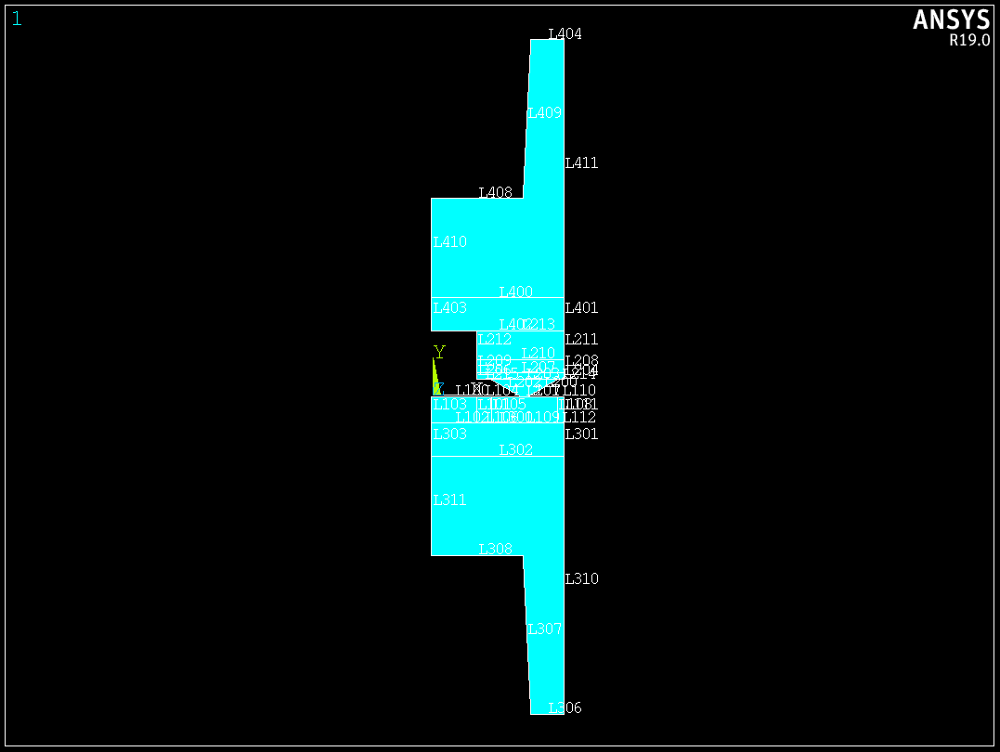

In [14]:
Image(filename='{}/{}000.png'.format(mkpath,filecode),height=600,width = 600)

### Mechanical Feld Setup
- Material
- Meshing
- Contact Elements
- Bondary Conditions
- Write Physics

In [15]:
def mat_read(matnumber, matname, mat_path):
    ansys.prep7()
    ansys.mat(matnumber)
    ansys.input(matname, 'si_mpl', mat_path)
    time.sleep(1)


mat_read(1, mat_sheet, mat_path)
mat_read(2, mat_buckel, mat_path)
mat_read(3, mat_elektrode, mat_path)

2020-02-27 23:52:42,604 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-27 23:52:42,607 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         1
2020-02-27 23:52:43,059 [INFO] pyansys.mapdl: /INPUT FILE= F:\SHK\Material\ENAW5083_JMAT_EDIT.si_mpl  LINE=       0
2020-02-27 23:52:44,097 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-27 23:52:44,104 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         2
2020-02-27 23:52:44,143 [INFO] pyansys.mapdl: /INPUT FILE= F:\SHK\Material\ENAW6082_JMAT_EDIT.si_mpl  LINE=       0
2020-02-27 23:52:45,149 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-27 23:52:45,155 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         3
2020-02-27 23:52:45,173 [INFO] pyansys.mapdl: /INPUT FILE= F:\SHK\Material\CUCR1ZR_WSK.si_mpl  LINE=       0


In [16]:
ansys.mplist('all')

2020-02-27 23:52:49,347 [INFO] pyansys.mapdl: LIST MATERIALS        1 TO        3 BY        1
  PROPERTY= ALL

 MATERIAL NUMBER        1

      TEMP        EX
     298.00     0.69400E+11
     333.00     0.68200E+11
     373.00     0.66800E+11
     433.00     0.64600E+11
     473.00     0.63000E+11
     533.00     0.60500E+11
     573.00     0.58700E+11
     673.00     0.54000E+11
     773.00     0.38400E+11
     873.00     0.10600E+11

      TEMP        ALPX        REFERENCE TEMP. = 298.00
     333.00     0.22900E-04
     373.00     0.23300E-04
     403.00     0.23600E-04
     433.00     0.24000E-04
     473.00     0.24400E-04
     503.00     0.24700E-04
     533.00     0.25000E-04
     573.00     0.25400E-04
     603.00     0.25800E-04
     633.00     0.26100E-04
     673.00     0.26500E-04
     703.00     0.26800E-04
     723.00     0.28200E-04
     728.00     0.28300E-04
     733.00     0.28400E-04
     738.00     0.28500E-04
     743.00     0.28600E-04
     748.00     0.28700E-04
 

'LIST MATERIALS        1 TO        3 BY        1\n  PROPERTY= ALL\n\n MATERIAL NUMBER        1\n\n      TEMP        EX\n     298.00     0.69400E+11\n     333.00     0.68200E+11\n     373.00     0.66800E+11\n     433.00     0.64600E+11\n     473.00     0.63000E+11\n     533.00     0.60500E+11\n     573.00     0.58700E+11\n     673.00     0.54000E+11\n     773.00     0.38400E+11\n     873.00     0.10600E+11\n\n      TEMP        ALPX        REFERENCE TEMP. = 298.00\n     333.00     0.22900E-04\n     373.00     0.23300E-04\n     403.00     0.23600E-04\n     433.00     0.24000E-04\n     473.00     0.24400E-04\n     503.00     0.24700E-04\n     533.00     0.25000E-04\n     573.00     0.25400E-04\n     603.00     0.25800E-04\n     633.00     0.26100E-04\n     673.00     0.26500E-04\n     703.00     0.26800E-04\n     723.00     0.28200E-04\n     728.00     0.28300E-04\n     733.00     0.28400E-04\n     738.00     0.28500E-04\n     743.00     0.28600E-04\n     748.00     0.28700E-04\n     753.0

In [17]:
# definition of parameters to save the tempnumber
NTEMP_MAT1 = 'NTEMP_MAT1'
NTEMP_MAT2 = 'NTEMP_MAT2'
NTRSVX_MAT1 = 'NTRSVX_MAT1'
NTRSVX_MAT2 = 'NTRSVX_MAT2'
# definition of paramters to save the tablename
TABLE_YIELD_MAT1 = 'TABLE_YIELD_MAT1'
TABLE_YIELD_MAT2 = 'TABLE_YIELD_MAT2'
TABLE_RSVX_MAT1 = 'TABLE_RSVX_MAT1'
TABLE_RSVX_MAT2 = 'TABLE_RSVX_MAT2'

# get tempnumber of each Mat
ansys.get(NTEMP_MAT1, 'MISO', 1, 'NTEMP')
ansys.get(NTEMP_MAT2, 'MISO', 2, 'NTEMP')
ansys.get(NTRSVX_MAT1, 'RSVX', 1, 'NTEMP')
ansys.get(NTRSVX_MAT2, 'RSVX', 2, 'NTEMP')

# set up ansys table to save the data
ansys.dim(TABLE_YIELD_MAT1, 'table', 'NTEMP_MAT1', 1, 1, 'temp')
ansys.dim(TABLE_YIELD_MAT2, 'table', 'NTEMP_MAT2', 1, 1, 'temp')
ansys.dim(TABLE_RSVX_MAT1, 'table', 'NTRSVX_MAT1', 1, 1, 'temp')
ansys.dim(TABLE_RSVX_MAT2, 'table', 'NTRSVX_MAT2', 1, 1, 'temp')

2020-02-27 23:53:24,728 [INFO] pyansys.mapdl: *GET  NTEMP_MAT1  FROM  MISO      1  ITEM=NTEM   VALUE=  10.0000000
2020-02-27 23:53:24,731 [INFO] pyansys.mapdl: *GET  NTEMP_MAT2  FROM  MISO      2  ITEM=NTEM   VALUE=  10.0000000
2020-02-27 23:53:24,733 [INFO] pyansys.mapdl: *GET  NTRSVX_MAT1  FROM  RSVX FOR MATERIAL     1  ITEM=NTEM   VALUE=  61.0000000
2020-02-27 23:53:24,735 [INFO] pyansys.mapdl: *GET  NTRSVX_MAT2  FROM  RSVX FOR MATERIAL     2  ITEM=NTEM   VALUE=  44.0000000
2020-02-27 23:53:24,737 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  TABLE_YIELD_MAT1
  TYPE=TABL  DIMENSIONS=       10        1        1
  TEMP
2020-02-27 23:53:24,740 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  TABLE_YIELD_MAT2
  TYPE=TABL  DIMENSIONS=       10        1        1
  TEMP
2020-02-27 23:53:24,742 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  TABLE_RSVX_MAT1
  TYPE=TABL  DIMENSIONS=       61        1        1
  TEMP
2020-02-27 23:53:24,744 [INFO] pyansys.mapdl: SET PARAMETER DIMENS

'SET PARAMETER DIMENSIONS ON  TABLE_RSVX_MAT2\n  TYPE=TABL  DIMENSIONS=       44        1        1\n  TEMP'

In [18]:
ansys.load_parameters()
ansys.parameters

2020-02-27 23:53:40,951 [INFO] pyansys.mapdl: *** NOTE ***                            CP =       0.406   TIME= 23:53:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =       0.406   TIME= 23:53:40
 Parameters written.  Lines= 207.


{'AAS_MAPDL': 1.0,
 'NTEMP_MAT1': 10.0,
 'NTEMP_MAT2': 10.0,
 'NTRSVX_MAT1': 61.0,
 'NTRSVX_MAT2': 44.0,
 '_RETURN': 0.0,
 '_STATUS': 1.0}

In [19]:
def Matdata_in_Table(NTMEP, MPlab, Matnum, TB, YIELD=True):
    for i in range(int(ansys.parameters[NTMEP])):
        i += 1
        ansys.get('TEMP_', MPlab, Matnum, 'TVAL', i)
        ansys.run('{}({},0) = TEMP_'.format(TB, i))
        if (YIELD == True):
            ansys.get('Matdata', MPlab, Matnum, 'TEMP', 'TEMP_', 'CONST', 2)
        else:
            ansys.get('Matdata', MPlab, Matnum, 'TEMP', 'TEMP_', 'CONST', i)
        ansys.run('{}({},1) = Matdata'.format(TB, i))
    ansys.cfopen('{}/{}/{}'.format(mkpath, subfolder, TB), 'csv')
    with ansys.non_interactive:
        ansys.run("*VWRITE,{}(1,0),{}(1,1)".format(TB, TB))
        ansys.run("(ES9.2,',',ES10.3)")
    ansys.finish()
    time.sleep(1)


Matdata_in_Table(NTEMP_MAT1, 'MISO', 1, TABLE_YIELD_MAT1, True)
Matdata_in_Table(NTEMP_MAT2, 'MISO', 2, TABLE_YIELD_MAT2, True)
Matdata_in_Table(NTRSVX_MAT2, 'RSVX', 2, TABLE_RSVX_MAT2, False)
Matdata_in_Table(NTRSVX_MAT1, 'RSVX', 1, TABLE_RSVX_MAT1, False)

2020-02-27 23:54:27,440 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  MISO      1  ITEM=TVAL      1  VALUE=  298.000000
2020-02-27 23:54:27,442 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT1(1,0) =     298.0000000
2020-02-27 23:54:27,444 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  MISO      1  ITEM=TEMP   298.000      ITEM2=CONS     2
  VALUE=  69400000.0
2020-02-27 23:54:27,447 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT1(1,1) =     69400000.00
2020-02-27 23:54:27,448 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  MISO      1  ITEM=TVAL      2  VALUE=  333.000000
2020-02-27 23:54:27,451 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT1(2,0) =     333.0000000
2020-02-27 23:54:27,453 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  MISO      1  ITEM=TEMP   333.000      ITEM2=CONS     2
  VALUE=  68200000.0
2020-02-27 23:54:27,455 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT1(2,1) =     68200000.00
2020-02-27 23:54:27,457 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  MISO      1  ITEM=TVAL  

2020-02-27 23:54:28,598 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT2(8,0) =     673.0000000
2020-02-27 23:54:28,600 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  MISO      2  ITEM=TEMP   673.000      ITEM2=CONS     2
  VALUE=  53100000.0
2020-02-27 23:54:28,602 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT2(8,1) =     53100000.00
2020-02-27 23:54:28,603 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  MISO      2  ITEM=TVAL      9  VALUE=  773.000000
2020-02-27 23:54:28,606 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT2(9,0) =     773.0000000
2020-02-27 23:54:28,608 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  MISO      2  ITEM=TEMP   773.000      ITEM2=CONS     2
  VALUE=  48000000.0
2020-02-27 23:54:28,610 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT2(9,1) =     48000000.00
2020-02-27 23:54:28,613 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  MISO      2  ITEM=TVAL     10  VALUE=  873.000000
2020-02-27 23:54:28,615 [INFO] pyansys.mapdl: PARAMETER TABLE_YIELD_MAT2(10,0) =     873.000

2020-02-27 23:54:29,799 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(15,0) =     773.0000000
2020-02-27 23:54:29,801 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     2  TEMPERATURE=  773.000000
  VALUE= 0.929000000E-07
2020-02-27 23:54:29,803 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(15,1) =    0.9290000000E-07
2020-02-27 23:54:29,805 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     2  ITEM=TVAL     16  VALUE=  803.000000
2020-02-27 23:54:29,807 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(16,0) =     803.0000000
2020-02-27 23:54:29,809 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     2  TEMPERATURE=  803.000000
  VALUE= 0.972000000E-07
2020-02-27 23:54:29,812 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(16,1) =    0.9720000000E-07
2020-02-27 23:54:29,814 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     2  ITEM=TVAL     17  VALUE=  833.000000
2020-02-27 23:54:29,817 [INFO] pyansys.mapdl: PARAMETER TABLE_

2020-02-27 23:54:29,971 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(32,1) =    0.1540000000E-06
2020-02-27 23:54:29,974 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     2  ITEM=TVAL     33  VALUE=  913.000000
2020-02-27 23:54:29,976 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(33,0) =     913.0000000
2020-02-27 23:54:29,979 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     2  TEMPERATURE=  913.000000
  VALUE= 0.167000000E-06
2020-02-27 23:54:29,981 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(33,1) =    0.1670000000E-06
2020-02-27 23:54:29,983 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     2  ITEM=TVAL     34  VALUE=  918.000000
2020-02-27 23:54:29,987 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT2(34,0) =     918.0000000
2020-02-27 23:54:29,990 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     2  TEMPERATURE=  918.000000
  VALUE= 0.192000000E-06
2020-02-27 23:54:29,992 [INFO] pyansys.mapdl: PARAMETER TABLE_

2020-02-27 23:54:31,598 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(5,1) =    0.6400000000E-07
2020-02-27 23:54:31,600 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL      6  VALUE=  473.000000
2020-02-27 23:54:31,602 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(6,0) =     473.0000000
2020-02-27 23:54:31,604 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  473.000000
  VALUE= 0.687000000E-07
2020-02-27 23:54:31,607 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(6,1) =    0.6870000000E-07
2020-02-27 23:54:31,610 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL      7  VALUE=  503.000000
2020-02-27 23:54:31,612 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(7,0) =     503.0000000
2020-02-27 23:54:31,614 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  503.000000
  VALUE= 0.723000000E-07
2020-02-27 23:54:31,616 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX

2020-02-27 23:54:31,752 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(23,0) =     768.0000000
2020-02-27 23:54:31,754 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  768.000000
  VALUE= 0.111000000E-06
2020-02-27 23:54:31,756 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(23,1) =    0.1110000000E-06
2020-02-27 23:54:31,759 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     24  VALUE=  773.000000
2020-02-27 23:54:31,761 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(24,0) =     773.0000000
2020-02-27 23:54:31,763 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  773.000000
  VALUE= 0.112000000E-06
2020-02-27 23:54:31,766 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(24,1) =    0.1120000000E-06
2020-02-27 23:54:31,768 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     25  VALUE=  778.000000
2020-02-27 23:54:31,770 [INFO] pyansys.mapdl: PARAMETER TABLE_

2020-02-27 23:54:31,906 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(40,1) =    0.1350000000E-06
2020-02-27 23:54:31,907 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     41  VALUE=  858.000000
2020-02-27 23:54:31,910 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(41,0) =     858.0000000
2020-02-27 23:54:31,913 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  858.000000
  VALUE= 0.139000000E-06
2020-02-27 23:54:31,915 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(41,1) =    0.1390000000E-06
2020-02-27 23:54:31,917 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     42  VALUE=  863.000000
2020-02-27 23:54:31,919 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(42,0) =     863.0000000
2020-02-27 23:54:31,922 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  863.000000
  VALUE= 0.142000000E-06
2020-02-27 23:54:31,923 [INFO] pyansys.mapdl: PARAMETER TABLE_

2020-02-27 23:54:32,062 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(58,0) =     2073.000000
2020-02-27 23:54:32,064 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  2073.00000
  VALUE= 0.360000000E-06
2020-02-27 23:54:32,066 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(58,1) =    0.3600000000E-06
2020-02-27 23:54:32,068 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     59  VALUE=  2273.00000
2020-02-27 23:54:32,071 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(59,0) =     2273.000000
2020-02-27 23:54:32,073 [INFO] pyansys.mapdl: *GET  MATDATA   FROM  RSVX FOR MATERIAL     1  TEMPERATURE=  2273.00000
  VALUE= 0.374000000E-06
2020-02-27 23:54:32,076 [INFO] pyansys.mapdl: PARAMETER TABLE_RSVX_MAT1(59,1) =    0.3740000000E-06
2020-02-27 23:54:32,078 [INFO] pyansys.mapdl: *GET  TEMP_     FROM  RSVX FOR MATERIAL     1  ITEM=TVAL     60  VALUE=  2773.00000
2020-02-27 23:54:32,081 [INFO] pyansys.mapdl: PARAMETER TABLE_

In [28]:
df = pd.read_csv('{}/{}/{}.csv'.format(mkpath,subfolder,TABLE_YIELD_MAT2),header=None,sep = ',' ,engine='python',names = ['TEMP','YIELD'])
df.head(10)

,TEMP,YIELD
0,298.0,68300000.0
1,333.0,67100000.0
2,373.0,65700000.0
3,433.0,63500000.0
4,473.0,62000000.0
5,533.0,59500000.0
6,573.0,57800000.0
7,673.0,53100000.0
8,773.0,48000000.0
9,873.0,25700000.0


In [29]:
### delete mat if something wrong happened
# ansys.prep7()
# ansys.mpdele('all','all')
# ansys.tbdele('all','all')
# ansys.mptemp()

#### Meshing

In [30]:
# Elements und Mat zuweisen
ansys.prep7()
ansys.et(1,183,0,'',1)
ansys.asel('s','','',100,104,1)
ansys.aatt(1,'',1)
ansys.asel('s','','',200,204,1)
ansys.aatt(2,'',1)
ansys.asel('s','','',300,302,2)
ansys.asel('a','','',400,402,2)
ansys.aatt(3,'',1)
ansys.allsel('all')
# Meshing
ansys.mopt('LSMO','on')     
ansys.esize(0.0002)
ansys.allsel('all')
ansys.asel('s','','',102,200,98)
ansys.aesize('all',0.00006)
ansys.asel('s','','',101,103,2)
ansys.asel('a','','',204)
ansys.aesize('all',0.00008)
ansys.asel('s','','',100,202,102)
ansys.aesize('all',0.0001)
ansys.allsel('all')
ansys.amesh('all')
# plot elements
ansys.pnum('mat',1)
ansys.number(1)
ansys.eplot()
# element shape quality report
ansys.prep7()
ansys.shpp('SUMM')

2020-02-28 00:03:03,066 [INFO] pyansys.mapdl: *** ANSYS - ENGINEERING ANALYSIS SYSTEM  RELEASE Release 19.0     19.0     ***
 ANSYS Mechanical Enterprise
 20120530  VERSION=WINDOWS x64   00:03:03  FEB 28, 2020 CP=      0.969





          ***** ANSYS ANALYSIS DEFINITION (PREP7) *****
2020-02-28 00:03:03,077 [INFO] pyansys.mapdl: ELEMENT TYPE       1 IS PLANE183     8-NODE AXISYMMETRIC SOLID
  KEYOPT( 1- 6)=        0      0      1        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY
  AXISYMMETRIC MODEL
2020-02-28 00:03:03,083 [INFO] pyansys.mapdl: SELECT       FOR ITEM=AREA COMPONENT=
  IN RANGE       100 TO        104 STEP          1

        4  AREAS (OF       12  DEFINED) SELECTED BY  ASEL  COMMAND.
2020-02-28 00:03:03,089 [INFO] pyansys.mapdl: SET ATTRIBUTES FOR ALL SELECTED AREAS
      MAT =    1   REAL =       0   TYPE =    1   ESYS =    0   SECN =

'SUMMARIZE SHAPE TESTING FOR ALL SELECTED ELEMENTS\n\n ------------------------------------------------------------------------------\n            <<<<<<          SHAPE TESTING SUMMARY           >>>>>>\n            <<<<<<        FOR ALL SELECTED ELEMENTS         >>>>>>\n ------------------------------------------------------------------------------\n                    --------------------------------------\n                    |  Element count     14552 PLANE183  |\n                    --------------------------------------\n\n  Test                Number tested  Warning count  Error count    Warn+Err %\n  ----                -------------  -------------  -----------    ----------\n  Aspect Ratio              14552              0             0         0.00 %\n  Parallel Deviation        14534              0             0         0.00 %\n  Maximum Angle             14552              0             0         0.00 %\n  Jacobian Ratio            14552              0             0         

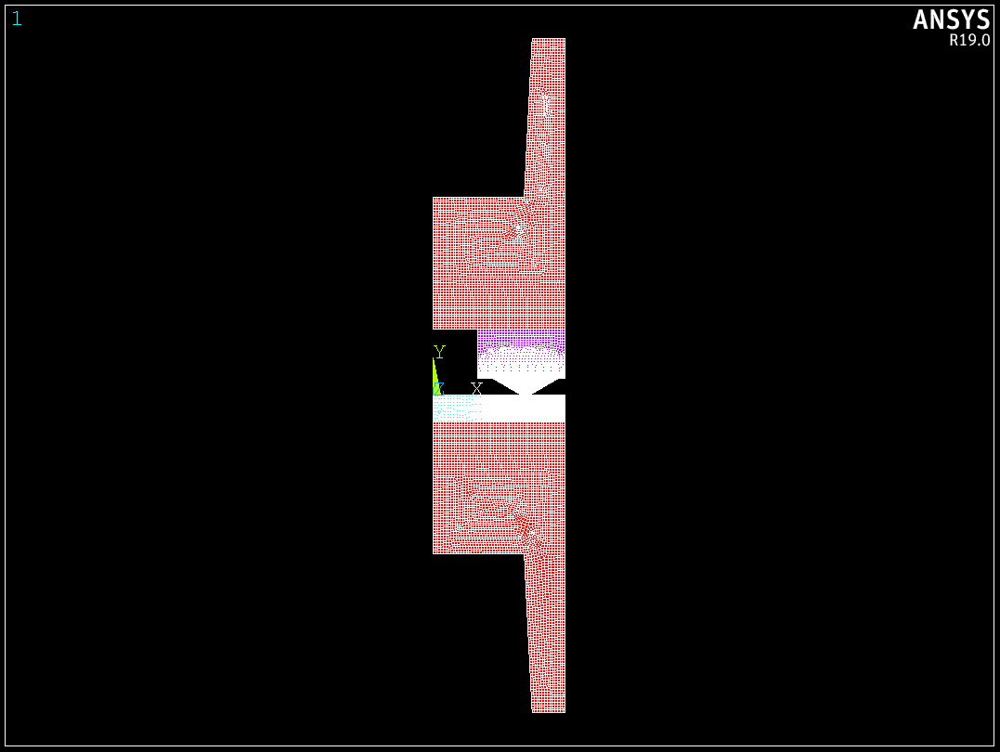

In [33]:
Image(filename='{}/{}002.png'.format(mkpath,filecode),height=600,width = 600)

#### Contact Elements
- contact pair 1: ring - lower sheer'

In [34]:
ansys.prep7()
ansys.mat(2)
ansys.r(3)
ansys.real(3)
ansys.et(2,169)
ansys.et(3,172)
ansys.r(3,'',1.0,0.1,0,)
ansys.rmore('','',1.0E20,0.0,1.0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.keyopt(3,1,0)
ansys.keyopt(3,2,4)
ansys.keyopt(3,3,0)
ansys.keyopt(3,4,0)
ansys.keyopt(3,5,0)
ansys.keyopt(3,6,2)
ansys.keyopt(3,7,0)
ansys.keyopt(3,8,0)
ansys.keyopt(3,9,0)
ansys.keyopt(3,10,0)
ansys.keyopt(3,11,0)
ansys.keyopt(3,12,0)
ansys.nlgeom('on')
# GENERATE THE TARGET SURFACE
ansys.lsel('s','','',107)
ansys.type(2)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()
# GENERATE THE CONTACT SURFACE
ansys.lsel('s','','',200,202,1)
ansys.type(3)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()
ansys.allsel('all')

2020-02-28 00:09:27,824 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:09:27,826 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         2
2020-02-28 00:09:27,830 [INFO] pyansys.mapdl: REAL CONSTANT SET          3  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:09:27,832 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        3
2020-02-28 00:09:27,835 [INFO] pyansys.mapdl: ELEMENT TYPE       2 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY
  AXISYMMETRIC MODEL
2020-02-28 00:09:27,837 [INFO] pyansys.mapdl: ELEMENT TYPE       3 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        

2020-02-28 00:09:27,944 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW


'SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW'

- contact pair 2: upper electrode - sheet

In [35]:
ansys.prep7()
ansys.mat(1)
ansys.r(5)
ansys.real(5)
ansys.et(4,169)
ansys.et(5,172)
ansys.r(5,'',1.0,0.1,0,)
ansys.rmore('','',1.0E20,0.0,1.0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.keyopt(5,1,0)
ansys.keyopt(5,2,0)
ansys.keyopt(5,3,0)
ansys.keyopt(5,4,0)
ansys.keyopt(5,5,0)
ansys.keyopt(5,6,2)
ansys.keyopt(5,7,0)
ansys.keyopt(5,8,0)
ansys.keyopt(5,9,0)
ansys.keyopt(5,10,0)
ansys.keyopt(5,11,0)
ansys.keyopt(5,12,5)
ansys.nlgeom('on')

ansys.lsel('s','','',213)
ansys.type(4)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()

ansys.lsel('s','','',402)
ansys.type(5)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()

ansys.allsel('all')

2020-02-28 00:09:36,194 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:09:36,196 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         1
2020-02-28 00:09:36,199 [INFO] pyansys.mapdl: REAL CONSTANT SET          5  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:09:36,202 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        5
2020-02-28 00:09:36,204 [INFO] pyansys.mapdl: ELEMENT TYPE       4 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY
  AXISYMMETRIC MODEL
2020-02-28 00:09:36,207 [INFO] pyansys.mapdl: ELEMENT TYPE       5 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        

'SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW'

- contact pair 3: lower electrode - sheet  

In [36]:
ansys.prep7()
ansys.mat(3)
ansys.r(7)
ansys.real(7)
ansys.et(6,169)
ansys.et(7,172)
ansys.r(7,'',1.0,0.1,0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.keyopt(7,1,0)
ansys.keyopt(7,2,0)
ansys.keyopt(7,3,0)
ansys.keyopt(7,4,0)
ansys.keyopt(7,5,0)
ansys.keyopt(7,6,2)
ansys.keyopt(7,7,0)
ansys.keyopt(7,8,0)
ansys.keyopt(7,9,0)
ansys.keyopt(7,10,0)
ansys.keyopt(7,11,0)
ansys.keyopt(7,12,5)
ansys.nropt('unsym')
ansys.nlgeom('on')

ansys.lsel('s','','',300)
ansys.type(6)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()

ansys.lsel('s','','',106,112,3)
ansys.lsel('a','','',102)
ansys.type(7)
ansys.nsll('s',1)
ansys.esln('s',0)
ansys.esurf()

ansys.allsel('all')

2020-02-28 00:09:47,031 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:09:47,033 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         3
2020-02-28 00:09:47,035 [INFO] pyansys.mapdl: REAL CONSTANT SET          7  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:09:47,037 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        7
2020-02-28 00:09:47,039 [INFO] pyansys.mapdl: ELEMENT TYPE       6 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY
  AXISYMMETRIC MODEL
2020-02-28 00:09:47,041 [INFO] pyansys.mapdl: ELEMENT TYPE       7 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        

2020-02-28 00:09:47,132 [INFO] pyansys.mapdl: GENERATE ELEMENTS ON SURFACE DEFINED BY SELECTED NODES
  TYPE=        7  REAL=        7  MATERIAL=        3  ESYS=    0

 NUMBER OF ELEMENTS GENERATED=        139
2020-02-28 00:09:47,134 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW


'SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW'

In [38]:
# check the contact definition
ansys.cncheck()
ansys.elist()
# contact pair plot 
ansys.esel('s','ename','',172)
ansys.esel('a','ename','',169)
ansys.replot()
ansys.allsel('all')

2020-02-28 00:10:46,565 [INFO] pyansys.mapdl: CHECK INITIAL OPEN/CLOSED STATUS OF SELECTED CONTACT ELEMENTS
      AND LIST DETAILED CONTACT PAIR INFORMATION

 *** NOTE ***                            CP =       9.969   TIME= 00:10:46
 Internal nodes from 44815 to 45009 are created.
 195 internal nodes are used for contact elements with Lagrange
 multiplier method.

 *** NOTE ***                            CP =      10.000   TIME= 00:10:46
 Internal nodes from 44815 to 45009 are created.
 195 internal nodes are used for contact elements with Lagrange
 multiplier method.

 *** NOTE ***                            CP =      10.031   TIME= 00:10:46
 Deformable-deformable contact pair identified by real constant set 3
 and contact element type 3 has been set up.
 Contact algorithm: Lagrange multiplier method
 Contact detection at: nodal point (normal to target surface)
 Aggressive variation of contact stiffness is activated,
 *WARNING*: It is not recommended to use non-default normal contact


2020-02-28 00:10:48,956 [INFO] pyansys.mapdl: SELECT       FOR ITEM=ENAM COMPONENT=
  IN RANGE       172 TO        172 STEP          1

        286  ELEMENTS (OF      15005  DEFINED) SELECTED BY  ESEL  COMMAND.
2020-02-28 00:10:48,959 [INFO] pyansys.mapdl: ALSO SELECT  FOR ITEM=ENAM COMPONENT=
  IN RANGE       169 TO        169 STEP          1

        453  ELEMENTS (OF      15005  DEFINED) SELECTED BY  ESEL  COMMAND.
2020-02-28 00:10:49,074 [INFO] pyansys.mapdl: PRODUCE ELEMENT PLOT IN DSYS =   0

 CUMULATIVE DISPLAY NUMBER   6 WRITTEN TO FILE therm_cdw_ring_al - RASTER MODE.
 DISPLAY TITLE=
2020-02-28 00:10:49,077 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW


'SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW'

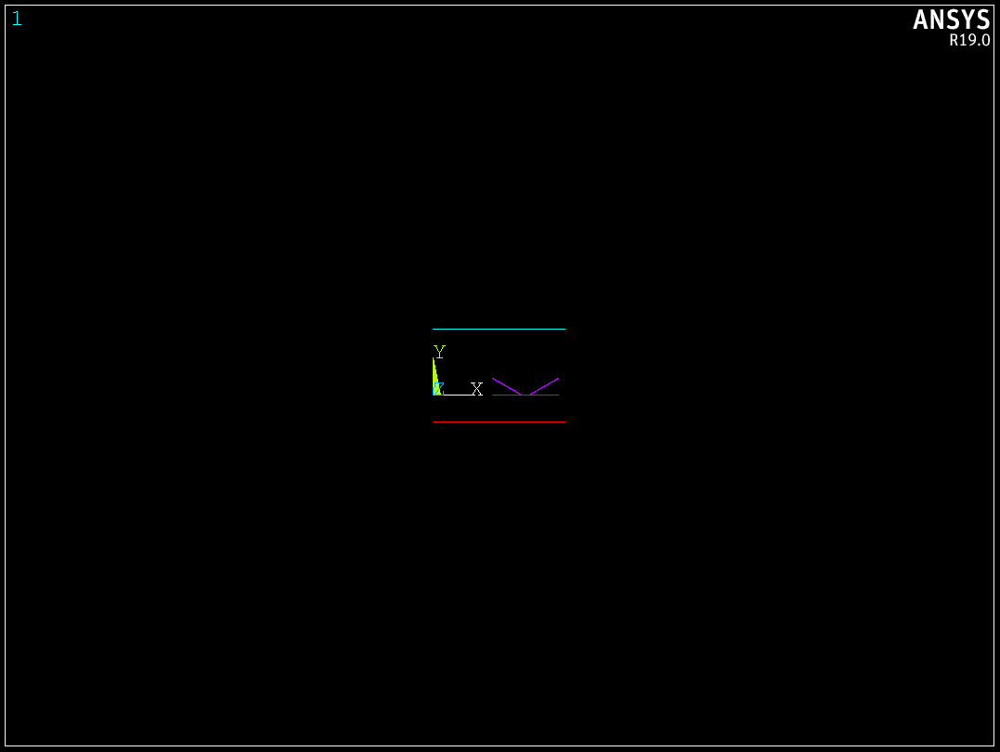

In [39]:
Image(filename='{}/{}002.png'.format(mkpath,filecode),height=600,width = 600)

#### Boundary Conditions 

In [44]:
ansys.allsel('all')
ansys.nsel('s','loc','x',0)
ansys.d('all','',0,'','','','ux')
ansys.lsel('s','','',404)
ansys.nsll('s',1)
ansys.cp(1,'uy','all')
ansys.lsel('s','','',306)
ansys.dl('all','','uy',0)
ansys.allsel('all')
ansys.tunif(T_UNI)
ansys.pbc('all','',1)
ansys.replot()

2020-02-28 00:21:38,663 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02-28 00:21:38,668 [INFO] pyansys.mapdl: SELECT       FOR ITEM=LOC  COMPONENT=X     BETWEEN  0.0000     AND   0.0000
   KABS=  0.  TOLERANCE= 0.100000E-05

        247  NODES (OF      44814  DEFINED) SELECTED BY  NSEL  COMMAND.
2020-02-28 00:21:38,670 [INFO] pyansys.mapdl: SPECIFIED CONSTRAINT UX   FOR SELECTED NODES            1 TO       44814 BY           1
 REAL=  0.00000000       IMAG=  0.00000000
2020-02-28 00:21:38,672 [INFO] pyansys.mapdl: SELECT       FOR ITEM=LINE COMPONENT=
  IN RANGE       404 TO        404 STEP          1

        1  LINES (OF       46  DEFINED) SELECTED BY LSEL  COMMAND.
2020-02-28 00:21:38,675 [INFO] pyansys.mapdl: SELECT      ALL NODES (INTERIOR TO LINE, AND AT KEYPOINTS)
        RELATED TO SELECTED LINE SET.

       27  NODES (OF    44814  DEFINED) SELECTED FROM
        1 SELECTED LINES BY NSLL COMMAND.
2020-02-28 00:21:40,879 [INFO] pyansys.mapdl: Coupled set

'PRODUCE ELEMENT PLOT IN DSYS =   0\n\n CUMULATIVE DISPLAY NUMBER  11 WRITTEN TO FILE therm_cdw_ring_al - RASTER MODE.\n DISPLAY TITLE='

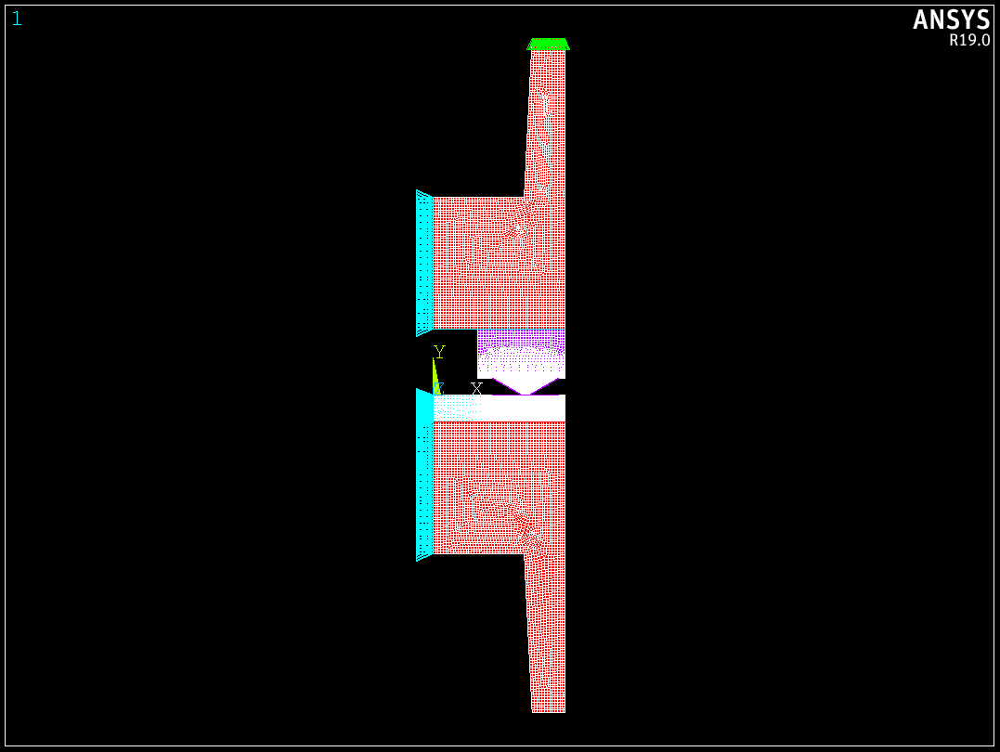

In [47]:
Image(filename='{}/{}003.png'.format(mkpath,filecode),height=600,width = 600)

#### Write Physics 

In [48]:
#/solu
ansys.slashsolu()
ansys.antype(4)
ansys.nropt('unsym')
ansys.kbc(0)
ansys.autots('on')
ansys.nlgeom('on')
ansys.neqit(100)
ansys.outres('all','all')
ansys.allsel('all')
ansys.physics('write','PHYS_STRUCT',PHYS_STRUCT)
ansys.physics('clear')
ansys.save()
ansys.finish()

2020-02-28 00:24:50,133 [INFO] pyansys.mapdl: ***** ROUTINE COMPLETED *****  CP =        16.969



 *****  ANSYS SOLUTION ROUTINE  *****
2020-02-28 00:24:50,139 [INFO] pyansys.mapdl: PERFORM A TRANSIENT ANALYSIS
  THIS WILL BE A NEW ANALYSIS
2020-02-28 00:24:50,141 [INFO] pyansys.mapdl: USE THE FULL NEWTON-RAPHSON OPTION FOR  ALL DEGREES OF FREEDOM
   WITH UNSYMMETRIC SOLVER
   AND USE THE DEFAULT ADAPTIVE DESCENT OPTION
2020-02-28 00:24:50,143 [INFO] pyansys.mapdl: STEP BOUNDARY CONDITION KEY= 0
2020-02-28 00:24:50,145 [INFO] pyansys.mapdl: USE AUTOMATIC TIME STEPPING THIS LOAD STEP
2020-02-28 00:24:50,147 [INFO] pyansys.mapdl: LARGE DEFORMATION ANALYSIS
2020-02-28 00:24:50,149 [INFO] pyansys.mapdl: USE A MAXIMUM OF   100 EQUILIBRIUM ITERATIONS EACH SUBSTEP
2020-02-28 00:24:50,152 [INFO] pyansys.mapdl: WRITE ALL  ITEMS TO THE DATABASE WITH A FREQUENCY OF ALL
   FOR ALL APPLICABLE ENTITIES
2020-02-28 00:24:50,154 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02

'FINISH SOLUTION PROCESSING\n\n\n ***** ROUTINE COMPLETED *****  CP =        17.203'

### Thermal Electric Feld Setup
- Material
- Meshing
- Contact Elements
- Bondary Conditions
- Write Physics

#### Material 

In [49]:
mat_read(1,mat_sheet,mat_path)
mat_read(2,mat_buckel,mat_path)
mat_read(3,mat_elektrode,mat_path)

2020-02-28 00:25:34,456 [INFO] pyansys.mapdl: *** ANSYS - ENGINEERING ANALYSIS SYSTEM  RELEASE Release 19.0     19.0     ***
 ANSYS Mechanical Enterprise
 20120530  VERSION=WINDOWS x64   00:25:34  FEB 28, 2020 CP=     17.328





          ***** ANSYS ANALYSIS DEFINITION (PREP7) *****
2020-02-28 00:25:34,459 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         1
2020-02-28 00:25:34,462 [INFO] pyansys.mapdl: /INPUT FILE= F:\SHK\Material\ENAW5083_JMAT_EDIT.si_mpl  LINE=       0
2020-02-28 00:25:35,480 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:25:35,488 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         2
2020-02-28 00:25:35,509 [INFO] pyansys.mapdl: /INPUT FILE= F:\SHK\Material\ENAW6082_JMAT_EDIT.si_mpl  LINE=       0
2020-02-28 00:25:36,516 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:25:36,524 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         3
2020-02-28 00:25:36,537 [INFO] pyan

In [50]:
# a list to check mat
ansys.mplist('all')

2020-02-28 00:25:40,590 [INFO] pyansys.mapdl: LIST MATERIALS        1 TO        3 BY        1
  PROPERTY= ALL

 MATERIAL NUMBER        1

      TEMP        EX
     298.00     0.69400E+11
     333.00     0.68200E+11
     373.00     0.66800E+11
     433.00     0.64600E+11
     473.00     0.63000E+11
     533.00     0.60500E+11
     573.00     0.58700E+11
     673.00     0.54000E+11
     773.00     0.38400E+11
     873.00     0.10600E+11

      TEMP        ALPX        REFERENCE TEMP. = 298.00
     333.00     0.22900E-04
     373.00     0.23300E-04
     403.00     0.23600E-04
     433.00     0.24000E-04
     473.00     0.24400E-04
     503.00     0.24700E-04
     533.00     0.25000E-04
     573.00     0.25400E-04
     603.00     0.25800E-04
     633.00     0.26100E-04
     673.00     0.26500E-04
     703.00     0.26800E-04
     723.00     0.28200E-04
     728.00     0.28300E-04
     733.00     0.28400E-04
     738.00     0.28500E-04
     743.00     0.28600E-04
     748.00     0.28700E-04
 

'LIST MATERIALS        1 TO        3 BY        1\n  PROPERTY= ALL\n\n MATERIAL NUMBER        1\n\n      TEMP        EX\n     298.00     0.69400E+11\n     333.00     0.68200E+11\n     373.00     0.66800E+11\n     433.00     0.64600E+11\n     473.00     0.63000E+11\n     533.00     0.60500E+11\n     573.00     0.58700E+11\n     673.00     0.54000E+11\n     773.00     0.38400E+11\n     873.00     0.10600E+11\n\n      TEMP        ALPX        REFERENCE TEMP. = 298.00\n     333.00     0.22900E-04\n     373.00     0.23300E-04\n     403.00     0.23600E-04\n     433.00     0.24000E-04\n     473.00     0.24400E-04\n     503.00     0.24700E-04\n     533.00     0.25000E-04\n     573.00     0.25400E-04\n     603.00     0.25800E-04\n     633.00     0.26100E-04\n     673.00     0.26500E-04\n     703.00     0.26800E-04\n     723.00     0.28200E-04\n     728.00     0.28300E-04\n     733.00     0.28400E-04\n     738.00     0.28500E-04\n     743.00     0.28600E-04\n     748.00     0.28700E-04\n     753.0

In [51]:
# ## delete mat if something wrong happened
# ansys.prep7()
# ansys.mpdele('all','all')
# ansys.tbdele('all','all')
# ansys.mptemp()

#### Meshing 

In [52]:
ansys.et(1,223,110,'',1 )
ansys.allsel('all')

2020-02-28 00:26:45,688 [INFO] pyansys.mapdl: ELEMENT TYPE       1 IS PLANE223     AXI 8-NODE THERMOELEC SOLID
  KEYOPT( 1- 6)=      110      0      1        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT
  AXISYMMETRIC MODEL
2020-02-28 00:26:45,691 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW


'SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW'

#### Contact Elements
- contact pair 1: ring - lower sheer

In [53]:
ansys.prep7()
ansys.mat(2)
ansys.r(3)
ansys.real(3)
ansys.et(2,169)
ansys.et(3,172)
ansys.r(3,'',1.0,0.1,0,)
ansys.rmore('','',1.0E20,0.0,1.0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.rmore('','','','',)
ansys.rmore('','','',913)
ansys.keyopt(3,1,4)
ansys.keyopt(3,2,0)
ansys.keyopt(3,3,0)
ansys.keyopt(3,4,0)
ansys.keyopt(3,5,0)
ansys.keyopt(3,6,0)
ansys.keyopt(3,7,0)
ansys.keyopt(3,8,0)
ansys.keyopt(3,9,0)
ansys.keyopt(3,10,0)
ansys.keyopt(3,11,0)
ansys.keyopt(3,12,5)

2020-02-28 00:36:27,389 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:36:27,392 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         2
2020-02-28 00:36:27,394 [INFO] pyansys.mapdl: REAL CONSTANT SET          3  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:36:27,396 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        3
2020-02-28 00:36:27,398 [INFO] pyansys.mapdl: ELEMENT TYPE       2 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT
  AXISYMMETRIC MODEL
2020-02-28 00:36:27,401 [INFO] pyansys.mapdl: ELEMENT TYPE       3 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0 

'ELEMENT TYPE       3 IS CONTA172     2D 3-NODE ELECT-THERM CONTAC\n  KEYOPT( 1- 6)=        4      0      0        0      0      0\n  KEYOPT( 7-12)=        0      0      0        0      0      5\n  KEYOPT(13-18)=        0      0      0        0      0      0\n\n CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT\n  AXISYMMETRIC MODEL'

- contact pair 2: upper electrode - sheer

In [54]:
ansys.prep7()
ansys.mat(1)
ansys.r(5)
ansys.real(5)
ansys.et(4,169)
ansys.et(5,172)
ansys.r(5,'',1.0,0.1,0,)
ansys.rmore('','',1.0E20,0.0,1.0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.rmore('','','','',)
ansys.rmore('','','',913)
ansys.keyopt(5,1,4)
ansys.keyopt(5,2,0)
ansys.keyopt(5,3,0)
ansys.keyopt(5,4,0)
ansys.keyopt(5,5,0)
ansys.keyopt(5,6,0)
ansys.keyopt(5,7,0)
ansys.keyopt(5,8,0)
ansys.keyopt(5,9,0)
ansys.keyopt(5,10,0)
ansys.keyopt(5,11,0)
ansys.keyopt(5,12,5)

2020-02-28 00:36:32,204 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:36:32,212 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         1
2020-02-28 00:36:32,219 [INFO] pyansys.mapdl: REAL CONSTANT SET          5  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:36:32,227 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        5
2020-02-28 00:36:32,234 [INFO] pyansys.mapdl: ELEMENT TYPE       4 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT
  AXISYMMETRIC MODEL
2020-02-28 00:36:32,242 [INFO] pyansys.mapdl: ELEMENT TYPE       5 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0 

'ELEMENT TYPE       5 IS CONTA172     2D 3-NODE ELECT-THERM CONTAC\n  KEYOPT( 1- 6)=        4      0      0        0      0      0\n  KEYOPT( 7-12)=        0      0      0        0      0      5\n  KEYOPT(13-18)=        0      0      0        0      0      0\n\n CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT\n  AXISYMMETRIC MODEL'

- contact pair 3: lower electrode - lower sheer

In [55]:
ansys.prep7()
ansys.mat(3)
ansys.r(7)
ansys.real(7)
ansys.et(6,169)
ansys.et(7,172)
ansys.r(7,'',1.0,0.1,0,)
ansys.rmore('','',1.0E20,0.0,1.0,)
ansys.rmore(0.0,'',1.0,'',1.0,0.5)
ansys.rmore('',1.0,1.0,0.0,'',1.0)
ansys.rmore('','','','',)
ansys.rmore('','','',913)
ansys.keyopt(7,1,4)
ansys.keyopt(7,2,0)
ansys.keyopt(7,3,0)
ansys.keyopt(7,4,0)
ansys.keyopt(7,5,0)
ansys.keyopt(7,6,0)
ansys.keyopt(7,7,0)
ansys.keyopt(7,8,0)
ansys.keyopt(7,9,0)
ansys.keyopt(7,10,0)
ansys.keyopt(7,11,0)
ansys.keyopt(7,12,5)

2020-02-28 00:36:36,722 [INFO] pyansys.mapdl: You have already entered the general preprocessor (PREP7).
2020-02-28 00:36:36,725 [INFO] pyansys.mapdl: MATERIAL NUMBER SET TO         3
2020-02-28 00:36:36,728 [INFO] pyansys.mapdl: REAL CONSTANT SET          7  ITEMS   1 TO   6
    0.0000       0.0000       0.0000       0.0000       0.0000       0.0000
2020-02-28 00:36:36,730 [INFO] pyansys.mapdl: REAL CONSTANT NUMBER=        7
2020-02-28 00:36:36,732 [INFO] pyansys.mapdl: ELEMENT TYPE       6 IS TARGE169     2-D TARGET SEGMENT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0      0        0      0      0
  KEYOPT(13-18)=        0      0      0        0      0      0

 CURRENT NODAL DOF SET IS  UX    UY    TEMP  VOLT
  AXISYMMETRIC MODEL
2020-02-28 00:36:36,735 [INFO] pyansys.mapdl: ELEMENT TYPE       7 IS CONTA172     2D 3-NODE SURF-SURF CONTACT
  KEYOPT( 1- 6)=        0      0      0        0      0      0
  KEYOPT( 7-12)=        0      0 

'ELEMENT TYPE       7 IS CONTA172     2D 3-NODE ELECT-THERM CONTAC\n  KEYOPT( 1- 6)=        4      0      0        0      0      0\n  KEYOPT( 7-12)=        0      0      0        0      0      5\n  KEYOPT(13-18)=        0      0      0        0      0      0\n\n CURRENT NODAL DOF SET IS  TEMP  VOLT\n  AXISYMMETRIC MODEL'

#### Bondary Conditions 

In [56]:
ansys.allsel('all')
ansys.nsel('s', 'loc', 'y', PROJECTION_H1 + ELECTRODE_H1)
ansys.cp(2, 'volt', 'all')
ansys.get('n1', 'node', '', 'num', 'min')
ansys.f('n1', 'amps', 0)
ansys.lsel('s', '', '', 306)
ansys.dl('all', '', 'volt', 0)
ansys.allsel('all')
ansys.tunif(T_UNI)
# force at node
ansys.flist('n1')
ansys.pbc('all', '', 1)
ansys.replot()

2020-02-28 00:37:52,433 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02-28 00:37:52,438 [INFO] pyansys.mapdl: SELECT       FOR ITEM=LOC  COMPONENT=Y     BETWEEN 0.27000E-01 AND  0.27000E-01
   KABS=  0.  TOLERANCE= 0.135000E-03

         41  NODES (OF      44814  DEFINED) SELECTED BY  NSEL  COMMAND.
2020-02-28 00:37:52,440 [INFO] pyansys.mapdl: COUPLED SET=     2  DIRECTION= VOLT  TOTAL NODES=    41
 MAXIMUM COUPLED SET NUMBER=     2
2020-02-28 00:37:52,444 [INFO] pyansys.mapdl: *GET  N1        FROM  NODE  ITEM=NUM  MIN   VALUE=  35579.0000
2020-02-28 00:37:52,447 [INFO] pyansys.mapdl: SPECIFIED NODAL LOAD AMPS FOR SELECTED NODES     35579 TO    35579 BY        1
  REAL=  0.00000000       IMAG=  0.00000000
2020-02-28 00:37:52,449 [INFO] pyansys.mapdl: SELECT       FOR ITEM=LINE COMPONENT=
  IN RANGE       306 TO        306 STEP          1

        1  LINES (OF       46  DEFINED) SELECTED BY LSEL  COMMAND.
2020-02-28 00:37:52,452 [INFO] pyansys.mapdl: CONSTRAIN

'PRODUCE ELEMENT PLOT IN DSYS =   0\n\n CUMULATIVE DISPLAY NUMBER  13 WRITTEN TO FILE therm_cdw_ring_al - RASTER MODE.\n DISPLAY TITLE='

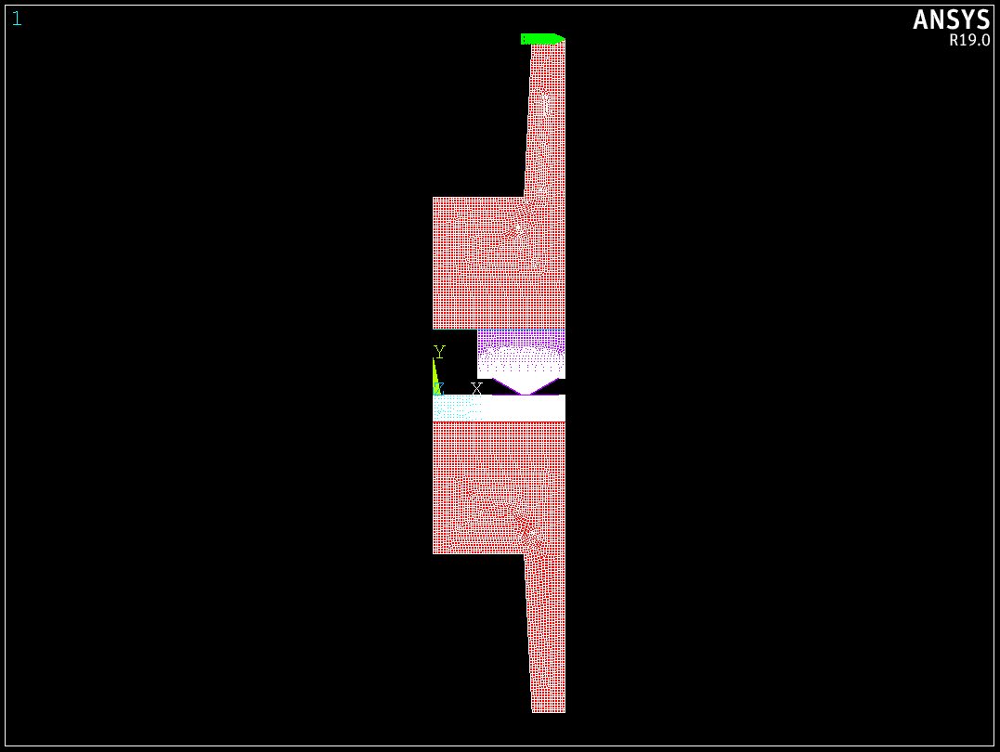

In [59]:
Image(filename='{}/{}004.png'.format(mkpath,filecode),height=600,width = 600)

#### Write Physics 

In [60]:
#/solu
ansys.slashsolu()
ansys.nlhist('nsol', '', 'temp', 'max', 0)
ansys.antype(4)
ansys.kbc(0)
ansys.autots('off')
ansys.nropt('unsym', '', 'off')
ansys.trnopt('full', '', '', '', '', 'hht')
ansys.lnsrch('on')
ansys.neqit(100)
ansys.outres('all', 'all')
ansys.allsel('all')
ansys.physics('write', 'PHYS_T_E', PHYS_T_E)
ansys.physics('clear')
ansys.save()
ansys.finish()

2020-02-28 00:51:36,356 [INFO] pyansys.mapdl: ***** ROUTINE COMPLETED *****  CP =        19.953



 *****  ANSYS SOLUTION ROUTINE  *****
2020-02-28 00:51:36,363 [INFO] pyansys.mapdl: NLHIST: ADDED NODAL RESULTS HISTORY FOR:
       NAME = TEMPMAX_0
  ITEM/COMP = TEMPMAX
       NODE =         0
2020-02-28 00:51:36,365 [INFO] pyansys.mapdl: PERFORM A TRANSIENT ANALYSIS
  THIS WILL BE A NEW ANALYSIS
2020-02-28 00:51:36,367 [INFO] pyansys.mapdl: STEP BOUNDARY CONDITION KEY= 0
2020-02-28 00:51:36,369 [INFO] pyansys.mapdl: DO NOT USE AUTOMATIC TIME STEPPING THIS LOAD STEP
2020-02-28 00:51:36,372 [INFO] pyansys.mapdl: USE THE FULL NEWTON-RAPHSON OPTION FOR  ALL DEGREES OF FREEDOM
   WITH UNSYMMETRIC SOLVER
   AND DO NOT USE ADAPTIVE DESCENT
2020-02-28 00:51:36,375 [INFO] pyansys.mapdl: PERFORM A FULL TRANSIENT ANALYSIS
  USING HHT ALGORITHM
2020-02-28 00:51:36,377 [INFO] pyansys.mapdl: USE A LINE SEARCH FOR  ALL DEGREES OF FREEDOM
2020-02-28 00:51:36,379 [INFO] pyansys.mapdl: USE A MAXIMUM OF 

'FINISH SOLUTION PROCESSING\n\n\n ***** ROUTINE COMPLETED *****  CP =        20.234'

### Solution Mechanical Problem
- load strut physical enviroment
- divide mechanical solution into 4 parts
    - part1: Preloadling
    - part2: Spare keep constant force
    - part3: Applying welding force until start of current flow
    - part4: Applying welding force after start of current flow
- output pressure data for ECR-calcution

#### Load strut physical enviroment

In [61]:
with ansys.non_interactive:
    ansys.run("/FILNAME,{},1".format(STRUCT_FILE))
    ansys.run("save")
ansys.assign('esav', PHYS_STRUCT, 'esav')
ansys.assign('emat', PHYS_STRUCT, 'emat')
ansys.input('{}/{}'.format(mkpath, PHYS_STRUCT), 'ph1')

2020-02-28 00:57:36,574 [INFO] pyansys.mapdl: /INPUT FILE= C:\Users\Administrator\AppData\Local\pyansys\pyansys\tmp_btcezmtled.inp  LINE=       0
2020-02-28 00:57:36,575 [INFO] pyansys.mapdl: 
 

2020-02-28 00:57:36,578 [INFO] pyansys.mapdl: ASSIGN FILE ESAV TO Struct.esav

 *** NOTE ***                            CP =      20.484   TIME= 00:57:36
 File= Struct.esav does not exist and will be created.
2020-02-28 00:57:36,582 [INFO] pyansys.mapdl: ASSIGN FILE EMAT TO Struct.emat

 *** NOTE ***                            CP =      20.484   TIME= 00:57:36
 File= Struct.emat does not exist and will be created.
2020-02-28 00:57:38,928 [INFO] pyansys.mapdl: /INPUT FILE= F:/SHK/Solution/therm_cdw_ring_al_py/Struct.ph1  LINE=       0


'/INPUT FILE= F:/SHK/Solution/therm_cdw_ring_al_py/Struct.ph1  LINE=       0'

#### Divide mechanical solution into 4 parts 

In [62]:
def fk_force(lsnum, kp, lab, force, endtime, dtime, dtmin, dtmax, kbc):
    ansys.slashsolu()
    ansys.antype(4)
    ansys.fk(kp, lab, force)
    ansys.sbctran()
    ansys.time(endtime)
    ansys.deltim(dtime, dtmin, dtmax)
    ansys.kbc(kbc)
    ansys.outres('all', 'all')
    ansys.allsel('all')
    ansys.lswrite(lsnum)

In [63]:
# part1: Preloadling
fk_force(1,410,'fy',-1*IN_F_PRE,TIME_PF_ABS,DT_PF,DT_PF*0.1,DT_PF,0)
# part2: Spare keep constant force
fk_force(2,410,'fy',-1*IN_F_PRE,TIME_SWF_ABS,DT_SP,DT_SP,DT_SP,1)
# part3: Applying welding force until start of current flow
fk_force(3,410,'fy',-1*IN_F_IGN,TIME_SI_ABS,DT_WF_SI,DT_WF_SI*0.01,DT_WF_SI*100,0)
# part4: Applying welding force after start of current flow
fk_force(4,410,'fy',-1*IN_F_FIN,TIME_E_ABS,DT_I,DT_I,DT_I,0)

2020-02-28 00:58:56,159 [INFO] pyansys.mapdl: *****  ANSYS SOLUTION ROUTINE  *****
2020-02-28 00:58:56,162 [INFO] pyansys.mapdl: PERFORM A TRANSIENT ANALYSIS
  THIS WILL BE A NEW ANALYSIS
2020-02-28 00:58:56,167 [INFO] pyansys.mapdl: POINT LOAD ON KEYPOINT   410   LOAD LABEL = FY
      VALUES =     -20000.         0.0000
2020-02-28 00:58:56,170 [INFO] pyansys.mapdl: TRANSFER SOLID MODEL BOUNDARY CONDITIONS TO FINITE ELEMENT MODEL
      CONSTRAINTS    TRANSFERRED FROM LINES         =     27
      FORCES         TRANSFERRED FROM KEYPOINTS     =      1
2020-02-28 00:58:56,172 [INFO] pyansys.mapdl: TIME=  1.0000
2020-02-28 00:58:56,175 [INFO] pyansys.mapdl: USE INITIAL TIME STEP SIZE OF 0.1000000     FOR ALL  DEGREES OF FREEDOM
 FOR AUTOMATIC TIME STEPPING:
   USE 0.1000000E-01 AS THE MINIMUM TIME STEP SIZE
   USE 0.1000000     AS THE MAXIMUM TIME STEP SIZE
2020-02-28 00:58:56,178 [INFO] pyansys.mapdl: STEP BOUNDARY CONDITION KEY= 0
2020-02-28 00:58:56,180 [INFO] pyansys.mapdl: WRITE ALL  

In [64]:
with ansys.non_interactive:
    ansys.run("lssolve,1,4,1")

2020-02-28 00:59:11,997 [INFO] pyansys.mapdl: /INPUT FILE= C:\Users\Administrator\AppData\Local\pyansys\pyansys\tmp_xjalgozlti.inp  LINE=       0
2020-02-28 00:59:11,998 [INFO] pyansys.mapdl: 
 



In [65]:
def follow(thefile):
    thefile.seek(0, 2)
    while True:
        line = thefile.readlines()
        if not line:
            time.sleep(0.5)
            continue
        size1 = os.path.getsize("{}.out".format(file))
        time.sleep(3)
        size2 = os.path.getsize("{}.out".format(file))
        time.sleep(3)
        yield line, size1, size2
        if (size1 == size2):
            break

f = open(
    r'C:\Users\Administrator\AppData\Local\pyansys\pyansys\tmp_xjalgozlti.inp ',
    'r')
f.seek(10)
file = f.readline().split('.')[0]
logfile = open("{}.out".format(file), "r")
loglines = follow(logfile)
for tup in loglines:
    for line in tup[0]:
        print(line)
    if tup[1] == tup[2]:
        break

     FORCE CONVERGENCE VALUE  =   200.3      CRITERION=   20.53    

     DISP CONVERGENCE VALUE   =  0.1033E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1033E-05

     DISP CONVERGENCE VALUE   =  0.1033E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1033E-05

     FORCE CONVERGENCE VALUE  =   49.20      CRITERION=   21.00    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2228E-07

     DISP CONVERGENCE VALUE   =  0.2228E-07  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2228E-07

     FORCE CONVERGENCE VALUE  =   8.258      CRITERION=   21.42     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     1   SUBSTEP     5  COMPLETED.    CUM ITER =     13

 *** TIME =  0.197500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1648E-02   CRITERION = 0.1500    


     DISP CONVERGENCE VALUE   =  0.1982E-07  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1982E-07

     FORCE CONVERGENCE VALUE  =   7.573      CRITERION=   29.02     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     1   SUBSTEP    12  COMPLETED.    CUM ITER =     27

 *** TIME =  0.267500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.3663E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ = 0.1036E+05   PERIOD=  0.9657E-04  PTS/CYC = 0.97E-02

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.1      CRITERION=   28.87    

     DISP CONVERGENCE VALUE   =  0.1325E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1325E-05

     DISP CONVERGENCE VALUE   =  0.1325E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1325E-05

     F

     DISP CONVERGENCE VALUE   =  0.1652E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1652E-05

     DISP CONVERGENCE VALUE   =  0.1652E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1652E-05

     FORCE CONVERGENCE VALUE  =   47.42      CRITERION=   36.94    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1332E-07

     DISP CONVERGENCE VALUE   =  0.1332E-07  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1332E-07

     FORCE CONVERGENCE VALUE  =   3.199      CRITERION=   37.70     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     1   SUBSTEP    20  COMPLETED.    CUM ITER =     43

 *** TIME =  0.347500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.5836E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  8925.       PERIOD=  0.1120E-03  PTS/CYC = 0.1

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2121E-07

     DISP CONVERGENCE VALUE   =  0.2106E-07  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9930     SCALED MAX DOF INC = -0.2106E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     1   SUBSTEP    27  COMPLETED.    CUM ITER =     57

 *** TIME =  0.417500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.7266E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  8444.       PERIOD=  0.1184E-03  PTS/CYC = 0.12E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.0      CRITERION=   44.50    

     DISP CONVERGENCE VALUE   =  0.1845E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1845E-05

     DISP CONVERGENCE VALUE   =  0.1844E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =  0.9994     SCALED MAX DOF INC = -0.1844E-05

     FORCE C

     DISP CONVERGENCE VALUE   =  0.2255E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2255E-05

     FORCE CONVERGENCE VALUE  =   54.55      CRITERION=   53.95    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.6665E-07

     DISP CONVERGENCE VALUE   =  0.6419E-07  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9632     SCALED MAX DOF INC = -0.6419E-07

     FORCE CONVERGENCE VALUE  =   17.67      CRITERION=   55.05     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     1   SUBSTEP    36  COMPLETED.    CUM ITER =     75

 *** TIME =  0.507500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1230E-01   CRITERION = 0.1500    

 *** RESPONSE FREQ =  7357.       PERIOD=  0.1359E-03  PTS/CYC = 0.14E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.8      CRITERION=   53.87    

     D

 *** LOAD STEP     1   SUBSTEP    43  COMPLETED.    CUM ITER =     91

 *** TIME =  0.577500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.5017E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  8231.       PERIOD=  0.1215E-03  PTS/CYC = 0.12E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.0      CRITERION=   61.16    

     DISP CONVERGENCE VALUE   =  0.1906E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1906E-05

     DISP CONVERGENCE VALUE   =  0.1906E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1906E-05

     FORCE CONVERGENCE VALUE  =   82.90      CRITERION=   62.45    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1094E-06

     DISP CONVERGENCE VALUE   =  0.1094E-06  CRITERION=  0.4391E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1094E-06

   

     DISP CONVERGENCE VALUE   =  0.7804E-07  CRITERION=  0.4480E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.7804E-07

     FORCE CONVERGENCE VALUE  =   5.358      CRITERION=   71.67     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   3

 *** LOAD STEP     1   SUBSTEP    50  COMPLETED.    CUM ITER =    107

 *** TIME =  0.647500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1334E-01   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6019.       PERIOD=  0.1661E-03  PTS/CYC = 0.17E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.1      CRITERION=   68.46    

     DISP CONVERGENCE VALUE   =  0.3301E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3301E-05

     DISP CONVERGENCE VALUE   =  0.3301E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3301E-05

     F

    EQUIL ITER   4 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2306E-06

     DISP CONVERGENCE VALUE   =  0.2306E-06  CRITERION=  0.4572E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2306E-06

     FORCE CONVERGENCE VALUE  =   74.01      CRITERION=   79.91     <<< CONVERGED

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   4

 *** LOAD STEP     1   SUBSTEP    56  COMPLETED.    CUM ITER =    125

 *** TIME =  0.707500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1545E-01   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6836.       PERIOD=  0.1463E-03  PTS/CYC = 0.15E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   213.3      CRITERION=   74.71    

     DISP CONVERGENCE VALUE   =  0.2499E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2499E-05

     DISP CONVERGENCE VALUE   =  0.2499E-05  CRITERION=  0.4303E-06

    

     DISP CONVERGENCE VALUE   =  0.3539E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3539E-05

     DISP CONVERGENCE VALUE   =  0.3539E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3539E-05

     THE CONTACT STATUS HAS CHANGED AT     1  CONTACT POINTS

     FORCE CONVERGENCE VALUE  =   244.3      CRITERION=   82.65    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC=  0.7990E-06

     DISP CONVERGENCE VALUE   =  0.7990E-06  CRITERION=  0.4391E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC =  0.7990E-06

     FORCE CONVERGENCE VALUE  =   299.0      CRITERION=   84.34    

    EQUIL ITER   3 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2017E-06

     DISP CONVERGENCE VALUE   =  0.2001E-06  CRITERION=  0.4480E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9919     SCALED MAX DOF INC = -0.2001E-06

     FORCE CONVERGENCE VALUE  =   33.34      CRITERION

 *** LOAD STEP     1   SUBSTEP    69  COMPLETED.    CUM ITER =    159

 *** TIME =  0.837500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1206E-01   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5825.       PERIOD=  0.1717E-03  PTS/CYC = 0.17E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   211.4      CRITERION=   88.25    

     DISP CONVERGENCE VALUE   =  0.3567E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3567E-05

     DISP CONVERGENCE VALUE   =  0.3567E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3567E-05

     FORCE CONVERGENCE VALUE  =   283.7      CRITERION=   90.09    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.8249E-06

     DISP CONVERGENCE VALUE   =  0.8249E-06  CRITERION=  0.4391E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.8249E-06

     FORCE CONVER

    EQUIL ITER   3 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.6739E-07

     DISP CONVERGENCE VALUE   =  0.6739E-07  CRITERION=  0.4480E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.6739E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   3

 *** LOAD STEP     1   SUBSTEP    75  COMPLETED.    CUM ITER =    178

 *** TIME =  0.897500         TIME INC =  0.100000E-01

 *** MAX PLASTIC STRAIN STEP = 0.1915E-01   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6030.       PERIOD=  0.1658E-03  PTS/CYC = 0.17E-01

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-01  UNCHANGED



     FORCE CONVERGENCE VALUE  =   200.1      CRITERION=   94.50    

     DISP CONVERGENCE VALUE   =  0.3216E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3216E-05

     DISP CONVERGENCE VALUE   =  0.3216E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3216E-05

     FORCE C

     FORCE CONVERGENCE VALUE  =   200.5      CRITERION=   100.8    

     DISP CONVERGENCE VALUE   =  0.3349E-05  CRITERION=  0.4217E-06

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3349E-05

     DISP CONVERGENCE VALUE   =  0.1247E-05  CRITERION=  0.4303E-06

     LINE SEARCH PARAMETER =  0.3725     SCALED MAX DOF INC = -0.1247E-05

     FORCE CONVERGENCE VALUE  =   899.2      CRITERION=   102.8    

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1604E-05

     DISP CONVERGENCE VALUE   =  0.1574E-05  CRITERION=  0.4391E-06

     LINE SEARCH PARAMETER =  0.9813     SCALED MAX DOF INC = -0.1574E-05

     FORCE CONVERGENCE VALUE  =   221.1      CRITERION=   104.9    

    EQUIL ITER   3 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2888E-06

     DISP CONVERGENCE VALUE   =  0.2888E-06  CRITERION=  0.4480E-06 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2888E-06

     FORCE CONVERGENCE VALUE  =   92.04      CR

     FORCE CONVERGENCE VALUE  =   32.16      CRITERION=   104.2    

     DISP CONVERGENCE VALUE   =  0.2777E-07  CRITERION=  0.1131E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC=  0.2777E-07

     DISP CONVERGENCE VALUE   =  0.2777E-07  CRITERION=  0.1154E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC =  0.2777E-07

     FORCE CONVERGENCE VALUE  =   92.68      CRITERION=   106.3     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2179E-07

     DISP CONVERGENCE VALUE   =  0.2115E-07  CRITERION=  0.1178E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9707     SCALED MAX DOF INC = -0.2115E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     2   SUBSTEP     1  COMPLETED.    CUM ITER =    211

 *** TIME =   2.00000         TIME INC =   1.00000    

 *** MAX PLASTIC STRAIN STEP = 0.2835E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ = 0.2734E+06   PERIOD

     FORCE CONVERGENCE VALUE  =   32.33      CRITERION=   107.1    

     DISP CONVERGENCE VALUE   =  0.2149E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2149E-06

     DISP CONVERGENCE VALUE   =  0.2149E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2149E-06

     FORCE CONVERGENCE VALUE  =   9.457      CRITERION=   109.3     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.6434E-08

     DISP CONVERGENCE VALUE   =  0.6434E-08  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.6434E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP     5  COMPLETED.    CUM ITER =    222

 *** TIME =   2.00562         TIME INC =  0.181250E-03

 *** MAX PLASTIC STRAIN STEP = 0.5314E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  7283.       PERIOD

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    12  COMPLETED.    CUM ITER =    236

 *** TIME =   2.00663         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.6147E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6504.       PERIOD=  0.1537E-03  PTS/CYC =  1.1    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.52      CRITERION=   107.7    

     DISP CONVERGENCE VALUE   =  0.2342E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2342E-06

     DISP CONVERGENCE VALUE   =  0.2342E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2342E-06

     FORCE CONVERGENCE VALUE  =   3.839      CRITERION=   109.9     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.7617E-08

     DISP CONVERGENCE VALUE   =  0.5826E-08  CRITERION=  0.

     DISP CONVERGENCE VALUE   =  0.2919E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2919E-06

     DISP CONVERGENCE VALUE   =  0.2919E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2919E-06

     FORCE CONVERGENCE VALUE  =   4.855      CRITERION=   110.5     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1186E-07

     DISP CONVERGENCE VALUE   =  0.5909E-08  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.4980     SCALED MAX DOF INC = -0.5909E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    21  COMPLETED.    CUM ITER =    254

 *** TIME =   2.00794         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1106E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5742.       PERIOD=  0.1742E-03  PTS/CYC =  1.2    

 *** AUTO STEP TIME:  NEXT TIME IN

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1639E-07

     DISP CONVERGENCE VALUE   =  0.1639E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1639E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    29  COMPLETED.    CUM ITER =    270

 *** TIME =   2.00910         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1563E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5319.       PERIOD=  0.1880E-03  PTS/CYC =  1.3    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.62      CRITERION=   109.0    

     DISP CONVERGENCE VALUE   =  0.2793E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2793E-06

     DISP CONVERGENCE VALUE   =  0.2793E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC

     DISP CONVERGENCE VALUE   =  0.2135E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9469     SCALED MAX DOF INC = -0.2135E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    37  COMPLETED.    CUM ITER =    286

 *** TIME =   2.01026         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1856E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4762.       PERIOD=  0.2100E-03  PTS/CYC =  1.4    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.63      CRITERION=   109.6    

     DISP CONVERGENCE VALUE   =  0.3530E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3530E-06

     DISP CONVERGENCE VALUE   =  0.3530E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3530E-06

     FORCE CONVERGENCE VALUE  =   6.522      CRITERION=   111

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    45  COMPLETED.    CUM ITER =    302

 *** TIME =   2.01142         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1985E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4589.       PERIOD=  0.2179E-03  PTS/CYC =  1.5    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   15.07      CRITERION=   110.2    

     DISP CONVERGENCE VALUE   =  0.4256E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.4256E-06

     DISP CONVERGENCE VALUE   =  0.4256E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.4256E-06

     FORCE CONVERGENCE VALUE  =   7.814      CRITERION=   112.5     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2645E-07

     DISP CONVERGENCE VALUE   =  0.1969E-07  CRITERION=  0.

     DISP CONVERGENCE VALUE   =  0.2206E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.8910     SCALED MAX DOF INC = -0.2206E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    53  COMPLETED.    CUM ITER =    318

 *** TIME =   2.01258         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1974E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4434.       PERIOD=  0.2255E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.76      CRITERION=   110.8    

     DISP CONVERGENCE VALUE   =  0.4655E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.4655E-06

     DISP CONVERGENCE VALUE   =  0.4655E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.4655E-06

     FORCE CONVERGENCE VALUE  =   9.326      CRITERION=   113

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    61  COMPLETED.    CUM ITER =    334

 *** TIME =   2.01374         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2052E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4315.       PERIOD=  0.2317E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.75      CRITERION=   111.4    

     DISP CONVERGENCE VALUE   =  0.4506E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.4506E-06

     DISP CONVERGENCE VALUE   =  0.4506E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.4506E-06

     FORCE CONVERGENCE VALUE  =   8.538      CRITERION=   113.7     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3064E-07

     DISP CONVERGENCE VALUE   =  0.2958E-07  CRITERION=  0.

 *** LOAD STEP     3   SUBSTEP    69  COMPLETED.    CUM ITER =    350

 *** TIME =   2.01490         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2379E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4205.       PERIOD=  0.2378E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.91      CRITERION=   112.0    

     DISP CONVERGENCE VALUE   =  0.4382E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.4382E-06

     DISP CONVERGENCE VALUE   =  0.4382E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.4382E-06

     FORCE CONVERGENCE VALUE  =   8.681      CRITERION=   114.3     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3280E-07

     DISP CONVERGENCE VALUE   =  0.3280E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000



     FORCE CONVERGENCE VALUE  =   15.37      CRITERION=   112.6    

     DISP CONVERGENCE VALUE   =  0.1646E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1646E-06

     DISP CONVERGENCE VALUE   =  0.1646E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1646E-06

     FORCE CONVERGENCE VALUE  =   4.040      CRITERION=   114.9     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1092E-07

     DISP CONVERGENCE VALUE   =  0.1092E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1092E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    78  COMPLETED.    CUM ITER =    368

 *** TIME =   2.01620         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.4771E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6116.       PERI

     FORCE CONVERGENCE VALUE  =   16.01      CRITERION=   113.2    

     DISP CONVERGENCE VALUE   =  0.1307E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1307E-06

     DISP CONVERGENCE VALUE   =  0.1307E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1307E-06

     FORCE CONVERGENCE VALUE  =   3.521      CRITERION=   115.5     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.5808E-08

     DISP CONVERGENCE VALUE   =  0.5808E-08  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.5808E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    86  COMPLETED.    CUM ITER =    384

 *** TIME =   2.01736         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.5990E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6499.       PERIOD

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP    93  COMPLETED.    CUM ITER =    399

 *** TIME =   2.01838         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1671E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5509.       PERIOD=  0.1815E-03  PTS/CYC =  1.3    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.60      CRITERION=   113.8    

     DISP CONVERGENCE VALUE   =  0.1994E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1994E-06

     DISP CONVERGENCE VALUE   =  0.1994E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1994E-06

     FORCE CONVERGENCE VALUE  =   5.300      CRITERION=   116.2     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1170E-07

     DISP CONVERGENCE VALUE   =  0.8882E-08  CRITERION=  0.

     FORCE CONVERGENCE VALUE  =   10.50      CRITERION=   116.7     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2031E-07

     DISP CONVERGENCE VALUE   =  0.2031E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2031E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   101  COMPLETED.    CUM ITER =    415

 *** TIME =   2.01954         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2164E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4986.       PERIOD=  0.2006E-03  PTS/CYC =  1.4    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   15.23      CRITERION=   114.4    

     DISP CONVERGENCE VALUE   =  0.2516E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2516E-06

     DISP CONVERGENCE VALUE   =  0.2516E-06  CRITERION=  0.

     DISP CONVERGENCE VALUE   =  0.1863E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1863E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   109  COMPLETED.    CUM ITER =    431

 *** TIME =   2.02070         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2712E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4509.       PERIOD=  0.2218E-03  PTS/CYC =  1.5    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   16.00      CRITERION=   115.0    

     DISP CONVERGENCE VALUE   =  0.1667E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1667E-06

     DISP CONVERGENCE VALUE   =  0.8087E-07  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.4852     SCALED MAX DOF INC = -0.8087E-07

     FORCE CONVERGENCE VALUE  =   39.38      CRITERION=   117

 *** LOAD STEP     3   SUBSTEP   117  COMPLETED.    CUM ITER =    447

 *** TIME =   2.02186         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1219E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6776.       PERIOD=  0.1476E-03  PTS/CYC =  1.0    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.83      CRITERION=   115.6    

     DISP CONVERGENCE VALUE   =  0.1252E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1252E-06

     DISP CONVERGENCE VALUE   =  0.1221E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.9757     SCALED MAX DOF INC = -0.1221E-06

     FORCE CONVERGENCE VALUE  =   3.458      CRITERION=   118.0     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC=  0.5001E-08

     DISP CONVERGENCE VALUE   =  0.3894E-08  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.7787

     THE CONTACT STATUS HAS CHANGED AT     1  CONTACT POINTS

     FORCE CONVERGENCE VALUE  =   8.969      CRITERION=   118.5     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC=  0.1266E-07

     DISP CONVERGENCE VALUE   =  0.1057E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.8348     SCALED MAX DOF INC =  0.1057E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   125  COMPLETED.    CUM ITER =    463

 *** TIME =   2.02302         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1025E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6344.       PERIOD=  0.1576E-03  PTS/CYC =  1.1    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.56      CRITERION=   116.2    

     DISP CONVERGENCE VALUE   =  0.1334E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1334E-0

     DISP CONVERGENCE VALUE   =  0.2640E-08  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC =  0.2640E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   133  COMPLETED.    CUM ITER =    479

 *** TIME =   2.02418         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.3532E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  7519.       PERIOD=  0.1330E-03  PTS/CYC = 0.92    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.52      CRITERION=   116.8    

     DISP CONVERGENCE VALUE   =  0.2067E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2067E-06

     DISP CONVERGENCE VALUE   =  0.2067E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2067E-06

     FORCE CONVERGENCE VALUE  =   3.729      CRITERION=   119

 *** LOAD STEP     3   SUBSTEP   141  COMPLETED.    CUM ITER =    495

 *** TIME =   2.02534         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.4771E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6904.       PERIOD=  0.1448E-03  PTS/CYC =  1.0    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   14.52      CRITERION=   117.5    

     DISP CONVERGENCE VALUE   =  0.2430E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2430E-06

     DISP CONVERGENCE VALUE   =  0.2430E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2430E-06

     FORCE CONVERGENCE VALUE  =   7.811      CRITERION=   119.9     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1950E-07

     DISP CONVERGENCE VALUE   =  0.1950E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000

     FORCE CONVERGENCE VALUE  =   14.80      CRITERION=   118.0    

     DISP CONVERGENCE VALUE   =  0.2677E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2677E-06

     DISP CONVERGENCE VALUE   =  0.2677E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2677E-06

     FORCE CONVERGENCE VALUE  =   8.765      CRITERION=   120.4     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2814E-07

     DISP CONVERGENCE VALUE   =  0.2814E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2814E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   149  COMPLETED.    CUM ITER =    512

 *** TIME =   2.02650         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2124E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5885.       PERIOD

 *** LOAD STEP     3   SUBSTEP   156  COMPLETED.    CUM ITER =    526

 *** TIME =   2.02751         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2649E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5453.       PERIOD=  0.1834E-03  PTS/CYC =  1.3    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   15.51      CRITERION=   118.6    

     DISP CONVERGENCE VALUE   =  0.3298E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3298E-06

     DISP CONVERGENCE VALUE   =  0.3298E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3298E-06

     FORCE CONVERGENCE VALUE  =   10.90      CRITERION=   121.0     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.4219E-07

     DISP CONVERGENCE VALUE   =  0.4219E-07  CRITERION=  0.1200E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     3   SUBSTEP   164  COMPLETED.    CUM ITER =    542

 *** TIME =   2.02867         TIME INC =  0.145000E-03

 *** MAX PLASTIC STRAIN STEP = 0.3165E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4876.       PERIOD=  0.2051E-03  PTS/CYC =  1.4    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.14500E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   15.68      CRITERION=   119.2    

     DISP CONVERGENCE VALUE   =  0.3813E-06  CRITERION=  0.1152E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3813E-06

     DISP CONVERGENCE VALUE   =  0.3813E-06  CRITERION=  0.1176E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3813E-06

     FORCE CONVERGENCE VALUE  =   13.51      CRITERION=   121.6     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.5309E-07

     DISP CONVERGENCE VALUE   =  0.5309E-07  CRITERION=  0.

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1761E-07

     DISP CONVERGENCE VALUE   =  0.1761E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1761E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP     3  COMPLETED.    CUM ITER =    554

 *** TIME =   2.02930         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1597E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4591.       PERIOD=  0.2178E-03  PTS/CYC =  2.2    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.08      CRITERION=   119.5    

     DISP CONVERGENCE VALUE   =  0.2390E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2390E-06

     DISP CONVERGENCE VALUE   =  0.2390E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC

     FORCE CONVERGENCE VALUE  =   5.629      CRITERION=   122.3     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1325E-07

     DISP CONVERGENCE VALUE   =  0.1325E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1325E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    11  COMPLETED.    CUM ITER =    570

 *** TIME =   2.03010         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1222E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4490.       PERIOD=  0.2227E-03  PTS/CYC =  2.2    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.04      CRITERION=   119.9    

     DISP CONVERGENCE VALUE   =  0.3032E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3032E-06

     DISP CONVERGENCE VALUE   =  0.3032E-06  CRITERION=  0.

     DISP CONVERGENCE VALUE   =  0.3325E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3325E-06

     DISP CONVERGENCE VALUE   =  0.3325E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3325E-06

     FORCE CONVERGENCE VALUE  =   7.879      CRITERION=   122.7     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1865E-07

     DISP CONVERGENCE VALUE   =  0.1865E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1865E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    19  COMPLETED.    CUM ITER =    586

 *** TIME =   2.03090         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1697E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4332.       PERIOD=  0.2308E-03  PTS/CYC =  2.3    

 *** AUTO STEP TIME:  NEXT TIME IN

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    26  COMPLETED.    CUM ITER =    600

 *** TIME =   2.03160         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1778E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4252.       PERIOD=  0.2352E-03  PTS/CYC =  2.4    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.15      CRITERION=   120.7    

     DISP CONVERGENCE VALUE   =  0.3529E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3529E-06

     DISP CONVERGENCE VALUE   =  0.3529E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3529E-06

     FORCE CONVERGENCE VALUE  =   8.722      CRITERION=   123.2     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2199E-07

     DISP CONVERGENCE VALUE   =  0.2199E-07  CRITERION=  0.

     DISP CONVERGENCE VALUE   =  0.2371E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2371E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    34  COMPLETED.    CUM ITER =    616

 *** TIME =   2.03240         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1807E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4195.       PERIOD=  0.2384E-03  PTS/CYC =  2.4    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.20      CRITERION=   121.1    

     DISP CONVERGENCE VALUE   =  0.3003E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3003E-06

     DISP CONVERGENCE VALUE   =  0.3003E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3003E-06

     FORCE CONVERGENCE VALUE  =   7.826      CRITERION=   123

 *** LOAD STEP     4   SUBSTEP    42  COMPLETED.    CUM ITER =    632

 *** TIME =   2.03320         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1736E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  8903.       PERIOD=  0.1123E-03  PTS/CYC =  1.1    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.26      CRITERION=   121.5    

     DISP CONVERGENCE VALUE   =  0.2415E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2415E-06

     DISP CONVERGENCE VALUE   =  0.2415E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2415E-06

     FORCE CONVERGENCE VALUE  =   22.21      CRITERION=   124.0     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1696E-07

     DISP CONVERGENCE VALUE   =  0.1696E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000

     FORCE CONVERGENCE VALUE  =   1.829      CRITERION=   124.4     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2836E-08

     DISP CONVERGENCE VALUE   =  0.2836E-08  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2836E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    50  COMPLETED.    CUM ITER =    648

 *** TIME =   2.03400         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2763E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6483.       PERIOD=  0.1543E-03  PTS/CYC =  1.5    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.00      CRITERION=   121.9    

     DISP CONVERGENCE VALUE   =  0.1504E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1504E-06

     DISP CONVERGENCE VALUE   =  0.1504E-06  CRITERION=  0.

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1619E-07

     DISP CONVERGENCE VALUE   =  0.1619E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1619E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    58  COMPLETED.    CUM ITER =    664

 *** TIME =   2.03480         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1253E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5359.       PERIOD=  0.1866E-03  PTS/CYC =  1.9    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.06      CRITERION=   122.4    

     DISP CONVERGENCE VALUE   =  0.1173E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1173E-06

     DISP CONVERGENCE VALUE   =  0.1173E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC

     DISP CONVERGENCE VALUE   =  0.1587E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1587E-06

     FORCE CONVERGENCE VALUE  =   3.586      CRITERION=   125.2     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.8504E-08

     DISP CONVERGENCE VALUE   =  0.8504E-08  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.8504E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    66  COMPLETED.    CUM ITER =    680

 *** TIME =   2.03560         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.8893E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4992.       PERIOD=  0.2003E-03  PTS/CYC =  2.0    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.03      CRITERION=   122.8    

     DISP CONVERGENCE VALUE   =  0.3425E-06  CRITERION=  0.14

     DISP CONVERGENCE VALUE   =  0.3667E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3667E-06

     DISP CONVERGENCE VALUE   =  0.3667E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3667E-06

     THE CONTACT STATUS HAS CHANGED AT     1  CONTACT POINTS

     FORCE CONVERGENCE VALUE  =   8.795      CRITERION=   125.7     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2216E-07

     DISP CONVERGENCE VALUE   =  0.1569E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =  0.7077     SCALED MAX DOF INC = -0.1569E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    74  COMPLETED.    CUM ITER =    697

 *** TIME =   2.03640         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2108E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4570.       PERIOD=  0.21

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    81  COMPLETED.    CUM ITER =    711

 *** TIME =   2.03710         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.3475E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6284.       PERIOD=  0.1591E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.03      CRITERION=   123.6    

     DISP CONVERGENCE VALUE   =  0.1996E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1996E-06

     DISP CONVERGENCE VALUE   =  0.1996E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1996E-06

     FORCE CONVERGENCE VALUE  =   3.602      CRITERION=   126.1     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1244E-07

     DISP CONVERGENCE VALUE   =  0.1244E-07  CRITERION=  0.

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2187E-07

     DISP CONVERGENCE VALUE   =  0.2187E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2187E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    89  COMPLETED.    CUM ITER =    727

 *** TIME =   2.03790         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.1405E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5168.       PERIOD=  0.1935E-03  PTS/CYC =  1.9    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.31      CRITERION=   124.0    

     DISP CONVERGENCE VALUE   =  0.1220E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1220E-06

     DISP CONVERGENCE VALUE   =  0.1220E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC

     FORCE CONVERGENCE VALUE  =   3.575      CRITERION=   126.9     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1154E-07

     DISP CONVERGENCE VALUE   =  0.1154E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1154E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP    97  COMPLETED.    CUM ITER =    743

 *** TIME =   2.03870         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.7685E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4878.       PERIOD=  0.2050E-03  PTS/CYC =  2.0    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.07      CRITERION=   124.4    

     DISP CONVERGENCE VALUE   =  0.3423E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3423E-06

     DISP CONVERGENCE VALUE   =  0.3423E-06  CRITERION=  0.

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP   105  COMPLETED.    CUM ITER =    759

 *** TIME =   2.03950         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.7436E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6576.       PERIOD=  0.1521E-03  PTS/CYC =  1.5    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.22      CRITERION=   124.8    

     DISP CONVERGENCE VALUE   =  0.7338E-07  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.7338E-07

     DISP CONVERGENCE VALUE   =  0.7338E-07  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.7338E-07

     FORCE CONVERGENCE VALUE  =   1.078      CRITERION=   127.4     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2640E-08

     DISP CONVERGENCE VALUE   =  0.1064E-08  CRITERION=  0.

 *** LOAD STEP     4   SUBSTEP   113  COMPLETED.    CUM ITER =    775

 *** TIME =   2.04030         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.8675E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6133.       PERIOD=  0.1631E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.33      CRITERION=   125.2    

     DISP CONVERGENCE VALUE   =  0.1461E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1461E-06

     DISP CONVERGENCE VALUE   =  0.1461E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1461E-06

     FORCE CONVERGENCE VALUE  =   2.810      CRITERION=   127.8     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.7187E-08

     DISP CONVERGENCE VALUE   =  0.7187E-08  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000

     DISP CONVERGENCE VALUE   =  0.8072E-08  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.8072E-08

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP   121  COMPLETED.    CUM ITER =    791

 *** TIME =   2.04110         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.5271E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  6125.       PERIOD=  0.1633E-03  PTS/CYC =  1.6    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.07      CRITERION=   125.6    

     DISP CONVERGENCE VALUE   =  0.2466E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2466E-06

     DISP CONVERGENCE VALUE   =  0.2466E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.2466E-06

     FORCE CONVERGENCE VALUE  =   5.654      CRITERION=   128

     FORCE CONVERGENCE VALUE  =   10.84      CRITERION=   126.0    

     DISP CONVERGENCE VALUE   =  0.1738E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1738E-06

     DISP CONVERGENCE VALUE   =  0.1738E-06  CRITERION=  0.1461E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1738E-06

     FORCE CONVERGENCE VALUE  =   3.454      CRITERION=   128.6     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.1042E-07

     DISP CONVERGENCE VALUE   =  0.1042E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.1042E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP   129  COMPLETED.    CUM ITER =    807

 *** TIME =   2.04190         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.6466E-03   CRITERION = 0.1500    

 *** RESPONSE FREQ =  5527.       PERIOD

     FORCE CONVERGENCE VALUE  =   7.165      CRITERION=   129.0     <<< CONVERGED

    EQUIL ITER   2 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.3065E-07

     DISP CONVERGENCE VALUE   =  0.3065E-07  CRITERION=  0.1491E-04 <<< CONVERGED

     LINE SEARCH PARAMETER =   1.000     SCALED MAX DOF INC = -0.3065E-07

    >>> SOLUTION CONVERGED AFTER EQUILIBRIUM ITERATION   2

 *** LOAD STEP     4   SUBSTEP   137  COMPLETED.    CUM ITER =    823

 *** TIME =   2.04270         TIME INC =  0.100000E-03

 *** MAX PLASTIC STRAIN STEP = 0.2684E-02   CRITERION = 0.1500    

 *** RESPONSE FREQ =  4737.       PERIOD=  0.2111E-03  PTS/CYC =  2.1    

 *** AUTO STEP TIME:  NEXT TIME INC = 0.10000E-03  UNCHANGED



     FORCE CONVERGENCE VALUE  =   10.33      CRITERION=   126.5    

     DISP CONVERGENCE VALUE   =  0.2798E-06  CRITERION=  0.1432E-04 <<< CONVERGED

    EQUIL ITER   1 COMPLETED.  NEW TRIANG MATRIX.  MAX DOF INC= -0.2798E-06

     DISP CONVERGENCE VALUE   =  0.2798E-06  CRITERION=  0.

2020-02-28 01:41:20,655 [INFO] pyansys.mapdl: You have already entered the general postprocessor (POST1).
2020-02-28 01:41:21,001 [INFO] pyansys.mapdl: PRODUCE DISPLACEMENT PLOT, KUND= 2

 CUMULATIVE DISPLAY NUMBER  16 WRITTEN TO FILE Structure001.png  - RASTER MODE.
 DISPLAY TITLE=


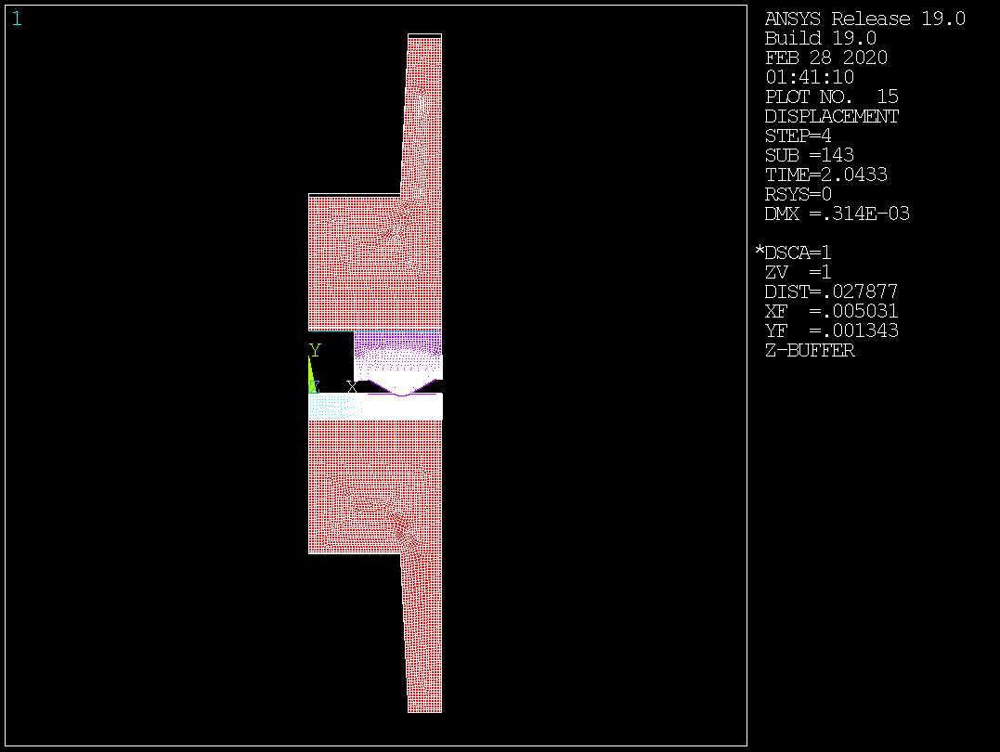

In [67]:
ansys.post1()
ansys.pldisp(2)
Image(filename='{}/{}000.png'.format(mkpath,STRUCT_FILE),height=600,width = 600)

In [68]:
ansys.save()

2020-02-28 01:41:49,504 [INFO] pyansys.mapdl: ALL CURRENT ANSYS DATA WRITTEN TO FILE NAME= Structure.db
  FOR POSSIBLE RESUME FROM THIS POINT


'ALL CURRENT ANSYS DATA WRITTEN TO FILE NAME= Structure.db\n  FOR POSSIBLE RESUME FROM THIS POINT'

#### output pressure data for ECR-calcution
- select relevant nodes
- write the require paremeters in ansys apdl
- write out the pressure data  with time  and save as csv

##### select relevant nodes

In [69]:
ansys.prep7()
ansys.allsel('all')
ansys.upgeom(1, 3, 'last', STRUCT_FILE, 'rst')

2020-02-28 01:48:35,274 [INFO] pyansys.mapdl: EXIT THE ANSYS POST1 DATABASE PROCESSOR


 ***** ROUTINE COMPLETED *****  CP =      4407.156



 *** ANSYS - ENGINEERING ANALYSIS SYSTEM  RELEASE Release 19.0     19.0     ***
 ANSYS Mechanical Enterprise
 20120530  VERSION=WINDOWS x64   01:48:35  FEB 28, 2020 CP=   4407.156





          ***** ANSYS ANALYSIS DEFINITION (PREP7) *****
2020-02-28 01:48:35,277 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02-28 01:48:35,406 [INFO] pyansys.mapdl: ELEMENT GEOMETRY WILL BE UPDATED USING THE LAST SUBSTEP OF LOADSTEP   3
   USING FILE Structure.rst
 THE SCALE FACTOR HAS BEEN SET TO   1.0000

 NODE SOLUTIONS WILL BE READ USING THE LAST SUBSTEP OF LOADSTEP   3
   USING FILE Structure.rst

 *** NOTE ***                            CP =    4407.312   TIME= 01:48:35
 Some nodes do not have displacements associated with them.  They were
 left in their initial positions.


'ELEMENT GEOMETRY WILL BE UPDATED USING THE LAST SUBSTEP OF LOADSTEP   3\n   USING FILE Structure.rst\n THE SCALE FACTOR HAS BEEN SET TO   1.0000\n\n NODE SOLUTIONS WILL BE READ USING THE LAST SUBSTEP OF LOADSTEP   3\n   USING FILE Structure.rst\n\n *** NOTE ***                            CP =    4407.312   TIME= 01:48:35\n Some nodes do not have displacements associated with them.  They were\n left in their initial positions.'

In [71]:
ansys.post1()
ansys.lsel('s', '', '', 200, 202, 1)
ansys.nsll('s', 1)
ansys.esln('s', 0)
ansys.nsle('r', 'corner')
ansys.nplot()
ansys.load_parameters()
ansys.parameters

2020-02-28 01:49:12,581 [INFO] pyansys.mapdl: You have already entered the general postprocessor (POST1).
2020-02-28 01:49:12,584 [INFO] pyansys.mapdl: SELECT       FOR ITEM=LINE COMPONENT=
  IN RANGE       200 TO        202 STEP          1

        3  LINES (OF       46  DEFINED) SELECTED BY LSEL  COMMAND.
2020-02-28 01:49:12,587 [INFO] pyansys.mapdl: SELECT      ALL NODES (INTERIOR TO LINE, AND AT KEYPOINTS)
        RELATED TO SELECTED LINE SET.

      195  NODES (OF    45009  DEFINED) SELECTED FROM
        3 SELECTED LINES BY NSLL COMMAND.
2020-02-28 01:49:12,593 [INFO] pyansys.mapdl: SELECT      ALL ELEMENTS HAVING ANY NODE IN NODAL SET.

      198 ELEMENTS (OF    15005  DEFINED) SELECTED FROM
      195 SELECTED NODES BY  ESLN COMMAND.
2020-02-28 01:49:12,596 [INFO] pyansys.mapdl: RESELECT    ALL NODES HAVING ANY ELEMENT IN ELEMENT SET.
 CONSIDER ONLY CORNER NODES

       98 NODES (OF    45009  DEFINED) SELECTED FROM
      198 SELECTED ELEMENTS BY NSLE COMMAND.
2020-02-28 01:49:12,

{'AAS_MAPDL': 1.0,
 'CNVSTP': 1.0,
 'MATDATA': 4.03e-07,
 'N1': 35579.0,
 'NRKEY': 1.0,
 'NTEMP_MAT1': 10.0,
 'NTEMP_MAT2': 10.0,
 'NTRSVX_MAT1': 61.0,
 'NTRSVX_MAT2': 44.0,
 'PERTURBKEY': -1.0,
 'TEMP_': 3273.0,
 '_RETURN': 0.0,
 '_STATUS': 1.0}

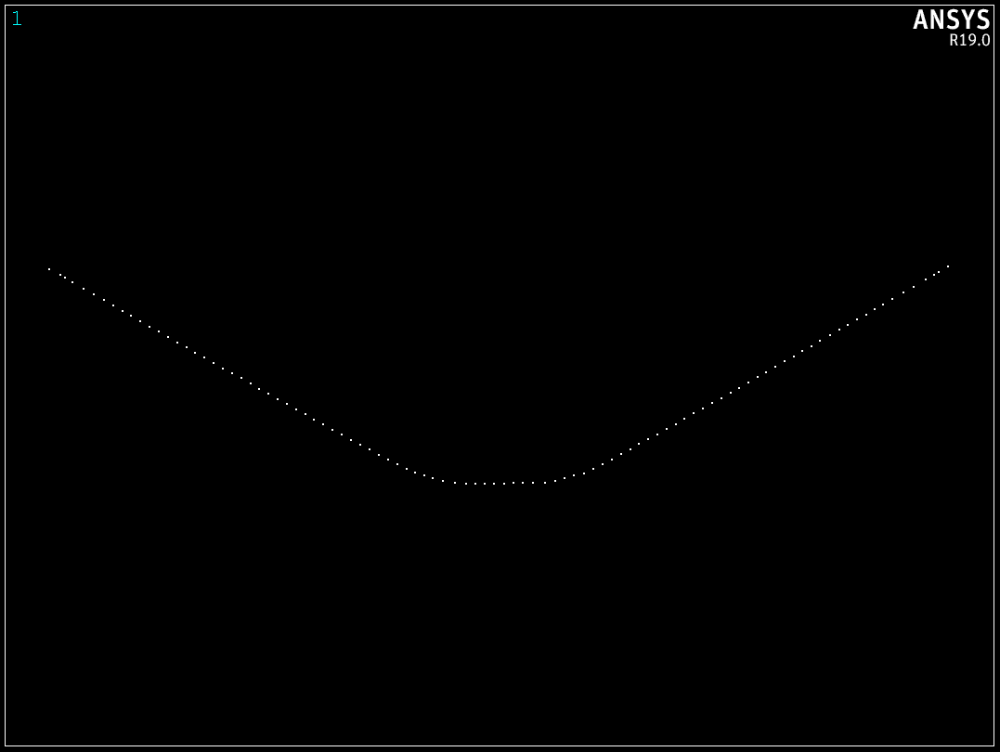

In [72]:
Image(filename='{}/{}002.png'.format(mkpath,STRUCT_FILE),height=600,width = 600)

##### write the require paremeters in ansys apdl

In [73]:
# get number of the subloadsteps
ansys.post1()
par = ['NMBR_SS_PF', 'NMBR_SS_SP', 'NMBR_SS_SWF', 'NMBR_SS_EI']
ansys.run("ND_PRES_CUR = 0")
ansys.load_parameters()
for i in range(len(par)):
    ansys.set(i + 1, 'last')
    ansys.get(par[i], 'active', 0, 'solu', 'ncmss')
    ansys.load_parameters()

NMBR_SS = sum([ansys.parameters[ele] for ele in par])
NMBR_SS_EI = ansys.parameters['NMBR_SS_EI']

ansys.get('CNTCT1_ND_NMR', 'node', 0, 'count')
ansys.get('CNTCT1_ND_MAX', 'node', 0, 'num', 'max')
ansys.get('CNTCT1_ND_MIN', 'node', 0, 'num', 'min')
ansys.dim('CNTCT1_ND_PRES', 'table', 'CNTCT1_ND_NMR', NMBR_SS_EI, '', '', 'time')
ansys.load_parameters()
ansys.parameters

2020-02-28 01:50:52,623 [INFO] pyansys.mapdl: You have already entered the general postprocessor (POST1).
2020-02-28 01:50:52,626 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 01:50:52,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4408.531   TIME= 01:50:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4408.547   TIME= 01:50:52
 Parameters written.  Lines= 246.
2020-02-28 01:50:55,057 [INFO] pyansys.mapdl: Cumulative iteration 209 may have been solved using different model or boundary condition data than currently stored.  POST1 results may be erroneous unless you RESUME from a Jobname.DB file for this substep.
 USE LOAD STEP     1  SUBSTEP  LAST    FOR LOAD CASE 0

 *** WARNING ***                         CP =    4408.547   TIME= 01:50:52
 Cumulative iteration 209 may have been solved using different model or
 boundary condition data than current

{'AAS_MAPDL': 1.0,
 'CNTCT1_ND_MAX': 13057.0,
 'CNTCT1_ND_MIN': 12864.0,
 'CNTCT1_ND_NMR': 98.0,
 'CNVSTP': 1.0,
 'MATDATA': 4.03e-07,
 'N1': 35579.0,
 'ND_PRES_CUR': 0.0,
 'NMBR_SS_EI': 143.0,
 'NMBR_SS_PF': 86.0,
 'NMBR_SS_SP': 1.0,
 'NMBR_SS_SWF': 167.0,
 'NRKEY': 1.0,
 'NTEMP_MAT1': 10.0,
 'NTEMP_MAT2': 10.0,
 'NTRSVX_MAT1': 61.0,
 'NTRSVX_MAT2': 44.0,
 'PERTURBKEY': -1.0,
 'TEMP_': 3273.0,
 '_RETURN': 0.0,
 '_STATUS': 1.0}

#####  write out the pressur data e with time and save as csv 
- durch while loop werden die Daten ausgeschrieben (<span class="mark">es dauert ziemlich lange, ich weiße aber nicht, wie die CPUs ausgenutzt werden können</span>)
- Daten erkennen
- die Daten as csv datei speichern 
- TODO: change name of dataframe

In [87]:
ansys.set(3, 'last')
ansys.uis('msgpop', 3)
pres_list = []
time_list = []
ND_list = []
df = pd.DataFrame()
CNTCT1_ND_MIN = ansys.parameters['CNTCT1_ND_MIN']
CNTCT1_ND_NMR = ansys.parameters['CNTCT1_ND_NMR']
NMBR_SS_EI = ansys.parameters['NMBR_SS_EI']

for i in range(int(NMBR_SS_EI)):
    CNTCT1_ND_CUR = CNTCT1_ND_MIN
    ansys.get('TIME_LS', 'active', 0, 'set', 'time')
    ansys.load_parameters()
    time = ansys.parameters['TIME_LS']
    time_list.append(time)
    for j in range(int(CNTCT1_ND_NMR)):
        if i == 0:
            ND_list.append(CNTCT1_ND_CUR)

        ansys.get('ND_PRES_CUR', 'node', CNTCT1_ND_CUR, 'cont', 'pres')
        ansys.load_parameters()
        pres = ansys.parameters['ND_PRES_CUR']
        pres_list.append(pres)
        ansys.get('CNTCT1_ND_CUR', 'node', CNTCT1_ND_CUR, 'nxth')
        ansys.load_parameters()
        CNTCT1_ND_CUR = ansys.parameters['CNTCT1_ND_CUR']
        ansys.run("ND_PRES_CUR = 0")

    df[time] = pres_list
    pres_list.clear()
    ansys.set('next')

2020-02-28 02:20:49,674 [INFO] pyansys.mapdl: Cumulative iteration 548 may have been solved using different model or boundary condition data than currently stored.  POST1 results may be erroneous unless you RESUME from a Jobname.DB file for this substep.
 USE LOAD STEP     3  SUBSTEP  LAST    FOR LOAD CASE 0

 *** WARNING ***                         CP =    4409.203   TIME= 02:20:49
 Cumulative iteration 548 may have been solved using different model or
 boundary condition data than currently stored.  POST1 results may be
 erroneous unless you RESUME from a Jobname.DB file for this substep.

 SET COMMAND GOT LOAD STEP=     3  SUBSTEP=   167  CUMULATIVE ITERATION=   548
   TIME/FREQUENCY=  2.0290
 TITLE=
2020-02-28 02:20:49,678 [INFO] pyansys.mapdl: MESSAGE POPUP LEVEL =    3
2020-02-28 02:20:49,681 [INFO] pyansys.mapdl: *GET  TIME_LS   FROM  ACTI  ITEM=SET  TIME  VALUE=  2.02900000
2020-02-28 02:20:49,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.359   

2020-02-28 02:20:53,980 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4409.578   TIME= 02:20:53
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:20:53,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.578   TIME= 02:20:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4409.594   TIME= 02:20:53
 Parameters written.  Lines= 3798.
2020-02-28 02:20:54,135 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12875  ITEM=NXTH       VALUE=  12877.0000
2020-02-28 02:20:54,145 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.594   TIME= 02:20:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\par

2020-02-28 02:20:56,179 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:20:56,181 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4409.781   TIME= 02:20:56
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:20:56,192 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.781   TIME= 02:20:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4409.781   TIME= 02:20:56
 Parameters written.  Lines= 3798.
2020-02-28 02:20:56,336 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12889  ITEM=NXTH       VALUE=  12891.0000
2020-02-28 02:20:56,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.79

2020-02-28 02:20:58,352 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:20:58,354 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4409.938   TIME= 02:20:58
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:20:58,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.938   TIME= 02:20:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4409.953   TIME= 02:20:58
 Parameters written.  Lines= 3798.
2020-02-28 02:20:58,510 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12903  ITEM=NXTH       VALUE=  12905.0000
2020-02-28 02:20:58,521 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4409.95

2020-02-28 02:21:00,526 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:00,528 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4410.078   TIME= 02:21:00
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:00,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.078   TIME= 02:21:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.094   TIME= 02:21:00
 Parameters written.  Lines= 3798.
2020-02-28 02:21:00,696 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12917  ITEM=NXTH       VALUE=  12919.0000
2020-02-28 02:21:00,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.09

2020-02-28 02:21:02,735 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:02,738 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4410.250   TIME= 02:21:02
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:02,749 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.266   TIME= 02:21:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.266   TIME= 02:21:02
 Parameters written.  Lines= 3798.
2020-02-28 02:21:02,885 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12931  ITEM=NXTH       VALUE=  12933.0000
2020-02-28 02:21:02,896 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.26

2020-02-28 02:21:05,336 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 02:21:05,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.484   TIME= 02:21:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.484   TIME= 02:21:05
 Parameters written.  Lines= 3798.
2020-02-28 02:21:05,486 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:05,489 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12949  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:21:05,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.516   TIME= 02:21:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.516   TIME= 02:21:05
 Parameters written.  Lines= 3798.
2020-02-28 02:21:05,648 [INFO] pyansys.mapd

2020-02-28 02:21:07,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.641   TIME= 02:21:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.656   TIME= 02:21:07
 Parameters written.  Lines= 3798.
2020-02-28 02:21:08,133 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 02:21:08,144 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.656   TIME= 02:21:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.656   TIME= 02:21:08
 Parameters written.  Lines= 3798.
2020-02-28 02:21:08,290 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:08,293 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12967  ITEM=CONT PRES  VALUE=  235104736.
2020-02-28 02:21:08,303 [INFO] pyansys.mapd

2020-02-28 02:21:10,653 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 02:21:10,664 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.859   TIME= 02:21:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.875   TIME= 02:21:10
 Parameters written.  Lines= 3798.
2020-02-28 02:21:10,806 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:10,808 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12983  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:21:10,819 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4410.875   TIME= 02:21:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4410.891   TIME= 02:21:10
 Parameters written.  Lines= 3798.
2020-02-28 02:21:10,965 [INFO] pyansys.mapd

2020-02-28 02:21:13,190 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:21:13,201 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.062   TIME= 02:21:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4411.062   TIME= 02:21:13
 Parameters written.  Lines= 3798.
2020-02-28 02:21:13,338 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:13,340 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4411.062   TIME= 02:21:13
 Requested data is not stored for node 12999.
  Line= *GET, ND_PRES_, node, 12999.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:13,351 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.06

2020-02-28 02:21:15,360 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:21:15,371 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.250   TIME= 02:21:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4411.266   TIME= 02:21:15
 Parameters written.  Lines= 3798.
2020-02-28 02:21:15,516 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:15,518 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4411.266   TIME= 02:21:15
 Requested data is not stored for node 13013.
  Line= *GET, ND_PRES_, node, 13013.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:15,529 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.26

2020-02-28 02:21:17,501 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:21:17,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.406   TIME= 02:21:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4411.406   TIME= 02:21:17
 Parameters written.  Lines= 3798.
2020-02-28 02:21:17,658 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:17,661 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4411.422   TIME= 02:21:17
 Requested data is not stored for node 13027.
  Line= *GET, ND_PRES_, node, 13027.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:17,672 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.42

2020-02-28 02:21:19,655 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:21:19,666 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.578   TIME= 02:21:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4411.594   TIME= 02:21:19
 Parameters written.  Lines= 3798.
2020-02-28 02:21:19,809 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:19,811 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4411.594   TIME= 02:21:19
 Requested data is not stored for node 13041.
  Line= *GET, ND_PRES_, node, 13041.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:19,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.59

2020-02-28 02:21:21,815 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:21:21,840 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.719   TIME= 02:21:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4411.750   TIME= 02:21:21
 Parameters written.  Lines= 3798.
2020-02-28 02:21:21,980 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:21,982 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4411.750   TIME= 02:21:21
 Requested data is not stored for node 13055.
  Line= *GET, ND_PRES_, node, 13055.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:21,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4411.75

2020-02-28 02:21:24,194 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:24,205 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4412.094   TIME= 02:21:24
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:24,216 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.094   TIME= 02:21:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4412.109   TIME= 02:21:24
 Parameters written.  Lines= 3798.
2020-02-28 02:21:24,344 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12871  ITEM=NXTH       VALUE=  12873.0000
2020-02-28 02:21:24,367 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.10

2020-02-28 02:21:26,350 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:26,352 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4412.328   TIME= 02:21:26
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:26,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.328   TIME= 02:21:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4412.328   TIME= 02:21:26
 Parameters written.  Lines= 3798.
2020-02-28 02:21:26,502 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12885  ITEM=NXTH       VALUE=  12887.0000
2020-02-28 02:21:26,513 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.32

2020-02-28 02:21:28,487 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:28,489 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4412.500   TIME= 02:21:28
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:28,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.500   TIME= 02:21:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4412.500   TIME= 02:21:28
 Parameters written.  Lines= 3798.
2020-02-28 02:21:28,637 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12899  ITEM=NXTH       VALUE=  12901.0000
2020-02-28 02:21:28,651 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.50

2020-02-28 02:21:30,622 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:30,622 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4412.688   TIME= 02:21:30
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:30,646 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.688   TIME= 02:21:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4412.703   TIME= 02:21:30
 Parameters written.  Lines= 3798.
2020-02-28 02:21:30,778 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12913  ITEM=NXTH       VALUE=  12915.0000
2020-02-28 02:21:30,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.70

2020-02-28 02:21:32,762 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:32,764 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4412.859   TIME= 02:21:32
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:32,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.859   TIME= 02:21:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4412.875   TIME= 02:21:32
 Parameters written.  Lines= 3798.
2020-02-28 02:21:32,910 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12927  ITEM=NXTH       VALUE=  12929.0000
2020-02-28 02:21:32,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4412.89

2020-02-28 02:21:35,202 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:35,204 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:21:35,215 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.125   TIME= 02:21:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.141   TIME= 02:21:35
 Parameters written.  Lines= 3798.
2020-02-28 02:21:35,354 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 02:21:35,365 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.141   TIME= 02:21:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.156   TIME= 02:21:35
 Parameters written.  Lines= 3798.
2020-02-28 02:21:35,501 [INFO] pyansys.mapd

2020-02-28 02:21:37,838 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.328   TIME= 02:21:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.344   TIME= 02:21:37
 Parameters written.  Lines= 3798.
2020-02-28 02:21:37,986 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:37,988 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  337720032.
2020-02-28 02:21:38,000 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.344   TIME= 02:21:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.344   TIME= 02:21:37
 Parameters written.  Lines= 3798.
2020-02-28 02:21:38,142 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12961  ITEM=NXTH       VALUE=  12963.0000
2020-02-28 02:21:38,153 [INFO] pyansys.mapd

2020-02-28 02:21:40,449 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:40,451 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  506425856.
2020-02-28 02:21:40,463 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.516   TIME= 02:21:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.531   TIME= 02:21:40
 Parameters written.  Lines= 3798.
2020-02-28 02:21:40,601 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 02:21:40,615 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.531   TIME= 02:21:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.547   TIME= 02:21:40
 Parameters written.  Lines= 3798.
2020-02-28 02:21:40,758 [INFO] pyansys.mapd

2020-02-28 02:21:43,089 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:21:43,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.750   TIME= 02:21:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.766   TIME= 02:21:43
 Parameters written.  Lines= 3798.
2020-02-28 02:21:43,244 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:43,247 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4413.766   TIME= 02:21:43
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:43,258 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.76

2020-02-28 02:21:45,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 02:21:45,278 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.953   TIME= 02:21:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4413.969   TIME= 02:21:45
 Parameters written.  Lines= 3798.
2020-02-28 02:21:45,426 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:45,428 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4413.984   TIME= 02:21:45
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:45,439 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4413.98

2020-02-28 02:21:47,494 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 02:21:47,505 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.141   TIME= 02:21:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4414.156   TIME= 02:21:47
 Parameters written.  Lines= 3798.
2020-02-28 02:21:47,648 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:47,650 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4414.156   TIME= 02:21:47
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:47,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.15

2020-02-28 02:21:49,673 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 02:21:49,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.344   TIME= 02:21:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4414.359   TIME= 02:21:49
 Parameters written.  Lines= 3798.
2020-02-28 02:21:49,830 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:49,833 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4414.359   TIME= 02:21:49
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:49,845 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.35

2020-02-28 02:21:51,888 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 02:21:51,899 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.516   TIME= 02:21:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4414.531   TIME= 02:21:51
 Parameters written.  Lines= 3798.
2020-02-28 02:21:52,061 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:52,064 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4414.531   TIME= 02:21:52
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:52,075 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.53

2020-02-28 02:21:54,320 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:54,320 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4414.891   TIME= 02:21:54
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:54,334 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.891   TIME= 02:21:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4414.906   TIME= 02:21:54
 Parameters written.  Lines= 3798.
2020-02-28 02:21:54,458 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 02:21:54,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4414.90

2020-02-28 02:21:56,460 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:56,462 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4415.078   TIME= 02:21:56
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:56,473 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.078   TIME= 02:21:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.094   TIME= 02:21:56
 Parameters written.  Lines= 3798.
2020-02-28 02:21:56,610 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:21:56,622 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.09

2020-02-28 02:21:58,580 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:21:58,582 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4415.266   TIME= 02:21:58
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:21:58,593 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.281   TIME= 02:21:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.281   TIME= 02:21:58
 Parameters written.  Lines= 3798.
2020-02-28 02:21:58,736 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:21:58,747 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.28

2020-02-28 02:22:00,699 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:00,701 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4415.516   TIME= 02:22:00
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:00,712 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.516   TIME= 02:22:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.531   TIME= 02:22:00
 Parameters written.  Lines= 3798.
2020-02-28 02:22:00,843 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:22:00,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.53

2020-02-28 02:22:02,842 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:02,844 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4415.688   TIME= 02:22:02
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:02,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.688   TIME= 02:22:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.703   TIME= 02:22:02
 Parameters written.  Lines= 3798.
2020-02-28 02:22:02,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:22:03,002 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.70

2020-02-28 02:22:05,148 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 02:22:05,160 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.859   TIME= 02:22:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.859   TIME= 02:22:05
 Parameters written.  Lines= 3798.
2020-02-28 02:22:05,302 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:05,304 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:22:05,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4415.891   TIME= 02:22:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4415.906   TIME= 02:22:05
 Parameters written.  Lines= 3798.
2020-02-28 02:22:05,455 [INFO] pyansys.mapd

2020-02-28 02:22:07,784 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.109   TIME= 02:22:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.109   TIME= 02:22:07
 Parameters written.  Lines= 3798.
2020-02-28 02:22:07,922 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 02:22:07,933 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.109   TIME= 02:22:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.125   TIME= 02:22:07
 Parameters written.  Lines= 3798.
2020-02-28 02:22:08,071 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:08,073 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  663591744.
2020-02-28 02:22:08,084 [INFO] pyansys.mapd

2020-02-28 02:22:10,380 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 02:22:10,391 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.266   TIME= 02:22:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.266   TIME= 02:22:10
 Parameters written.  Lines= 3798.
2020-02-28 02:22:10,529 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:10,531 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  769263744.
2020-02-28 02:22:10,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.266   TIME= 02:22:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.281   TIME= 02:22:10
 Parameters written.  Lines= 3798.
2020-02-28 02:22:10,685 [INFO] pyansys.mapd

2020-02-28 02:22:13,009 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.500   TIME= 02:22:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.516   TIME= 02:22:13
 Parameters written.  Lines= 3798.
2020-02-28 02:22:13,144 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 02:22:13,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.516   TIME= 02:22:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.531   TIME= 02:22:13
 Parameters written.  Lines= 3798.
2020-02-28 02:22:13,295 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:13,295 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:22:13,312 [INFO] pyansys.mapd

2020-02-28 02:22:15,142 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.688   TIME= 02:22:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.688   TIME= 02:22:15
 Parameters written.  Lines= 3798.
2020-02-28 02:22:15,290 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 02:22:15,301 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.688   TIME= 02:22:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.688   TIME= 02:22:15
 Parameters written.  Lines= 3798.
2020-02-28 02:22:15,441 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:15,444 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command i

2020-02-28 02:22:17,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.875   TIME= 02:22:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.891   TIME= 02:22:17
 Parameters written.  Lines= 3798.
2020-02-28 02:22:17,447 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:22:17,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4416.891   TIME= 02:22:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4416.906   TIME= 02:22:17
 Parameters written.  Lines= 3798.
2020-02-28 02:22:17,609 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:17,611 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command i

2020-02-28 02:22:19,522 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.047   TIME= 02:22:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.062   TIME= 02:22:19
 Parameters written.  Lines= 3798.
2020-02-28 02:22:19,670 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:22:19,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.062   TIME= 02:22:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.078   TIME= 02:22:19
 Parameters written.  Lines= 3798.
2020-02-28 02:22:19,855 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:19,857 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command i

2020-02-28 02:22:21,763 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.234   TIME= 02:22:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.234   TIME= 02:22:21
 Parameters written.  Lines= 3798.
2020-02-28 02:22:21,907 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:22:21,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.234   TIME= 02:22:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.250   TIME= 02:22:21
 Parameters written.  Lines= 3798.
2020-02-28 02:22:22,070 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:22,073 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command i

2020-02-28 02:22:23,930 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:24,073 [INFO] pyansys.mapdl: USE NEXT SUBSTEP ON RESULT FILE  FOR LOAD CASE 0

 SET COMMAND GOT LOAD STEP=     4  SUBSTEP=     3  CUMULATIVE ITERATION=   554
   TIME/FREQUENCY=  2.0293
 TITLE=
2020-02-28 02:22:24,075 [INFO] pyansys.mapdl: *GET  TIME_LS   FROM  ACTI  ITEM=SET  TIME  VALUE=  2.02930000
2020-02-28 02:22:24,086 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.516   TIME= 02:22:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.531   TIME= 02:22:24
 Parameters written.  Lines= 3798.
2020-02-28 02:22:24,303 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4417.594   TIME= 02:22:24
 Requested data is not stored for

2020-02-28 02:22:26,338 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12875  ITEM=NXTH       VALUE=  12877.0000
2020-02-28 02:22:26,350 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.719   TIME= 02:22:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.734   TIME= 02:22:26
 Parameters written.  Lines= 3798.
2020-02-28 02:22:26,494 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:26,496 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4417.734   TIME= 02:22:26
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:26,507 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.73

2020-02-28 02:22:28,545 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12889  ITEM=NXTH       VALUE=  12891.0000
2020-02-28 02:22:28,556 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.875   TIME= 02:22:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4417.891   TIME= 02:22:28
 Parameters written.  Lines= 3798.
2020-02-28 02:22:28,689 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:28,689 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4417.891   TIME= 02:22:28
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:28,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4417.89

2020-02-28 02:22:30,713 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12903  ITEM=NXTH       VALUE=  12905.0000
2020-02-28 02:22:30,727 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.016   TIME= 02:22:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.031   TIME= 02:22:30
 Parameters written.  Lines= 3798.
2020-02-28 02:22:30,875 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:30,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4418.031   TIME= 02:22:30
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:30,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.03

2020-02-28 02:22:32,881 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12917  ITEM=NXTH       VALUE=  12919.0000
2020-02-28 02:22:32,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.156   TIME= 02:22:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.156   TIME= 02:22:32
 Parameters written.  Lines= 3798.
2020-02-28 02:22:33,031 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:33,034 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4418.156   TIME= 02:22:33
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:33,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.15

2020-02-28 02:22:35,021 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12931  ITEM=NXTH       VALUE=  12933.0000
2020-02-28 02:22:35,031 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.312   TIME= 02:22:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.312   TIME= 02:22:35
 Parameters written.  Lines= 3798.
2020-02-28 02:22:35,174 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:35,175 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:22:35,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.312   TIME= 02:22:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.312   TIME= 02:22:35
 Parameters written.  Lines= 3798.
2020-02-28 02:22:35,333 [INFO] pyansys.mapd

2020-02-28 02:22:37,647 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.516   TIME= 02:22:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.531   TIME= 02:22:37
 Parameters written.  Lines= 3798.
2020-02-28 02:22:37,794 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12949  ITEM=NXTH       VALUE=  12951.0000
2020-02-28 02:22:37,805 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.531   TIME= 02:22:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.547   TIME= 02:22:37
 Parameters written.  Lines= 3798.
2020-02-28 02:22:37,942 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:37,942 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  439722688.
2020-02-28 02:22:37,958 [INFO] pyansys.mapd

2020-02-28 02:22:40,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:40,405 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12967  ITEM=CONT PRES  VALUE=  234025856.
2020-02-28 02:22:40,416 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.719   TIME= 02:22:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.734   TIME= 02:22:40
 Parameters written.  Lines= 3798.
2020-02-28 02:22:40,554 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:22:40,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.734   TIME= 02:22:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.734   TIME= 02:22:40
 Parameters written.  Lines= 3798.
2020-02-28 02:22:40,707 [INFO] pyansys.mapd

2020-02-28 02:22:43,287 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12983  ITEM=NXTH       VALUE=  12985.0000
2020-02-28 02:22:43,298 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.938   TIME= 02:22:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.938   TIME= 02:22:43
 Parameters written.  Lines= 3798.
2020-02-28 02:22:43,438 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:43,440 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:22:43,451 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4418.938   TIME= 02:22:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4418.938   TIME= 02:22:43
 Parameters written.  Lines= 3798.
2020-02-28 02:22:43,589 [INFO] pyansys.mapd

2020-02-28 02:22:45,595 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.109   TIME= 02:22:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.109   TIME= 02:22:45
 Parameters written.  Lines= 3798.
2020-02-28 02:22:45,739 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:22:45,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.109   TIME= 02:22:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.109   TIME= 02:22:45
 Parameters written.  Lines= 3798.
2020-02-28 02:22:45,893 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:45,895 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command i

2020-02-28 02:22:47,790 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.250   TIME= 02:22:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.266   TIME= 02:22:47
 Parameters written.  Lines= 3798.
2020-02-28 02:22:47,932 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:22:47,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.266   TIME= 02:22:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.281   TIME= 02:22:47
 Parameters written.  Lines= 3798.
2020-02-28 02:22:48,082 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:48,084 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command i

2020-02-28 02:22:49,942 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.391   TIME= 02:22:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.406   TIME= 02:22:49
 Parameters written.  Lines= 3798.
2020-02-28 02:22:50,079 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:22:50,090 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.406   TIME= 02:22:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.422   TIME= 02:22:50
 Parameters written.  Lines= 3798.
2020-02-28 02:22:50,223 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:50,223 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command i

2020-02-28 02:22:52,080 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.625   TIME= 02:22:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.625   TIME= 02:22:52
 Parameters written.  Lines= 3798.
2020-02-28 02:22:52,222 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:22:52,234 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.625   TIME= 02:22:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.625   TIME= 02:22:52
 Parameters written.  Lines= 3798.
2020-02-28 02:22:52,382 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:52,385 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command i

2020-02-28 02:22:54,241 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.750   TIME= 02:22:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.766   TIME= 02:22:54
 Parameters written.  Lines= 3798.
2020-02-28 02:22:54,391 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:22:54,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4419.766   TIME= 02:22:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4419.781   TIME= 02:22:54
 Parameters written.  Lines= 3798.
2020-02-28 02:22:54,542 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:54,544 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command i

2020-02-28 02:22:56,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.141   TIME= 02:22:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.156   TIME= 02:22:56
 Parameters written.  Lines= 3798.
2020-02-28 02:22:56,801 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:56,801 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4420.156   TIME= 02:22:56
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:56,819 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.156   TIME= 02:22:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:22:58,788 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12885  ITEM=NXTH       VALUE=  12887.0000
2020-02-28 02:22:58,799 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.297   TIME= 02:22:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.297   TIME= 02:22:58
 Parameters written.  Lines= 3798.
2020-02-28 02:22:58,940 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:22:58,942 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4420.312   TIME= 02:22:58
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:22:58,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.31

2020-02-28 02:23:00,973 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12899  ITEM=NXTH       VALUE=  12901.0000
2020-02-28 02:23:00,985 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.438   TIME= 02:23:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.438   TIME= 02:23:00
 Parameters written.  Lines= 3798.
2020-02-28 02:23:01,124 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:01,127 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4420.438   TIME= 02:23:01
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:01,138 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.43

2020-02-28 02:23:03,112 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12913  ITEM=NXTH       VALUE=  12915.0000
2020-02-28 02:23:03,124 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.594   TIME= 02:23:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.609   TIME= 02:23:03
 Parameters written.  Lines= 3798.
2020-02-28 02:23:03,268 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:03,271 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4420.609   TIME= 02:23:03
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:03,283 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.62

2020-02-28 02:23:05,289 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12927  ITEM=NXTH       VALUE=  12929.0000
2020-02-28 02:23:05,300 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.703   TIME= 02:23:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.703   TIME= 02:23:05
 Parameters written.  Lines= 3798.
2020-02-28 02:23:05,443 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:05,445 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4420.719   TIME= 02:23:05
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:05,460 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.71

2020-02-28 02:23:07,811 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.906   TIME= 02:23:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.906   TIME= 02:23:07
 Parameters written.  Lines= 3798.
2020-02-28 02:23:07,944 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:07,944 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  418854784.
2020-02-28 02:23:07,964 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4420.906   TIME= 02:23:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4420.922   TIME= 02:23:07
 Parameters written.  Lines= 3798.
2020-02-28 02:23:08,093 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:23:08,113 [INFO] pyansys.mapd

2020-02-28 02:23:10,577 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12961  ITEM=NXTH       VALUE=  12963.0000
2020-02-28 02:23:10,588 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.109   TIME= 02:23:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.125   TIME= 02:23:10
 Parameters written.  Lines= 3798.
2020-02-28 02:23:10,727 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:10,728 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  599326144.
2020-02-28 02:23:10,739 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.125   TIME= 02:23:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.141   TIME= 02:23:10
 Parameters written.  Lines= 3798.
2020-02-28 02:23:10,884 [INFO] pyansys.mapd

2020-02-28 02:23:13,200 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:13,202 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  536304544.
2020-02-28 02:23:13,214 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.312   TIME= 02:23:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.328   TIME= 02:23:13
 Parameters written.  Lines= 3798.
2020-02-28 02:23:13,358 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:23:13,368 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.328   TIME= 02:23:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.344   TIME= 02:23:13
 Parameters written.  Lines= 3798.
2020-02-28 02:23:13,508 [INFO] pyansys.mapd

2020-02-28 02:23:15,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.547   TIME= 02:23:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.562   TIME= 02:23:15
 Parameters written.  Lines= 3798.
2020-02-28 02:23:15,840 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:23:15,850 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.562   TIME= 02:23:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.578   TIME= 02:23:15
 Parameters written.  Lines= 3798.
2020-02-28 02:23:15,991 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:15,993 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:23:17,886 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.766   TIME= 02:23:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.781   TIME= 02:23:17
 Parameters written.  Lines= 3798.
2020-02-28 02:23:18,032 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:23:18,043 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.781   TIME= 02:23:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.797   TIME= 02:23:18
 Parameters written.  Lines= 3798.
2020-02-28 02:23:18,182 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:18,184 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:23:20,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.953   TIME= 02:23:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.953   TIME= 02:23:20
 Parameters written.  Lines= 3798.
2020-02-28 02:23:20,203 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:23:20,214 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4421.953   TIME= 02:23:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4421.969   TIME= 02:23:20
 Parameters written.  Lines= 3798.
2020-02-28 02:23:20,366 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:20,368 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:23:22,263 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.156   TIME= 02:23:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.156   TIME= 02:23:22
 Parameters written.  Lines= 3798.
2020-02-28 02:23:22,410 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:23:22,421 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.172   TIME= 02:23:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.172   TIME= 02:23:22
 Parameters written.  Lines= 3798.
2020-02-28 02:23:22,569 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:22,572 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:23:24,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.312   TIME= 02:23:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.312   TIME= 02:23:24
 Parameters written.  Lines= 3798.
2020-02-28 02:23:24,595 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:23:24,606 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.312   TIME= 02:23:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.328   TIME= 02:23:24
 Parameters written.  Lines= 3798.
2020-02-28 02:23:24,744 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:24,746 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:23:26,841 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.641   TIME= 02:23:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.641   TIME= 02:23:26
 Parameters written.  Lines= 3798.
2020-02-28 02:23:26,982 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:26,984 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4422.641   TIME= 02:23:26
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:26,994 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.641   TIME= 02:23:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:23:29,041 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:23:29,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.844   TIME= 02:23:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4422.859   TIME= 02:23:29
 Parameters written.  Lines= 3798.
2020-02-28 02:23:29,194 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:29,196 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4422.859   TIME= 02:23:29
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:29,206 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4422.85

2020-02-28 02:23:31,235 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:23:31,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.016   TIME= 02:23:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.047   TIME= 02:23:31
 Parameters written.  Lines= 3798.
2020-02-28 02:23:31,415 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:31,417 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4423.047   TIME= 02:23:31
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:31,428 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.04

2020-02-28 02:23:33,413 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:23:33,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.234   TIME= 02:23:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.234   TIME= 02:23:33
 Parameters written.  Lines= 3798.
2020-02-28 02:23:33,566 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:33,568 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4423.250   TIME= 02:23:33
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:33,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.25

2020-02-28 02:23:35,592 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:23:35,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.375   TIME= 02:23:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.391   TIME= 02:23:35
 Parameters written.  Lines= 3798.
2020-02-28 02:23:35,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:35,744 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4423.391   TIME= 02:23:35
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:35,754 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.39

2020-02-28 02:23:37,905 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:23:37,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.531   TIME= 02:23:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.547   TIME= 02:23:37
 Parameters written.  Lines= 3798.
2020-02-28 02:23:38,056 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:23:38,067 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.562   TIME= 02:23:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.578   TIME= 02:23:38
 Parameters written.  Lines= 3798.
2020-02-28 02:23:38,190 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:38,205 [INFO] pyansys.mapd

2020-02-28 02:23:40,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.719   TIME= 02:23:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.719   TIME= 02:23:40
 Parameters written.  Lines= 3798.
2020-02-28 02:23:40,703 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:40,705 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  662074176.
2020-02-28 02:23:40,716 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.719   TIME= 02:23:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.734   TIME= 02:23:40
 Parameters written.  Lines= 3798.
2020-02-28 02:23:40,860 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:23:40,871 [INFO] pyansys.mapd

2020-02-28 02:23:43,213 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:43,215 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  771378176.
2020-02-28 02:23:43,226 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.828   TIME= 02:23:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.844   TIME= 02:23:43
 Parameters written.  Lines= 3798.
2020-02-28 02:23:43,377 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:23:43,388 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4423.844   TIME= 02:23:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4423.844   TIME= 02:23:43
 Parameters written.  Lines= 3798.
2020-02-28 02:23:43,530 [INFO] pyansys.mapd

2020-02-28 02:23:45,910 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.031   TIME= 02:23:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.047   TIME= 02:23:45
 Parameters written.  Lines= 3798.
2020-02-28 02:23:46,043 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:46,043 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:23:46,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.062   TIME= 02:23:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.062   TIME= 02:23:46
 Parameters written.  Lines= 3798.
2020-02-28 02:23:46,195 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:23:46,215 [INFO] pyansys.mapd

2020-02-28 02:23:48,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.219   TIME= 02:23:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.219   TIME= 02:23:48
 Parameters written.  Lines= 3798.
2020-02-28 02:23:48,241 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:48,244 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4424.219   TIME= 02:23:48
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:48,255 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.219   TIME= 02:23:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:23:50,266 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:23:50,278 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.375   TIME= 02:23:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.391   TIME= 02:23:50
 Parameters written.  Lines= 3798.
2020-02-28 02:23:50,422 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:50,424 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4424.391   TIME= 02:23:50
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:50,434 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.39

2020-02-28 02:23:52,436 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:23:52,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.516   TIME= 02:23:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.531   TIME= 02:23:52
 Parameters written.  Lines= 3798.
2020-02-28 02:23:52,584 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:52,587 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4424.531   TIME= 02:23:52
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:52,600 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.53

2020-02-28 02:23:54,610 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:23:54,621 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.688   TIME= 02:23:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4424.703   TIME= 02:23:54
 Parameters written.  Lines= 3798.
2020-02-28 02:23:54,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:54,763 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4424.703   TIME= 02:23:54
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:54,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4424.70

2020-02-28 02:23:56,783 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.016   TIME= 02:23:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.016   TIME= 02:23:56
 Parameters written.  Lines= 3798.
2020-02-28 02:23:57,007 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4425.062   TIME= 02:23:57
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:57,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.062   TIME= 02:23:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.062   TIME= 02:23:57
 Parameters written.  Lines= 379

2020-02-28 02:23:59,214 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:23:59,217 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4425.281   TIME= 02:23:59
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:23:59,228 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.281   TIME= 02:23:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.297   TIME= 02:23:59
 Parameters written.  Lines= 3798.
2020-02-28 02:23:59,371 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:23:59,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.29

2020-02-28 02:24:01,385 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:01,388 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4425.422   TIME= 02:24:01
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:01,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.422   TIME= 02:24:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.438   TIME= 02:24:01
 Parameters written.  Lines= 3798.
2020-02-28 02:24:01,545 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:24:01,555 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.43

2020-02-28 02:24:03,566 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:03,568 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4425.562   TIME= 02:24:03
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:03,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.562   TIME= 02:24:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.562   TIME= 02:24:03
 Parameters written.  Lines= 3798.
2020-02-28 02:24:03,714 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:24:03,725 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.56

2020-02-28 02:24:05,698 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:05,698 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4425.781   TIME= 02:24:05
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:05,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.781   TIME= 02:24:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.797   TIME= 02:24:05
 Parameters written.  Lines= 3798.
2020-02-28 02:24:05,856 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:24:05,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.79

2020-02-28 02:24:07,858 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:07,860 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:24:07,871 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.969   TIME= 02:24:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4425.984   TIME= 02:24:07
 Parameters written.  Lines= 3798.
2020-02-28 02:24:08,013 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:24:08,024 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4425.984   TIME= 02:24:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.000   TIME= 02:24:08
 Parameters written.  Lines= 3798.
2020-02-28 02:24:08,163 [INFO] pyansys.mapd

2020-02-28 02:24:10,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.141   TIME= 02:24:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.156   TIME= 02:24:10
 Parameters written.  Lines= 3798.
2020-02-28 02:24:10,637 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:10,639 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  412155072.
2020-02-28 02:24:10,650 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.156   TIME= 02:24:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.172   TIME= 02:24:10
 Parameters written.  Lines= 3798.
2020-02-28 02:24:10,801 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:24:10,818 [INFO] pyansys.mapd

2020-02-28 02:24:13,306 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:24:13,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.422   TIME= 02:24:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.438   TIME= 02:24:13
 Parameters written.  Lines= 3798.
2020-02-28 02:24:13,467 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:13,470 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  361997600.
2020-02-28 02:24:13,481 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.438   TIME= 02:24:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.453   TIME= 02:24:13
 Parameters written.  Lines= 3798.
2020-02-28 02:24:13,621 [INFO] pyansys.mapd

2020-02-28 02:24:15,950 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:15,952 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:24:15,967 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.625   TIME= 02:24:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.641   TIME= 02:24:15
 Parameters written.  Lines= 3798.
2020-02-28 02:24:16,107 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:24:16,118 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.641   TIME= 02:24:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.656   TIME= 02:24:16
 Parameters written.  Lines= 3798.
2020-02-28 02:24:16,257 [INFO] pyansys.mapd

2020-02-28 02:24:18,283 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:24:18,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.797   TIME= 02:24:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.812   TIME= 02:24:18
 Parameters written.  Lines= 3798.
2020-02-28 02:24:18,480 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:18,482 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4426.812   TIME= 02:24:18
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:18,493 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.81

2020-02-28 02:24:20,500 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:24:20,511 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.953   TIME= 02:24:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4426.969   TIME= 02:24:20
 Parameters written.  Lines= 3798.
2020-02-28 02:24:20,651 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:20,654 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4426.969   TIME= 02:24:20
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:20,664 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4426.96

2020-02-28 02:24:22,691 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:24:22,703 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.188   TIME= 02:24:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4427.188   TIME= 02:24:22
 Parameters written.  Lines= 3798.
2020-02-28 02:24:22,845 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:22,847 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4427.188   TIME= 02:24:22
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:22,858 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.18

2020-02-28 02:24:24,933 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:24:24,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.328   TIME= 02:24:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4427.344   TIME= 02:24:24
 Parameters written.  Lines= 3798.
2020-02-28 02:24:25,081 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:25,084 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4427.359   TIME= 02:24:25
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:25,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.35

2020-02-28 02:24:27,108 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:24:27,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.422   TIME= 02:24:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4427.438   TIME= 02:24:27
 Parameters written.  Lines= 3798.
2020-02-28 02:24:27,278 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:27,280 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4427.438   TIME= 02:24:27
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:27,292 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.43

2020-02-28 02:24:29,540 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:29,542 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4427.750   TIME= 02:24:29
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:29,558 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.750   TIME= 02:24:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4427.766   TIME= 02:24:29
 Parameters written.  Lines= 3798.
2020-02-28 02:24:29,713 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:24:29,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.76

2020-02-28 02:24:31,725 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:31,725 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4427.891   TIME= 02:24:31
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:31,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.891   TIME= 02:24:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4427.906   TIME= 02:24:31
 Parameters written.  Lines= 3798.
2020-02-28 02:24:31,891 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:24:31,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4427.90

2020-02-28 02:24:33,939 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:33,939 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4428.031   TIME= 02:24:33
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:33,945 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.031   TIME= 02:24:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.031   TIME= 02:24:33
 Parameters written.  Lines= 3798.
2020-02-28 02:24:34,096 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:24:34,107 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.04

2020-02-28 02:24:36,135 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:36,138 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4428.219   TIME= 02:24:36
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:36,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.219   TIME= 02:24:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.234   TIME= 02:24:36
 Parameters written.  Lines= 3798.
2020-02-28 02:24:36,288 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:24:36,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.23

2020-02-28 02:24:38,300 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:38,303 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4428.391   TIME= 02:24:38
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:24:38,313 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.391   TIME= 02:24:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.391   TIME= 02:24:38
 Parameters written.  Lines= 3798.
2020-02-28 02:24:38,468 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:24:38,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.39

2020-02-28 02:24:40,793 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  437996736.
2020-02-28 02:24:40,805 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.578   TIME= 02:24:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.594   TIME= 02:24:40
 Parameters written.  Lines= 3798.
2020-02-28 02:24:40,961 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:24:40,972 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.594   TIME= 02:24:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.594   TIME= 02:24:40
 Parameters written.  Lines= 3798.
2020-02-28 02:24:41,121 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:41,124 [INFO] pyansys.mapd

2020-02-28 02:24:43,632 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.844   TIME= 02:24:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.875   TIME= 02:24:43
 Parameters written.  Lines= 3798.
2020-02-28 02:24:43,776 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:43,776 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  593925184.
2020-02-28 02:24:43,790 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4428.891   TIME= 02:24:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4428.906   TIME= 02:24:43
 Parameters written.  Lines= 3798.
2020-02-28 02:24:43,937 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:24:43,949 [INFO] pyansys.mapd

2020-02-28 02:24:46,363 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:46,366 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  513872320.
2020-02-28 02:24:46,381 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.156   TIME= 02:24:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.172   TIME= 02:24:46
 Parameters written.  Lines= 3798.
2020-02-28 02:24:46,530 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:24:46,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.172   TIME= 02:24:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.188   TIME= 02:24:46
 Parameters written.  Lines= 3798.
2020-02-28 02:24:46,691 [INFO] pyansys.mapd

2020-02-28 02:24:48,946 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.406   TIME= 02:24:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.422   TIME= 02:24:48
 Parameters written.  Lines= 3798.
2020-02-28 02:24:49,087 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:24:49,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.422   TIME= 02:24:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.422   TIME= 02:24:49
 Parameters written.  Lines= 3798.
2020-02-28 02:24:49,239 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:49,241 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:24:51,210 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.703   TIME= 02:24:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.719   TIME= 02:24:51
 Parameters written.  Lines= 3798.
2020-02-28 02:24:51,355 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:24:51,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.719   TIME= 02:24:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.734   TIME= 02:24:51
 Parameters written.  Lines= 3798.
2020-02-28 02:24:51,522 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:51,525 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:24:53,418 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.922   TIME= 02:24:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.922   TIME= 02:24:53
 Parameters written.  Lines= 3798.
2020-02-28 02:24:53,574 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:24:53,587 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4429.922   TIME= 02:24:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4429.938   TIME= 02:24:53
 Parameters written.  Lines= 3798.
2020-02-28 02:24:53,713 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:53,728 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:24:55,642 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.094   TIME= 02:24:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.094   TIME= 02:24:55
 Parameters written.  Lines= 3798.
2020-02-28 02:24:55,781 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:24:55,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.094   TIME= 02:24:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.109   TIME= 02:24:55
 Parameters written.  Lines= 3798.
2020-02-28 02:24:55,940 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:55,944 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:24:57,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.312   TIME= 02:24:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.312   TIME= 02:24:57
 Parameters written.  Lines= 3798.
2020-02-28 02:24:58,013 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:24:58,025 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.312   TIME= 02:24:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.328   TIME= 02:24:58
 Parameters written.  Lines= 3798.
2020-02-28 02:24:58,164 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:24:58,166 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:25:00,255 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.578   TIME= 02:25:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.578   TIME= 02:25:00
 Parameters written.  Lines= 3798.
2020-02-28 02:25:00,395 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:00,397 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4430.594   TIME= 02:25:00
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:00,408 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.594   TIME= 02:25:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:25:02,419 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:25:02,431 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.688   TIME= 02:25:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.703   TIME= 02:25:02
 Parameters written.  Lines= 3798.
2020-02-28 02:25:02,579 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:02,581 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4430.703   TIME= 02:25:02
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:02,592 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.71

2020-02-28 02:25:04,583 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:25:04,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.922   TIME= 02:25:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4430.922   TIME= 02:25:04
 Parameters written.  Lines= 3798.
2020-02-28 02:25:04,732 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:04,732 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4430.938   TIME= 02:25:04
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:04,745 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4430.93

2020-02-28 02:25:06,734 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:25:06,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.109   TIME= 02:25:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.125   TIME= 02:25:06
 Parameters written.  Lines= 3798.
2020-02-28 02:25:06,890 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:06,893 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4431.125   TIME= 02:25:06
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:06,904 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.12

2020-02-28 02:25:08,903 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:25:08,914 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.297   TIME= 02:25:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.312   TIME= 02:25:08
 Parameters written.  Lines= 3798.
2020-02-28 02:25:09,065 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:09,067 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4431.312   TIME= 02:25:09
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:09,079 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.31

2020-02-28 02:25:11,239 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:25:11,249 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.500   TIME= 02:25:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.500   TIME= 02:25:11
 Parameters written.  Lines= 3798.
2020-02-28 02:25:11,392 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:25:11,403 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.500   TIME= 02:25:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.516   TIME= 02:25:11
 Parameters written.  Lines= 3798.
2020-02-28 02:25:11,552 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:11,554 [INFO] pyansys.mapd

2020-02-28 02:25:13,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.719   TIME= 02:25:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.734   TIME= 02:25:13
 Parameters written.  Lines= 3798.
2020-02-28 02:25:14,019 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:14,035 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  660439168.
2020-02-28 02:25:14,048 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.750   TIME= 02:25:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4431.750   TIME= 02:25:14
 Parameters written.  Lines= 3798.
2020-02-28 02:25:14,185 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:25:14,190 [INFO] pyansys.mapd

2020-02-28 02:25:16,525 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:16,528 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  773793728.
2020-02-28 02:25:16,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4431.984   TIME= 02:25:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.000   TIME= 02:25:16
 Parameters written.  Lines= 3798.
2020-02-28 02:25:16,670 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:25:16,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.000   TIME= 02:25:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.031   TIME= 02:25:16
 Parameters written.  Lines= 3798.
2020-02-28 02:25:16,820 [INFO] pyansys.mapd

2020-02-28 02:25:19,168 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.172   TIME= 02:25:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.188   TIME= 02:25:19
 Parameters written.  Lines= 3798.
2020-02-28 02:25:19,304 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:19,304 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:25:19,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.188   TIME= 02:25:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.203   TIME= 02:25:19
 Parameters written.  Lines= 3798.
2020-02-28 02:25:19,453 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:25:19,467 [INFO] pyansys.mapd

2020-02-28 02:25:21,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.359   TIME= 02:25:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.375   TIME= 02:25:21
 Parameters written.  Lines= 3798.
2020-02-28 02:25:21,482 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:21,485 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4432.375   TIME= 02:25:21
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:21,498 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.375   TIME= 02:25:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:25:23,540 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:25:23,551 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.578   TIME= 02:25:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.594   TIME= 02:25:23
 Parameters written.  Lines= 3798.
2020-02-28 02:25:23,693 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:23,695 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4432.594   TIME= 02:25:23
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:23,706 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.59

2020-02-28 02:25:25,703 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:25:25,714 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.719   TIME= 02:25:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.734   TIME= 02:25:25
 Parameters written.  Lines= 3798.
2020-02-28 02:25:25,852 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:25,855 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4432.734   TIME= 02:25:25
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:25,866 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.73

2020-02-28 02:25:27,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:25:27,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.859   TIME= 02:25:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4432.875   TIME= 02:25:27
 Parameters written.  Lines= 3798.
2020-02-28 02:25:28,031 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:28,031 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4432.875   TIME= 02:25:28
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:28,055 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4432.87

2020-02-28 02:25:30,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.188   TIME= 02:25:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.203   TIME= 02:25:30
 Parameters written.  Lines= 3798.
2020-02-28 02:25:30,273 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4433.250   TIME= 02:25:30
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:30,284 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.250   TIME= 02:25:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.250   TIME= 02:25:30
 Parameters written.  Lines= 379

2020-02-28 02:25:32,440 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:32,442 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4433.391   TIME= 02:25:32
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:32,453 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.391   TIME= 02:25:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.391   TIME= 02:25:32
 Parameters written.  Lines= 3798.
2020-02-28 02:25:32,603 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:25:32,614 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.39

2020-02-28 02:25:34,725 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:34,728 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4433.562   TIME= 02:25:34
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:34,738 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.562   TIME= 02:25:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.562   TIME= 02:25:34
 Parameters written.  Lines= 3798.
2020-02-28 02:25:34,878 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:25:34,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.56

2020-02-28 02:25:36,913 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:36,915 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4433.688   TIME= 02:25:36
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:36,926 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.688   TIME= 02:25:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.688   TIME= 02:25:36
 Parameters written.  Lines= 3798.
2020-02-28 02:25:37,077 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:25:37,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.68

2020-02-28 02:25:39,155 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:39,157 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4433.891   TIME= 02:25:39
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:39,168 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.891   TIME= 02:25:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4433.906   TIME= 02:25:39
 Parameters written.  Lines= 3798.
2020-02-28 02:25:39,309 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:25:39,320 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4433.90

2020-02-28 02:25:41,330 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:41,332 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:25:41,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.062   TIME= 02:25:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.062   TIME= 02:25:41
 Parameters written.  Lines= 3798.
2020-02-28 02:25:41,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:25:41,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.062   TIME= 02:25:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.062   TIME= 02:25:41
 Parameters written.  Lines= 3798.
2020-02-28 02:25:41,661 [INFO] pyansys.mapd

2020-02-28 02:25:44,028 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.188   TIME= 02:25:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.203   TIME= 02:25:44
 Parameters written.  Lines= 3798.
2020-02-28 02:25:44,171 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:44,173 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  384618688.
2020-02-28 02:25:44,184 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.203   TIME= 02:25:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.219   TIME= 02:25:44
 Parameters written.  Lines= 3798.
2020-02-28 02:25:44,327 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:25:44,338 [INFO] pyansys.mapd

2020-02-28 02:25:46,824 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:25:46,835 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.453   TIME= 02:25:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.469   TIME= 02:25:46
 Parameters written.  Lines= 3798.
2020-02-28 02:25:46,979 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:46,982 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  356867904.
2020-02-28 02:25:46,995 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.469   TIME= 02:25:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.484   TIME= 02:25:46
 Parameters written.  Lines= 3798.
2020-02-28 02:25:47,138 [INFO] pyansys.mapd

2020-02-28 02:25:49,472 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:49,474 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:25:49,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.688   TIME= 02:25:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.688   TIME= 02:25:49
 Parameters written.  Lines= 3798.
2020-02-28 02:25:49,633 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:25:49,644 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.688   TIME= 02:25:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.688   TIME= 02:25:49
 Parameters written.  Lines= 3798.
2020-02-28 02:25:49,786 [INFO] pyansys.mapd

2020-02-28 02:25:51,815 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:25:51,829 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.875   TIME= 02:25:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4434.891   TIME= 02:25:51
 Parameters written.  Lines= 3798.
2020-02-28 02:25:51,971 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:51,974 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4434.891   TIME= 02:25:51
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:51,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4434.89

2020-02-28 02:25:54,019 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:25:54,030 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.016   TIME= 02:25:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4435.016   TIME= 02:25:54
 Parameters written.  Lines= 3798.
2020-02-28 02:25:54,170 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:54,173 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4435.016   TIME= 02:25:54
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:54,183 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.01

2020-02-28 02:25:56,312 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:25:56,323 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.234   TIME= 02:25:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4435.250   TIME= 02:25:56
 Parameters written.  Lines= 3798.
2020-02-28 02:25:56,464 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:56,467 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4435.250   TIME= 02:25:56
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:56,478 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.25

2020-02-28 02:25:58,512 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:25:58,524 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.438   TIME= 02:25:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4435.453   TIME= 02:25:58
 Parameters written.  Lines= 3798.
2020-02-28 02:25:58,668 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:25:58,670 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4435.453   TIME= 02:25:58
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:25:58,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.45

2020-02-28 02:26:00,710 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:26:00,720 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.594   TIME= 02:26:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4435.594   TIME= 02:26:00
 Parameters written.  Lines= 3798.
2020-02-28 02:26:00,861 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:00,864 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4435.594   TIME= 02:26:00
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:00,879 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.60

2020-02-28 02:26:03,148 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:03,150 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4435.969   TIME= 02:26:03
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:03,161 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.969   TIME= 02:26:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4435.984   TIME= 02:26:03
 Parameters written.  Lines= 3798.
2020-02-28 02:26:03,301 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:26:03,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4435.98

2020-02-28 02:26:05,339 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:05,341 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4436.109   TIME= 02:26:05
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:05,351 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.109   TIME= 02:26:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4436.125   TIME= 02:26:05
 Parameters written.  Lines= 3798.
2020-02-28 02:26:05,501 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:26:05,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.12

2020-02-28 02:26:07,534 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:07,536 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4436.281   TIME= 02:26:07
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:07,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.281   TIME= 02:26:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4436.281   TIME= 02:26:07
 Parameters written.  Lines= 3798.
2020-02-28 02:26:07,688 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:26:07,699 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.28

2020-02-28 02:26:10,130 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:10,133 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4436.469   TIME= 02:26:10
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:10,147 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.469   TIME= 02:26:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4436.484   TIME= 02:26:10
 Parameters written.  Lines= 3798.
2020-02-28 02:26:10,339 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:26:10,353 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.48

2020-02-28 02:26:13,045 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:13,048 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4436.703   TIME= 02:26:13
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:13,061 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.703   TIME= 02:26:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4436.719   TIME= 02:26:13
 Parameters written.  Lines= 3798.
2020-02-28 02:26:13,248 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:26:13,262 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.71

2020-02-28 02:26:16,349 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  455322624.
2020-02-28 02:26:16,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.969   TIME= 02:26:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4436.984   TIME= 02:26:16
 Parameters written.  Lines= 3798.
2020-02-28 02:26:16,558 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:26:16,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4436.984   TIME= 02:26:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.000   TIME= 02:26:16
 Parameters written.  Lines= 3798.
2020-02-28 02:26:16,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:16,762 [INFO] pyansys.mapd

2020-02-28 02:26:19,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.219   TIME= 02:26:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.234   TIME= 02:26:19
 Parameters written.  Lines= 3798.
2020-02-28 02:26:20,066 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:20,069 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  588675136.
2020-02-28 02:26:20,083 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.234   TIME= 02:26:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.250   TIME= 02:26:20
 Parameters written.  Lines= 3798.
2020-02-28 02:26:20,269 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:26:20,283 [INFO] pyansys.mapd

2020-02-28 02:26:23,389 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:23,391 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  496486368.
2020-02-28 02:26:23,405 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.469   TIME= 02:26:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.484   TIME= 02:26:23
 Parameters written.  Lines= 3798.
2020-02-28 02:26:23,599 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:26:23,612 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.484   TIME= 02:26:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.484   TIME= 02:26:23
 Parameters written.  Lines= 3798.
2020-02-28 02:26:23,780 [INFO] pyansys.mapd

2020-02-28 02:26:25,995 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.641   TIME= 02:26:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.656   TIME= 02:26:25
 Parameters written.  Lines= 3798.
2020-02-28 02:26:26,131 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:26:26,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.656   TIME= 02:26:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.672   TIME= 02:26:26
 Parameters written.  Lines= 3798.
2020-02-28 02:26:26,292 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:26,292 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:26:28,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.844   TIME= 02:26:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.844   TIME= 02:26:28
 Parameters written.  Lines= 3798.
2020-02-28 02:26:28,328 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:26:28,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4437.844   TIME= 02:26:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4437.859   TIME= 02:26:28
 Parameters written.  Lines= 3798.
2020-02-28 02:26:28,477 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:28,479 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:26:30,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.031   TIME= 02:26:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.031   TIME= 02:26:30
 Parameters written.  Lines= 3798.
2020-02-28 02:26:30,516 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:26:30,527 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.031   TIME= 02:26:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.047   TIME= 02:26:30
 Parameters written.  Lines= 3798.
2020-02-28 02:26:30,675 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:30,677 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:26:32,557 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.266   TIME= 02:26:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.281   TIME= 02:26:32
 Parameters written.  Lines= 3798.
2020-02-28 02:26:32,706 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:26:32,718 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.297   TIME= 02:26:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.312   TIME= 02:26:32
 Parameters written.  Lines= 3798.
2020-02-28 02:26:32,844 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:32,844 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:26:34,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.359   TIME= 02:26:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.359   TIME= 02:26:34
 Parameters written.  Lines= 3798.
2020-02-28 02:26:34,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:26:34,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.375   TIME= 02:26:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.391   TIME= 02:26:34
 Parameters written.  Lines= 3798.
2020-02-28 02:26:35,044 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:35,044 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:26:37,177 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.719   TIME= 02:26:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.734   TIME= 02:26:37
 Parameters written.  Lines= 3798.
2020-02-28 02:26:37,319 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:37,322 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4438.734   TIME= 02:26:37
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:37,333 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.734   TIME= 02:26:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:26:39,356 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:26:39,368 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.891   TIME= 02:26:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4438.906   TIME= 02:26:39
 Parameters written.  Lines= 3798.
2020-02-28 02:26:39,508 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:39,510 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4438.906   TIME= 02:26:39
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:39,522 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4438.90

2020-02-28 02:26:41,536 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:26:41,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.125   TIME= 02:26:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.125   TIME= 02:26:41
 Parameters written.  Lines= 3798.
2020-02-28 02:26:41,698 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:41,701 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4439.125   TIME= 02:26:41
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:41,712 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.12

2020-02-28 02:26:43,741 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:26:43,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.328   TIME= 02:26:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.328   TIME= 02:26:43
 Parameters written.  Lines= 3798.
2020-02-28 02:26:43,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:43,878 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4439.328   TIME= 02:26:43
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:43,903 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.32

2020-02-28 02:26:45,912 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:26:45,923 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.562   TIME= 02:26:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.562   TIME= 02:26:45
 Parameters written.  Lines= 3798.
2020-02-28 02:26:46,067 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:46,069 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4439.578   TIME= 02:26:46
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:46,080 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.57

2020-02-28 02:26:48,306 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:26:48,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.750   TIME= 02:26:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.750   TIME= 02:26:48
 Parameters written.  Lines= 3798.
2020-02-28 02:26:48,460 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:26:48,471 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.766   TIME= 02:26:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.766   TIME= 02:26:48
 Parameters written.  Lines= 3798.
2020-02-28 02:26:48,617 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:48,620 [INFO] pyansys.mapd

2020-02-28 02:26:50,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.953   TIME= 02:26:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.953   TIME= 02:26:50
 Parameters written.  Lines= 3798.
2020-02-28 02:26:51,128 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:51,131 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  658721792.
2020-02-28 02:26:51,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4439.953   TIME= 02:26:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4439.953   TIME= 02:26:51
 Parameters written.  Lines= 3798.
2020-02-28 02:26:51,284 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:26:51,296 [INFO] pyansys.mapd

2020-02-28 02:26:53,639 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:53,642 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  776375360.
2020-02-28 02:26:53,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.109   TIME= 02:26:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.125   TIME= 02:26:53
 Parameters written.  Lines= 3798.
2020-02-28 02:26:53,794 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:26:53,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.125   TIME= 02:26:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.141   TIME= 02:26:53
 Parameters written.  Lines= 3798.
2020-02-28 02:26:53,947 [INFO] pyansys.mapd

2020-02-28 02:26:56,371 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.344   TIME= 02:26:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.359   TIME= 02:26:56
 Parameters written.  Lines= 3798.
2020-02-28 02:26:56,511 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:56,514 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:26:56,525 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.359   TIME= 02:26:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.375   TIME= 02:26:56
 Parameters written.  Lines= 3798.
2020-02-28 02:26:56,671 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:26:56,682 [INFO] pyansys.mapd

2020-02-28 02:26:59,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.562   TIME= 02:26:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.578   TIME= 02:26:59
 Parameters written.  Lines= 3798.
2020-02-28 02:26:59,242 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:26:59,244 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4440.578   TIME= 02:26:59
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:26:59,258 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.578   TIME= 02:26:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:27:01,898 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:27:01,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.797   TIME= 02:27:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4440.812   TIME= 02:27:01
 Parameters written.  Lines= 3798.
2020-02-28 02:27:02,099 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:02,102 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4440.812   TIME= 02:27:02
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:02,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4440.81

2020-02-28 02:27:04,774 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:27:04,788 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.000   TIME= 02:27:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4441.016   TIME= 02:27:04
 Parameters written.  Lines= 3798.
2020-02-28 02:27:04,977 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:04,979 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4441.016   TIME= 02:27:04
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:04,993 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.01

2020-02-28 02:27:07,660 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:27:07,673 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.250   TIME= 02:27:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4441.250   TIME= 02:27:07
 Parameters written.  Lines= 3798.
2020-02-28 02:27:07,864 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:07,867 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4441.250   TIME= 02:27:07
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:07,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.25

2020-02-28 02:27:10,550 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.656   TIME= 02:27:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4441.656   TIME= 02:27:10
 Parameters written.  Lines= 3798.
2020-02-28 02:27:10,834 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4441.703   TIME= 02:27:10
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:10,848 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.703   TIME= 02:27:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4441.703   TIME= 02:27:10
 Parameters written.  Lines= 379

2020-02-28 02:27:13,736 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:13,739 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4441.938   TIME= 02:27:13
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:13,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.953   TIME= 02:27:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4441.953   TIME= 02:27:13
 Parameters written.  Lines= 3798.
2020-02-28 02:27:13,939 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:27:13,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4441.95

2020-02-28 02:27:16,295 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:16,298 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4442.156   TIME= 02:27:16
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:16,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.156   TIME= 02:27:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.172   TIME= 02:27:16
 Parameters written.  Lines= 3798.
2020-02-28 02:27:16,453 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:27:16,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.17

2020-02-28 02:27:18,565 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:18,568 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4442.328   TIME= 02:27:18
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:18,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.328   TIME= 02:27:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.328   TIME= 02:27:18
 Parameters written.  Lines= 3798.
2020-02-28 02:27:18,725 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:27:18,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.32

2020-02-28 02:27:20,813 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:20,815 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4442.500   TIME= 02:27:20
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:20,826 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.500   TIME= 02:27:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.500   TIME= 02:27:20
 Parameters written.  Lines= 3798.
2020-02-28 02:27:20,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:27:20,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.50

2020-02-28 02:27:23,039 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:23,042 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:27:23,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.672   TIME= 02:27:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.688   TIME= 02:27:23
 Parameters written.  Lines= 3798.
2020-02-28 02:27:23,205 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:27:23,217 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.703   TIME= 02:27:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.703   TIME= 02:27:23
 Parameters written.  Lines= 3798.
2020-02-28 02:27:23,358 [INFO] pyansys.mapd

2020-02-28 02:27:25,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.844   TIME= 02:27:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.859   TIME= 02:27:25
 Parameters written.  Lines= 3798.
2020-02-28 02:27:25,924 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:25,924 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  356957056.
2020-02-28 02:27:25,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4442.875   TIME= 02:27:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4442.891   TIME= 02:27:25
 Parameters written.  Lines= 3798.
2020-02-28 02:27:26,077 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:27:26,103 [INFO] pyansys.mapd

2020-02-28 02:27:28,602 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:27:28,614 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.125   TIME= 02:27:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.141   TIME= 02:27:28
 Parameters written.  Lines= 3798.
2020-02-28 02:27:28,765 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:28,767 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  351980480.
2020-02-28 02:27:28,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.141   TIME= 02:27:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.156   TIME= 02:27:28
 Parameters written.  Lines= 3798.
2020-02-28 02:27:28,908 [INFO] pyansys.mapd

2020-02-28 02:27:31,557 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:31,559 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:27:31,570 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.422   TIME= 02:27:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.438   TIME= 02:27:31
 Parameters written.  Lines= 3798.
2020-02-28 02:27:31,720 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:27:31,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.438   TIME= 02:27:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.453   TIME= 02:27:31
 Parameters written.  Lines= 3798.
2020-02-28 02:27:31,873 [INFO] pyansys.mapd

2020-02-28 02:27:33,933 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:27:33,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.594   TIME= 02:27:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.609   TIME= 02:27:33
 Parameters written.  Lines= 3798.
2020-02-28 02:27:34,085 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:34,087 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4443.609   TIME= 02:27:34
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:34,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.60

2020-02-28 02:27:36,122 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:27:36,133 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.766   TIME= 02:27:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4443.781   TIME= 02:27:36
 Parameters written.  Lines= 3798.
2020-02-28 02:27:36,277 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:36,280 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4443.781   TIME= 02:27:36
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:36,291 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.78

2020-02-28 02:27:38,310 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:27:38,325 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4443.984   TIME= 02:27:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4444.000   TIME= 02:27:38
 Parameters written.  Lines= 3798.
2020-02-28 02:27:38,469 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:38,471 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4444.000   TIME= 02:27:38
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:38,482 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.01

2020-02-28 02:27:40,555 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:27:40,568 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.141   TIME= 02:27:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4444.156   TIME= 02:27:40
 Parameters written.  Lines= 3798.
2020-02-28 02:27:40,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:40,762 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4444.156   TIME= 02:27:40
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:40,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.15

2020-02-28 02:27:43,427 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:27:43,441 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.344   TIME= 02:27:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4444.344   TIME= 02:27:43
 Parameters written.  Lines= 3798.
2020-02-28 02:27:43,626 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:43,630 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4444.359   TIME= 02:27:43
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:43,644 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.37

2020-02-28 02:27:46,554 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:46,556 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4444.781   TIME= 02:27:46
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:46,570 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.781   TIME= 02:27:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4444.797   TIME= 02:27:46
 Parameters written.  Lines= 3798.
2020-02-28 02:27:46,763 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:27:46,776 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4444.79

2020-02-28 02:27:49,470 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:49,473 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4445.031   TIME= 02:27:49
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:49,486 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.047   TIME= 02:27:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4445.047   TIME= 02:27:49
 Parameters written.  Lines= 3798.
2020-02-28 02:27:49,678 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:27:49,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.04

2020-02-28 02:27:52,345 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:52,345 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4445.312   TIME= 02:27:52
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:52,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.312   TIME= 02:27:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4445.328   TIME= 02:27:52
 Parameters written.  Lines= 3798.
2020-02-28 02:27:52,549 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:27:52,567 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.32

2020-02-28 02:27:55,314 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:55,317 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4445.547   TIME= 02:27:55
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:55,333 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.547   TIME= 02:27:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4445.547   TIME= 02:27:55
 Parameters written.  Lines= 3798.
2020-02-28 02:27:55,529 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:27:55,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.56

2020-02-28 02:27:58,218 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:27:58,221 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4445.797   TIME= 02:27:58
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:27:58,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.797   TIME= 02:27:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4445.812   TIME= 02:27:58
 Parameters written.  Lines= 3798.
2020-02-28 02:27:58,420 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:27:58,434 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4445.81

2020-02-28 02:28:01,485 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  471383488.
2020-02-28 02:28:01,513 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.062   TIME= 02:28:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.078   TIME= 02:28:01
 Parameters written.  Lines= 3798.
2020-02-28 02:28:01,695 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:28:01,716 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.078   TIME= 02:28:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.094   TIME= 02:28:01
 Parameters written.  Lines= 3798.
2020-02-28 02:28:01,902 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:01,904 [INFO] pyansys.mapd

2020-02-28 02:28:04,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.328   TIME= 02:28:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.359   TIME= 02:28:04
 Parameters written.  Lines= 3798.
2020-02-28 02:28:05,168 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:05,184 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  583323456.
2020-02-28 02:28:05,201 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.359   TIME= 02:28:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.375   TIME= 02:28:05
 Parameters written.  Lines= 3798.
2020-02-28 02:28:05,386 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:28:05,403 [INFO] pyansys.mapd

2020-02-28 02:28:07,771 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:07,778 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  481466848.
2020-02-28 02:28:07,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.594   TIME= 02:28:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.609   TIME= 02:28:07
 Parameters written.  Lines= 3798.
2020-02-28 02:28:07,933 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:28:07,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.609   TIME= 02:28:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.625   TIME= 02:28:07
 Parameters written.  Lines= 3798.
2020-02-28 02:28:08,087 [INFO] pyansys.mapd

2020-02-28 02:28:10,289 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.828   TIME= 02:28:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.844   TIME= 02:28:10
 Parameters written.  Lines= 3798.
2020-02-28 02:28:10,436 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:28:10,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4446.844   TIME= 02:28:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4446.859   TIME= 02:28:10
 Parameters written.  Lines= 3798.
2020-02-28 02:28:10,587 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:10,590 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:28:12,461 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.016   TIME= 02:28:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.016   TIME= 02:28:12
 Parameters written.  Lines= 3798.
2020-02-28 02:28:12,608 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:28:12,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.016   TIME= 02:28:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.031   TIME= 02:28:12
 Parameters written.  Lines= 3798.
2020-02-28 02:28:12,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:12,759 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:28:14,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.125   TIME= 02:28:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.125   TIME= 02:28:14
 Parameters written.  Lines= 3798.
2020-02-28 02:28:14,789 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:28:14,800 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.125   TIME= 02:28:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.125   TIME= 02:28:14
 Parameters written.  Lines= 3798.
2020-02-28 02:28:14,924 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:14,939 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:28:16,830 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.328   TIME= 02:28:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.344   TIME= 02:28:16
 Parameters written.  Lines= 3798.
2020-02-28 02:28:16,986 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:28:16,997 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.344   TIME= 02:28:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.359   TIME= 02:28:16
 Parameters written.  Lines= 3798.
2020-02-28 02:28:17,139 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:17,141 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:28:19,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.562   TIME= 02:28:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.562   TIME= 02:28:19
 Parameters written.  Lines= 3798.
2020-02-28 02:28:19,163 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:28:19,175 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.562   TIME= 02:28:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.562   TIME= 02:28:19
 Parameters written.  Lines= 3798.
2020-02-28 02:28:19,325 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:19,327 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:28:21,435 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.891   TIME= 02:28:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4447.891   TIME= 02:28:21
 Parameters written.  Lines= 3798.
2020-02-28 02:28:21,576 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:21,578 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4447.891   TIME= 02:28:21
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:21,589 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4447.891   TIME= 02:28:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:28:23,601 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:28:23,612 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.094   TIME= 02:28:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.094   TIME= 02:28:23
 Parameters written.  Lines= 3798.
2020-02-28 02:28:23,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:23,761 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4448.094   TIME= 02:28:23
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:23,772 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.09

2020-02-28 02:28:25,835 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:28:25,846 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.281   TIME= 02:28:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.281   TIME= 02:28:25
 Parameters written.  Lines= 3798.
2020-02-28 02:28:25,989 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:25,991 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4448.281   TIME= 02:28:25
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:26,002 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.28

2020-02-28 02:28:28,019 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:28:28,030 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.438   TIME= 02:28:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.438   TIME= 02:28:28
 Parameters written.  Lines= 3798.
2020-02-28 02:28:28,171 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:28,173 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4448.438   TIME= 02:28:28
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:28,184 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.43

2020-02-28 02:28:30,333 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:28:30,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.594   TIME= 02:28:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.594   TIME= 02:28:30
 Parameters written.  Lines= 3798.
2020-02-28 02:28:30,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:30,533 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4448.594   TIME= 02:28:30
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:30,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.60

2020-02-28 02:28:33,409 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:28:33,424 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.828   TIME= 02:28:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.828   TIME= 02:28:33
 Parameters written.  Lines= 3798.
2020-02-28 02:28:33,614 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:28:33,627 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4448.828   TIME= 02:28:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4448.828   TIME= 02:28:33
 Parameters written.  Lines= 3798.
2020-02-28 02:28:33,819 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:33,822 [INFO] pyansys.mapd

2020-02-28 02:28:36,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.047   TIME= 02:28:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.062   TIME= 02:28:36
 Parameters written.  Lines= 3798.
2020-02-28 02:28:37,079 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:37,095 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  656897408.
2020-02-28 02:28:37,109 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.078   TIME= 02:28:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.094   TIME= 02:28:37
 Parameters written.  Lines= 3798.
2020-02-28 02:28:37,302 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:28:37,316 [INFO] pyansys.mapd

2020-02-28 02:28:40,389 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:40,393 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  779032256.
2020-02-28 02:28:40,406 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.344   TIME= 02:28:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.359   TIME= 02:28:40
 Parameters written.  Lines= 3798.
2020-02-28 02:28:40,592 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:28:40,606 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.359   TIME= 02:28:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.375   TIME= 02:28:40
 Parameters written.  Lines= 3798.
2020-02-28 02:28:40,798 [INFO] pyansys.mapd

2020-02-28 02:28:43,937 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.609   TIME= 02:28:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.625   TIME= 02:28:43
 Parameters written.  Lines= 3798.
2020-02-28 02:28:44,126 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:44,129 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:28:44,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.641   TIME= 02:28:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.641   TIME= 02:28:44
 Parameters written.  Lines= 3798.
2020-02-28 02:28:44,336 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:28:44,351 [INFO] pyansys.mapd

2020-02-28 02:28:46,818 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.781   TIME= 02:28:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4449.797   TIME= 02:28:46
 Parameters written.  Lines= 3798.
2020-02-28 02:28:47,005 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:47,008 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4449.797   TIME= 02:28:47
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:47,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4449.797   TIME= 02:28:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:28:49,759 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:28:49,779 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.016   TIME= 02:28:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4450.031   TIME= 02:28:49
 Parameters written.  Lines= 3798.
2020-02-28 02:28:49,971 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:49,974 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4450.031   TIME= 02:28:49
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:49,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.04

2020-02-28 02:28:52,669 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:28:52,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.297   TIME= 02:28:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4450.312   TIME= 02:28:52
 Parameters written.  Lines= 3798.
2020-02-28 02:28:52,886 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:52,888 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4450.312   TIME= 02:28:52
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:52,903 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.31

2020-02-28 02:28:55,602 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:28:55,618 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.531   TIME= 02:28:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4450.547   TIME= 02:28:55
 Parameters written.  Lines= 3798.
2020-02-28 02:28:55,812 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:28:55,814 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4450.547   TIME= 02:28:55
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:55,828 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.54

2020-02-28 02:28:58,414 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.859   TIME= 02:28:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4450.875   TIME= 02:28:58
 Parameters written.  Lines= 3798.
2020-02-28 02:28:58,639 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4450.938   TIME= 02:28:58
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:28:58,651 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4450.938   TIME= 02:28:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4450.953   TIME= 02:28:58
 Parameters written.  Lines= 379

2020-02-28 02:29:00,831 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:00,834 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4451.125   TIME= 02:29:00
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:00,845 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.125   TIME= 02:29:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.125   TIME= 02:29:00
 Parameters written.  Lines= 3798.
2020-02-28 02:29:00,991 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:29:01,002 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.12

2020-02-28 02:29:03,016 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:03,018 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4451.250   TIME= 02:29:03
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:03,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.250   TIME= 02:29:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.250   TIME= 02:29:03
 Parameters written.  Lines= 3798.
2020-02-28 02:29:03,175 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:29:03,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.26

2020-02-28 02:29:05,220 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:05,222 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4451.422   TIME= 02:29:05
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:05,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.438   TIME= 02:29:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.438   TIME= 02:29:05
 Parameters written.  Lines= 3798.
2020-02-28 02:29:05,384 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:29:05,396 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.43

2020-02-28 02:29:07,409 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:07,409 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4451.656   TIME= 02:29:07
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:07,428 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.656   TIME= 02:29:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.672   TIME= 02:29:07
 Parameters written.  Lines= 3798.
2020-02-28 02:29:07,558 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:29:07,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.67

2020-02-28 02:29:09,610 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:09,613 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:29:09,625 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.875   TIME= 02:29:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.875   TIME= 02:29:09
 Parameters written.  Lines= 3798.
2020-02-28 02:29:09,781 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:29:09,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4451.875   TIME= 02:29:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4451.891   TIME= 02:29:09
 Parameters written.  Lines= 3798.
2020-02-28 02:29:09,934 [INFO] pyansys.mapd

2020-02-28 02:29:12,303 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.016   TIME= 02:29:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.047   TIME= 02:29:12
 Parameters written.  Lines= 3798.
2020-02-28 02:29:12,442 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:12,442 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  328046464.
2020-02-28 02:29:12,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.047   TIME= 02:29:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.062   TIME= 02:29:12
 Parameters written.  Lines= 3798.
2020-02-28 02:29:12,606 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:29:12,617 [INFO] pyansys.mapd

2020-02-28 02:29:15,143 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:29:15,154 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.297   TIME= 02:29:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.297   TIME= 02:29:15
 Parameters written.  Lines= 3798.
2020-02-28 02:29:15,299 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:15,301 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  346846464.
2020-02-28 02:29:15,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.297   TIME= 02:29:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.297   TIME= 02:29:15
 Parameters written.  Lines= 3798.
2020-02-28 02:29:15,463 [INFO] pyansys.mapd

2020-02-28 02:29:17,796 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:17,799 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:29:17,810 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.484   TIME= 02:29:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.484   TIME= 02:29:17
 Parameters written.  Lines= 3798.
2020-02-28 02:29:17,957 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:29:17,969 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.500   TIME= 02:29:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.500   TIME= 02:29:17
 Parameters written.  Lines= 3798.
2020-02-28 02:29:18,119 [INFO] pyansys.mapd

2020-02-28 02:29:20,185 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:29:20,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.672   TIME= 02:29:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.688   TIME= 02:29:20
 Parameters written.  Lines= 3798.
2020-02-28 02:29:20,354 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:20,356 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4452.688   TIME= 02:29:20
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:20,367 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.68

2020-02-28 02:29:22,417 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:29:22,428 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.859   TIME= 02:29:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4452.875   TIME= 02:29:22
 Parameters written.  Lines= 3798.
2020-02-28 02:29:22,571 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:22,574 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4452.875   TIME= 02:29:22
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:22,585 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4452.87

2020-02-28 02:29:24,630 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:29:24,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.031   TIME= 02:29:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4453.031   TIME= 02:29:24
 Parameters written.  Lines= 3798.
2020-02-28 02:29:24,787 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:24,789 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4453.031   TIME= 02:29:24
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:24,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.03

2020-02-28 02:29:26,820 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:29:26,837 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.234   TIME= 02:29:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4453.250   TIME= 02:29:26
 Parameters written.  Lines= 3798.
2020-02-28 02:29:26,979 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:26,981 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4453.250   TIME= 02:29:26
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:26,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.25

2020-02-28 02:29:29,584 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:29:29,598 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.469   TIME= 02:29:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4453.469   TIME= 02:29:29
 Parameters written.  Lines= 3798.
2020-02-28 02:29:29,791 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:29,795 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4453.469   TIME= 02:29:29
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:29,812 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.46

2020-02-28 02:29:32,798 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:32,802 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4453.953   TIME= 02:29:32
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:32,821 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.953   TIME= 02:29:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4453.969   TIME= 02:29:32
 Parameters written.  Lines= 3798.
2020-02-28 02:29:33,022 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:29:33,036 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4453.96

2020-02-28 02:29:35,707 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:35,710 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4454.172   TIME= 02:29:35
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:35,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.172   TIME= 02:29:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4454.188   TIME= 02:29:35
 Parameters written.  Lines= 3798.
2020-02-28 02:29:35,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:29:35,939 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.18

2020-02-28 02:29:38,642 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:38,645 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4454.406   TIME= 02:29:38
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:38,660 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.406   TIME= 02:29:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4454.406   TIME= 02:29:38
 Parameters written.  Lines= 3798.
2020-02-28 02:29:38,851 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:29:38,865 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.42

2020-02-28 02:29:41,533 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:41,536 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4454.562   TIME= 02:29:41
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:41,550 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.578   TIME= 02:29:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4454.578   TIME= 02:29:41
 Parameters written.  Lines= 3798.
2020-02-28 02:29:41,739 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:29:41,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.59

2020-02-28 02:29:44,443 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:44,446 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4454.781   TIME= 02:29:44
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:29:44,460 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.781   TIME= 02:29:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4454.797   TIME= 02:29:44
 Parameters written.  Lines= 3798.
2020-02-28 02:29:44,645 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:29:44,659 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.79

2020-02-28 02:29:47,744 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  486264512.
2020-02-28 02:29:47,759 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.969   TIME= 02:29:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4454.984   TIME= 02:29:47
 Parameters written.  Lines= 3798.
2020-02-28 02:29:47,952 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:29:47,966 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4454.984   TIME= 02:29:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.000   TIME= 02:29:47
 Parameters written.  Lines= 3798.
2020-02-28 02:29:48,152 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:48,154 [INFO] pyansys.mapd

2020-02-28 02:29:51,251 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.219   TIME= 02:29:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.219   TIME= 02:29:51
 Parameters written.  Lines= 3798.
2020-02-28 02:29:51,443 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:51,445 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  577999808.
2020-02-28 02:29:51,459 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.219   TIME= 02:29:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.234   TIME= 02:29:51
 Parameters written.  Lines= 3798.
2020-02-28 02:29:51,649 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:29:51,663 [INFO] pyansys.mapd

2020-02-28 02:29:54,161 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:54,163 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  469157344.
2020-02-28 02:29:54,175 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.391   TIME= 02:29:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.391   TIME= 02:29:54
 Parameters written.  Lines= 3798.
2020-02-28 02:29:54,319 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:29:54,331 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.391   TIME= 02:29:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.391   TIME= 02:29:54
 Parameters written.  Lines= 3798.
2020-02-28 02:29:54,474 [INFO] pyansys.mapd

2020-02-28 02:29:56,672 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.531   TIME= 02:29:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.531   TIME= 02:29:56
 Parameters written.  Lines= 3798.
2020-02-28 02:29:56,820 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:29:56,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.531   TIME= 02:29:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.547   TIME= 02:29:56
 Parameters written.  Lines= 3798.
2020-02-28 02:29:56,967 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:56,967 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:29:58,864 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.719   TIME= 02:29:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.719   TIME= 02:29:58
 Parameters written.  Lines= 3798.
2020-02-28 02:29:59,006 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:29:59,017 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.734   TIME= 02:29:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.734   TIME= 02:29:59
 Parameters written.  Lines= 3798.
2020-02-28 02:29:59,157 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:29:59,159 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:30:01,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.875   TIME= 02:30:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.875   TIME= 02:30:01
 Parameters written.  Lines= 3798.
2020-02-28 02:30:01,204 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:30:01,215 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.875   TIME= 02:30:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.891   TIME= 02:30:01
 Parameters written.  Lines= 3798.
2020-02-28 02:30:01,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:01,364 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:30:03,241 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.969   TIME= 02:30:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4455.984   TIME= 02:30:03
 Parameters written.  Lines= 3798.
2020-02-28 02:30:03,391 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:30:03,396 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4455.984   TIME= 02:30:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.000   TIME= 02:30:03
 Parameters written.  Lines= 3798.
2020-02-28 02:30:03,541 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:03,541 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:30:05,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.156   TIME= 02:30:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.172   TIME= 02:30:05
 Parameters written.  Lines= 3798.
2020-02-28 02:30:05,588 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:30:05,599 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.172   TIME= 02:30:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.188   TIME= 02:30:05
 Parameters written.  Lines= 3798.
2020-02-28 02:30:05,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:05,743 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:30:07,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.594   TIME= 02:30:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.594   TIME= 02:30:07
 Parameters written.  Lines= 3798.
2020-02-28 02:30:08,048 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:08,051 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4456.594   TIME= 02:30:08
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:08,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.609   TIME= 02:30:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:30:10,087 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:30:10,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.766   TIME= 02:30:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.766   TIME= 02:30:10
 Parameters written.  Lines= 3798.
2020-02-28 02:30:10,239 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:10,242 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4456.781   TIME= 02:30:10
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:10,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.78

2020-02-28 02:30:12,780 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:30:12,794 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.969   TIME= 02:30:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4456.984   TIME= 02:30:12
 Parameters written.  Lines= 3798.
2020-02-28 02:30:12,984 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:12,987 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4456.984   TIME= 02:30:12
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:13,001 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4456.98

2020-02-28 02:30:15,649 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:30:15,663 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.203   TIME= 02:30:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.219   TIME= 02:30:15
 Parameters written.  Lines= 3798.
2020-02-28 02:30:15,856 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:15,858 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4457.219   TIME= 02:30:15
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:15,873 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.21

2020-02-28 02:30:18,516 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:30:18,533 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.422   TIME= 02:30:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.438   TIME= 02:30:18
 Parameters written.  Lines= 3798.
2020-02-28 02:30:18,710 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:18,710 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4457.438   TIME= 02:30:18
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:18,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.43

2020-02-28 02:30:21,574 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:30:21,588 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.609   TIME= 02:30:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.625   TIME= 02:30:21
 Parameters written.  Lines= 3798.
2020-02-28 02:30:21,776 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:30:21,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.625   TIME= 02:30:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.641   TIME= 02:30:21
 Parameters written.  Lines= 3798.
2020-02-28 02:30:21,977 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:21,977 [INFO] pyansys.mapd

2020-02-28 02:30:25,064 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.875   TIME= 02:30:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.875   TIME= 02:30:25
 Parameters written.  Lines= 3798.
2020-02-28 02:30:25,249 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:25,252 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  655019008.
2020-02-28 02:30:25,266 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4457.875   TIME= 02:30:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4457.875   TIME= 02:30:25
 Parameters written.  Lines= 3798.
2020-02-28 02:30:25,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:30:25,471 [INFO] pyansys.mapd

2020-02-28 02:30:28,082 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:28,084 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  781678464.
2020-02-28 02:30:28,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.062   TIME= 02:30:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.062   TIME= 02:30:28
 Parameters written.  Lines= 3798.
2020-02-28 02:30:28,236 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:30:28,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.062   TIME= 02:30:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.078   TIME= 02:30:28
 Parameters written.  Lines= 3798.
2020-02-28 02:30:28,393 [INFO] pyansys.mapd

2020-02-28 02:30:30,761 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.297   TIME= 02:30:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.312   TIME= 02:30:30
 Parameters written.  Lines= 3798.
2020-02-28 02:30:30,909 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:30,909 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:30:30,923 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.328   TIME= 02:30:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.328   TIME= 02:30:30
 Parameters written.  Lines= 3798.
2020-02-28 02:30:31,051 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:30:31,076 [INFO] pyansys.mapd

2020-02-28 02:30:32,939 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.453   TIME= 02:30:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.453   TIME= 02:30:32
 Parameters written.  Lines= 3798.
2020-02-28 02:30:33,081 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:33,083 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4458.453   TIME= 02:30:33
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:33,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.453   TIME= 02:30:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:30:35,116 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:30:35,128 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.516   TIME= 02:30:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.516   TIME= 02:30:35
 Parameters written.  Lines= 3798.
2020-02-28 02:30:35,268 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:35,270 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4458.516   TIME= 02:30:35
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:35,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.51

2020-02-28 02:30:37,305 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:30:37,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.656   TIME= 02:30:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.656   TIME= 02:30:37
 Parameters written.  Lines= 3798.
2020-02-28 02:30:37,463 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:37,466 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4458.656   TIME= 02:30:37
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:37,477 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.65

2020-02-28 02:30:39,490 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:30:39,501 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.812   TIME= 02:30:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4458.812   TIME= 02:30:39
 Parameters written.  Lines= 3798.
2020-02-28 02:30:39,641 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:39,643 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4458.812   TIME= 02:30:39
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:39,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4458.81

2020-02-28 02:30:41,687 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.078   TIME= 02:30:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.078   TIME= 02:30:41
 Parameters written.  Lines= 3798.
2020-02-28 02:30:41,910 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4459.094   TIME= 02:30:41
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:41,920 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.094   TIME= 02:30:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.094   TIME= 02:30:41
 Parameters written.  Lines= 379

2020-02-28 02:30:44,099 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:44,101 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4459.281   TIME= 02:30:44
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:44,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.281   TIME= 02:30:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.281   TIME= 02:30:44
 Parameters written.  Lines= 3798.
2020-02-28 02:30:44,256 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:30:44,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.28

2020-02-28 02:30:46,297 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:46,299 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4459.406   TIME= 02:30:46
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:46,310 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.406   TIME= 02:30:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.406   TIME= 02:30:46
 Parameters written.  Lines= 3798.
2020-02-28 02:30:46,465 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:30:46,476 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.40

2020-02-28 02:30:48,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:48,533 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4459.531   TIME= 02:30:48
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:48,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.531   TIME= 02:30:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.547   TIME= 02:30:48
 Parameters written.  Lines= 3798.
2020-02-28 02:30:48,687 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:30:48,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.54

2020-02-28 02:30:50,721 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:50,723 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4459.719   TIME= 02:30:50
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:30:50,734 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.719   TIME= 02:30:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.719   TIME= 02:30:50
 Parameters written.  Lines= 3798.
2020-02-28 02:30:50,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:30:50,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.71

2020-02-28 02:30:53,519 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:53,521 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:30:53,536 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.906   TIME= 02:30:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.906   TIME= 02:30:53
 Parameters written.  Lines= 3798.
2020-02-28 02:30:53,722 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:30:53,735 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4459.922   TIME= 02:30:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4459.922   TIME= 02:30:53
 Parameters written.  Lines= 3798.
2020-02-28 02:30:53,913 [INFO] pyansys.mapd

2020-02-28 02:30:57,099 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.156   TIME= 02:30:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.172   TIME= 02:30:57
 Parameters written.  Lines= 3798.
2020-02-28 02:30:57,287 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:30:57,289 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  298641696.
2020-02-28 02:30:57,303 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.172   TIME= 02:30:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.188   TIME= 02:30:57
 Parameters written.  Lines= 3798.
2020-02-28 02:30:57,500 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:30:57,514 [INFO] pyansys.mapd

2020-02-28 02:31:00,841 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:31:00,857 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.438   TIME= 02:31:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.453   TIME= 02:31:00
 Parameters written.  Lines= 3798.
2020-02-28 02:31:01,044 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:01,047 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  341836320.
2020-02-28 02:31:01,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.453   TIME= 02:31:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.469   TIME= 02:31:01
 Parameters written.  Lines= 3798.
2020-02-28 02:31:01,251 [INFO] pyansys.mapd

2020-02-28 02:31:04,296 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:04,298 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:31:04,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.656   TIME= 02:31:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.672   TIME= 02:31:04
 Parameters written.  Lines= 3798.
2020-02-28 02:31:04,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:31:04,519 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.672   TIME= 02:31:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.672   TIME= 02:31:04
 Parameters written.  Lines= 3798.
2020-02-28 02:31:04,705 [INFO] pyansys.mapd

2020-02-28 02:31:07,366 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:31:07,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.812   TIME= 02:31:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4460.828   TIME= 02:31:07
 Parameters written.  Lines= 3798.
2020-02-28 02:31:07,569 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:07,572 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4460.828   TIME= 02:31:07
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:07,585 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4460.82

2020-02-28 02:31:10,202 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:31:10,212 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.016   TIME= 02:31:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4461.031   TIME= 02:31:10
 Parameters written.  Lines= 3798.
2020-02-28 02:31:10,355 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:10,358 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4461.031   TIME= 02:31:10
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:10,372 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.03

2020-02-28 02:31:12,388 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:31:12,411 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.219   TIME= 02:31:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4461.250   TIME= 02:31:12
 Parameters written.  Lines= 3798.
2020-02-28 02:31:12,546 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:12,546 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4461.250   TIME= 02:31:12
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:12,566 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.25

2020-02-28 02:31:14,600 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:31:14,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.391   TIME= 02:31:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4461.391   TIME= 02:31:14
 Parameters written.  Lines= 3798.
2020-02-28 02:31:14,752 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:14,755 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4461.391   TIME= 02:31:14
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:14,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.40

2020-02-28 02:31:16,796 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:31:16,807 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.547   TIME= 02:31:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4461.562   TIME= 02:31:16
 Parameters written.  Lines= 3798.
2020-02-28 02:31:16,954 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:16,957 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4461.562   TIME= 02:31:16
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:16,968 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.57

2020-02-28 02:31:19,199 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:19,199 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4461.875   TIME= 02:31:19
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:19,217 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.891   TIME= 02:31:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4461.891   TIME= 02:31:19
 Parameters written.  Lines= 3798.
2020-02-28 02:31:19,348 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:31:19,373 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4461.89

2020-02-28 02:31:21,394 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:21,396 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4462.000   TIME= 02:31:21
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:21,408 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.000   TIME= 02:31:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.000   TIME= 02:31:21
 Parameters written.  Lines= 3798.
2020-02-28 02:31:21,552 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:31:21,563 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.00

2020-02-28 02:31:23,567 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:23,567 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4462.125   TIME= 02:31:23
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:23,588 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.125   TIME= 02:31:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.141   TIME= 02:31:23
 Parameters written.  Lines= 3798.
2020-02-28 02:31:23,717 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:31:23,742 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.14

2020-02-28 02:31:25,835 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:25,835 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4462.297   TIME= 02:31:25
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:25,860 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.297   TIME= 02:31:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.297   TIME= 02:31:25
 Parameters written.  Lines= 3798.
2020-02-28 02:31:26,008 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:31:26,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.29

2020-02-28 02:31:28,032 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:28,035 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4462.406   TIME= 02:31:28
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:28,050 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.422   TIME= 02:31:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.422   TIME= 02:31:28
 Parameters written.  Lines= 3798.
2020-02-28 02:31:28,194 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:31:28,206 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.42

2020-02-28 02:31:30,635 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  499816704.
2020-02-28 02:31:30,650 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.609   TIME= 02:31:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.625   TIME= 02:31:30
 Parameters written.  Lines= 3798.
2020-02-28 02:31:30,837 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:31:30,851 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.625   TIME= 02:31:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.641   TIME= 02:31:30
 Parameters written.  Lines= 3798.
2020-02-28 02:31:31,047 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:31,050 [INFO] pyansys.mapd

2020-02-28 02:31:34,133 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.875   TIME= 02:31:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.891   TIME= 02:31:34
 Parameters written.  Lines= 3798.
2020-02-28 02:31:34,320 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:34,323 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  572629504.
2020-02-28 02:31:34,337 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4462.891   TIME= 02:31:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4462.906   TIME= 02:31:34
 Parameters written.  Lines= 3798.
2020-02-28 02:31:34,529 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:31:34,543 [INFO] pyansys.mapd

2020-02-28 02:31:37,608 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:37,611 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  458205536.
2020-02-28 02:31:37,625 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.125   TIME= 02:31:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.141   TIME= 02:31:37
 Parameters written.  Lines= 3798.
2020-02-28 02:31:37,811 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:31:37,824 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.141   TIME= 02:31:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.156   TIME= 02:31:37
 Parameters written.  Lines= 3798.
2020-02-28 02:31:38,015 [INFO] pyansys.mapd

2020-02-28 02:31:40,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.391   TIME= 02:31:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.406   TIME= 02:31:40
 Parameters written.  Lines= 3798.
2020-02-28 02:31:41,071 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:31:41,089 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.406   TIME= 02:31:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.422   TIME= 02:31:41
 Parameters written.  Lines= 3798.
2020-02-28 02:31:41,269 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:41,269 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:31:43,797 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.625   TIME= 02:31:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.625   TIME= 02:31:43
 Parameters written.  Lines= 3798.
2020-02-28 02:31:43,988 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:31:44,001 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.625   TIME= 02:31:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.625   TIME= 02:31:44
 Parameters written.  Lines= 3798.
2020-02-28 02:31:44,191 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:44,193 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:31:46,652 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.797   TIME= 02:31:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.812   TIME= 02:31:46
 Parameters written.  Lines= 3798.
2020-02-28 02:31:46,838 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:31:46,852 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4463.812   TIME= 02:31:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4463.828   TIME= 02:31:46
 Parameters written.  Lines= 3798.
2020-02-28 02:31:47,035 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:47,035 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:31:49,540 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.047   TIME= 02:31:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.062   TIME= 02:31:49
 Parameters written.  Lines= 3798.
2020-02-28 02:31:49,728 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:31:49,741 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.062   TIME= 02:31:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.078   TIME= 02:31:49
 Parameters written.  Lines= 3798.
2020-02-28 02:31:49,933 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:49,935 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:31:52,395 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.266   TIME= 02:31:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.281   TIME= 02:31:52
 Parameters written.  Lines= 3798.
2020-02-28 02:31:52,586 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:31:52,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.281   TIME= 02:31:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.297   TIME= 02:31:52
 Parameters written.  Lines= 3798.
2020-02-28 02:31:52,790 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:52,793 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:31:55,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.641   TIME= 02:31:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.641   TIME= 02:31:55
 Parameters written.  Lines= 3798.
2020-02-28 02:31:55,412 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:55,414 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4464.641   TIME= 02:31:55
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:55,427 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.641   TIME= 02:31:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:31:57,463 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:31:57,475 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.812   TIME= 02:31:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4464.828   TIME= 02:31:57
 Parameters written.  Lines= 3798.
2020-02-28 02:31:57,616 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:57,618 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4464.828   TIME= 02:31:57
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:57,629 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.82

2020-02-28 02:31:59,650 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:31:59,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4464.984   TIME= 02:31:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.000   TIME= 02:31:59
 Parameters written.  Lines= 3798.
2020-02-28 02:31:59,802 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:31:59,804 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4465.000   TIME= 02:31:59
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:31:59,816 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.00

2020-02-28 02:32:01,844 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:32:01,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.203   TIME= 02:32:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.219   TIME= 02:32:01
 Parameters written.  Lines= 3798.
2020-02-28 02:32:02,000 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:02,002 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4465.219   TIME= 02:32:02
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:02,013 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.21

2020-02-28 02:32:04,035 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:32:04,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.406   TIME= 02:32:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.406   TIME= 02:32:04
 Parameters written.  Lines= 3798.
2020-02-28 02:32:04,190 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:04,193 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4465.406   TIME= 02:32:04
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:04,203 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.40

2020-02-28 02:32:06,380 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:32:06,397 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.562   TIME= 02:32:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.578   TIME= 02:32:06
 Parameters written.  Lines= 3798.
2020-02-28 02:32:06,545 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:32:06,557 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.578   TIME= 02:32:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.594   TIME= 02:32:06
 Parameters written.  Lines= 3798.
2020-02-28 02:32:06,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:06,695 [INFO] pyansys.mapd

2020-02-28 02:32:09,059 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.750   TIME= 02:32:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.766   TIME= 02:32:09
 Parameters written.  Lines= 3798.
2020-02-28 02:32:09,207 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:09,209 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  653048384.
2020-02-28 02:32:09,220 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.766   TIME= 02:32:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.766   TIME= 02:32:09
 Parameters written.  Lines= 3798.
2020-02-28 02:32:09,368 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:32:09,380 [INFO] pyansys.mapd

2020-02-28 02:32:11,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:11,743 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  784304256.
2020-02-28 02:32:11,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.938   TIME= 02:32:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.938   TIME= 02:32:11
 Parameters written.  Lines= 3798.
2020-02-28 02:32:11,895 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:32:11,906 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4465.953   TIME= 02:32:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4465.953   TIME= 02:32:11
 Parameters written.  Lines= 3798.
2020-02-28 02:32:12,054 [INFO] pyansys.mapd

2020-02-28 02:32:14,417 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.125   TIME= 02:32:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.141   TIME= 02:32:14
 Parameters written.  Lines= 3798.
2020-02-28 02:32:14,565 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:14,566 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:32:14,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.141   TIME= 02:32:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.141   TIME= 02:32:14
 Parameters written.  Lines= 3798.
2020-02-28 02:32:14,720 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:32:14,731 [INFO] pyansys.mapd

2020-02-28 02:32:16,626 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.266   TIME= 02:32:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.266   TIME= 02:32:16
 Parameters written.  Lines= 3798.
2020-02-28 02:32:16,771 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:16,774 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4466.266   TIME= 02:32:16
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:16,784 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.266   TIME= 02:32:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:32:18,847 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:32:18,857 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.422   TIME= 02:32:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.422   TIME= 02:32:18
 Parameters written.  Lines= 3798.
2020-02-28 02:32:19,001 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:19,004 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4466.438   TIME= 02:32:19
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:19,016 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.43

2020-02-28 02:32:21,488 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:32:21,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.609   TIME= 02:32:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.609   TIME= 02:32:21
 Parameters written.  Lines= 3798.
2020-02-28 02:32:21,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:21,697 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4466.609   TIME= 02:32:21
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:21,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.60

2020-02-28 02:32:24,369 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:32:24,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.812   TIME= 02:32:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4466.828   TIME= 02:32:24
 Parameters written.  Lines= 3798.
2020-02-28 02:32:24,573 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:24,576 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4466.828   TIME= 02:32:24
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:24,590 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4466.82

2020-02-28 02:32:27,248 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.172   TIME= 02:32:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4467.188   TIME= 02:32:27
 Parameters written.  Lines= 3798.
2020-02-28 02:32:27,519 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4467.266   TIME= 02:32:27
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:27,539 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.266   TIME= 02:32:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4467.281   TIME= 02:32:27
 Parameters written.  Lines= 379

2020-02-28 02:32:30,521 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:30,525 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4467.516   TIME= 02:32:30
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:30,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.516   TIME= 02:32:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4467.531   TIME= 02:32:30
 Parameters written.  Lines= 3798.
2020-02-28 02:32:30,739 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:32:30,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.54

2020-02-28 02:32:33,480 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:33,483 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4467.734   TIME= 02:32:33
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:33,498 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.734   TIME= 02:32:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4467.750   TIME= 02:32:33
 Parameters written.  Lines= 3798.
2020-02-28 02:32:33,697 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:32:33,712 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.75

2020-02-28 02:32:36,455 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:36,457 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4467.953   TIME= 02:32:36
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:36,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.953   TIME= 02:32:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4467.953   TIME= 02:32:36
 Parameters written.  Lines= 3798.
2020-02-28 02:32:36,672 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:32:36,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4467.96

2020-02-28 02:32:39,433 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:39,436 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4468.141   TIME= 02:32:39
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:39,450 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.141   TIME= 02:32:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.156   TIME= 02:32:39
 Parameters written.  Lines= 3798.
2020-02-28 02:32:39,646 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:32:39,660 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.15

2020-02-28 02:32:42,408 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:42,412 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:32:42,426 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.344   TIME= 02:32:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.344   TIME= 02:32:42
 Parameters written.  Lines= 3798.
2020-02-28 02:32:42,623 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:32:42,637 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.359   TIME= 02:32:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.375   TIME= 02:32:42
 Parameters written.  Lines= 3798.
2020-02-28 02:32:42,833 [INFO] pyansys.mapd

2020-02-28 02:32:46,056 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.641   TIME= 02:32:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.656   TIME= 02:32:46
 Parameters written.  Lines= 3798.
2020-02-28 02:32:46,254 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:46,256 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  267666944.
2020-02-28 02:32:46,270 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.672   TIME= 02:32:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.688   TIME= 02:32:46
 Parameters written.  Lines= 3798.
2020-02-28 02:32:46,462 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:32:46,476 [INFO] pyansys.mapd

2020-02-28 02:32:49,931 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:32:49,945 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.922   TIME= 02:32:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.938   TIME= 02:32:49
 Parameters written.  Lines= 3798.
2020-02-28 02:32:50,155 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:50,158 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  336652832.
2020-02-28 02:32:50,173 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4468.938   TIME= 02:32:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4468.938   TIME= 02:32:50
 Parameters written.  Lines= 3798.
2020-02-28 02:32:50,700 [INFO] pyansys.mapd

2020-02-28 02:32:53,859 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:53,862 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:32:53,875 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.156   TIME= 02:32:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4469.156   TIME= 02:32:53
 Parameters written.  Lines= 3798.
2020-02-28 02:32:54,073 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:32:54,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.156   TIME= 02:32:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4469.172   TIME= 02:32:54
 Parameters written.  Lines= 3798.
2020-02-28 02:32:54,277 [INFO] pyansys.mapd

2020-02-28 02:32:57,084 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:32:57,099 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.359   TIME= 02:32:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4469.375   TIME= 02:32:57
 Parameters written.  Lines= 3798.
2020-02-28 02:32:57,299 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:32:57,302 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4469.375   TIME= 02:32:57
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:32:57,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.37

2020-02-28 02:33:00,045 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:33:00,059 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.578   TIME= 02:33:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4469.594   TIME= 02:33:00
 Parameters written.  Lines= 3798.
2020-02-28 02:33:00,256 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:00,258 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4469.594   TIME= 02:33:00
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:00,272 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.59

2020-02-28 02:33:03,039 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:33:03,055 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.781   TIME= 02:33:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4469.797   TIME= 02:33:03
 Parameters written.  Lines= 3798.
2020-02-28 02:33:03,249 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:03,253 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4469.797   TIME= 02:33:03
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:03,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.81

2020-02-28 02:33:05,991 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:33:06,005 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4469.984   TIME= 02:33:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4470.000   TIME= 02:33:06
 Parameters written.  Lines= 3798.
2020-02-28 02:33:06,204 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:06,207 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4470.000   TIME= 02:33:06
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:06,221 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.00

2020-02-28 02:33:08,952 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:33:08,966 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.172   TIME= 02:33:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4470.188   TIME= 02:33:08
 Parameters written.  Lines= 3798.
2020-02-28 02:33:09,167 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:09,172 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4470.188   TIME= 02:33:09
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:09,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.18

2020-02-28 02:33:12,195 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:12,197 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4470.609   TIME= 02:33:12
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:12,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.609   TIME= 02:33:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4470.625   TIME= 02:33:12
 Parameters written.  Lines= 3798.
2020-02-28 02:33:12,401 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:33:12,415 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.62

2020-02-28 02:33:15,134 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:15,137 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4470.859   TIME= 02:33:15
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:15,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.859   TIME= 02:33:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4470.875   TIME= 02:33:15
 Parameters written.  Lines= 3798.
2020-02-28 02:33:15,346 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:33:15,360 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4470.87

2020-02-28 02:33:18,131 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:18,133 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4471.047   TIME= 02:33:18
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:18,148 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.047   TIME= 02:33:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.062   TIME= 02:33:18
 Parameters written.  Lines= 3798.
2020-02-28 02:33:18,345 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:33:18,359 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.06

2020-02-28 02:33:21,104 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:21,107 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4471.281   TIME= 02:33:21
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:21,121 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.281   TIME= 02:33:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.297   TIME= 02:33:21
 Parameters written.  Lines= 3798.
2020-02-28 02:33:21,316 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:33:21,330 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.31

2020-02-28 02:33:24,087 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:24,090 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4471.453   TIME= 02:33:24
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:24,105 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.453   TIME= 02:33:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.469   TIME= 02:33:24
 Parameters written.  Lines= 3798.
2020-02-28 02:33:24,295 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:33:24,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.46

2020-02-28 02:33:27,496 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  512138496.
2020-02-28 02:33:27,511 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.688   TIME= 02:33:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.703   TIME= 02:33:27
 Parameters written.  Lines= 3798.
2020-02-28 02:33:27,710 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:33:27,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.703   TIME= 02:33:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.719   TIME= 02:33:27
 Parameters written.  Lines= 3798.
2020-02-28 02:33:27,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:27,921 [INFO] pyansys.mapd

2020-02-28 02:33:31,133 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.938   TIME= 02:33:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.953   TIME= 02:33:31
 Parameters written.  Lines= 3798.
2020-02-28 02:33:31,323 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:31,326 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  567118464.
2020-02-28 02:33:31,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4471.953   TIME= 02:33:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4471.969   TIME= 02:33:31
 Parameters written.  Lines= 3798.
2020-02-28 02:33:31,539 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:33:31,554 [INFO] pyansys.mapd

2020-02-28 02:33:34,704 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:34,706 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  448738848.
2020-02-28 02:33:34,720 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.188   TIME= 02:33:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.188   TIME= 02:33:34
 Parameters written.  Lines= 3798.
2020-02-28 02:33:34,916 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:33:34,930 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.188   TIME= 02:33:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.203   TIME= 02:33:34
 Parameters written.  Lines= 3798.
2020-02-28 02:33:35,126 [INFO] pyansys.mapd

2020-02-28 02:33:38,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.406   TIME= 02:33:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.406   TIME= 02:33:38
 Parameters written.  Lines= 3798.
2020-02-28 02:33:38,287 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:33:38,301 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.422   TIME= 02:33:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.422   TIME= 02:33:38
 Parameters written.  Lines= 3798.
2020-02-28 02:33:38,492 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:38,495 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:33:41,064 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.625   TIME= 02:33:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.625   TIME= 02:33:41
 Parameters written.  Lines= 3798.
2020-02-28 02:33:41,257 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:33:41,271 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.625   TIME= 02:33:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.641   TIME= 02:33:41
 Parameters written.  Lines= 3798.
2020-02-28 02:33:41,487 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:41,490 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:33:44,069 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.828   TIME= 02:33:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.844   TIME= 02:33:44
 Parameters written.  Lines= 3798.
2020-02-28 02:33:44,264 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:33:44,278 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4472.844   TIME= 02:33:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4472.859   TIME= 02:33:44
 Parameters written.  Lines= 3798.
2020-02-28 02:33:44,472 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:44,475 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:33:47,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.016   TIME= 02:33:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.031   TIME= 02:33:47
 Parameters written.  Lines= 3798.
2020-02-28 02:33:47,238 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:33:47,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.047   TIME= 02:33:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.047   TIME= 02:33:47
 Parameters written.  Lines= 3798.
2020-02-28 02:33:47,450 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:47,452 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:33:50,000 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.219   TIME= 02:33:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.234   TIME= 02:33:49
 Parameters written.  Lines= 3798.
2020-02-28 02:33:50,200 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:33:50,214 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.234   TIME= 02:33:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.250   TIME= 02:33:50
 Parameters written.  Lines= 3798.
2020-02-28 02:33:50,409 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:50,411 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:33:53,255 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.641   TIME= 02:33:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.641   TIME= 02:33:53
 Parameters written.  Lines= 3798.
2020-02-28 02:33:53,445 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:53,448 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4473.656   TIME= 02:33:53
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:53,462 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.656   TIME= 02:33:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:33:56,209 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:33:56,223 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.844   TIME= 02:33:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4473.844   TIME= 02:33:56
 Parameters written.  Lines= 3798.
2020-02-28 02:33:56,414 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:56,416 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4473.859   TIME= 02:33:56
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:56,431 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4473.85

2020-02-28 02:33:59,188 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:33:59,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.078   TIME= 02:33:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4474.094   TIME= 02:33:59
 Parameters written.  Lines= 3798.
2020-02-28 02:33:59,396 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:33:59,399 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4474.094   TIME= 02:33:59
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:33:59,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.09

2020-02-28 02:34:02,194 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:34:02,208 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.312   TIME= 02:34:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4474.312   TIME= 02:34:02
 Parameters written.  Lines= 3798.
2020-02-28 02:34:02,404 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:02,407 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4474.328   TIME= 02:34:02
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:02,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.32

2020-02-28 02:34:05,176 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:34:05,190 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.547   TIME= 02:34:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4474.547   TIME= 02:34:05
 Parameters written.  Lines= 3798.
2020-02-28 02:34:05,378 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:05,381 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4474.547   TIME= 02:34:05
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:05,395 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.54

2020-02-28 02:34:08,352 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:34:08,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.734   TIME= 02:34:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4474.750   TIME= 02:34:08
 Parameters written.  Lines= 3798.
2020-02-28 02:34:08,566 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:34:08,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4474.766   TIME= 02:34:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4474.766   TIME= 02:34:08
 Parameters written.  Lines= 3798.
2020-02-28 02:34:08,773 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:08,775 [INFO] pyansys.mapd

2020-02-28 02:34:11,994 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.000   TIME= 02:34:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.016   TIME= 02:34:11
 Parameters written.  Lines= 3798.
2020-02-28 02:34:12,194 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:12,197 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  651124672.
2020-02-28 02:34:12,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.016   TIME= 02:34:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.031   TIME= 02:34:12
 Parameters written.  Lines= 3798.
2020-02-28 02:34:12,404 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:34:12,418 [INFO] pyansys.mapd

2020-02-28 02:34:15,597 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:15,600 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  786889344.
2020-02-28 02:34:15,615 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.266   TIME= 02:34:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.281   TIME= 02:34:15
 Parameters written.  Lines= 3798.
2020-02-28 02:34:15,805 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:34:15,819 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.281   TIME= 02:34:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.297   TIME= 02:34:15
 Parameters written.  Lines= 3798.
2020-02-28 02:34:16,014 [INFO] pyansys.mapd

2020-02-28 02:34:19,232 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.547   TIME= 02:34:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.562   TIME= 02:34:19
 Parameters written.  Lines= 3798.
2020-02-28 02:34:19,430 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:19,433 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:34:19,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.562   TIME= 02:34:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.578   TIME= 02:34:19
 Parameters written.  Lines= 3798.
2020-02-28 02:34:19,647 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:34:19,662 [INFO] pyansys.mapd

2020-02-28 02:34:22,210 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.766   TIME= 02:34:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.781   TIME= 02:34:22
 Parameters written.  Lines= 3798.
2020-02-28 02:34:22,400 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:22,403 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4475.781   TIME= 02:34:22
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:22,417 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.781   TIME= 02:34:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:34:25,184 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:34:25,198 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.938   TIME= 02:34:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4475.953   TIME= 02:34:25
 Parameters written.  Lines= 3798.
2020-02-28 02:34:25,395 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:25,398 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4475.969   TIME= 02:34:25
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:25,412 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4475.96

2020-02-28 02:34:28,180 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:34:28,194 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.203   TIME= 02:34:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4476.219   TIME= 02:34:28
 Parameters written.  Lines= 3798.
2020-02-28 02:34:28,383 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:28,385 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4476.219   TIME= 02:34:28
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:28,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.21

2020-02-28 02:34:31,118 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:34:31,132 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.406   TIME= 02:34:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4476.422   TIME= 02:34:31
 Parameters written.  Lines= 3798.
2020-02-28 02:34:31,322 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:31,324 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4476.422   TIME= 02:34:31
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:31,338 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.42

2020-02-28 02:34:34,059 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.781   TIME= 02:34:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4476.797   TIME= 02:34:34
 Parameters written.  Lines= 3798.
2020-02-28 02:34:34,340 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4476.828   TIME= 02:34:34
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:34,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4476.828   TIME= 02:34:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4476.844   TIME= 02:34:34
 Parameters written.  Lines= 379

2020-02-28 02:34:37,280 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:37,284 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4477.031   TIME= 02:34:37
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:37,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.031   TIME= 02:34:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.031   TIME= 02:34:37
 Parameters written.  Lines= 3798.
2020-02-28 02:34:37,486 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:34:37,504 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.03

2020-02-28 02:34:40,178 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:40,181 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4477.219   TIME= 02:34:40
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:40,194 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.219   TIME= 02:34:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.234   TIME= 02:34:40
 Parameters written.  Lines= 3798.
2020-02-28 02:34:40,384 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:34:40,397 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.23

2020-02-28 02:34:43,043 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:43,046 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4477.469   TIME= 02:34:43
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:43,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.469   TIME= 02:34:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.484   TIME= 02:34:43
 Parameters written.  Lines= 3798.
2020-02-28 02:34:43,245 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:34:43,259 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.48

2020-02-28 02:34:45,904 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:45,907 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4477.703   TIME= 02:34:45
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:34:45,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.703   TIME= 02:34:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.719   TIME= 02:34:45
 Parameters written.  Lines= 3798.
2020-02-28 02:34:46,112 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:34:46,126 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.71

2020-02-28 02:34:48,809 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:48,811 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:34:48,825 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.922   TIME= 02:34:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.938   TIME= 02:34:48
 Parameters written.  Lines= 3798.
2020-02-28 02:34:49,016 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:34:49,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4477.938   TIME= 02:34:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4477.953   TIME= 02:34:49
 Parameters written.  Lines= 3798.
2020-02-28 02:34:49,225 [INFO] pyansys.mapd

2020-02-28 02:34:52,293 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.172   TIME= 02:34:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.188   TIME= 02:34:52
 Parameters written.  Lines= 3798.
2020-02-28 02:34:52,477 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:52,479 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  238103296.
2020-02-28 02:34:52,493 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.188   TIME= 02:34:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.203   TIME= 02:34:52
 Parameters written.  Lines= 3798.
2020-02-28 02:34:52,687 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:34:52,701 [INFO] pyansys.mapd

2020-02-28 02:34:55,477 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:34:55,488 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.469   TIME= 02:34:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.469   TIME= 02:34:55
 Parameters written.  Lines= 3798.
2020-02-28 02:34:55,657 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:55,659 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  331420448.
2020-02-28 02:34:55,670 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.484   TIME= 02:34:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.484   TIME= 02:34:55
 Parameters written.  Lines= 3798.
2020-02-28 02:34:55,812 [INFO] pyansys.mapd

2020-02-28 02:34:58,173 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:34:58,176 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:34:58,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.719   TIME= 02:34:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.719   TIME= 02:34:58
 Parameters written.  Lines= 3798.
2020-02-28 02:34:58,327 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:34:58,338 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.719   TIME= 02:34:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.734   TIME= 02:34:58
 Parameters written.  Lines= 3798.
2020-02-28 02:34:58,483 [INFO] pyansys.mapd

2020-02-28 02:35:00,528 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:35:00,540 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.875   TIME= 02:35:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4478.891   TIME= 02:35:00
 Parameters written.  Lines= 3798.
2020-02-28 02:35:00,686 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:00,689 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4478.891   TIME= 02:35:00
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:00,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4478.89

2020-02-28 02:35:02,729 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:35:02,740 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.094   TIME= 02:35:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4479.109   TIME= 02:35:02
 Parameters written.  Lines= 3798.
2020-02-28 02:35:02,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:02,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4479.109   TIME= 02:35:02
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:02,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.10

2020-02-28 02:35:04,929 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:35:04,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.250   TIME= 02:35:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4479.250   TIME= 02:35:04
 Parameters written.  Lines= 3798.
2020-02-28 02:35:05,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:05,089 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4479.250   TIME= 02:35:05
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:05,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.25

2020-02-28 02:35:07,120 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:35:07,132 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.344   TIME= 02:35:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4479.359   TIME= 02:35:07
 Parameters written.  Lines= 3798.
2020-02-28 02:35:07,268 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:07,268 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4479.359   TIME= 02:35:07
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:07,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.35

2020-02-28 02:35:09,304 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:35:09,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.547   TIME= 02:35:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4479.547   TIME= 02:35:09
 Parameters written.  Lines= 3798.
2020-02-28 02:35:09,452 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:09,452 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4479.562   TIME= 02:35:09
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:09,466 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.56

2020-02-28 02:35:11,717 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:11,720 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4479.875   TIME= 02:35:11
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:11,730 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.875   TIME= 02:35:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4479.891   TIME= 02:35:11
 Parameters written.  Lines= 3798.
2020-02-28 02:35:11,874 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:35:11,885 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4479.89

2020-02-28 02:35:13,908 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:13,908 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4480.031   TIME= 02:35:13
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:13,924 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.031   TIME= 02:35:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.031   TIME= 02:35:13
 Parameters written.  Lines= 3798.
2020-02-28 02:35:14,071 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:35:14,082 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.03

2020-02-28 02:35:16,102 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:16,104 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4480.172   TIME= 02:35:16
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:16,120 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.172   TIME= 02:35:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.188   TIME= 02:35:16
 Parameters written.  Lines= 3798.
2020-02-28 02:35:16,263 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:35:16,274 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.18

2020-02-28 02:35:18,286 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:18,288 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4480.359   TIME= 02:35:18
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:18,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.359   TIME= 02:35:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.359   TIME= 02:35:18
 Parameters written.  Lines= 3798.
2020-02-28 02:35:18,440 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:35:18,452 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.35

2020-02-28 02:35:20,899 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:20,902 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4480.516   TIME= 02:35:20
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:20,917 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.516   TIME= 02:35:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.531   TIME= 02:35:20
 Parameters written.  Lines= 3798.
2020-02-28 02:35:21,108 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:35:21,122 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.53

2020-02-28 02:35:24,169 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  522649632.
2020-02-28 02:35:24,183 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.719   TIME= 02:35:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.734   TIME= 02:35:24
 Parameters written.  Lines= 3798.
2020-02-28 02:35:24,373 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:35:24,386 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.734   TIME= 02:35:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.750   TIME= 02:35:24
 Parameters written.  Lines= 3798.
2020-02-28 02:35:24,576 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:24,579 [INFO] pyansys.mapd

2020-02-28 02:35:27,667 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.969   TIME= 02:35:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4480.984   TIME= 02:35:27
 Parameters written.  Lines= 3798.
2020-02-28 02:35:27,840 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:27,856 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  561338432.
2020-02-28 02:35:27,870 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4480.984   TIME= 02:35:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.000   TIME= 02:35:27
 Parameters written.  Lines= 3798.
2020-02-28 02:35:28,058 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:35:28,074 [INFO] pyansys.mapd

2020-02-28 02:35:31,121 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:31,124 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  440576320.
2020-02-28 02:35:31,138 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.234   TIME= 02:35:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.250   TIME= 02:35:31
 Parameters written.  Lines= 3798.
2020-02-28 02:35:31,323 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:35:31,337 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.250   TIME= 02:35:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.266   TIME= 02:35:31
 Parameters written.  Lines= 3798.
2020-02-28 02:35:31,523 [INFO] pyansys.mapd

2020-02-28 02:35:34,398 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.500   TIME= 02:35:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.516   TIME= 02:35:34
 Parameters written.  Lines= 3798.
2020-02-28 02:35:34,591 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:35:34,604 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.516   TIME= 02:35:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.531   TIME= 02:35:34
 Parameters written.  Lines= 3798.
2020-02-28 02:35:34,789 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:34,791 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:35:37,277 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.750   TIME= 02:35:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.766   TIME= 02:35:37
 Parameters written.  Lines= 3798.
2020-02-28 02:35:37,465 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:35:37,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4481.766   TIME= 02:35:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4481.781   TIME= 02:35:37
 Parameters written.  Lines= 3798.
2020-02-28 02:35:37,668 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:37,671 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:35:40,136 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.000   TIME= 02:35:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.016   TIME= 02:35:40
 Parameters written.  Lines= 3798.
2020-02-28 02:35:40,322 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:35:40,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.016   TIME= 02:35:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.031   TIME= 02:35:40
 Parameters written.  Lines= 3798.
2020-02-28 02:35:40,521 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:40,524 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:35:42,983 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.250   TIME= 02:35:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.266   TIME= 02:35:42
 Parameters written.  Lines= 3798.
2020-02-28 02:35:43,179 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:35:43,193 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.266   TIME= 02:35:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.281   TIME= 02:35:43
 Parameters written.  Lines= 3798.
2020-02-28 02:35:43,382 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:43,385 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:35:45,849 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.453   TIME= 02:35:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.469   TIME= 02:35:45
 Parameters written.  Lines= 3798.
2020-02-28 02:35:46,035 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:35:46,048 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.484   TIME= 02:35:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.484   TIME= 02:35:46
 Parameters written.  Lines= 3798.
2020-02-28 02:35:46,240 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:46,243 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:35:49,014 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.906   TIME= 02:35:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4482.922   TIME= 02:35:49
 Parameters written.  Lines= 3798.
2020-02-28 02:35:49,203 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:49,205 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4482.922   TIME= 02:35:49
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:49,219 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4482.922   TIME= 02:35:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:35:51,278 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:35:51,290 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.047   TIME= 02:35:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.062   TIME= 02:35:51
 Parameters written.  Lines= 3798.
2020-02-28 02:35:51,429 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:51,431 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4483.062   TIME= 02:35:51
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:51,442 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.06

2020-02-28 02:35:53,466 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:35:53,476 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.219   TIME= 02:35:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.234   TIME= 02:35:53
 Parameters written.  Lines= 3798.
2020-02-28 02:35:53,625 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:53,627 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4483.234   TIME= 02:35:53
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:53,638 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.23

2020-02-28 02:35:55,670 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:35:55,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.344   TIME= 02:35:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.359   TIME= 02:35:55
 Parameters written.  Lines= 3798.
2020-02-28 02:35:55,819 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:55,821 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4483.359   TIME= 02:35:55
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:55,831 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.35

2020-02-28 02:35:57,869 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:35:57,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.500   TIME= 02:35:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.516   TIME= 02:35:57
 Parameters written.  Lines= 3798.
2020-02-28 02:35:58,021 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:35:58,024 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4483.516   TIME= 02:35:58
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:35:58,035 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.51

2020-02-28 02:36:00,215 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:36:00,226 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.719   TIME= 02:36:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.734   TIME= 02:36:00
 Parameters written.  Lines= 3798.
2020-02-28 02:36:00,369 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:36:00,380 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.734   TIME= 02:36:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.750   TIME= 02:36:00
 Parameters written.  Lines= 3798.
2020-02-28 02:36:00,526 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:00,528 [INFO] pyansys.mapd

2020-02-28 02:36:02,895 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.875   TIME= 02:36:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.906   TIME= 02:36:02
 Parameters written.  Lines= 3798.
2020-02-28 02:36:03,040 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:03,042 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  649473856.
2020-02-28 02:36:03,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4483.906   TIME= 02:36:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4483.922   TIME= 02:36:03
 Parameters written.  Lines= 3798.
2020-02-28 02:36:03,202 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:36:03,214 [INFO] pyansys.mapd

2020-02-28 02:36:05,544 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:05,546 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  789389312.
2020-02-28 02:36:05,562 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.188   TIME= 02:36:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.203   TIME= 02:36:05
 Parameters written.  Lines= 3798.
2020-02-28 02:36:05,712 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:36:05,722 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.203   TIME= 02:36:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.203   TIME= 02:36:05
 Parameters written.  Lines= 3798.
2020-02-28 02:36:05,862 [INFO] pyansys.mapd

2020-02-28 02:36:08,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.422   TIME= 02:36:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.422   TIME= 02:36:08
 Parameters written.  Lines= 3798.
2020-02-28 02:36:08,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:08,364 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:36:08,374 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.422   TIME= 02:36:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.422   TIME= 02:36:08
 Parameters written.  Lines= 3798.
2020-02-28 02:36:08,520 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:36:08,531 [INFO] pyansys.mapd

2020-02-28 02:36:10,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.578   TIME= 02:36:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.594   TIME= 02:36:10
 Parameters written.  Lines= 3798.
2020-02-28 02:36:10,558 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:10,560 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4484.594   TIME= 02:36:10
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:10,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.594   TIME= 02:36:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:36:12,954 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:36:12,968 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.734   TIME= 02:36:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.750   TIME= 02:36:12
 Parameters written.  Lines= 3798.
2020-02-28 02:36:13,158 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:13,160 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4484.750   TIME= 02:36:13
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:13,175 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.76

2020-02-28 02:36:15,825 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:36:15,839 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.969   TIME= 02:36:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4484.984   TIME= 02:36:15
 Parameters written.  Lines= 3798.
2020-02-28 02:36:16,026 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:16,029 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4484.984   TIME= 02:36:16
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:16,043 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4484.98

2020-02-28 02:36:18,719 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:36:18,733 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.188   TIME= 02:36:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4485.203   TIME= 02:36:18
 Parameters written.  Lines= 3798.
2020-02-28 02:36:18,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:18,921 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4485.203   TIME= 02:36:18
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:18,934 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.20

2020-02-28 02:36:21,569 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.578   TIME= 02:36:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4485.594   TIME= 02:36:21
 Parameters written.  Lines= 3798.
2020-02-28 02:36:21,856 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4485.641   TIME= 02:36:21
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:21,870 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.641   TIME= 02:36:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4485.656   TIME= 02:36:21
 Parameters written.  Lines= 379

2020-02-28 02:36:24,790 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:24,792 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4485.875   TIME= 02:36:24
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:24,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.875   TIME= 02:36:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4485.891   TIME= 02:36:24
 Parameters written.  Lines= 3798.
2020-02-28 02:36:25,000 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:36:25,013 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4485.89

2020-02-28 02:36:27,662 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:27,664 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4486.062   TIME= 02:36:27
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:27,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.062   TIME= 02:36:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4486.078   TIME= 02:36:27
 Parameters written.  Lines= 3798.
2020-02-28 02:36:27,870 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:36:27,884 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.07

2020-02-28 02:36:30,627 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:30,630 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4486.297   TIME= 02:36:30
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:30,644 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.297   TIME= 02:36:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4486.297   TIME= 02:36:30
 Parameters written.  Lines= 3798.
2020-02-28 02:36:30,838 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:36:30,852 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.31

2020-02-28 02:36:33,499 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:33,501 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4486.516   TIME= 02:36:33
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:33,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.516   TIME= 02:36:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4486.531   TIME= 02:36:33
 Parameters written.  Lines= 3798.
2020-02-28 02:36:33,709 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:36:33,723 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.53

2020-02-28 02:36:36,380 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:36,383 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:36:36,396 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.719   TIME= 02:36:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4486.734   TIME= 02:36:36
 Parameters written.  Lines= 3798.
2020-02-28 02:36:36,583 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:36:36,597 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4486.750   TIME= 02:36:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4486.750   TIME= 02:36:36
 Parameters written.  Lines= 3798.
2020-02-28 02:36:36,789 [INFO] pyansys.mapd

2020-02-28 02:36:39,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.000   TIME= 02:36:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.016   TIME= 02:36:39
 Parameters written.  Lines= 3798.
2020-02-28 02:36:40,068 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:40,070 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  211205920.
2020-02-28 02:36:40,084 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.016   TIME= 02:36:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.031   TIME= 02:36:40
 Parameters written.  Lines= 3798.
2020-02-28 02:36:40,282 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:36:40,296 [INFO] pyansys.mapd

2020-02-28 02:36:43,568 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:36:43,583 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.234   TIME= 02:36:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.250   TIME= 02:36:43
 Parameters written.  Lines= 3798.
2020-02-28 02:36:43,779 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:43,782 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  326138016.
2020-02-28 02:36:43,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.250   TIME= 02:36:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.266   TIME= 02:36:43
 Parameters written.  Lines= 3798.
2020-02-28 02:36:43,983 [INFO] pyansys.mapd

2020-02-28 02:36:47,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:47,088 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:36:47,102 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.500   TIME= 02:36:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.516   TIME= 02:36:47
 Parameters written.  Lines= 3798.
2020-02-28 02:36:47,320 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:36:47,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.516   TIME= 02:36:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.531   TIME= 02:36:47
 Parameters written.  Lines= 3798.
2020-02-28 02:36:47,543 [INFO] pyansys.mapd

2020-02-28 02:36:50,263 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:36:50,277 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.750   TIME= 02:36:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.766   TIME= 02:36:50
 Parameters written.  Lines= 3798.
2020-02-28 02:36:50,467 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:50,470 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4487.766   TIME= 02:36:50
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:50,485 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.76

2020-02-28 02:36:53,137 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:36:53,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.938   TIME= 02:36:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4487.953   TIME= 02:36:53
 Parameters written.  Lines= 3798.
2020-02-28 02:36:53,347 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:53,349 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4487.953   TIME= 02:36:53
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:53,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4487.95

2020-02-28 02:36:56,091 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:36:56,108 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.156   TIME= 02:36:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4488.172   TIME= 02:36:56
 Parameters written.  Lines= 3798.
2020-02-28 02:36:56,312 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:56,315 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4488.172   TIME= 02:36:56
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:56,329 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.17

2020-02-28 02:36:59,008 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:36:59,021 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.344   TIME= 02:36:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4488.359   TIME= 02:36:59
 Parameters written.  Lines= 3798.
2020-02-28 02:36:59,210 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:36:59,214 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4488.359   TIME= 02:36:59
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:36:59,228 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.35

2020-02-28 02:37:01,687 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:37:01,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.516   TIME= 02:37:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4488.531   TIME= 02:37:01
 Parameters written.  Lines= 3798.
2020-02-28 02:37:01,841 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:01,843 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4488.531   TIME= 02:37:01
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:01,853 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.53

2020-02-28 02:37:04,132 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:04,134 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4488.844   TIME= 02:37:04
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:04,145 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.844   TIME= 02:37:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4488.859   TIME= 02:37:04
 Parameters written.  Lines= 3798.
2020-02-28 02:37:04,290 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:37:04,301 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4488.85

2020-02-28 02:37:06,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:06,364 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4489.000   TIME= 02:37:06
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:06,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.000   TIME= 02:37:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.000   TIME= 02:37:06
 Parameters written.  Lines= 3798.
2020-02-28 02:37:06,517 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:37:06,528 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.00

2020-02-28 02:37:08,596 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:08,599 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4489.109   TIME= 02:37:08
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:08,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.125   TIME= 02:37:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.125   TIME= 02:37:08
 Parameters written.  Lines= 3798.
2020-02-28 02:37:08,763 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:37:08,774 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.12

2020-02-28 02:37:10,820 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:10,822 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4489.297   TIME= 02:37:10
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:10,833 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.297   TIME= 02:37:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.312   TIME= 02:37:10
 Parameters written.  Lines= 3798.
2020-02-28 02:37:10,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:37:10,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.31

2020-02-28 02:37:13,007 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:13,007 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4489.531   TIME= 02:37:13
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:13,024 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.531   TIME= 02:37:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.547   TIME= 02:37:13
 Parameters written.  Lines= 3798.
2020-02-28 02:37:13,162 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:37:13,181 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.54

2020-02-28 02:37:15,532 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  532291136.
2020-02-28 02:37:15,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.719   TIME= 02:37:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.734   TIME= 02:37:15
 Parameters written.  Lines= 3798.
2020-02-28 02:37:15,702 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:37:15,713 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.734   TIME= 02:37:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.750   TIME= 02:37:15
 Parameters written.  Lines= 3798.
2020-02-28 02:37:15,856 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:15,858 [INFO] pyansys.mapd

2020-02-28 02:37:18,251 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.922   TIME= 02:37:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.922   TIME= 02:37:18
 Parameters written.  Lines= 3798.
2020-02-28 02:37:18,391 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:18,393 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  555243712.
2020-02-28 02:37:18,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4489.922   TIME= 02:37:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4489.922   TIME= 02:37:18
 Parameters written.  Lines= 3798.
2020-02-28 02:37:18,545 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:37:18,556 [INFO] pyansys.mapd

2020-02-28 02:37:20,907 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:20,909 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  433606944.
2020-02-28 02:37:20,924 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.141   TIME= 02:37:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.141   TIME= 02:37:20
 Parameters written.  Lines= 3798.
2020-02-28 02:37:21,066 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:37:21,077 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.156   TIME= 02:37:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.156   TIME= 02:37:21
 Parameters written.  Lines= 3798.
2020-02-28 02:37:21,228 [INFO] pyansys.mapd

2020-02-28 02:37:23,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.312   TIME= 02:37:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.328   TIME= 02:37:23
 Parameters written.  Lines= 3798.
2020-02-28 02:37:23,701 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:37:23,714 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.328   TIME= 02:37:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.344   TIME= 02:37:23
 Parameters written.  Lines= 3798.
2020-02-28 02:37:23,903 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:23,906 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:37:26,384 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.500   TIME= 02:37:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.516   TIME= 02:37:26
 Parameters written.  Lines= 3798.
2020-02-28 02:37:26,574 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:37:26,589 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.516   TIME= 02:37:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.531   TIME= 02:37:26
 Parameters written.  Lines= 3798.
2020-02-28 02:37:26,779 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:26,781 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:37:29,264 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.734   TIME= 02:37:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.750   TIME= 02:37:29
 Parameters written.  Lines= 3798.
2020-02-28 02:37:29,445 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:37:29,465 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.750   TIME= 02:37:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.766   TIME= 02:37:29
 Parameters written.  Lines= 3798.
2020-02-28 02:37:29,643 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:29,643 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:37:32,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.938   TIME= 02:37:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.953   TIME= 02:37:32
 Parameters written.  Lines= 3798.
2020-02-28 02:37:32,345 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:37:32,359 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4490.969   TIME= 02:37:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4490.969   TIME= 02:37:32
 Parameters written.  Lines= 3798.
2020-02-28 02:37:32,547 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:32,550 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:37:35,027 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.203   TIME= 02:37:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4491.219   TIME= 02:37:35
 Parameters written.  Lines= 3798.
2020-02-28 02:37:35,221 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:37:35,234 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.219   TIME= 02:37:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4491.234   TIME= 02:37:35
 Parameters written.  Lines= 3798.
2020-02-28 02:37:35,420 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:35,423 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:37:38,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.547   TIME= 02:37:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4491.562   TIME= 02:37:38
 Parameters written.  Lines= 3798.
2020-02-28 02:37:38,339 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:38,341 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4491.562   TIME= 02:37:38
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:38,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.562   TIME= 02:37:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:37:41,013 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:37:41,026 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.797   TIME= 02:37:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4491.812   TIME= 02:37:41
 Parameters written.  Lines= 3798.
2020-02-28 02:37:41,216 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:41,219 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4491.812   TIME= 02:37:41
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:41,232 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4491.81

2020-02-28 02:37:43,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:37:43,896 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.031   TIME= 02:37:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4492.062   TIME= 02:37:43
 Parameters written.  Lines= 3798.
2020-02-28 02:37:44,082 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:44,084 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4492.078   TIME= 02:37:44
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:44,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.07

2020-02-28 02:37:46,763 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:37:46,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.281   TIME= 02:37:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4492.297   TIME= 02:37:46
 Parameters written.  Lines= 3798.
2020-02-28 02:37:46,955 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:46,955 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4492.297   TIME= 02:37:46
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:46,977 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.31

2020-02-28 02:37:49,626 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:37:49,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.516   TIME= 02:37:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4492.531   TIME= 02:37:49
 Parameters written.  Lines= 3798.
2020-02-28 02:37:49,833 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:49,835 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4492.531   TIME= 02:37:49
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:37:49,849 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.53

2020-02-28 02:37:52,707 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:37:52,722 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.766   TIME= 02:37:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4492.766   TIME= 02:37:52
 Parameters written.  Lines= 3798.
2020-02-28 02:37:52,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:37:52,922 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4492.766   TIME= 02:37:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4492.781   TIME= 02:37:52
 Parameters written.  Lines= 3798.
2020-02-28 02:37:53,100 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:53,100 [INFO] pyansys.mapd

2020-02-28 02:37:56,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.031   TIME= 02:37:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.047   TIME= 02:37:56
 Parameters written.  Lines= 3798.
2020-02-28 02:37:56,389 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:56,392 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  647768896.
2020-02-28 02:37:56,406 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.047   TIME= 02:37:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.062   TIME= 02:37:56
 Parameters written.  Lines= 3798.
2020-02-28 02:37:56,593 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:37:56,607 [INFO] pyansys.mapd

2020-02-28 02:37:59,670 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:37:59,670 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  791894208.
2020-02-28 02:37:59,689 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.266   TIME= 02:37:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.266   TIME= 02:37:59
 Parameters written.  Lines= 3798.
2020-02-28 02:37:59,882 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:37:59,897 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.266   TIME= 02:37:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.281   TIME= 02:37:59
 Parameters written.  Lines= 3798.
2020-02-28 02:38:00,085 [INFO] pyansys.mapd

2020-02-28 02:38:03,160 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.500   TIME= 02:38:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.500   TIME= 02:38:03
 Parameters written.  Lines= 3798.
2020-02-28 02:38:03,351 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:03,354 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:38:03,368 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.516   TIME= 02:38:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.531   TIME= 02:38:03
 Parameters written.  Lines= 3798.
2020-02-28 02:38:03,537 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:38:03,547 [INFO] pyansys.mapd

2020-02-28 02:38:05,442 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.672   TIME= 02:38:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.688   TIME= 02:38:05
 Parameters written.  Lines= 3798.
2020-02-28 02:38:05,586 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:05,588 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4493.688   TIME= 02:38:05
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:05,599 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.688   TIME= 02:38:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:38:07,637 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:38:07,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.844   TIME= 02:38:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4493.859   TIME= 02:38:07
 Parameters written.  Lines= 3798.
2020-02-28 02:38:07,794 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:07,797 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4493.859   TIME= 02:38:07
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:07,808 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4493.85

2020-02-28 02:38:09,870 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:38:09,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.016   TIME= 02:38:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.031   TIME= 02:38:09
 Parameters written.  Lines= 3798.
2020-02-28 02:38:10,025 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:10,028 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4494.031   TIME= 02:38:10
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:10,039 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.03

2020-02-28 02:38:12,077 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:38:12,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.250   TIME= 02:38:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.266   TIME= 02:38:12
 Parameters written.  Lines= 3798.
2020-02-28 02:38:12,232 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:12,234 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4494.266   TIME= 02:38:12
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:12,244 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.26

2020-02-28 02:38:14,269 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.578   TIME= 02:38:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.578   TIME= 02:38:14
 Parameters written.  Lines= 3798.
2020-02-28 02:38:14,489 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4494.609   TIME= 02:38:14
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:14,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.609   TIME= 02:38:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.609   TIME= 02:38:14
 Parameters written.  Lines= 379

2020-02-28 02:38:16,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:16,698 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4494.750   TIME= 02:38:16
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:16,709 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.750   TIME= 02:38:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.766   TIME= 02:38:16
 Parameters written.  Lines= 3798.
2020-02-28 02:38:16,857 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:38:16,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.76

2020-02-28 02:38:18,980 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:18,983 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4494.969   TIME= 02:38:18
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:18,996 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.969   TIME= 02:38:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4494.984   TIME= 02:38:18
 Parameters written.  Lines= 3798.
2020-02-28 02:38:19,183 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:38:19,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4494.98

2020-02-28 02:38:21,872 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:21,872 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4495.203   TIME= 02:38:21
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:21,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.203   TIME= 02:38:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.219   TIME= 02:38:21
 Parameters written.  Lines= 3798.
2020-02-28 02:38:22,079 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:38:22,093 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.21

2020-02-28 02:38:24,751 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:24,755 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4495.438   TIME= 02:38:24
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:24,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.453   TIME= 02:38:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.469   TIME= 02:38:24
 Parameters written.  Lines= 3798.
2020-02-28 02:38:24,959 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:38:24,973 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.46

2020-02-28 02:38:27,675 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:27,677 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:38:27,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.641   TIME= 02:38:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.641   TIME= 02:38:27
 Parameters written.  Lines= 3798.
2020-02-28 02:38:27,889 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:38:27,903 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.656   TIME= 02:38:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.672   TIME= 02:38:27
 Parameters written.  Lines= 3798.
2020-02-28 02:38:28,097 [INFO] pyansys.mapd

2020-02-28 02:38:31,216 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.906   TIME= 02:38:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.922   TIME= 02:38:31
 Parameters written.  Lines= 3798.
2020-02-28 02:38:31,412 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:31,415 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  185032432.
2020-02-28 02:38:31,429 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4495.922   TIME= 02:38:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4495.938   TIME= 02:38:31
 Parameters written.  Lines= 3798.
2020-02-28 02:38:31,617 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:38:31,631 [INFO] pyansys.mapd

2020-02-28 02:38:35,192 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:38:35,206 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.266   TIME= 02:38:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.266   TIME= 02:38:35
 Parameters written.  Lines= 3798.
2020-02-28 02:38:35,398 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:35,400 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  320753888.
2020-02-28 02:38:35,414 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.266   TIME= 02:38:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.281   TIME= 02:38:35
 Parameters written.  Lines= 3798.
2020-02-28 02:38:35,603 [INFO] pyansys.mapd

2020-02-28 02:38:38,665 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:38,665 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:38:38,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.516   TIME= 02:38:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.531   TIME= 02:38:38
 Parameters written.  Lines= 3798.
2020-02-28 02:38:38,884 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:38:38,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.531   TIME= 02:38:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.547   TIME= 02:38:38
 Parameters written.  Lines= 3798.
2020-02-28 02:38:39,081 [INFO] pyansys.mapd

2020-02-28 02:38:41,772 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:38:41,786 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.719   TIME= 02:38:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.719   TIME= 02:38:41
 Parameters written.  Lines= 3798.
2020-02-28 02:38:41,971 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:41,973 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4496.734   TIME= 02:38:41
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:41,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.75

2020-02-28 02:38:44,625 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:38:44,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.922   TIME= 02:38:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4496.938   TIME= 02:38:44
 Parameters written.  Lines= 3798.
2020-02-28 02:38:44,826 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:44,829 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4496.938   TIME= 02:38:44
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:44,843 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4496.93

2020-02-28 02:38:47,677 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:38:47,691 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.141   TIME= 02:38:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4497.141   TIME= 02:38:47
 Parameters written.  Lines= 3798.
2020-02-28 02:38:47,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:47,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4497.156   TIME= 02:38:47
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:47,895 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.15

2020-02-28 02:38:50,549 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:38:50,563 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.344   TIME= 02:38:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4497.344   TIME= 02:38:50
 Parameters written.  Lines= 3798.
2020-02-28 02:38:50,749 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:50,752 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4497.344   TIME= 02:38:50
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:50,767 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.35

2020-02-28 02:38:53,437 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:38:53,450 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.531   TIME= 02:38:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4497.547   TIME= 02:38:53
 Parameters written.  Lines= 3798.
2020-02-28 02:38:53,637 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:53,640 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4497.547   TIME= 02:38:53
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:53,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4497.54

2020-02-28 02:38:56,235 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:56,237 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4498.000   TIME= 02:38:56
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:56,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.000   TIME= 02:38:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4498.000   TIME= 02:38:56
 Parameters written.  Lines= 3798.
2020-02-28 02:38:56,430 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:38:56,441 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.00

2020-02-28 02:38:58,463 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:38:58,465 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4498.188   TIME= 02:38:58
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:38:58,476 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.188   TIME= 02:38:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4498.203   TIME= 02:38:58
 Parameters written.  Lines= 3798.
2020-02-28 02:38:58,617 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:38:58,628 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.20

2020-02-28 02:39:00,661 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:00,663 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4498.328   TIME= 02:39:00
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:00,674 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.328   TIME= 02:39:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4498.328   TIME= 02:39:00
 Parameters written.  Lines= 3798.
2020-02-28 02:39:00,826 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:39:00,837 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.32

2020-02-28 02:39:02,855 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:02,857 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4498.531   TIME= 02:39:02
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:02,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.531   TIME= 02:39:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4498.547   TIME= 02:39:02
 Parameters written.  Lines= 3798.
2020-02-28 02:39:03,009 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:39:03,028 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.54

2020-02-28 02:39:05,043 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:05,043 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4498.781   TIME= 02:39:05
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:05,063 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.797   TIME= 02:39:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4498.797   TIME= 02:39:05
 Parameters written.  Lines= 3798.
2020-02-28 02:39:05,225 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:39:05,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4498.79

2020-02-28 02:39:08,335 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  541189888.
2020-02-28 02:39:08,349 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.047   TIME= 02:39:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.062   TIME= 02:39:08
 Parameters written.  Lines= 3798.
2020-02-28 02:39:08,534 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:39:08,548 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.062   TIME= 02:39:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.062   TIME= 02:39:08
 Parameters written.  Lines= 3798.
2020-02-28 02:39:08,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:08,740 [INFO] pyansys.mapd

2020-02-28 02:39:11,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.312   TIME= 02:39:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.312   TIME= 02:39:11
 Parameters written.  Lines= 3798.
2020-02-28 02:39:12,023 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:12,026 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  549010368.
2020-02-28 02:39:12,040 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.328   TIME= 02:39:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.344   TIME= 02:39:12
 Parameters written.  Lines= 3798.
2020-02-28 02:39:12,227 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:39:12,242 [INFO] pyansys.mapd

2020-02-28 02:39:15,309 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:15,325 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  427882784.
2020-02-28 02:39:15,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.578   TIME= 02:39:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.594   TIME= 02:39:15
 Parameters written.  Lines= 3798.
2020-02-28 02:39:15,527 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:39:15,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.594   TIME= 02:39:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.609   TIME= 02:39:15
 Parameters written.  Lines= 3798.
2020-02-28 02:39:15,725 [INFO] pyansys.mapd

2020-02-28 02:39:18,614 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.828   TIME= 02:39:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.844   TIME= 02:39:18
 Parameters written.  Lines= 3798.
2020-02-28 02:39:18,805 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:39:18,821 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4499.844   TIME= 02:39:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4499.859   TIME= 02:39:18
 Parameters written.  Lines= 3798.
2020-02-28 02:39:19,011 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:19,014 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:39:21,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.062   TIME= 02:39:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.062   TIME= 02:39:21
 Parameters written.  Lines= 3798.
2020-02-28 02:39:21,680 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:39:21,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.062   TIME= 02:39:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.078   TIME= 02:39:21
 Parameters written.  Lines= 3798.
2020-02-28 02:39:21,871 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:21,888 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:39:24,108 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.266   TIME= 02:39:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.266   TIME= 02:39:24
 Parameters written.  Lines= 3798.
2020-02-28 02:39:24,253 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:39:24,263 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.266   TIME= 02:39:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.266   TIME= 02:39:24
 Parameters written.  Lines= 3798.
2020-02-28 02:39:24,412 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:24,414 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:39:26,304 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.438   TIME= 02:39:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.453   TIME= 02:39:26
 Parameters written.  Lines= 3798.
2020-02-28 02:39:26,445 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:39:26,465 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.453   TIME= 02:39:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.469   TIME= 02:39:26
 Parameters written.  Lines= 3798.
2020-02-28 02:39:26,599 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:26,599 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:39:28,506 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.609   TIME= 02:39:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.625   TIME= 02:39:28
 Parameters written.  Lines= 3798.
2020-02-28 02:39:28,634 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:39:28,652 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.625   TIME= 02:39:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.641   TIME= 02:39:28
 Parameters written.  Lines= 3798.
2020-02-28 02:39:28,799 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:28,799 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:39:30,931 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.953   TIME= 02:39:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4500.969   TIME= 02:39:30
 Parameters written.  Lines= 3798.
2020-02-28 02:39:31,072 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:31,074 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4500.969   TIME= 02:39:31
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:31,085 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4500.969   TIME= 02:39:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:39:33,116 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:39:33,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.141   TIME= 02:39:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4501.141   TIME= 02:39:33
 Parameters written.  Lines= 3798.
2020-02-28 02:39:33,269 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:33,271 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4501.141   TIME= 02:39:33
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:33,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.14

2020-02-28 02:39:35,935 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:39:35,949 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.359   TIME= 02:39:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4501.375   TIME= 02:39:35
 Parameters written.  Lines= 3798.
2020-02-28 02:39:36,137 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:36,140 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4501.375   TIME= 02:39:36
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:36,154 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.37

2020-02-28 02:39:38,820 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:39:38,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.531   TIME= 02:39:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4501.547   TIME= 02:39:38
 Parameters written.  Lines= 3798.
2020-02-28 02:39:39,028 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:39,031 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4501.547   TIME= 02:39:39
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:39,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.54

2020-02-28 02:39:41,708 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:39:41,721 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.734   TIME= 02:39:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4501.734   TIME= 02:39:41
 Parameters written.  Lines= 3798.
2020-02-28 02:39:41,910 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:41,910 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4501.734   TIME= 02:39:41
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:41,928 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.73

2020-02-28 02:39:44,778 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:39:44,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4501.969   TIME= 02:39:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4501.984   TIME= 02:39:44
 Parameters written.  Lines= 3798.
2020-02-28 02:39:44,988 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:39:45,008 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.000   TIME= 02:39:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.016   TIME= 02:39:45
 Parameters written.  Lines= 3798.
2020-02-28 02:39:45,193 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:45,195 [INFO] pyansys.mapd

2020-02-28 02:39:48,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.234   TIME= 02:39:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.234   TIME= 02:39:48
 Parameters written.  Lines= 3798.
2020-02-28 02:39:48,474 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:48,477 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  645960768.
2020-02-28 02:39:48,491 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.234   TIME= 02:39:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.250   TIME= 02:39:48
 Parameters written.  Lines= 3798.
2020-02-28 02:39:48,682 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:39:48,695 [INFO] pyansys.mapd

2020-02-28 02:39:51,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:51,763 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  794424896.
2020-02-28 02:39:51,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.484   TIME= 02:39:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.500   TIME= 02:39:51
 Parameters written.  Lines= 3798.
2020-02-28 02:39:51,969 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:39:51,983 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.500   TIME= 02:39:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.516   TIME= 02:39:51
 Parameters written.  Lines= 3798.
2020-02-28 02:39:52,173 [INFO] pyansys.mapd

2020-02-28 02:39:55,268 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.797   TIME= 02:39:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.797   TIME= 02:39:55
 Parameters written.  Lines= 3798.
2020-02-28 02:39:55,459 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:55,462 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:39:55,476 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4502.797   TIME= 02:39:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4502.812   TIME= 02:39:55
 Parameters written.  Lines= 3798.
2020-02-28 02:39:55,664 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:39:55,678 [INFO] pyansys.mapd

2020-02-28 02:39:58,150 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.000   TIME= 02:39:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4503.016   TIME= 02:39:58
 Parameters written.  Lines= 3798.
2020-02-28 02:39:58,338 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:39:58,341 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4503.016   TIME= 02:39:58
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:39:58,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.016   TIME= 02:39:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:40:01,004 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:40:01,025 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.172   TIME= 02:40:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4503.188   TIME= 02:40:01
 Parameters written.  Lines= 3798.
2020-02-28 02:40:01,207 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:01,207 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4503.188   TIME= 02:40:01
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:01,227 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.18

2020-02-28 02:40:03,818 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:40:03,828 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.406   TIME= 02:40:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4503.406   TIME= 02:40:03
 Parameters written.  Lines= 3798.
2020-02-28 02:40:03,978 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:03,980 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4503.406   TIME= 02:40:03
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:03,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.40

2020-02-28 02:40:06,018 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:40:06,029 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.656   TIME= 02:40:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4503.656   TIME= 02:40:06
 Parameters written.  Lines= 3798.
2020-02-28 02:40:06,174 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:06,177 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4503.656   TIME= 02:40:06
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:06,188 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.65

2020-02-28 02:40:08,229 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4503.938   TIME= 02:40:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4503.953   TIME= 02:40:08
 Parameters written.  Lines= 3798.
2020-02-28 02:40:08,457 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4503.984   TIME= 02:40:08
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:08,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.000   TIME= 02:40:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.000   TIME= 02:40:08
 Parameters written.  Lines= 379

2020-02-28 02:40:10,659 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:10,661 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4504.266   TIME= 02:40:10
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:10,672 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.266   TIME= 02:40:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.266   TIME= 02:40:10
 Parameters written.  Lines= 3798.
2020-02-28 02:40:10,818 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:40:10,829 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.26

2020-02-28 02:40:12,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:12,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4504.359   TIME= 02:40:12
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:12,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.359   TIME= 02:40:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.359   TIME= 02:40:12
 Parameters written.  Lines= 3798.
2020-02-28 02:40:13,030 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:40:13,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.35

2020-02-28 02:40:15,069 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:15,072 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4504.469   TIME= 02:40:15
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:15,082 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.469   TIME= 02:40:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.484   TIME= 02:40:15
 Parameters written.  Lines= 3798.
2020-02-28 02:40:15,370 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:40:15,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.48

2020-02-28 02:40:17,434 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:17,436 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4504.641   TIME= 02:40:17
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:17,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.641   TIME= 02:40:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.656   TIME= 02:40:17
 Parameters written.  Lines= 3798.
2020-02-28 02:40:17,590 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:40:17,601 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.65

2020-02-28 02:40:19,642 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:19,645 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:40:19,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.859   TIME= 02:40:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.859   TIME= 02:40:19
 Parameters written.  Lines= 3798.
2020-02-28 02:40:19,803 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:40:19,814 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4504.859   TIME= 02:40:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4504.859   TIME= 02:40:19
 Parameters written.  Lines= 3798.
2020-02-28 02:40:19,960 [INFO] pyansys.mapd

2020-02-28 02:40:22,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.031   TIME= 02:40:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.047   TIME= 02:40:22
 Parameters written.  Lines= 3798.
2020-02-28 02:40:22,490 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:22,492 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  159820256.
2020-02-28 02:40:22,504 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.062   TIME= 02:40:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.062   TIME= 02:40:22
 Parameters written.  Lines= 3798.
2020-02-28 02:40:22,649 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:40:22,661 [INFO] pyansys.mapd

2020-02-28 02:40:25,276 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:40:25,289 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.266   TIME= 02:40:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.281   TIME= 02:40:25
 Parameters written.  Lines= 3798.
2020-02-28 02:40:25,489 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:25,491 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  315485568.
2020-02-28 02:40:25,505 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.297   TIME= 02:40:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.312   TIME= 02:40:25
 Parameters written.  Lines= 3798.
2020-02-28 02:40:25,691 [INFO] pyansys.mapd

2020-02-28 02:40:28,762 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:28,765 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:40:28,778 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.562   TIME= 02:40:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.578   TIME= 02:40:28
 Parameters written.  Lines= 3798.
2020-02-28 02:40:28,970 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:40:28,986 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.578   TIME= 02:40:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.594   TIME= 02:40:28
 Parameters written.  Lines= 3798.
2020-02-28 02:40:29,172 [INFO] pyansys.mapd

2020-02-28 02:40:31,819 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12999  ITEM=NXTH       VALUE=  13001.0000
2020-02-28 02:40:31,846 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.812   TIME= 02:40:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4505.828   TIME= 02:40:31
 Parameters written.  Lines= 3798.
2020-02-28 02:40:32,040 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:32,043 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4505.828   TIME= 02:40:32
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:32,056 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4505.82

2020-02-28 02:40:34,704 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13013  ITEM=NXTH       VALUE=  13015.0000
2020-02-28 02:40:34,722 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.031   TIME= 02:40:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4506.062   TIME= 02:40:34
 Parameters written.  Lines= 3798.
2020-02-28 02:40:34,931 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:34,936 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4506.062   TIME= 02:40:34
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:34,957 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.06

2020-02-28 02:40:37,631 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13027  ITEM=NXTH       VALUE=  13029.0000
2020-02-28 02:40:37,645 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.250   TIME= 02:40:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4506.250   TIME= 02:40:37
 Parameters written.  Lines= 3798.
2020-02-28 02:40:37,829 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:37,832 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4506.281   TIME= 02:40:37
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:37,846 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.28

2020-02-28 02:40:40,493 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13041  ITEM=NXTH       VALUE=  13043.0000
2020-02-28 02:40:40,520 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.453   TIME= 02:40:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4506.469   TIME= 02:40:40
 Parameters written.  Lines= 3798.
2020-02-28 02:40:40,702 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:40,702 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4506.484   TIME= 02:40:40
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:40,725 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.48

2020-02-28 02:40:43,382 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13055  ITEM=NXTH       VALUE=  13057.0000
2020-02-28 02:40:43,396 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.672   TIME= 02:40:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4506.688   TIME= 02:40:43
 Parameters written.  Lines= 3798.
2020-02-28 02:40:43,589 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:43,591 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4506.688   TIME= 02:40:43
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:43,604 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4506.68

2020-02-28 02:40:46,391 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:46,393 [INFO] pyansys.mapdl: Requested data is not stored for node 12873.    Line= *GET, ND_PRES_, node, 12873.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4507.078   TIME= 02:40:46
 Requested data is not stored for node 12873.
  Line= *GET, ND_PRES_, node, 12873.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:46,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.078   TIME= 02:40:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.078   TIME= 02:40:46
 Parameters written.  Lines= 3798.
2020-02-28 02:40:46,555 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:40:46,566 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.07

2020-02-28 02:40:48,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:48,698 [INFO] pyansys.mapdl: Requested data is not stored for node 12887.    Line= *GET, ND_PRES_, node, 12887.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4507.203   TIME= 02:40:48
 Requested data is not stored for node 12887.
  Line= *GET, ND_PRES_, node, 12887.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:48,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.203   TIME= 02:40:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.219   TIME= 02:40:48
 Parameters written.  Lines= 3798.
2020-02-28 02:40:48,853 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:40:48,863 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.21

2020-02-28 02:40:50,899 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:50,902 [INFO] pyansys.mapdl: Requested data is not stored for node 12901.    Line= *GET, ND_PRES_, node, 12901.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4507.438   TIME= 02:40:50
 Requested data is not stored for node 12901.
  Line= *GET, ND_PRES_, node, 12901.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:50,913 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.438   TIME= 02:40:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.453   TIME= 02:40:50
 Parameters written.  Lines= 3798.
2020-02-28 02:40:51,064 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:40:51,075 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.45

2020-02-28 02:40:53,108 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:53,110 [INFO] pyansys.mapdl: Requested data is not stored for node 12915.    Line= *GET, ND_PRES_, node, 12915.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4507.578   TIME= 02:40:53
 Requested data is not stored for node 12915.
  Line= *GET, ND_PRES_, node, 12915.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:53,126 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.578   TIME= 02:40:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.594   TIME= 02:40:53
 Parameters written.  Lines= 3798.
2020-02-28 02:40:53,268 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:40:53,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.59

2020-02-28 02:40:55,306 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:55,309 [INFO] pyansys.mapdl: Requested data is not stored for node 12929.    Line= *GET, ND_PRES_, node, 12929.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4507.719   TIME= 02:40:55
 Requested data is not stored for node 12929.
  Line= *GET, ND_PRES_, node, 12929.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:40:55,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.719   TIME= 02:40:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.734   TIME= 02:40:55
 Parameters written.  Lines= 3798.
2020-02-28 02:40:55,466 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:40:55,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.73

2020-02-28 02:40:57,829 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12945  ITEM=CONT PRES  VALUE=  549188096.
2020-02-28 02:40:57,841 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.969   TIME= 02:40:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4507.984   TIME= 02:40:57
 Parameters written.  Lines= 3798.
2020-02-28 02:40:57,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:40:58,004 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4507.984   TIME= 02:40:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.000   TIME= 02:40:58
 Parameters written.  Lines= 3798.
2020-02-28 02:40:58,143 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:40:58,143 [INFO] pyansys.mapd

2020-02-28 02:41:00,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.219   TIME= 02:41:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.234   TIME= 02:41:00
 Parameters written.  Lines= 3798.
2020-02-28 02:41:00,660 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:00,662 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12963  ITEM=CONT PRES  VALUE=  542700672.
2020-02-28 02:41:00,673 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.250   TIME= 02:41:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.250   TIME= 02:41:00
 Parameters written.  Lines= 3798.
2020-02-28 02:41:00,819 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:41:00,831 [INFO] pyansys.mapd

2020-02-28 02:41:03,525 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:03,529 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12979  ITEM=CONT PRES  VALUE=  423011232.
2020-02-28 02:41:03,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.438   TIME= 02:41:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.453   TIME= 02:41:03
 Parameters written.  Lines= 3798.
2020-02-28 02:41:03,756 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:41:03,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.453   TIME= 02:41:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.469   TIME= 02:41:03
 Parameters written.  Lines= 3798.
2020-02-28 02:41:03,945 [INFO] pyansys.mapd

2020-02-28 02:41:06,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.703   TIME= 02:41:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.719   TIME= 02:41:06
 Parameters written.  Lines= 3798.
2020-02-28 02:41:07,052 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12995  ITEM=NXTH       VALUE=  12997.0000
2020-02-28 02:41:07,073 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.719   TIME= 02:41:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.734   TIME= 02:41:07
 Parameters written.  Lines= 3798.
2020-02-28 02:41:07,259 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:07,259 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command i

2020-02-28 02:41:09,820 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.906   TIME= 02:41:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.922   TIME= 02:41:09
 Parameters written.  Lines= 3798.
2020-02-28 02:41:10,007 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13009  ITEM=NXTH       VALUE=  13011.0000
2020-02-28 02:41:10,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4508.922   TIME= 02:41:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4508.938   TIME= 02:41:10
 Parameters written.  Lines= 3798.
2020-02-28 02:41:10,214 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:10,216 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command i

2020-02-28 02:41:12,704 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.062   TIME= 02:41:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.078   TIME= 02:41:12
 Parameters written.  Lines= 3798.
2020-02-28 02:41:12,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13023  ITEM=NXTH       VALUE=  13025.0000
2020-02-28 02:41:12,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.094   TIME= 02:41:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.109   TIME= 02:41:12
 Parameters written.  Lines= 3798.
2020-02-28 02:41:13,095 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:13,095 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command i

2020-02-28 02:41:15,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.297   TIME= 02:41:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.297   TIME= 02:41:15
 Parameters written.  Lines= 3798.
2020-02-28 02:41:15,765 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13037  ITEM=NXTH       VALUE=  13039.0000
2020-02-28 02:41:15,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.297   TIME= 02:41:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.312   TIME= 02:41:15
 Parameters written.  Lines= 3798.
2020-02-28 02:41:15,967 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:15,970 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command i

2020-02-28 02:41:18,467 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.453   TIME= 02:41:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.469   TIME= 02:41:18
 Parameters written.  Lines= 3798.
2020-02-28 02:41:18,671 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13051  ITEM=NXTH       VALUE=  13053.0000
2020-02-28 02:41:18,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.469   TIME= 02:41:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.484   TIME= 02:41:18
 Parameters written.  Lines= 3798.
2020-02-28 02:41:18,872 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:18,875 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command i

2020-02-28 02:41:21,606 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.891   TIME= 02:41:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4509.906   TIME= 02:41:21
 Parameters written.  Lines= 3798.
2020-02-28 02:41:21,795 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:21,798 [INFO] pyansys.mapdl: Requested data is not stored for node 12869.    Line= *GET, ND_PRES_, node, 12869.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4509.906   TIME= 02:41:21
 Requested data is not stored for node 12869.
  Line= *GET, ND_PRES_, node, 12869.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:21,812 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4509.906   TIME= 02:41:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:41:24,462 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 02:41:24,476 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.094   TIME= 02:41:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4510.109   TIME= 02:41:24
 Parameters written.  Lines= 3798.
2020-02-28 02:41:24,669 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:24,672 [INFO] pyansys.mapdl: Requested data is not stored for node 12883.    Line= *GET, ND_PRES_, node, 12883.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4510.109   TIME= 02:41:24
 Requested data is not stored for node 12883.
  Line= *GET, ND_PRES_, node, 12883.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:24,686 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.10

2020-02-28 02:41:27,320 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 02:41:27,344 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.297   TIME= 02:41:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4510.312   TIME= 02:41:27
 Parameters written.  Lines= 3798.
2020-02-28 02:41:27,517 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:27,533 [INFO] pyansys.mapdl: Requested data is not stored for node 12897.    Line= *GET, ND_PRES_, node, 12897.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4510.312   TIME= 02:41:27
 Requested data is not stored for node 12897.
  Line= *GET, ND_PRES_, node, 12897.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:27,556 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.31

2020-02-28 02:41:30,202 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 02:41:30,216 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.531   TIME= 02:41:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4510.547   TIME= 02:41:30
 Parameters written.  Lines= 3798.
2020-02-28 02:41:30,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:30,405 [INFO] pyansys.mapdl: Requested data is not stored for node 12911.    Line= *GET, ND_PRES_, node, 12911.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4510.547   TIME= 02:41:30
 Requested data is not stored for node 12911.
  Line= *GET, ND_PRES_, node, 12911.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:30,419 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.54

2020-02-28 02:41:33,060 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 02:41:33,078 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.734   TIME= 02:41:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4510.750   TIME= 02:41:33
 Parameters written.  Lines= 3798.
2020-02-28 02:41:33,252 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:33,252 [INFO] pyansys.mapdl: Requested data is not stored for node 12925.    Line= *GET, ND_PRES_, node, 12925.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4510.750   TIME= 02:41:33
 Requested data is not stored for node 12925.
  Line= *GET, ND_PRES_, node, 12925.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:33,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4510.75

2020-02-28 02:41:36,134 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:41:36,150 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.016   TIME= 02:41:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.031   TIME= 02:41:36
 Parameters written.  Lines= 3798.
2020-02-28 02:41:36,337 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12939  ITEM=NXTH       VALUE=  12941.0000
2020-02-28 02:41:36,342 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.031   TIME= 02:41:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.031   TIME= 02:41:36
 Parameters written.  Lines= 3798.
2020-02-28 02:41:36,535 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:36,544 [INFO] pyansys.mapd

2020-02-28 02:41:39,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.234   TIME= 02:41:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.234   TIME= 02:41:39
 Parameters written.  Lines= 3798.
2020-02-28 02:41:39,489 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:39,490 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  644079360.
2020-02-28 02:41:39,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.266   TIME= 02:41:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.266   TIME= 02:41:39
 Parameters written.  Lines= 3798.
2020-02-28 02:41:39,649 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12957  ITEM=NXTH       VALUE=  12959.0000
2020-02-28 02:41:39,661 [INFO] pyansys.mapd

2020-02-28 02:41:42,036 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:42,038 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  796985280.
2020-02-28 02:41:42,049 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.453   TIME= 02:41:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.453   TIME= 02:41:42
 Parameters written.  Lines= 3798.
2020-02-28 02:41:42,191 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12973  ITEM=NXTH       VALUE=  12975.0000
2020-02-28 02:41:42,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.453   TIME= 02:41:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.453   TIME= 02:41:42
 Parameters written.  Lines= 3798.
2020-02-28 02:41:42,341 [INFO] pyansys.mapd

2020-02-28 02:41:44,726 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.625   TIME= 02:41:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.641   TIME= 02:41:44
 Parameters written.  Lines= 3798.
2020-02-28 02:41:44,869 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:44,871 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:41:44,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.641   TIME= 02:41:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.656   TIME= 02:41:44
 Parameters written.  Lines= 3798.
2020-02-28 02:41:45,030 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12991  ITEM=NXTH       VALUE=  12993.0000
2020-02-28 02:41:45,041 [INFO] pyansys.mapd

2020-02-28 02:41:46,933 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.797   TIME= 02:41:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.812   TIME= 02:41:46
 Parameters written.  Lines= 3798.
2020-02-28 02:41:47,082 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:47,084 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4511.828   TIME= 02:41:47
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:47,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.828   TIME= 02:41:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:41:49,129 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:41:49,144 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.938   TIME= 02:41:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4511.953   TIME= 02:41:49
 Parameters written.  Lines= 3798.
2020-02-28 02:41:49,293 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:49,293 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4511.969   TIME= 02:41:49
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:49,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4511.96

2020-02-28 02:41:51,337 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:41:51,348 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.109   TIME= 02:41:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4512.109   TIME= 02:41:51
 Parameters written.  Lines= 3798.
2020-02-28 02:41:51,488 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:51,491 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4512.141   TIME= 02:41:51
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:51,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.14

2020-02-28 02:41:53,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:41:53,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.359   TIME= 02:41:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4512.375   TIME= 02:41:53
 Parameters written.  Lines= 3798.
2020-02-28 02:41:54,058 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:54,061 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4512.375   TIME= 02:41:54
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:54,075 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.37

2020-02-28 02:41:56,717 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.781   TIME= 02:41:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4512.797   TIME= 02:41:56
 Parameters written.  Lines= 3798.
2020-02-28 02:41:56,983 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4512.844   TIME= 02:41:56
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:56,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4512.844   TIME= 02:41:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4512.859   TIME= 02:41:56
 Parameters written.  Lines= 379

2020-02-28 02:41:59,858 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:41:59,861 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4513.031   TIME= 02:41:59
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:41:59,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.031   TIME= 02:41:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.047   TIME= 02:41:59
 Parameters written.  Lines= 3798.
2020-02-28 02:42:00,066 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:42:00,079 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.04

2020-02-28 02:42:02,740 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:02,742 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4513.250   TIME= 02:42:02
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:02,756 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.250   TIME= 02:42:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.266   TIME= 02:42:02
 Parameters written.  Lines= 3798.
2020-02-28 02:42:02,947 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:42:02,960 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.26

2020-02-28 02:42:05,608 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:05,610 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4513.453   TIME= 02:42:05
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:05,624 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.453   TIME= 02:42:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.469   TIME= 02:42:05
 Parameters written.  Lines= 3798.
2020-02-28 02:42:05,797 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:42:05,826 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.46

2020-02-28 02:42:08,484 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:08,487 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4513.703   TIME= 02:42:08
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:08,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.703   TIME= 02:42:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.703   TIME= 02:42:08
 Parameters written.  Lines= 3798.
2020-02-28 02:42:08,697 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:42:08,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.70

2020-02-28 02:42:11,369 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:11,372 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:42:11,386 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.953   TIME= 02:42:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.969   TIME= 02:42:11
 Parameters written.  Lines= 3798.
2020-02-28 02:42:11,574 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:42:11,588 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4513.969   TIME= 02:42:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4513.984   TIME= 02:42:11
 Parameters written.  Lines= 3798.
2020-02-28 02:42:11,777 [INFO] pyansys.mapd

2020-02-28 02:42:14,897 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.188   TIME= 02:42:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.219   TIME= 02:42:14
 Parameters written.  Lines= 3798.
2020-02-28 02:42:15,085 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:15,087 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  135056160.
2020-02-28 02:42:15,101 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.219   TIME= 02:42:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.234   TIME= 02:42:15
 Parameters written.  Lines= 3798.
2020-02-28 02:42:15,290 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:42:15,306 [INFO] pyansys.mapd

2020-02-28 02:42:18,605 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:42:18,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.438   TIME= 02:42:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.453   TIME= 02:42:18
 Parameters written.  Lines= 3798.
2020-02-28 02:42:18,805 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:18,807 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  310012544.
2020-02-28 02:42:18,821 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.453   TIME= 02:42:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.469   TIME= 02:42:18
 Parameters written.  Lines= 3798.
2020-02-28 02:42:19,010 [INFO] pyansys.mapd

2020-02-28 02:42:22,097 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:22,100 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:42:22,115 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.734   TIME= 02:42:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.750   TIME= 02:42:22
 Parameters written.  Lines= 3798.
2020-02-28 02:42:22,304 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:42:22,318 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.750   TIME= 02:42:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.766   TIME= 02:42:22
 Parameters written.  Lines= 3798.
2020-02-28 02:42:22,505 [INFO] pyansys.mapd

2020-02-28 02:42:25,391 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:25,393 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4514.984   TIME= 02:42:25
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:25,407 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.984   TIME= 02:42:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4514.984   TIME= 02:42:25
 Parameters written.  Lines= 3798.
2020-02-28 02:42:25,597 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:42:25,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4514.98

2020-02-28 02:42:28,263 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:28,266 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4515.188   TIME= 02:42:28
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:28,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.188   TIME= 02:42:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4515.203   TIME= 02:42:28
 Parameters written.  Lines= 3798.
2020-02-28 02:42:28,469 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:42:28,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.20

2020-02-28 02:42:31,142 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:31,144 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4515.391   TIME= 02:42:31
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:31,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.406   TIME= 02:42:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4515.406   TIME= 02:42:31
 Parameters written.  Lines= 3798.
2020-02-28 02:42:31,350 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:42:31,364 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.40

2020-02-28 02:42:33,763 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:33,765 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4515.625   TIME= 02:42:33
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:33,776 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.625   TIME= 02:42:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4515.641   TIME= 02:42:33
 Parameters written.  Lines= 3798.
2020-02-28 02:42:33,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:42:33,934 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.64

2020-02-28 02:42:35,979 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:35,982 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4515.828   TIME= 02:42:35
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:42:35,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.828   TIME= 02:42:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4515.844   TIME= 02:42:35
 Parameters written.  Lines= 3798.
2020-02-28 02:42:36,142 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4515.844   TIME= 02:42:36
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 02:42:38,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.172   TIME= 02:42:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.172   TIME= 02:42:38
 Parameters written.  Lines= 3798.
2020-02-28 02:42:38,396 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:42:38,407 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.172   TIME= 02:42:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.172   TIME= 02:42:38
 Parameters written.  Lines= 3798.
2020-02-28 02:42:38,553 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:38,555 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 02:42:40,507 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.281   TIME= 02:42:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.297   TIME= 02:42:40
 Parameters written.  Lines= 3798.
2020-02-28 02:42:40,663 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:42:40,674 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.297   TIME= 02:42:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.297   TIME= 02:42:40
 Parameters written.  Lines= 3798.
2020-02-28 02:42:40,814 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:40,816 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 02:42:42,717 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.438   TIME= 02:42:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.438   TIME= 02:42:42
 Parameters written.  Lines= 3798.
2020-02-28 02:42:42,861 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:42:42,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.438   TIME= 02:42:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.453   TIME= 02:42:42
 Parameters written.  Lines= 3798.
2020-02-28 02:42:43,018 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:43,020 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 02:42:44,932 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.609   TIME= 02:42:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.625   TIME= 02:42:44
 Parameters written.  Lines= 3798.
2020-02-28 02:42:45,081 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:42:45,092 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.625   TIME= 02:42:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.625   TIME= 02:42:45
 Parameters written.  Lines= 3798.
2020-02-28 02:42:45,234 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:45,236 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 02:42:47,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.734   TIME= 02:42:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.750   TIME= 02:42:47
 Parameters written.  Lines= 3798.
2020-02-28 02:42:47,420 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:42:47,435 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4516.750   TIME= 02:42:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4516.766   TIME= 02:42:47
 Parameters written.  Lines= 3798.
2020-02-28 02:42:47,625 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:47,641 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 02:42:50,763 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:42:50,776 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.016   TIME= 02:42:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.031   TIME= 02:42:50
 Parameters written.  Lines= 3798.
2020-02-28 02:42:50,959 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:50,959 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:42:50,979 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.031   TIME= 02:42:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.047   TIME= 02:42:50
 Parameters written.  Lines= 3798.
2020-02-28 02:42:51,158 [INFO] pyansys.mapd

2020-02-28 02:42:54,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.250   TIME= 02:42:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.266   TIME= 02:42:54
 Parameters written.  Lines= 3798.
2020-02-28 02:42:54,469 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:42:54,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.266   TIME= 02:42:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.281   TIME= 02:42:54
 Parameters written.  Lines= 3798.
2020-02-28 02:42:54,675 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:54,677 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  657042816.
2020-02-28 02:42:54,691 [INFO] pyansys.mapd

2020-02-28 02:42:57,835 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:42:57,849 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.500   TIME= 02:42:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.500   TIME= 02:42:57
 Parameters written.  Lines= 3798.
2020-02-28 02:42:58,039 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:42:58,041 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:42:58,058 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.516   TIME= 02:42:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.531   TIME= 02:42:58
 Parameters written.  Lines= 3798.
2020-02-28 02:42:58,248 [INFO] pyansys.mapd

2020-02-28 02:43:01,325 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:01,327 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4517.766   TIME= 02:43:01
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:01,341 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.766   TIME= 02:43:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4517.781   TIME= 02:43:01
 Parameters written.  Lines= 3798.
2020-02-28 02:43:01,529 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:43:01,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4517.78

2020-02-28 02:43:04,206 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:04,208 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4518.000   TIME= 02:43:04
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:04,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.000   TIME= 02:43:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4518.000   TIME= 02:43:04
 Parameters written.  Lines= 3798.
2020-02-28 02:43:04,409 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:43:04,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.00

2020-02-28 02:43:07,096 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:07,099 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4518.188   TIME= 02:43:07
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:07,114 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.188   TIME= 02:43:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4518.203   TIME= 02:43:07
 Parameters written.  Lines= 3798.
2020-02-28 02:43:07,305 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:43:07,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.20

2020-02-28 02:43:09,988 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:09,990 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4518.438   TIME= 02:43:09
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:10,004 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.438   TIME= 02:43:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4518.438   TIME= 02:43:10
 Parameters written.  Lines= 3798.
2020-02-28 02:43:10,199 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:43:10,214 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.43

2020-02-28 02:43:12,889 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:12,892 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4518.625   TIME= 02:43:12
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:12,905 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.625   TIME= 02:43:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4518.641   TIME= 02:43:12
 Parameters written.  Lines= 3798.
2020-02-28 02:43:13,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:43:13,113 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4518.64

2020-02-28 02:43:15,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.062   TIME= 02:43:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.078   TIME= 02:43:15
 Parameters written.  Lines= 3798.
2020-02-28 02:43:16,049 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 02:43:16,064 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.078   TIME= 02:43:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.078   TIME= 02:43:16
 Parameters written.  Lines= 3798.
2020-02-28 02:43:16,260 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:16,263 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 02:43:18,750 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.312   TIME= 02:43:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.312   TIME= 02:43:18
 Parameters written.  Lines= 3798.
2020-02-28 02:43:18,940 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:43:18,954 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.312   TIME= 02:43:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.312   TIME= 02:43:18
 Parameters written.  Lines= 3798.
2020-02-28 02:43:19,144 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:19,146 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 02:43:21,665 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.500   TIME= 02:43:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.516   TIME= 02:43:21
 Parameters written.  Lines= 3798.
2020-02-28 02:43:21,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:43:21,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.516   TIME= 02:43:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.531   TIME= 02:43:21
 Parameters written.  Lines= 3798.
2020-02-28 02:43:22,055 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:22,058 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 02:43:24,538 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.719   TIME= 02:43:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.734   TIME= 02:43:24
 Parameters written.  Lines= 3798.
2020-02-28 02:43:24,736 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:43:24,750 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.750   TIME= 02:43:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.750   TIME= 02:43:24
 Parameters written.  Lines= 3798.
2020-02-28 02:43:24,935 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:24,938 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 02:43:27,431 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.938   TIME= 02:43:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.953   TIME= 02:43:27
 Parameters written.  Lines= 3798.
2020-02-28 02:43:27,625 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:43:27,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4519.953   TIME= 02:43:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4519.969   TIME= 02:43:27
 Parameters written.  Lines= 3798.
2020-02-28 02:43:27,827 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:27,830 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 02:43:30,169 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:30,171 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:43:30,183 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.203   TIME= 02:43:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.219   TIME= 02:43:30
 Parameters written.  Lines= 3798.
2020-02-28 02:43:30,328 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:43:30,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.219   TIME= 02:43:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.234   TIME= 02:43:30
 Parameters written.  Lines= 3798.
2020-02-28 02:43:30,481 [INFO] pyansys.mapd

2020-02-28 02:43:32,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.422   TIME= 02:43:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.422   TIME= 02:43:32
 Parameters written.  Lines= 3798.
2020-02-28 02:43:33,000 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:33,002 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  563802816.
2020-02-28 02:43:33,015 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.438   TIME= 02:43:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.438   TIME= 02:43:33
 Parameters written.  Lines= 3798.
2020-02-28 02:43:33,168 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:43:33,180 [INFO] pyansys.mapd

2020-02-28 02:43:35,555 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:35,557 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  739907456.
2020-02-28 02:43:35,568 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.641   TIME= 02:43:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.656   TIME= 02:43:35
 Parameters written.  Lines= 3798.
2020-02-28 02:43:35,717 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:43:35,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.656   TIME= 02:43:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.672   TIME= 02:43:35
 Parameters written.  Lines= 3798.
2020-02-28 02:43:35,872 [INFO] pyansys.mapd

2020-02-28 02:43:38,256 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.844   TIME= 02:43:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.859   TIME= 02:43:38
 Parameters written.  Lines= 3798.
2020-02-28 02:43:38,399 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:38,401 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:43:38,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4520.859   TIME= 02:43:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4520.875   TIME= 02:43:38
 Parameters written.  Lines= 3798.
2020-02-28 02:43:38,560 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:43:38,573 [INFO] pyansys.mapd

2020-02-28 02:43:40,794 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.062   TIME= 02:43:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4521.078   TIME= 02:43:40
 Parameters written.  Lines= 3798.
2020-02-28 02:43:40,981 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:40,983 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4521.078   TIME= 02:43:40
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:40,997 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.078   TIME= 02:43:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:43:43,662 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 02:43:43,677 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.328   TIME= 02:43:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4521.344   TIME= 02:43:43
 Parameters written.  Lines= 3798.
2020-02-28 02:43:43,858 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:43,858 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4521.344   TIME= 02:43:43
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:43,878 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.34

2020-02-28 02:43:46,556 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 02:43:46,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.547   TIME= 02:43:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4521.562   TIME= 02:43:46
 Parameters written.  Lines= 3798.
2020-02-28 02:43:46,764 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:46,767 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4521.562   TIME= 02:43:46
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:46,780 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.56

2020-02-28 02:43:49,425 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 02:43:49,439 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.750   TIME= 02:43:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4521.750   TIME= 02:43:49
 Parameters written.  Lines= 3798.
2020-02-28 02:43:49,628 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:49,631 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4521.750   TIME= 02:43:49
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:49,645 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4521.75

2020-02-28 02:43:52,377 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.141   TIME= 02:43:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4522.141   TIME= 02:43:52
 Parameters written.  Lines= 3798.
2020-02-28 02:43:52,565 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:52,568 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  702038784.
2020-02-28 02:43:52,582 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.141   TIME= 02:43:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4522.141   TIME= 02:43:52
 Parameters written.  Lines= 3798.
2020-02-28 02:43:52,777 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 02:43:52,790 [INFO] pyansys.mapd

2020-02-28 02:43:55,268 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.312   TIME= 02:43:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4522.312   TIME= 02:43:55
 Parameters written.  Lines= 3798.
2020-02-28 02:43:55,457 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:55,460 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4522.328   TIME= 02:43:55
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:55,474 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.328   TIME= 02:43:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:43:58,138 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:43:58,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.531   TIME= 02:43:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4522.547   TIME= 02:43:58
 Parameters written.  Lines= 3798.
2020-02-28 02:43:58,341 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:43:58,344 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4522.547   TIME= 02:43:58
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:43:58,358 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.54

2020-02-28 02:44:01,002 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:44:01,016 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.766   TIME= 02:44:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4522.766   TIME= 02:44:01
 Parameters written.  Lines= 3798.
2020-02-28 02:44:01,205 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:01,208 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4522.766   TIME= 02:44:01
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:01,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.78

2020-02-28 02:44:03,869 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:44:03,884 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4522.984   TIME= 02:44:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.000   TIME= 02:44:03
 Parameters written.  Lines= 3798.
2020-02-28 02:44:04,069 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:04,071 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4523.000   TIME= 02:44:04
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:04,085 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.00

2020-02-28 02:44:06,767 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:44:06,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.172   TIME= 02:44:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.188   TIME= 02:44:06
 Parameters written.  Lines= 3798.
2020-02-28 02:44:06,968 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:06,971 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:44:06,985 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.188   TIME= 02:44:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.188   TIME= 02:44:06
 Parameters written.  Lines= 3798.
2020-02-28 02:44:07,176 [INFO] pyansys.mapd

2020-02-28 02:44:10,286 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.453   TIME= 02:44:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.453   TIME= 02:44:10
 Parameters written.  Lines= 3798.
2020-02-28 02:44:10,473 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:44:10,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.469   TIME= 02:44:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.469   TIME= 02:44:10
 Parameters written.  Lines= 3798.
2020-02-28 02:44:10,678 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:10,681 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  657173568.
2020-02-28 02:44:10,695 [INFO] pyansys.mapd

2020-02-28 02:44:13,697 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:13,699 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  304518144.
2020-02-28 02:44:13,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.672   TIME= 02:44:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.688   TIME= 02:44:13
 Parameters written.  Lines= 3798.
2020-02-28 02:44:13,858 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 02:44:13,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.688   TIME= 02:44:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.703   TIME= 02:44:13
 Parameters written.  Lines= 3798.
2020-02-28 02:44:14,010 [INFO] pyansys.mapd

2020-02-28 02:44:16,390 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:44:16,398 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.922   TIME= 02:44:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.938   TIME= 02:44:16
 Parameters written.  Lines= 3798.
2020-02-28 02:44:16,537 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:16,537 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:44:16,553 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4523.938   TIME= 02:44:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4523.953   TIME= 02:44:16
 Parameters written.  Lines= 3798.
2020-02-28 02:44:16,693 [INFO] pyansys.mapd

2020-02-28 02:44:18,747 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.125   TIME= 02:44:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.141   TIME= 02:44:18
 Parameters written.  Lines= 3798.
2020-02-28 02:44:18,894 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:44:18,905 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.141   TIME= 02:44:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.141   TIME= 02:44:18
 Parameters written.  Lines= 3798.
2020-02-28 02:44:19,049 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:19,051 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 02:44:20,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.312   TIME= 02:44:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.328   TIME= 02:44:20
 Parameters written.  Lines= 3798.
2020-02-28 02:44:21,089 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:44:21,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.328   TIME= 02:44:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.344   TIME= 02:44:21
 Parameters written.  Lines= 3798.
2020-02-28 02:44:21,254 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:21,257 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 02:44:23,166 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.500   TIME= 02:44:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.516   TIME= 02:44:23
 Parameters written.  Lines= 3798.
2020-02-28 02:44:23,308 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:44:23,321 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.516   TIME= 02:44:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.531   TIME= 02:44:23
 Parameters written.  Lines= 3798.
2020-02-28 02:44:23,455 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:23,455 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 02:44:25,387 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.688   TIME= 02:44:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.703   TIME= 02:44:25
 Parameters written.  Lines= 3798.
2020-02-28 02:44:25,531 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:44:25,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.703   TIME= 02:44:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.719   TIME= 02:44:25
 Parameters written.  Lines= 3798.
2020-02-28 02:44:25,700 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:25,703 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 02:44:27,606 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.859   TIME= 02:44:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.859   TIME= 02:44:27
 Parameters written.  Lines= 3798.
2020-02-28 02:44:27,760 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.859   TIME= 02:44:27
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 02:44:27,772 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4524.859   TIME= 02:44:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4524.875   TIME= 02:44:27
 Parameters written.  Lines= 3798.
2020-02-28 02:44:27,914 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 02:44:30,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.203   TIME= 02:44:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4525.203   TIME= 02:44:30
 Parameters written.  Lines= 3798.
2020-02-28 02:44:30,197 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:30,200 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4525.219   TIME= 02:44:30
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:30,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.219   TIME= 02:44:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:44:32,233 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:44:32,239 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.406   TIME= 02:44:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4525.422   TIME= 02:44:32
 Parameters written.  Lines= 3798.
2020-02-28 02:44:32,377 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:32,377 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4525.422   TIME= 02:44:32
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:32,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.42

2020-02-28 02:44:34,591 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:44:34,605 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.578   TIME= 02:44:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4525.594   TIME= 02:44:34
 Parameters written.  Lines= 3798.
2020-02-28 02:44:34,800 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:34,802 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4525.609   TIME= 02:44:34
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:34,817 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.60

2020-02-28 02:44:37,493 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:44:37,507 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.797   TIME= 02:44:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4525.812   TIME= 02:44:37
 Parameters written.  Lines= 3798.
2020-02-28 02:44:37,698 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:37,700 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4525.812   TIME= 02:44:37
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:37,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4525.81

2020-02-28 02:44:40,367 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:44:40,381 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.000   TIME= 02:44:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.016   TIME= 02:44:40
 Parameters written.  Lines= 3798.
2020-02-28 02:44:40,566 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:40,569 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4526.031   TIME= 02:44:40
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:44:40,583 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.03

2020-02-28 02:44:43,891 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:43,893 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:44:43,909 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.281   TIME= 02:44:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.281   TIME= 02:44:43
 Parameters written.  Lines= 3798.
2020-02-28 02:44:44,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 02:44:44,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.281   TIME= 02:44:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.281   TIME= 02:44:44
 Parameters written.  Lines= 3798.
2020-02-28 02:44:44,303 [INFO] pyansys.mapd

2020-02-28 02:44:47,433 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.531   TIME= 02:44:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.547   TIME= 02:44:47
 Parameters written.  Lines= 3798.
2020-02-28 02:44:47,631 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:47,631 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  657550464.
2020-02-28 02:44:47,647 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.547   TIME= 02:44:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.562   TIME= 02:44:47
 Parameters written.  Lines= 3798.
2020-02-28 02:44:47,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 02:44:47,871 [INFO] pyansys.mapd

2020-02-28 02:44:50,950 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:50,953 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:44:50,967 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.781   TIME= 02:44:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.797   TIME= 02:44:50
 Parameters written.  Lines= 3798.
2020-02-28 02:44:51,165 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 02:44:51,178 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4526.797   TIME= 02:44:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4526.812   TIME= 02:44:51
 Parameters written.  Lines= 3798.
2020-02-28 02:44:51,364 [INFO] pyansys.mapd

2020-02-28 02:44:54,257 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.031   TIME= 02:44:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.047   TIME= 02:44:54
 Parameters written.  Lines= 3798.
2020-02-28 02:44:54,445 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:44:54,459 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.047   TIME= 02:44:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.062   TIME= 02:44:54
 Parameters written.  Lines= 3798.
2020-02-28 02:44:54,648 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:54,652 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 02:44:57,136 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.266   TIME= 02:44:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.281   TIME= 02:44:57
 Parameters written.  Lines= 3798.
2020-02-28 02:44:57,325 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:44:57,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.281   TIME= 02:44:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.297   TIME= 02:44:57
 Parameters written.  Lines= 3798.
2020-02-28 02:44:57,525 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:44:57,528 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 02:45:00,006 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.469   TIME= 02:44:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.484   TIME= 02:45:00
 Parameters written.  Lines= 3798.
2020-02-28 02:45:00,199 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:45:00,213 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.484   TIME= 02:45:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.500   TIME= 02:45:00
 Parameters written.  Lines= 3798.
2020-02-28 02:45:00,411 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:00,413 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 02:45:02,897 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.703   TIME= 02:45:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.734   TIME= 02:45:02
 Parameters written.  Lines= 3798.
2020-02-28 02:45:03,086 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:45:03,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.734   TIME= 02:45:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.750   TIME= 02:45:03
 Parameters written.  Lines= 3798.
2020-02-28 02:45:03,291 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:03,294 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 02:45:05,808 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.938   TIME= 02:45:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.953   TIME= 02:45:05
 Parameters written.  Lines= 3798.
2020-02-28 02:45:06,002 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:45:06,016 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4527.969   TIME= 02:45:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4527.969   TIME= 02:45:06
 Parameters written.  Lines= 3798.
2020-02-28 02:45:06,204 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:06,207 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 02:45:08,938 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.391   TIME= 02:45:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4528.391   TIME= 02:45:08
 Parameters written.  Lines= 3798.
2020-02-28 02:45:09,133 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:09,135 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4528.391   TIME= 02:45:09
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:09,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.391   TIME= 02:45:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:45:11,868 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:45:11,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.594   TIME= 02:45:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4528.609   TIME= 02:45:11
 Parameters written.  Lines= 3798.
2020-02-28 02:45:12,066 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:12,069 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4528.625   TIME= 02:45:12
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:12,083 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.62

2020-02-28 02:45:14,767 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:45:14,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.828   TIME= 02:45:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4528.844   TIME= 02:45:14
 Parameters written.  Lines= 3798.
2020-02-28 02:45:14,968 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:14,970 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4528.844   TIME= 02:45:14
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:14,984 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4528.84

2020-02-28 02:45:17,645 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:45:17,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.047   TIME= 02:45:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.047   TIME= 02:45:17
 Parameters written.  Lines= 3798.
2020-02-28 02:45:17,850 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:17,853 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4529.047   TIME= 02:45:17
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:17,866 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.04

2020-02-28 02:45:20,531 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:45:20,545 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.250   TIME= 02:45:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.266   TIME= 02:45:20
 Parameters written.  Lines= 3798.
2020-02-28 02:45:20,736 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:20,738 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4529.266   TIME= 02:45:20
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:20,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.28

2020-02-28 02:45:23,238 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:45:23,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.516   TIME= 02:45:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.516   TIME= 02:45:23
 Parameters written.  Lines= 3798.
2020-02-28 02:45:23,390 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:23,393 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  48665440.0
2020-02-28 02:45:23,403 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.516   TIME= 02:45:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.516   TIME= 02:45:23
 Parameters written.  Lines= 3798.
2020-02-28 02:45:23,550 [INFO] pyansys.mapd

2020-02-28 02:45:25,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.719   TIME= 02:45:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.734   TIME= 02:45:25
 Parameters written.  Lines= 3798.
2020-02-28 02:45:26,085 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:45:26,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.734   TIME= 02:45:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.734   TIME= 02:45:26
 Parameters written.  Lines= 3798.
2020-02-28 02:45:26,244 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:26,247 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  303016960.
2020-02-28 02:45:26,257 [INFO] pyansys.mapd

2020-02-28 02:45:28,621 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:45:28,632 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.922   TIME= 02:45:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.938   TIME= 02:45:28
 Parameters written.  Lines= 3798.
2020-02-28 02:45:28,783 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:28,785 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  486352576.
2020-02-28 02:45:28,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4529.953   TIME= 02:45:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4529.953   TIME= 02:45:28
 Parameters written.  Lines= 3798.
2020-02-28 02:45:28,942 [INFO] pyansys.mapd

2020-02-28 02:45:31,328 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.188   TIME= 02:45:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.188   TIME= 02:45:31
 Parameters written.  Lines= 3798.
2020-02-28 02:45:31,485 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:45:31,496 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.188   TIME= 02:45:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.203   TIME= 02:45:31
 Parameters written.  Lines= 3798.
2020-02-28 02:45:31,639 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:31,641 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command i

2020-02-28 02:45:33,912 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.391   TIME= 02:45:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.406   TIME= 02:45:33
 Parameters written.  Lines= 3798.
2020-02-28 02:45:34,096 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 02:45:34,115 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.406   TIME= 02:45:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.438   TIME= 02:45:34
 Parameters written.  Lines= 3798.
2020-02-28 02:45:34,306 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:34,306 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command i

2020-02-28 02:45:36,814 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.641   TIME= 02:45:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.641   TIME= 02:45:36
 Parameters written.  Lines= 3798.
2020-02-28 02:45:37,005 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 02:45:37,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.656   TIME= 02:45:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.656   TIME= 02:45:37
 Parameters written.  Lines= 3798.
2020-02-28 02:45:37,209 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:37,212 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command i

2020-02-28 02:45:39,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.859   TIME= 02:45:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.875   TIME= 02:45:39
 Parameters written.  Lines= 3798.
2020-02-28 02:45:39,931 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 02:45:39,945 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4530.875   TIME= 02:45:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4530.891   TIME= 02:45:39
 Parameters written.  Lines= 3798.
2020-02-28 02:45:40,133 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:40,136 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command i

2020-02-28 02:45:42,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.141   TIME= 02:45:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4531.156   TIME= 02:45:42
 Parameters written.  Lines= 3798.
2020-02-28 02:45:42,900 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 02:45:42,914 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.156   TIME= 02:45:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4531.172   TIME= 02:45:42
 Parameters written.  Lines= 3798.
2020-02-28 02:45:43,102 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:43,105 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command i

2020-02-28 02:45:45,860 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.641   TIME= 02:45:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4531.641   TIME= 02:45:45
 Parameters written.  Lines= 3798.
2020-02-28 02:45:46,047 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:46,047 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4531.656   TIME= 02:45:46
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:46,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.656   TIME= 02:45:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:45:48,721 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12879  ITEM=NXTH       VALUE=  12881.0000
2020-02-28 02:45:48,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.859   TIME= 02:45:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4531.859   TIME= 02:45:48
 Parameters written.  Lines= 3798.
2020-02-28 02:45:48,924 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:48,926 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4531.859   TIME= 02:45:48
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:48,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4531.87

2020-02-28 02:45:51,612 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12893  ITEM=NXTH       VALUE=  12895.0000
2020-02-28 02:45:51,625 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.047   TIME= 02:45:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.047   TIME= 02:45:51
 Parameters written.  Lines= 3798.
2020-02-28 02:45:51,822 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:51,825 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4532.047   TIME= 02:45:51
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:51,839 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.04

2020-02-28 02:45:54,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12907  ITEM=NXTH       VALUE=  12909.0000
2020-02-28 02:45:54,519 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.250   TIME= 02:45:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.250   TIME= 02:45:54
 Parameters written.  Lines= 3798.
2020-02-28 02:45:54,708 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:54,711 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4532.266   TIME= 02:45:54
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:54,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.26

2020-02-28 02:45:57,370 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12921  ITEM=NXTH       VALUE=  12923.0000
2020-02-28 02:45:57,392 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.453   TIME= 02:45:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.469   TIME= 02:45:57
 Parameters written.  Lines= 3798.
2020-02-28 02:45:57,566 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:45:57,582 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4532.469   TIME= 02:45:57
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:45:57,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.48

2020-02-28 02:46:00,470 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:00,473 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12937  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:46:00,486 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.656   TIME= 02:46:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.656   TIME= 02:46:00
 Parameters written.  Lines= 3798.
2020-02-28 02:46:00,677 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 02:46:00,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.656   TIME= 02:46:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.672   TIME= 02:46:00
 Parameters written.  Lines= 3798.
2020-02-28 02:46:00,877 [INFO] pyansys.mapd

2020-02-28 02:46:03,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.938   TIME= 02:46:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.953   TIME= 02:46:03
 Parameters written.  Lines= 3798.
2020-02-28 02:46:04,180 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:04,182 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12955  ITEM=CONT PRES  VALUE=  667599040.
2020-02-28 02:46:04,199 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4532.953   TIME= 02:46:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4532.969   TIME= 02:46:04
 Parameters written.  Lines= 3798.
2020-02-28 02:46:04,389 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 02:46:04,402 [INFO] pyansys.mapd

2020-02-28 02:46:07,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.172   TIME= 02:46:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.172   TIME= 02:46:07
 Parameters written.  Lines= 3798.
2020-02-28 02:46:07,656 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 02:46:07,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.188   TIME= 02:46:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.203   TIME= 02:46:07
 Parameters written.  Lines= 3798.
2020-02-28 02:46:07,804 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:07,820 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  800493888.
2020-02-28 02:46:07,838 [INFO] pyansys.mapd

2020-02-28 02:46:10,356 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:10,358 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12989  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:46:10,369 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.406   TIME= 02:46:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.422   TIME= 02:46:10
 Parameters written.  Lines= 3798.
2020-02-28 02:46:10,512 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 02:46:10,523 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.422   TIME= 02:46:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.438   TIME= 02:46:10
 Parameters written.  Lines= 3798.
2020-02-28 02:46:10,665 [INFO] pyansys.mapd

2020-02-28 02:46:12,710 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 02:46:12,721 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.594   TIME= 02:46:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.594   TIME= 02:46:12
 Parameters written.  Lines= 3798.
2020-02-28 02:46:12,862 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:12,864 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4533.594   TIME= 02:46:12
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:12,875 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.59

2020-02-28 02:46:14,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:46:14,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.719   TIME= 02:46:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.734   TIME= 02:46:14
 Parameters written.  Lines= 3798.
2020-02-28 02:46:15,058 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:15,073 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4533.734   TIME= 02:46:15
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:15,085 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.73

2020-02-28 02:46:17,144 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:46:17,156 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.953   TIME= 02:46:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4533.953   TIME= 02:46:17
 Parameters written.  Lines= 3798.
2020-02-28 02:46:17,304 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:17,307 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4533.953   TIME= 02:46:17
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:17,318 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4533.95

2020-02-28 02:46:19,360 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:46:19,371 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.125   TIME= 02:46:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4534.141   TIME= 02:46:19
 Parameters written.  Lines= 3798.
2020-02-28 02:46:19,509 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:19,512 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4534.141   TIME= 02:46:19
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:19,522 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.14

2020-02-28 02:46:21,561 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.438   TIME= 02:46:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4534.438   TIME= 02:46:21
 Parameters written.  Lines= 3798.
2020-02-28 02:46:21,789 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4534.484   TIME= 02:46:21
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:21,800 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.484   TIME= 02:46:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4534.484   TIME= 02:46:21
 Parameters written.  Lines= 379

2020-02-28 02:46:24,007 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:24,009 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4534.609   TIME= 02:46:24
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:24,020 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.609   TIME= 02:46:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4534.625   TIME= 02:46:24
 Parameters written.  Lines= 3798.
2020-02-28 02:46:24,165 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:46:24,176 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.62

2020-02-28 02:46:26,323 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:26,323 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4534.766   TIME= 02:46:26
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:26,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.766   TIME= 02:46:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4534.781   TIME= 02:46:26
 Parameters written.  Lines= 3798.
2020-02-28 02:46:26,527 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:46:26,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4534.78

2020-02-28 02:46:29,203 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:29,206 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4534.984   TIME= 02:46:29
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:29,225 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.000   TIME= 02:46:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.016   TIME= 02:46:29
 Parameters written.  Lines= 3798.
2020-02-28 02:46:29,414 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:46:29,428 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.01

2020-02-28 02:46:32,076 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:32,079 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4535.203   TIME= 02:46:32
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:32,093 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.203   TIME= 02:46:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.219   TIME= 02:46:32
 Parameters written.  Lines= 3798.
2020-02-28 02:46:32,287 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:46:32,301 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.21

2020-02-28 02:46:34,967 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:34,969 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:46:34,983 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.406   TIME= 02:46:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.422   TIME= 02:46:34
 Parameters written.  Lines= 3798.
2020-02-28 02:46:35,172 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:46:35,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.422   TIME= 02:46:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.438   TIME= 02:46:35
 Parameters written.  Lines= 3798.
2020-02-28 02:46:35,380 [INFO] pyansys.mapd

2020-02-28 02:46:38,482 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.688   TIME= 02:46:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.703   TIME= 02:46:38
 Parameters written.  Lines= 3798.
2020-02-28 02:46:38,667 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:38,670 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  88961944.0
2020-02-28 02:46:38,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.703   TIME= 02:46:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.719   TIME= 02:46:38
 Parameters written.  Lines= 3798.
2020-02-28 02:46:38,881 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:46:38,900 [INFO] pyansys.mapd

2020-02-28 02:46:42,168 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:46:42,182 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.938   TIME= 02:46:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.953   TIME= 02:46:42
 Parameters written.  Lines= 3798.
2020-02-28 02:46:42,373 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:42,375 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  297891392.
2020-02-28 02:46:42,389 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4535.953   TIME= 02:46:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4535.969   TIME= 02:46:42
 Parameters written.  Lines= 3798.
2020-02-28 02:46:42,585 [INFO] pyansys.mapd

2020-02-28 02:46:45,688 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:45,691 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:46:45,709 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.203   TIME= 02:46:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4536.219   TIME= 02:46:45
 Parameters written.  Lines= 3798.
2020-02-28 02:46:45,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:46:45,919 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.219   TIME= 02:46:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4536.250   TIME= 02:46:45
 Parameters written.  Lines= 3798.
2020-02-28 02:46:46,098 [INFO] pyansys.mapd

2020-02-28 02:46:49,024 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:49,027 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4536.453   TIME= 02:46:49
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:49,041 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.453   TIME= 02:46:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4536.469   TIME= 02:46:49
 Parameters written.  Lines= 3798.
2020-02-28 02:46:49,229 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:46:49,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.46

2020-02-28 02:46:51,918 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:51,921 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4536.703   TIME= 02:46:51
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:51,935 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.703   TIME= 02:46:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4536.719   TIME= 02:46:51
 Parameters written.  Lines= 3798.
2020-02-28 02:46:52,125 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:46:52,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.71

2020-02-28 02:46:54,799 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:54,802 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4536.906   TIME= 02:46:54
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:54,816 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.906   TIME= 02:46:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4536.906   TIME= 02:46:54
 Parameters written.  Lines= 3798.
2020-02-28 02:46:55,004 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:46:55,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4536.92

2020-02-28 02:46:57,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:46:57,739 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4537.062   TIME= 02:46:57
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:46:57,754 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.062   TIME= 02:46:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.062   TIME= 02:46:57
 Parameters written.  Lines= 3798.
2020-02-28 02:46:57,952 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:46:57,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.07

2020-02-28 02:47:00,632 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:00,635 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4537.234   TIME= 02:47:00
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:00,649 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.234   TIME= 02:47:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.250   TIME= 02:47:00
 Parameters written.  Lines= 3798.
2020-02-28 02:47:00,840 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.250   TIME= 02:47:00
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 02:47:03,581 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.656   TIME= 02:47:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.656   TIME= 02:47:03
 Parameters written.  Lines= 3798.
2020-02-28 02:47:03,770 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:47:03,784 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.672   TIME= 02:47:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.672   TIME= 02:47:03
 Parameters written.  Lines= 3798.
2020-02-28 02:47:03,977 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:03,979 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 02:47:06,460 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.906   TIME= 02:47:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.922   TIME= 02:47:06
 Parameters written.  Lines= 3798.
2020-02-28 02:47:06,642 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:47:06,663 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4537.922   TIME= 02:47:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4537.953   TIME= 02:47:06
 Parameters written.  Lines= 3798.
2020-02-28 02:47:06,852 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:06,854 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 02:47:09,323 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.141   TIME= 02:47:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.156   TIME= 02:47:09
 Parameters written.  Lines= 3798.
2020-02-28 02:47:09,507 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:47:09,525 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.156   TIME= 02:47:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.172   TIME= 02:47:09
 Parameters written.  Lines= 3798.
2020-02-28 02:47:09,706 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:09,706 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 02:47:12,225 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.328   TIME= 02:47:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.344   TIME= 02:47:12
 Parameters written.  Lines= 3798.
2020-02-28 02:47:12,416 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:47:12,430 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.344   TIME= 02:47:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.359   TIME= 02:47:12
 Parameters written.  Lines= 3798.
2020-02-28 02:47:12,608 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:12,608 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 02:47:15,099 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.625   TIME= 02:47:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.625   TIME= 02:47:15
 Parameters written.  Lines= 3798.
2020-02-28 02:47:15,289 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:47:15,306 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.641   TIME= 02:47:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.656   TIME= 02:47:15
 Parameters written.  Lines= 3798.
2020-02-28 02:47:15,493 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:15,496 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 02:47:18,026 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:47:18,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.859   TIME= 02:47:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.875   TIME= 02:47:18
 Parameters written.  Lines= 3798.
2020-02-28 02:47:18,177 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:18,179 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:47:18,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4538.875   TIME= 02:47:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4538.875   TIME= 02:47:18
 Parameters written.  Lines= 3798.
2020-02-28 02:47:18,341 [INFO] pyansys.mapd

2020-02-28 02:47:20,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.078   TIME= 02:47:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.094   TIME= 02:47:20
 Parameters written.  Lines= 3798.
2020-02-28 02:47:20,862 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:47:20,875 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.094   TIME= 02:47:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.094   TIME= 02:47:20
 Parameters written.  Lines= 3798.
2020-02-28 02:47:21,015 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:21,017 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  657038016.
2020-02-28 02:47:21,028 [INFO] pyansys.mapd

2020-02-28 02:47:23,412 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:47:23,418 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.266   TIME= 02:47:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.266   TIME= 02:47:23
 Parameters written.  Lines= 3798.
2020-02-28 02:47:23,560 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:23,560 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:47:23,575 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.281   TIME= 02:47:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.281   TIME= 02:47:23
 Parameters written.  Lines= 3798.
2020-02-28 02:47:23,714 [INFO] pyansys.mapd

2020-02-28 02:47:26,097 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:26,099 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4539.469   TIME= 02:47:26
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:26,110 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.469   TIME= 02:47:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.469   TIME= 02:47:26
 Parameters written.  Lines= 3798.
2020-02-28 02:47:26,256 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:47:26,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.46

2020-02-28 02:47:28,303 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:28,303 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4539.656   TIME= 02:47:28
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:28,323 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.656   TIME= 02:47:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.672   TIME= 02:47:28
 Parameters written.  Lines= 3798.
2020-02-28 02:47:28,497 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:47:28,518 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.67

2020-02-28 02:47:31,228 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:31,228 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4539.891   TIME= 02:47:31
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:31,249 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.891   TIME= 02:47:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4539.906   TIME= 02:47:31
 Parameters written.  Lines= 3798.
2020-02-28 02:47:31,440 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:47:31,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4539.90

2020-02-28 02:47:34,115 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:34,115 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4540.156   TIME= 02:47:34
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:34,140 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.156   TIME= 02:47:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4540.172   TIME= 02:47:34
 Parameters written.  Lines= 3798.
2020-02-28 02:47:34,331 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:47:34,348 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.17

2020-02-28 02:47:37,003 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:37,006 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4540.375   TIME= 02:47:37
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:47:37,021 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.375   TIME= 02:47:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4540.375   TIME= 02:47:37
 Parameters written.  Lines= 3798.
2020-02-28 02:47:37,209 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:47:37,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.39

2020-02-28 02:47:39,979 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.828   TIME= 02:47:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4540.844   TIME= 02:47:39
 Parameters written.  Lines= 3798.
2020-02-28 02:47:40,168 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 02:47:40,182 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4540.859   TIME= 02:47:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4540.875   TIME= 02:47:40
 Parameters written.  Lines= 3798.
2020-02-28 02:47:40,356 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:40,372 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 02:47:42,864 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.109   TIME= 02:47:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.109   TIME= 02:47:42
 Parameters written.  Lines= 3798.
2020-02-28 02:47:43,054 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:47:43,068 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.125   TIME= 02:47:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.141   TIME= 02:47:43
 Parameters written.  Lines= 3798.
2020-02-28 02:47:43,255 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:43,258 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 02:47:45,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.359   TIME= 02:47:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.359   TIME= 02:47:45
 Parameters written.  Lines= 3798.
2020-02-28 02:47:45,927 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:47:45,941 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.359   TIME= 02:47:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.359   TIME= 02:47:45
 Parameters written.  Lines= 3798.
2020-02-28 02:47:46,128 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:46,130 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 02:47:48,609 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.578   TIME= 02:47:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.594   TIME= 02:47:48
 Parameters written.  Lines= 3798.
2020-02-28 02:47:48,801 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:47:48,816 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.609   TIME= 02:47:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.609   TIME= 02:47:48
 Parameters written.  Lines= 3798.
2020-02-28 02:47:48,995 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:48,995 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 02:47:51,497 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.797   TIME= 02:47:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.812   TIME= 02:47:51
 Parameters written.  Lines= 3798.
2020-02-28 02:47:51,684 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:47:51,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4541.812   TIME= 02:47:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4541.828   TIME= 02:47:51
 Parameters written.  Lines= 3798.
2020-02-28 02:47:51,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:51,895 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 02:47:54,751 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:54,754 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:47:54,767 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.031   TIME= 02:47:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.031   TIME= 02:47:54
 Parameters written.  Lines= 3798.
2020-02-28 02:47:54,973 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:47:54,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.047   TIME= 02:47:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.047   TIME= 02:47:54
 Parameters written.  Lines= 3798.
2020-02-28 02:47:55,176 [INFO] pyansys.mapd

2020-02-28 02:47:58,273 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.266   TIME= 02:47:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.281   TIME= 02:47:58
 Parameters written.  Lines= 3798.
2020-02-28 02:47:58,461 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:47:58,464 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  565806464.
2020-02-28 02:47:58,478 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.281   TIME= 02:47:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.297   TIME= 02:47:58
 Parameters written.  Lines= 3798.
2020-02-28 02:47:58,665 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:47:58,679 [INFO] pyansys.mapd

2020-02-28 02:48:01,744 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:01,747 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  741893312.
2020-02-28 02:48:01,761 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.516   TIME= 02:48:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.531   TIME= 02:48:01
 Parameters written.  Lines= 3798.
2020-02-28 02:48:01,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:48:01,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.531   TIME= 02:48:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.547   TIME= 02:48:01
 Parameters written.  Lines= 3798.
2020-02-28 02:48:02,177 [INFO] pyansys.mapd

2020-02-28 02:48:05,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.719   TIME= 02:48:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.734   TIME= 02:48:05
 Parameters written.  Lines= 3798.
2020-02-28 02:48:05,496 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:05,498 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:48:05,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.734   TIME= 02:48:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.750   TIME= 02:48:05
 Parameters written.  Lines= 3798.
2020-02-28 02:48:05,703 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:48:05,717 [INFO] pyansys.mapd

2020-02-28 02:48:08,170 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.922   TIME= 02:48:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4542.938   TIME= 02:48:08
 Parameters written.  Lines= 3798.
2020-02-28 02:48:08,342 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:08,360 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4542.938   TIME= 02:48:08
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:08,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4542.938   TIME= 02:48:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:48:11,048 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 02:48:11,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.125   TIME= 02:48:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.141   TIME= 02:48:11
 Parameters written.  Lines= 3798.
2020-02-28 02:48:11,248 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:11,251 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4543.141   TIME= 02:48:11
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:11,265 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.15

2020-02-28 02:48:13,963 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 02:48:13,977 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.297   TIME= 02:48:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.312   TIME= 02:48:13
 Parameters written.  Lines= 3798.
2020-02-28 02:48:14,166 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:14,169 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4543.312   TIME= 02:48:14
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:14,183 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.31

2020-02-28 02:48:16,601 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 02:48:16,612 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.453   TIME= 02:48:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.453   TIME= 02:48:16
 Parameters written.  Lines= 3798.
2020-02-28 02:48:16,757 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:16,759 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4543.453   TIME= 02:48:16
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:16,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.45

2020-02-28 02:48:18,876 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.797   TIME= 02:48:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.797   TIME= 02:48:18
 Parameters written.  Lines= 3798.
2020-02-28 02:48:19,024 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:19,026 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  695044928.
2020-02-28 02:48:19,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.797   TIME= 02:48:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.812   TIME= 02:48:19
 Parameters written.  Lines= 3798.
2020-02-28 02:48:19,180 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 02:48:19,191 [INFO] pyansys.mapd

2020-02-28 02:48:21,080 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.969   TIME= 02:48:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4543.969   TIME= 02:48:21
 Parameters written.  Lines= 3798.
2020-02-28 02:48:21,221 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:21,224 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4543.969   TIME= 02:48:21
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:21,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4543.984   TIME= 02:48:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:48:23,293 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:48:23,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.125   TIME= 02:48:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.141   TIME= 02:48:23
 Parameters written.  Lines= 3798.
2020-02-28 02:48:23,451 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:23,453 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4544.141   TIME= 02:48:23
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:23,469 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.14

2020-02-28 02:48:25,571 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:48:25,582 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.312   TIME= 02:48:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.312   TIME= 02:48:25
 Parameters written.  Lines= 3798.
2020-02-28 02:48:25,726 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:25,728 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4544.328   TIME= 02:48:25
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:25,738 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.32

2020-02-28 02:48:27,776 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:48:27,787 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.516   TIME= 02:48:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.531   TIME= 02:48:27
 Parameters written.  Lines= 3798.
2020-02-28 02:48:27,934 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:27,937 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4544.531   TIME= 02:48:27
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:27,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.53

2020-02-28 02:48:29,979 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:48:29,990 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.719   TIME= 02:48:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.734   TIME= 02:48:29
 Parameters written.  Lines= 3798.
2020-02-28 02:48:30,132 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:30,132 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:48:30,145 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.750   TIME= 02:48:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.750   TIME= 02:48:30
 Parameters written.  Lines= 3798.
2020-02-28 02:48:30,285 [INFO] pyansys.mapd

2020-02-28 02:48:32,701 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.984   TIME= 02:48:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.984   TIME= 02:48:32
 Parameters written.  Lines= 3798.
2020-02-28 02:48:32,849 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:48:32,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4544.984   TIME= 02:48:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4544.984   TIME= 02:48:32
 Parameters written.  Lines= 3798.
2020-02-28 02:48:33,012 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:33,014 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  649360448.
2020-02-28 02:48:33,030 [INFO] pyansys.mapd

2020-02-28 02:48:36,055 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:36,057 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  294106784.
2020-02-28 02:48:36,071 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.188   TIME= 02:48:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.203   TIME= 02:48:36
 Parameters written.  Lines= 3798.
2020-02-28 02:48:36,263 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 02:48:36,276 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.203   TIME= 02:48:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.219   TIME= 02:48:36
 Parameters written.  Lines= 3798.
2020-02-28 02:48:36,468 [INFO] pyansys.mapd

2020-02-28 02:48:39,561 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:48:39,575 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.406   TIME= 02:48:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.422   TIME= 02:48:39
 Parameters written.  Lines= 3798.
2020-02-28 02:48:39,762 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:39,764 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:48:39,778 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.422   TIME= 02:48:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.438   TIME= 02:48:39
 Parameters written.  Lines= 3798.
2020-02-28 02:48:39,958 [INFO] pyansys.mapd

2020-02-28 02:48:42,664 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.656   TIME= 02:48:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.672   TIME= 02:48:42
 Parameters written.  Lines= 3798.
2020-02-28 02:48:42,852 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:48:42,867 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.672   TIME= 02:48:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.688   TIME= 02:48:42
 Parameters written.  Lines= 3798.
2020-02-28 02:48:43,063 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:43,066 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 02:48:45,555 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.859   TIME= 02:48:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.875   TIME= 02:48:45
 Parameters written.  Lines= 3798.
2020-02-28 02:48:45,744 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:48:45,758 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4545.875   TIME= 02:48:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4545.891   TIME= 02:48:45
 Parameters written.  Lines= 3798.
2020-02-28 02:48:45,947 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:45,950 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 02:48:48,494 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.047   TIME= 02:48:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.062   TIME= 02:48:48
 Parameters written.  Lines= 3798.
2020-02-28 02:48:48,687 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:48:48,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.062   TIME= 02:48:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.078   TIME= 02:48:48
 Parameters written.  Lines= 3798.
2020-02-28 02:48:48,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:48,878 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 02:48:51,437 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.281   TIME= 02:48:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.281   TIME= 02:48:51
 Parameters written.  Lines= 3798.
2020-02-28 02:48:51,626 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:48:51,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.281   TIME= 02:48:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.297   TIME= 02:48:51
 Parameters written.  Lines= 3798.
2020-02-28 02:48:51,827 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:51,830 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 02:48:54,328 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.469   TIME= 02:48:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.484   TIME= 02:48:54
 Parameters written.  Lines= 3798.
2020-02-28 02:48:54,523 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.484   TIME= 02:48:54
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 02:48:54,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.484   TIME= 02:48:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.500   TIME= 02:48:54
 Parameters written.  Lines= 3798.
2020-02-28 02:48:54,723 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 02:48:57,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.891   TIME= 02:48:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4546.906   TIME= 02:48:57
 Parameters written.  Lines= 3798.
2020-02-28 02:48:57,730 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:48:57,732 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4546.906   TIME= 02:48:57
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:48:57,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4546.906   TIME= 02:48:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:49:00,419 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:49:00,434 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.141   TIME= 02:49:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4547.156   TIME= 02:49:00
 Parameters written.  Lines= 3798.
2020-02-28 02:49:00,622 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:00,624 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4547.156   TIME= 02:49:00
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:00,638 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.15

2020-02-28 02:49:03,315 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:49:03,328 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.344   TIME= 02:49:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4547.344   TIME= 02:49:03
 Parameters written.  Lines= 3798.
2020-02-28 02:49:03,519 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:03,522 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4547.359   TIME= 02:49:03
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:03,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.35

2020-02-28 02:49:06,204 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:49:06,218 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.562   TIME= 02:49:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4547.578   TIME= 02:49:06
 Parameters written.  Lines= 3798.
2020-02-28 02:49:06,406 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:06,408 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4547.578   TIME= 02:49:06
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:06,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.57

2020-02-28 02:49:09,078 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:49:09,105 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.781   TIME= 02:49:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4547.797   TIME= 02:49:09
 Parameters written.  Lines= 3798.
2020-02-28 02:49:09,293 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:09,295 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4547.797   TIME= 02:49:09
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:09,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4547.79

2020-02-28 02:49:12,599 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:12,601 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:49:12,616 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.031   TIME= 02:49:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.047   TIME= 02:49:12
 Parameters written.  Lines= 3798.
2020-02-28 02:49:12,809 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 02:49:12,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.047   TIME= 02:49:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.062   TIME= 02:49:12
 Parameters written.  Lines= 3798.
2020-02-28 02:49:13,021 [INFO] pyansys.mapd

2020-02-28 02:49:16,147 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.297   TIME= 02:49:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.312   TIME= 02:49:16
 Parameters written.  Lines= 3798.
2020-02-28 02:49:16,334 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:16,337 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  656933632.
2020-02-28 02:49:16,350 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.312   TIME= 02:49:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.328   TIME= 02:49:16
 Parameters written.  Lines= 3798.
2020-02-28 02:49:16,582 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 02:49:16,595 [INFO] pyansys.mapd

2020-02-28 02:49:19,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:19,744 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:49:19,758 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.547   TIME= 02:49:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.562   TIME= 02:49:19
 Parameters written.  Lines= 3798.
2020-02-28 02:49:19,948 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 02:49:19,966 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.562   TIME= 02:49:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.578   TIME= 02:49:19
 Parameters written.  Lines= 3798.
2020-02-28 02:49:20,155 [INFO] pyansys.mapd

2020-02-28 02:49:23,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.766   TIME= 02:49:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.781   TIME= 02:49:23
 Parameters written.  Lines= 3798.
2020-02-28 02:49:23,248 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:49:23,272 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.781   TIME= 02:49:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.812   TIME= 02:49:23
 Parameters written.  Lines= 3798.
2020-02-28 02:49:23,462 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:23,465 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 02:49:25,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.969   TIME= 02:49:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4548.984   TIME= 02:49:25
 Parameters written.  Lines= 3798.
2020-02-28 02:49:25,719 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:49:25,730 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4548.984   TIME= 02:49:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.000   TIME= 02:49:25
 Parameters written.  Lines= 3798.
2020-02-28 02:49:25,875 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:25,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 02:49:27,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.141   TIME= 02:49:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.141   TIME= 02:49:27
 Parameters written.  Lines= 3798.
2020-02-28 02:49:27,927 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:49:27,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.141   TIME= 02:49:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.141   TIME= 02:49:27
 Parameters written.  Lines= 3798.
2020-02-28 02:49:28,087 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:28,089 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 02:49:30,013 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.266   TIME= 02:49:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.281   TIME= 02:49:30
 Parameters written.  Lines= 3798.
2020-02-28 02:49:30,158 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:49:30,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.297   TIME= 02:49:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.297   TIME= 02:49:30
 Parameters written.  Lines= 3798.
2020-02-28 02:49:30,312 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:30,314 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 02:49:32,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.469   TIME= 02:49:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.484   TIME= 02:49:32
 Parameters written.  Lines= 3798.
2020-02-28 02:49:32,466 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:49:32,478 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.484   TIME= 02:49:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.500   TIME= 02:49:32
 Parameters written.  Lines= 3798.
2020-02-28 02:49:32,632 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:32,635 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 02:49:34,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.812   TIME= 02:49:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4549.812   TIME= 02:49:34
 Parameters written.  Lines= 3798.
2020-02-28 02:49:34,947 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:34,949 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4549.812   TIME= 02:49:34
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:34,960 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4549.812   TIME= 02:49:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:49:36,999 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:49:37,009 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.016   TIME= 02:49:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.031   TIME= 02:49:37
 Parameters written.  Lines= 3798.
2020-02-28 02:49:37,147 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:37,149 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4550.031   TIME= 02:49:37
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:37,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.03

2020-02-28 02:49:39,828 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:49:39,842 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.219   TIME= 02:49:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.234   TIME= 02:49:39
 Parameters written.  Lines= 3798.
2020-02-28 02:49:40,036 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:40,039 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4550.234   TIME= 02:49:40
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:40,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.23

2020-02-28 02:49:42,778 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:49:42,792 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.484   TIME= 02:49:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.500   TIME= 02:49:42
 Parameters written.  Lines= 3798.
2020-02-28 02:49:42,983 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:42,986 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4550.500   TIME= 02:49:42
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:43,000 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.50

2020-02-28 02:49:45,675 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:49:45,689 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.719   TIME= 02:49:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.719   TIME= 02:49:45
 Parameters written.  Lines= 3798.
2020-02-28 02:49:45,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:45,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4550.719   TIME= 02:49:45
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:49:45,894 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.71

2020-02-28 02:49:49,001 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:49:49,015 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.969   TIME= 02:49:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.984   TIME= 02:49:49
 Parameters written.  Lines= 3798.
2020-02-28 02:49:49,203 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:49,206 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  181532400.
2020-02-28 02:49:49,220 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4550.984   TIME= 02:49:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4550.984   TIME= 02:49:49
 Parameters written.  Lines= 3798.
2020-02-28 02:49:49,413 [INFO] pyansys.mapd

2020-02-28 02:49:52,576 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.203   TIME= 02:49:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.219   TIME= 02:49:52
 Parameters written.  Lines= 3798.
2020-02-28 02:49:52,764 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:49:52,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.219   TIME= 02:49:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.234   TIME= 02:49:52
 Parameters written.  Lines= 3798.
2020-02-28 02:49:52,970 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:52,974 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  299722080.
2020-02-28 02:49:52,994 [INFO] pyansys.mapd

2020-02-28 02:49:56,381 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:49:56,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.500   TIME= 02:49:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.500   TIME= 02:49:56
 Parameters written.  Lines= 3798.
2020-02-28 02:49:56,585 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:49:56,588 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  485116288.
2020-02-28 02:49:56,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.500   TIME= 02:49:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.516   TIME= 02:49:56
 Parameters written.  Lines= 3798.
2020-02-28 02:49:56,788 [INFO] pyansys.mapd

2020-02-28 02:49:59,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.734   TIME= 02:49:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.750   TIME= 02:49:59
 Parameters written.  Lines= 3798.
2020-02-28 02:50:00,150 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:50:00,164 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4551.750   TIME= 02:50:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4551.766   TIME= 02:50:00
 Parameters written.  Lines= 3798.
2020-02-28 02:50:00,350 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:00,353 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command i

2020-02-28 02:50:02,903 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.000   TIME= 02:50:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.016   TIME= 02:50:02
 Parameters written.  Lines= 3798.
2020-02-28 02:50:03,096 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 02:50:03,110 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.016   TIME= 02:50:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.031   TIME= 02:50:03
 Parameters written.  Lines= 3798.
2020-02-28 02:50:03,295 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:03,297 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command i

2020-02-28 02:50:05,822 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.219   TIME= 02:50:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.234   TIME= 02:50:05
 Parameters written.  Lines= 3798.
2020-02-28 02:50:06,019 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 02:50:06,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.250   TIME= 02:50:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.250   TIME= 02:50:06
 Parameters written.  Lines= 3798.
2020-02-28 02:50:06,225 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:06,228 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command i

2020-02-28 02:50:08,765 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.453   TIME= 02:50:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.469   TIME= 02:50:08
 Parameters written.  Lines= 3798.
2020-02-28 02:50:08,957 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 02:50:08,973 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.469   TIME= 02:50:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.469   TIME= 02:50:08
 Parameters written.  Lines= 3798.
2020-02-28 02:50:09,172 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:09,175 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command i

2020-02-28 02:50:11,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.703   TIME= 02:50:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.719   TIME= 02:50:11
 Parameters written.  Lines= 3798.
2020-02-28 02:50:11,876 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 02:50:11,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4552.719   TIME= 02:50:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4552.750   TIME= 02:50:11
 Parameters written.  Lines= 3798.
2020-02-28 02:50:12,092 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:12,095 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command i

2020-02-28 02:50:14,883 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.141   TIME= 02:50:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4553.156   TIME= 02:50:14
 Parameters written.  Lines= 3798.
2020-02-28 02:50:15,072 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:15,075 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4553.156   TIME= 02:50:15
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:15,089 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.156   TIME= 02:50:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:50:17,768 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12879  ITEM=NXTH       VALUE=  12881.0000
2020-02-28 02:50:17,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.375   TIME= 02:50:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4553.375   TIME= 02:50:17
 Parameters written.  Lines= 3798.
2020-02-28 02:50:18,158 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:18,161 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4553.375   TIME= 02:50:18
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:18,174 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.37

2020-02-28 02:50:20,879 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12893  ITEM=NXTH       VALUE=  12895.0000
2020-02-28 02:50:20,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.578   TIME= 02:50:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4553.578   TIME= 02:50:20
 Parameters written.  Lines= 3798.
2020-02-28 02:50:21,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:21,089 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4553.578   TIME= 02:50:21
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:21,103 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.57

2020-02-28 02:50:23,794 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12907  ITEM=NXTH       VALUE=  12909.0000
2020-02-28 02:50:23,807 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.766   TIME= 02:50:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4553.781   TIME= 02:50:23
 Parameters written.  Lines= 3798.
2020-02-28 02:50:24,001 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:24,004 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4553.781   TIME= 02:50:24
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:24,020 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4553.79

2020-02-28 02:50:26,753 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12921  ITEM=NXTH       VALUE=  12923.0000
2020-02-28 02:50:26,767 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.000   TIME= 02:50:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.000   TIME= 02:50:26
 Parameters written.  Lines= 3798.
2020-02-28 02:50:26,959 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:26,962 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4554.000   TIME= 02:50:26
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:26,976 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.00

2020-02-28 02:50:29,875 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:29,877 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12937  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:50:29,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.250   TIME= 02:50:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.266   TIME= 02:50:29
 Parameters written.  Lines= 3798.
2020-02-28 02:50:30,083 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 02:50:30,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.281   TIME= 02:50:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.281   TIME= 02:50:30
 Parameters written.  Lines= 3798.
2020-02-28 02:50:30,285 [INFO] pyansys.mapd

2020-02-28 02:50:33,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.453   TIME= 02:50:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.453   TIME= 02:50:33
 Parameters written.  Lines= 3798.
2020-02-28 02:50:33,615 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:33,617 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12955  ITEM=CONT PRES  VALUE=  666549184.
2020-02-28 02:50:33,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.453   TIME= 02:50:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.469   TIME= 02:50:33
 Parameters written.  Lines= 3798.
2020-02-28 02:50:33,821 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 02:50:33,835 [INFO] pyansys.mapd

2020-02-28 02:50:37,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.703   TIME= 02:50:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.719   TIME= 02:50:37
 Parameters written.  Lines= 3798.
2020-02-28 02:50:37,256 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 02:50:37,271 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.719   TIME= 02:50:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.734   TIME= 02:50:37
 Parameters written.  Lines= 3798.
2020-02-28 02:50:37,464 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:37,467 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  800355136.
2020-02-28 02:50:37,484 [INFO] pyansys.mapd

2020-02-28 02:50:40,897 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:40,900 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12989  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:50:40,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.953   TIME= 02:50:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.969   TIME= 02:50:40
 Parameters written.  Lines= 3798.
2020-02-28 02:50:41,146 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 02:50:41,161 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4554.984   TIME= 02:50:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4554.984   TIME= 02:50:41
 Parameters written.  Lines= 3798.
2020-02-28 02:50:41,352 [INFO] pyansys.mapd

2020-02-28 02:50:44,138 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 02:50:44,152 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.219   TIME= 02:50:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4555.234   TIME= 02:50:44
 Parameters written.  Lines= 3798.
2020-02-28 02:50:44,342 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:44,346 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4555.234   TIME= 02:50:44
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:44,360 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.23

2020-02-28 02:50:47,150 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:50:47,164 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.453   TIME= 02:50:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4555.469   TIME= 02:50:47
 Parameters written.  Lines= 3798.
2020-02-28 02:50:47,373 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:47,376 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4555.469   TIME= 02:50:47
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:47,391 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.48

2020-02-28 02:50:50,178 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:50:50,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.641   TIME= 02:50:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4555.641   TIME= 02:50:50
 Parameters written.  Lines= 3798.
2020-02-28 02:50:50,376 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:50,378 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4555.656   TIME= 02:50:50
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:50,392 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.65

2020-02-28 02:50:53,129 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:50:53,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.859   TIME= 02:50:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4555.859   TIME= 02:50:53
 Parameters written.  Lines= 3798.
2020-02-28 02:50:53,329 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:53,331 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4555.859   TIME= 02:50:53
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:53,346 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4555.87

2020-02-28 02:50:56,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.203   TIME= 02:50:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4556.219   TIME= 02:50:56
 Parameters written.  Lines= 3798.
2020-02-28 02:50:56,330 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4556.266   TIME= 02:50:56
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:56,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.266   TIME= 02:50:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4556.281   TIME= 02:50:56
 Parameters written.  Lines= 379

2020-02-28 02:50:59,232 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:50:59,235 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4556.500   TIME= 02:50:59
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:50:59,248 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.500   TIME= 02:50:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4556.516   TIME= 02:50:59
 Parameters written.  Lines= 3798.
2020-02-28 02:50:59,440 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:50:59,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.51

2020-02-28 02:51:02,142 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:02,144 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4556.734   TIME= 02:51:02
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:02,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.750   TIME= 02:51:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4556.750   TIME= 02:51:02
 Parameters written.  Lines= 3798.
2020-02-28 02:51:02,350 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:51:02,364 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.75

2020-02-28 02:51:05,064 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:05,067 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4556.953   TIME= 02:51:05
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:05,082 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.953   TIME= 02:51:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4556.953   TIME= 02:51:05
 Parameters written.  Lines= 3798.
2020-02-28 02:51:05,268 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:51:05,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4556.96

2020-02-28 02:51:07,974 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:07,976 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4557.141   TIME= 02:51:07
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:07,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.141   TIME= 02:51:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.156   TIME= 02:51:07
 Parameters written.  Lines= 3798.
2020-02-28 02:51:08,186 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:51:08,200 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.15

2020-02-28 02:51:10,903 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:10,906 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:51:10,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.359   TIME= 02:51:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.375   TIME= 02:51:10
 Parameters written.  Lines= 3798.
2020-02-28 02:51:11,116 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:51:11,130 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.375   TIME= 02:51:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.375   TIME= 02:51:11
 Parameters written.  Lines= 3798.
2020-02-28 02:51:11,319 [INFO] pyansys.mapd

2020-02-28 02:51:14,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.625   TIME= 02:51:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.641   TIME= 02:51:14
 Parameters written.  Lines= 3798.
2020-02-28 02:51:14,679 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:14,682 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  64652824.0
2020-02-28 02:51:14,695 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.641   TIME= 02:51:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.656   TIME= 02:51:14
 Parameters written.  Lines= 3798.
2020-02-28 02:51:14,884 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:51:14,898 [INFO] pyansys.mapd

2020-02-28 02:51:18,177 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:51:18,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.906   TIME= 02:51:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.906   TIME= 02:51:18
 Parameters written.  Lines= 3798.
2020-02-28 02:51:18,381 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:18,383 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  290513728.
2020-02-28 02:51:18,397 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4557.906   TIME= 02:51:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4557.922   TIME= 02:51:18
 Parameters written.  Lines= 3798.
2020-02-28 02:51:18,591 [INFO] pyansys.mapd

2020-02-28 02:51:21,664 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:21,664 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:51:21,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.094   TIME= 02:51:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.109   TIME= 02:51:21
 Parameters written.  Lines= 3798.
2020-02-28 02:51:21,838 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:51:21,863 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.109   TIME= 02:51:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.125   TIME= 02:51:21
 Parameters written.  Lines= 3798.
2020-02-28 02:51:22,006 [INFO] pyansys.mapd

2020-02-28 02:51:24,224 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:24,226 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4558.297   TIME= 02:51:24
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:24,237 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.297   TIME= 02:51:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.297   TIME= 02:51:24
 Parameters written.  Lines= 3798.
2020-02-28 02:51:24,378 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:51:24,390 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.29

2020-02-28 02:51:26,454 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:26,457 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4558.453   TIME= 02:51:26
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:26,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.453   TIME= 02:51:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.453   TIME= 02:51:26
 Parameters written.  Lines= 3798.
2020-02-28 02:51:26,618 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:51:26,629 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.45

2020-02-28 02:51:28,680 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:28,683 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4558.562   TIME= 02:51:28
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:28,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.562   TIME= 02:51:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.578   TIME= 02:51:28
 Parameters written.  Lines= 3798.
2020-02-28 02:51:28,840 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:51:28,851 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.57

2020-02-28 02:51:30,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:30,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4558.734   TIME= 02:51:30
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:30,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.750   TIME= 02:51:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.750   TIME= 02:51:30
 Parameters written.  Lines= 3798.
2020-02-28 02:51:31,053 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:51:31,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.75

2020-02-28 02:51:33,126 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:33,128 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4558.922   TIME= 02:51:33
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:33,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.922   TIME= 02:51:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4558.922   TIME= 02:51:33
 Parameters written.  Lines= 3798.
2020-02-28 02:51:33,288 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4558.922   TIME= 02:51:33
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 02:51:35,426 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.281   TIME= 02:51:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.297   TIME= 02:51:35
 Parameters written.  Lines= 3798.
2020-02-28 02:51:35,590 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:51:35,597 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.297   TIME= 02:51:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.312   TIME= 02:51:35
 Parameters written.  Lines= 3798.
2020-02-28 02:51:35,742 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:35,742 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 02:51:37,675 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.484   TIME= 02:51:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.484   TIME= 02:51:37
 Parameters written.  Lines= 3798.
2020-02-28 02:51:37,818 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:51:37,829 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.484   TIME= 02:51:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.484   TIME= 02:51:37
 Parameters written.  Lines= 3798.
2020-02-28 02:51:37,970 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:37,973 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 02:51:39,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.656   TIME= 02:51:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.672   TIME= 02:51:39
 Parameters written.  Lines= 3798.
2020-02-28 02:51:40,036 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:51:40,047 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.688   TIME= 02:51:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.688   TIME= 02:51:40
 Parameters written.  Lines= 3798.
2020-02-28 02:51:40,195 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:40,197 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 02:51:42,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.875   TIME= 02:51:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.875   TIME= 02:51:42
 Parameters written.  Lines= 3798.
2020-02-28 02:51:42,661 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:51:42,675 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4559.875   TIME= 02:51:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4559.875   TIME= 02:51:42
 Parameters written.  Lines= 3798.
2020-02-28 02:51:42,858 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:42,858 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 02:51:45,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.078   TIME= 02:51:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.094   TIME= 02:51:45
 Parameters written.  Lines= 3798.
2020-02-28 02:51:45,543 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:51:45,557 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.094   TIME= 02:51:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.109   TIME= 02:51:45
 Parameters written.  Lines= 3798.
2020-02-28 02:51:45,753 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:45,757 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 02:51:48,852 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:51:48,866 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.344   TIME= 02:51:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.359   TIME= 02:51:48
 Parameters written.  Lines= 3798.
2020-02-28 02:51:49,053 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:49,056 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:51:49,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.359   TIME= 02:51:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.375   TIME= 02:51:49
 Parameters written.  Lines= 3798.
2020-02-28 02:51:49,265 [INFO] pyansys.mapd

2020-02-28 02:51:52,387 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.656   TIME= 02:51:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.672   TIME= 02:51:52
 Parameters written.  Lines= 3798.
2020-02-28 02:51:52,577 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:51:52,597 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.672   TIME= 02:51:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.688   TIME= 02:51:52
 Parameters written.  Lines= 3798.
2020-02-28 02:51:52,787 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:52,790 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  656718272.
2020-02-28 02:51:52,804 [INFO] pyansys.mapd

2020-02-28 02:51:55,944 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:51:55,957 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.969   TIME= 02:51:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4560.969   TIME= 02:51:55
 Parameters written.  Lines= 3798.
2020-02-28 02:51:56,148 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:56,151 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:51:56,165 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4560.984   TIME= 02:51:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4561.000   TIME= 02:51:56
 Parameters written.  Lines= 3798.
2020-02-28 02:51:56,357 [INFO] pyansys.mapd

2020-02-28 02:51:59,447 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:51:59,450 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4561.297   TIME= 02:51:59
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:51:59,470 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.297   TIME= 02:51:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4561.312   TIME= 02:51:59
 Parameters written.  Lines= 3798.
2020-02-28 02:51:59,665 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:51:59,679 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.31

2020-02-28 02:52:02,347 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:02,347 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4561.516   TIME= 02:52:02
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:02,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.516   TIME= 02:52:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4561.516   TIME= 02:52:02
 Parameters written.  Lines= 3798.
2020-02-28 02:52:02,548 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:52:02,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.53

2020-02-28 02:52:05,248 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:05,250 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4561.766   TIME= 02:52:05
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:05,264 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.766   TIME= 02:52:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4561.781   TIME= 02:52:05
 Parameters written.  Lines= 3798.
2020-02-28 02:52:05,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:52:05,470 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4561.78

2020-02-28 02:52:08,195 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:08,195 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4562.000   TIME= 02:52:08
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:08,220 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.016   TIME= 02:52:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.016   TIME= 02:52:08
 Parameters written.  Lines= 3798.
2020-02-28 02:52:08,401 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:52:08,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.01

2020-02-28 02:52:11,100 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:11,100 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4562.266   TIME= 02:52:11
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:11,122 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.266   TIME= 02:52:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.281   TIME= 02:52:11
 Parameters written.  Lines= 3798.
2020-02-28 02:52:11,314 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:52:11,327 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.28

2020-02-28 02:52:14,118 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.734   TIME= 02:52:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.750   TIME= 02:52:14
 Parameters written.  Lines= 3798.
2020-02-28 02:52:14,311 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 02:52:14,325 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.750   TIME= 02:52:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.766   TIME= 02:52:14
 Parameters written.  Lines= 3798.
2020-02-28 02:52:14,512 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:14,515 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 02:52:17,006 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.953   TIME= 02:52:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.969   TIME= 02:52:17
 Parameters written.  Lines= 3798.
2020-02-28 02:52:17,211 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:52:17,224 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4562.969   TIME= 02:52:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4562.984   TIME= 02:52:17
 Parameters written.  Lines= 3798.
2020-02-28 02:52:17,412 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:17,415 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 02:52:19,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.203   TIME= 02:52:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.219   TIME= 02:52:19
 Parameters written.  Lines= 3798.
2020-02-28 02:52:20,071 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:52:20,093 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.219   TIME= 02:52:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.234   TIME= 02:52:20
 Parameters written.  Lines= 3798.
2020-02-28 02:52:20,279 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:20,279 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 02:52:22,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.453   TIME= 02:52:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.469   TIME= 02:52:22
 Parameters written.  Lines= 3798.
2020-02-28 02:52:22,979 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:52:22,993 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.469   TIME= 02:52:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.484   TIME= 02:52:22
 Parameters written.  Lines= 3798.
2020-02-28 02:52:23,186 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:23,188 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 02:52:25,705 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.672   TIME= 02:52:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.672   TIME= 02:52:25
 Parameters written.  Lines= 3798.
2020-02-28 02:52:25,896 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:52:25,910 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.672   TIME= 02:52:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.672   TIME= 02:52:25
 Parameters written.  Lines= 3798.
2020-02-28 02:52:26,095 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:26,098 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 02:52:28,992 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:28,994 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:52:29,008 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.922   TIME= 02:52:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.938   TIME= 02:52:29
 Parameters written.  Lines= 3798.
2020-02-28 02:52:29,227 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:52:29,242 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4563.938   TIME= 02:52:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4563.953   TIME= 02:52:29
 Parameters written.  Lines= 3798.
2020-02-28 02:52:29,431 [INFO] pyansys.mapd

2020-02-28 02:52:32,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.172   TIME= 02:52:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.188   TIME= 02:52:32
 Parameters written.  Lines= 3798.
2020-02-28 02:52:32,732 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:32,734 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  567478400.
2020-02-28 02:52:32,748 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.188   TIME= 02:52:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.203   TIME= 02:52:32
 Parameters written.  Lines= 3798.
2020-02-28 02:52:32,937 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:52:32,951 [INFO] pyansys.mapd

2020-02-28 02:52:35,544 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:35,546 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  743173696.
2020-02-28 02:52:35,557 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.375   TIME= 02:52:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.391   TIME= 02:52:35
 Parameters written.  Lines= 3798.
2020-02-28 02:52:35,708 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:52:35,719 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.391   TIME= 02:52:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.391   TIME= 02:52:35
 Parameters written.  Lines= 3798.
2020-02-28 02:52:35,859 [INFO] pyansys.mapd

2020-02-28 02:52:38,257 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.562   TIME= 02:52:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.578   TIME= 02:52:38
 Parameters written.  Lines= 3798.
2020-02-28 02:52:38,400 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:38,402 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:52:38,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.578   TIME= 02:52:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.594   TIME= 02:52:38
 Parameters written.  Lines= 3798.
2020-02-28 02:52:38,556 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:52:38,566 [INFO] pyansys.mapd

2020-02-28 02:52:40,513 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.734   TIME= 02:52:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.750   TIME= 02:52:40
 Parameters written.  Lines= 3798.
2020-02-28 02:52:40,665 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:40,667 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4564.750   TIME= 02:52:40
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:40,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.750   TIME= 02:52:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:52:42,821 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 02:52:42,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.891   TIME= 02:52:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4564.891   TIME= 02:52:42
 Parameters written.  Lines= 3798.
2020-02-28 02:52:42,985 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:42,988 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4564.891   TIME= 02:52:42
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:42,999 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4564.90

2020-02-28 02:52:45,105 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 02:52:45,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.062   TIME= 02:52:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4565.078   TIME= 02:52:45
 Parameters written.  Lines= 3798.
2020-02-28 02:52:45,274 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:45,276 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4565.078   TIME= 02:52:45
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:45,287 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.07

2020-02-28 02:52:48,021 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 02:52:48,035 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.219   TIME= 02:52:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4565.219   TIME= 02:52:48
 Parameters written.  Lines= 3798.
2020-02-28 02:52:48,229 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:48,232 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4565.234   TIME= 02:52:48
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:48,246 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.23

2020-02-28 02:52:51,062 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.641   TIME= 02:52:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4565.656   TIME= 02:52:51
 Parameters written.  Lines= 3798.
2020-02-28 02:52:51,268 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:51,270 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  688628992.
2020-02-28 02:52:51,284 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.656   TIME= 02:52:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4565.656   TIME= 02:52:51
 Parameters written.  Lines= 3798.
2020-02-28 02:52:51,483 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 02:52:51,497 [INFO] pyansys.mapd

2020-02-28 02:52:54,057 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.844   TIME= 02:52:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4565.859   TIME= 02:52:54
 Parameters written.  Lines= 3798.
2020-02-28 02:52:54,275 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:54,277 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4565.859   TIME= 02:52:54
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:54,291 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4565.859   TIME= 02:52:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:52:57,066 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:52:57,081 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.078   TIME= 02:52:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.078   TIME= 02:52:57
 Parameters written.  Lines= 3798.
2020-02-28 02:52:57,281 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:52:57,285 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4566.078   TIME= 02:52:57
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:52:57,306 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.09

2020-02-28 02:53:00,084 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:53:00,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.312   TIME= 02:53:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.328   TIME= 02:53:00
 Parameters written.  Lines= 3798.
2020-02-28 02:53:00,320 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:00,323 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4566.328   TIME= 02:53:00
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:00,338 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.32

2020-02-28 02:53:03,122 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:53:03,136 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.500   TIME= 02:53:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.516   TIME= 02:53:03
 Parameters written.  Lines= 3798.
2020-02-28 02:53:03,327 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:03,329 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4566.516   TIME= 02:53:03
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:03,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.51

2020-02-28 02:53:06,057 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:53:06,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.734   TIME= 02:53:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.750   TIME= 02:53:06
 Parameters written.  Lines= 3798.
2020-02-28 02:53:06,266 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:06,268 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:53:06,283 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.750   TIME= 02:53:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.750   TIME= 02:53:06
 Parameters written.  Lines= 3798.
2020-02-28 02:53:06,471 [INFO] pyansys.mapd

2020-02-28 02:53:09,714 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.953   TIME= 02:53:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.969   TIME= 02:53:09
 Parameters written.  Lines= 3798.
2020-02-28 02:53:09,903 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:53:09,917 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4566.969   TIME= 02:53:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4566.984   TIME= 02:53:09
 Parameters written.  Lines= 3798.
2020-02-28 02:53:10,117 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:10,120 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  645492544.
2020-02-28 02:53:10,137 [INFO] pyansys.mapd

2020-02-28 02:53:13,521 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:13,523 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  287463232.
2020-02-28 02:53:13,538 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.297   TIME= 02:53:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.312   TIME= 02:53:13
 Parameters written.  Lines= 3798.
2020-02-28 02:53:13,731 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 02:53:13,745 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.312   TIME= 02:53:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.328   TIME= 02:53:13
 Parameters written.  Lines= 3798.
2020-02-28 02:53:13,931 [INFO] pyansys.mapd

2020-02-28 02:53:17,018 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:53:17,032 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.547   TIME= 02:53:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.547   TIME= 02:53:17
 Parameters written.  Lines= 3798.
2020-02-28 02:53:17,230 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:17,233 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:53:17,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.547   TIME= 02:53:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.562   TIME= 02:53:17
 Parameters written.  Lines= 3798.
2020-02-28 02:53:17,438 [INFO] pyansys.mapd

2020-02-28 02:53:20,114 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.719   TIME= 02:53:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.719   TIME= 02:53:20
 Parameters written.  Lines= 3798.
2020-02-28 02:53:20,308 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:53:20,321 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.734   TIME= 02:53:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.750   TIME= 02:53:20
 Parameters written.  Lines= 3798.
2020-02-28 02:53:20,508 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:20,510 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 02:53:23,031 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.938   TIME= 02:53:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.953   TIME= 02:53:23
 Parameters written.  Lines= 3798.
2020-02-28 02:53:23,220 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:53:23,242 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4567.953   TIME= 02:53:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4567.969   TIME= 02:53:23
 Parameters written.  Lines= 3798.
2020-02-28 02:53:23,421 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:23,421 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 02:53:25,924 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.188   TIME= 02:53:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.188   TIME= 02:53:25
 Parameters written.  Lines= 3798.
2020-02-28 02:53:26,110 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:53:26,124 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.188   TIME= 02:53:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.203   TIME= 02:53:26
 Parameters written.  Lines= 3798.
2020-02-28 02:53:26,323 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:26,326 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 02:53:28,815 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.391   TIME= 02:53:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.391   TIME= 02:53:28
 Parameters written.  Lines= 3798.
2020-02-28 02:53:29,005 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:53:29,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.406   TIME= 02:53:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.406   TIME= 02:53:29
 Parameters written.  Lines= 3798.
2020-02-28 02:53:29,209 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:29,213 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 02:53:31,729 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.578   TIME= 02:53:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.594   TIME= 02:53:31
 Parameters written.  Lines= 3798.
2020-02-28 02:53:31,923 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.594   TIME= 02:53:31
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 02:53:31,937 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4568.594   TIME= 02:53:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4568.609   TIME= 02:53:31
 Parameters written.  Lines= 3798.
2020-02-28 02:53:32,125 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 02:53:34,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.000   TIME= 02:53:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4569.016   TIME= 02:53:34
 Parameters written.  Lines= 3798.
2020-02-28 02:53:35,091 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:35,094 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4569.016   TIME= 02:53:35
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:35,108 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.016   TIME= 02:53:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:53:37,818 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:53:37,833 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.203   TIME= 02:53:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4569.219   TIME= 02:53:37
 Parameters written.  Lines= 3798.
2020-02-28 02:53:38,021 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:38,023 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4569.234   TIME= 02:53:38
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:38,036 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.23

2020-02-28 02:53:40,739 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:53:40,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.453   TIME= 02:53:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4569.453   TIME= 02:53:40
 Parameters written.  Lines= 3798.
2020-02-28 02:53:40,942 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:40,945 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4569.453   TIME= 02:53:40
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:40,959 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.45

2020-02-28 02:53:43,641 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:53:43,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.656   TIME= 02:53:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4569.672   TIME= 02:53:43
 Parameters written.  Lines= 3798.
2020-02-28 02:53:43,845 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:43,848 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4569.688   TIME= 02:53:43
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:43,862 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.68

2020-02-28 02:53:46,528 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:53:46,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.859   TIME= 02:53:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4569.875   TIME= 02:53:46
 Parameters written.  Lines= 3798.
2020-02-28 02:53:46,732 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:46,735 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4569.875   TIME= 02:53:46
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:53:46,749 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4569.87

2020-02-28 02:53:50,024 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:50,026 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:53:50,047 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.188   TIME= 02:53:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.203   TIME= 02:53:50
 Parameters written.  Lines= 3798.
2020-02-28 02:53:50,236 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 02:53:50,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.203   TIME= 02:53:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.219   TIME= 02:53:50
 Parameters written.  Lines= 3798.
2020-02-28 02:53:50,437 [INFO] pyansys.mapd

2020-02-28 02:53:53,597 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.422   TIME= 02:53:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.422   TIME= 02:53:53
 Parameters written.  Lines= 3798.
2020-02-28 02:53:53,790 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:53,793 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  656527936.
2020-02-28 02:53:53,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.422   TIME= 02:53:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.438   TIME= 02:53:53
 Parameters written.  Lines= 3798.
2020-02-28 02:53:53,982 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 02:53:54,006 [INFO] pyansys.mapd

2020-02-28 02:53:57,084 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:53:57,086 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:53:57,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.734   TIME= 02:53:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.750   TIME= 02:53:57
 Parameters written.  Lines= 3798.
2020-02-28 02:53:57,291 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 02:53:57,306 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.750   TIME= 02:53:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.766   TIME= 02:53:57
 Parameters written.  Lines= 3798.
2020-02-28 02:53:57,492 [INFO] pyansys.mapd

2020-02-28 02:54:00,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.984   TIME= 02:54:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4570.984   TIME= 02:54:00
 Parameters written.  Lines= 3798.
2020-02-28 02:54:00,562 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:54:00,576 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4570.984   TIME= 02:54:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.000   TIME= 02:54:00
 Parameters written.  Lines= 3798.
2020-02-28 02:54:00,765 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:00,768 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 02:54:03,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.234   TIME= 02:54:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.250   TIME= 02:54:03
 Parameters written.  Lines= 3798.
2020-02-28 02:54:03,437 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:54:03,451 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.250   TIME= 02:54:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.266   TIME= 02:54:03
 Parameters written.  Lines= 3798.
2020-02-28 02:54:03,638 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:03,641 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 02:54:06,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.453   TIME= 02:54:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.469   TIME= 02:54:06
 Parameters written.  Lines= 3798.
2020-02-28 02:54:06,332 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:54:06,353 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.469   TIME= 02:54:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.484   TIME= 02:54:06
 Parameters written.  Lines= 3798.
2020-02-28 02:54:06,536 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:06,536 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 02:54:09,025 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.688   TIME= 02:54:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.703   TIME= 02:54:09
 Parameters written.  Lines= 3798.
2020-02-28 02:54:09,222 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:54:09,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.719   TIME= 02:54:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.719   TIME= 02:54:09
 Parameters written.  Lines= 3798.
2020-02-28 02:54:09,423 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:09,425 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 02:54:11,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.906   TIME= 02:54:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.922   TIME= 02:54:11
 Parameters written.  Lines= 3798.
2020-02-28 02:54:12,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:54:12,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4571.922   TIME= 02:54:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4571.922   TIME= 02:54:12
 Parameters written.  Lines= 3798.
2020-02-28 02:54:12,272 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:12,275 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 02:54:14,386 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.250   TIME= 02:54:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4572.266   TIME= 02:54:14
 Parameters written.  Lines= 3798.
2020-02-28 02:54:14,528 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:14,531 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4572.266   TIME= 02:54:14
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:14,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.266   TIME= 02:54:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:54:16,576 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:54:16,587 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.438   TIME= 02:54:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4572.453   TIME= 02:54:16
 Parameters written.  Lines= 3798.
2020-02-28 02:54:16,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:16,739 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4572.469   TIME= 02:54:16
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:16,750 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.46

2020-02-28 02:54:18,798 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:54:18,809 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.594   TIME= 02:54:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4572.609   TIME= 02:54:18
 Parameters written.  Lines= 3798.
2020-02-28 02:54:18,951 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:18,954 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4572.609   TIME= 02:54:18
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:18,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.60

2020-02-28 02:54:20,995 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:54:21,007 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.828   TIME= 02:54:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4572.844   TIME= 02:54:21
 Parameters written.  Lines= 3798.
2020-02-28 02:54:21,149 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:21,151 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4572.844   TIME= 02:54:21
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:21,166 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.84

2020-02-28 02:54:23,213 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:54:23,225 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.969   TIME= 02:54:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4572.984   TIME= 02:54:23
 Parameters written.  Lines= 3798.
2020-02-28 02:54:23,361 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:23,361 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4572.984   TIME= 02:54:23
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:23,385 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4572.98

2020-02-28 02:54:25,731 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:54:25,742 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.219   TIME= 02:54:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.234   TIME= 02:54:25
 Parameters written.  Lines= 3798.
2020-02-28 02:54:25,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:25,878 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  340135744.
2020-02-28 02:54:25,900 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.234   TIME= 02:54:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.266   TIME= 02:54:25
 Parameters written.  Lines= 3798.
2020-02-28 02:54:26,045 [INFO] pyansys.mapd

2020-02-28 02:54:28,420 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.453   TIME= 02:54:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.453   TIME= 02:54:28
 Parameters written.  Lines= 3798.
2020-02-28 02:54:28,563 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:54:28,574 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.453   TIME= 02:54:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.469   TIME= 02:54:28
 Parameters written.  Lines= 3798.
2020-02-28 02:54:28,722 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:28,724 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  296131136.
2020-02-28 02:54:28,735 [INFO] pyansys.mapd

2020-02-28 02:54:31,063 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:54:31,074 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.719   TIME= 02:54:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.734   TIME= 02:54:31
 Parameters written.  Lines= 3798.
2020-02-28 02:54:31,223 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:31,225 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  482663168.
2020-02-28 02:54:31,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.750   TIME= 02:54:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.750   TIME= 02:54:31
 Parameters written.  Lines= 3798.
2020-02-28 02:54:31,380 [INFO] pyansys.mapd

2020-02-28 02:54:33,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.859   TIME= 02:54:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.875   TIME= 02:54:33
 Parameters written.  Lines= 3798.
2020-02-28 02:54:34,061 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:54:34,077 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4573.875   TIME= 02:54:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4573.891   TIME= 02:54:34
 Parameters written.  Lines= 3798.
2020-02-28 02:54:34,251 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:34,267 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command i

2020-02-28 02:54:36,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.062   TIME= 02:54:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.078   TIME= 02:54:36
 Parameters written.  Lines= 3798.
2020-02-28 02:54:36,934 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 02:54:36,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.078   TIME= 02:54:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.094   TIME= 02:54:36
 Parameters written.  Lines= 3798.
2020-02-28 02:54:37,135 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:37,137 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command i

2020-02-28 02:54:39,615 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.266   TIME= 02:54:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.281   TIME= 02:54:39
 Parameters written.  Lines= 3798.
2020-02-28 02:54:39,809 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 02:54:39,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.281   TIME= 02:54:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.297   TIME= 02:54:39
 Parameters written.  Lines= 3798.
2020-02-28 02:54:39,996 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:40,011 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command i

2020-02-28 02:54:42,493 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.438   TIME= 02:54:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.453   TIME= 02:54:42
 Parameters written.  Lines= 3798.
2020-02-28 02:54:42,683 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 02:54:42,697 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.453   TIME= 02:54:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.469   TIME= 02:54:42
 Parameters written.  Lines= 3798.
2020-02-28 02:54:42,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:42,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command i

2020-02-28 02:54:45,378 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.641   TIME= 02:54:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.641   TIME= 02:54:45
 Parameters written.  Lines= 3798.
2020-02-28 02:54:45,565 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 02:54:45,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4574.656   TIME= 02:54:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4574.656   TIME= 02:54:45
 Parameters written.  Lines= 3798.
2020-02-28 02:54:45,771 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:45,774 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command i

2020-02-28 02:54:48,560 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.109   TIME= 02:54:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4575.125   TIME= 02:54:48
 Parameters written.  Lines= 3798.
2020-02-28 02:54:48,765 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:48,769 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4575.125   TIME= 02:54:48
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:48,783 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.141   TIME= 02:54:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:54:51,451 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12879  ITEM=NXTH       VALUE=  12881.0000
2020-02-28 02:54:51,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.375   TIME= 02:54:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4575.391   TIME= 02:54:51
 Parameters written.  Lines= 3798.
2020-02-28 02:54:51,650 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:51,650 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4575.391   TIME= 02:54:51
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:51,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.39

2020-02-28 02:54:54,349 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12893  ITEM=NXTH       VALUE=  12895.0000
2020-02-28 02:54:54,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.578   TIME= 02:54:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4575.594   TIME= 02:54:54
 Parameters written.  Lines= 3798.
2020-02-28 02:54:54,549 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:54,551 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4575.594   TIME= 02:54:54
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:54,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.60

2020-02-28 02:54:57,225 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12907  ITEM=NXTH       VALUE=  12909.0000
2020-02-28 02:54:57,241 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.828   TIME= 02:54:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4575.844   TIME= 02:54:57
 Parameters written.  Lines= 3798.
2020-02-28 02:54:57,431 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:54:57,434 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4575.844   TIME= 02:54:57
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:54:57,448 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4575.84

2020-02-28 02:55:00,123 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12921  ITEM=NXTH       VALUE=  12923.0000
2020-02-28 02:55:00,137 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.047   TIME= 02:55:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.062   TIME= 02:55:00
 Parameters written.  Lines= 3798.
2020-02-28 02:55:00,329 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:00,332 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4576.062   TIME= 02:55:00
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:00,348 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.06

2020-02-28 02:55:03,232 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:03,235 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12937  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:55:03,256 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.281   TIME= 02:55:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.297   TIME= 02:55:03
 Parameters written.  Lines= 3798.
2020-02-28 02:55:03,446 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 02:55:03,460 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.297   TIME= 02:55:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.312   TIME= 02:55:03
 Parameters written.  Lines= 3798.
2020-02-28 02:55:03,662 [INFO] pyansys.mapd

2020-02-28 02:55:06,822 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.578   TIME= 02:55:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.594   TIME= 02:55:06
 Parameters written.  Lines= 3798.
2020-02-28 02:55:07,008 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:07,011 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12955  ITEM=CONT PRES  VALUE=  665459200.
2020-02-28 02:55:07,025 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.594   TIME= 02:55:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.609   TIME= 02:55:07
 Parameters written.  Lines= 3798.
2020-02-28 02:55:07,215 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 02:55:07,235 [INFO] pyansys.mapd

2020-02-28 02:55:10,324 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.859   TIME= 02:55:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.875   TIME= 02:55:10
 Parameters written.  Lines= 3798.
2020-02-28 02:55:10,515 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 02:55:10,529 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4576.875   TIME= 02:55:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4576.891   TIME= 02:55:10
 Parameters written.  Lines= 3798.
2020-02-28 02:55:10,722 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:10,725 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  802457536.
2020-02-28 02:55:10,740 [INFO] pyansys.mapd

2020-02-28 02:55:13,953 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:13,956 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12989  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:55:13,966 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.141   TIME= 02:55:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.141   TIME= 02:55:13
 Parameters written.  Lines= 3798.
2020-02-28 02:55:14,110 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 02:55:14,121 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.141   TIME= 02:55:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.156   TIME= 02:55:14
 Parameters written.  Lines= 3798.
2020-02-28 02:55:14,269 [INFO] pyansys.mapd

2020-02-28 02:55:16,326 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 02:55:16,338 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.297   TIME= 02:55:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.312   TIME= 02:55:16
 Parameters written.  Lines= 3798.
2020-02-28 02:55:16,484 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:16,486 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4577.312   TIME= 02:55:16
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:16,496 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.31

2020-02-28 02:55:18,537 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:55:18,549 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.406   TIME= 02:55:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.406   TIME= 02:55:18
 Parameters written.  Lines= 3798.
2020-02-28 02:55:18,694 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:18,696 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4577.406   TIME= 02:55:18
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:18,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.40

2020-02-28 02:55:20,749 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:55:20,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.578   TIME= 02:55:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.609   TIME= 02:55:20
 Parameters written.  Lines= 3798.
2020-02-28 02:55:20,917 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:20,919 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4577.609   TIME= 02:55:20
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:20,930 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.60

2020-02-28 02:55:22,991 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:55:23,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.797   TIME= 02:55:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4577.797   TIME= 02:55:23
 Parameters written.  Lines= 3798.
2020-02-28 02:55:23,146 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:23,148 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4577.797   TIME= 02:55:23
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:23,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4577.79

2020-02-28 02:55:25,196 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.047   TIME= 02:55:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.062   TIME= 02:55:25
 Parameters written.  Lines= 3798.
2020-02-28 02:55:25,426 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4578.125   TIME= 02:55:25
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:25,437 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.141   TIME= 02:55:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.141   TIME= 02:55:25
 Parameters written.  Lines= 379

2020-02-28 02:55:27,628 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:27,630 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4578.297   TIME= 02:55:27
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:27,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.297   TIME= 02:55:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.297   TIME= 02:55:27
 Parameters written.  Lines= 3798.
2020-02-28 02:55:27,788 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:55:27,799 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.29

2020-02-28 02:55:29,868 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:29,871 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4578.469   TIME= 02:55:29
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:29,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.469   TIME= 02:55:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.484   TIME= 02:55:29
 Parameters written.  Lines= 3798.
2020-02-28 02:55:30,014 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:55:30,038 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.48

2020-02-28 02:55:32,141 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:32,144 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4578.688   TIME= 02:55:32
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:32,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.703   TIME= 02:55:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.703   TIME= 02:55:32
 Parameters written.  Lines= 3798.
2020-02-28 02:55:32,353 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:55:32,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.70

2020-02-28 02:55:35,030 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:35,030 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4578.938   TIME= 02:55:35
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:35,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.938   TIME= 02:55:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4578.938   TIME= 02:55:35
 Parameters written.  Lines= 3798.
2020-02-28 02:55:35,230 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:55:35,258 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4578.95

2020-02-28 02:55:37,914 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:37,914 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:55:37,935 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.172   TIME= 02:55:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.188   TIME= 02:55:37
 Parameters written.  Lines= 3798.
2020-02-28 02:55:38,116 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:55:38,138 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.188   TIME= 02:55:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.203   TIME= 02:55:38
 Parameters written.  Lines= 3798.
2020-02-28 02:55:38,329 [INFO] pyansys.mapd

2020-02-28 02:55:41,430 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.406   TIME= 02:55:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.422   TIME= 02:55:41
 Parameters written.  Lines= 3798.
2020-02-28 02:55:41,617 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:41,619 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  38684424.0
2020-02-28 02:55:41,633 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.422   TIME= 02:55:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.438   TIME= 02:55:41
 Parameters written.  Lines= 3798.
2020-02-28 02:55:41,827 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:55:41,841 [INFO] pyansys.mapd

2020-02-28 02:55:45,414 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 02:55:45,428 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.688   TIME= 02:55:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.703   TIME= 02:55:45
 Parameters written.  Lines= 3798.
2020-02-28 02:55:45,614 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:45,616 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  284142784.
2020-02-28 02:55:45,630 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4579.719   TIME= 02:55:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4579.734   TIME= 02:55:45
 Parameters written.  Lines= 3798.
2020-02-28 02:55:45,821 [INFO] pyansys.mapd

2020-02-28 02:55:48,903 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:48,906 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:55:48,920 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.016   TIME= 02:55:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.031   TIME= 02:55:48
 Parameters written.  Lines= 3798.
2020-02-28 02:55:49,108 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:55:49,122 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.031   TIME= 02:55:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.047   TIME= 02:55:49
 Parameters written.  Lines= 3798.
2020-02-28 02:55:49,309 [INFO] pyansys.mapd

2020-02-28 02:55:52,178 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:52,181 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4580.266   TIME= 02:55:52
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:52,195 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.266   TIME= 02:55:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.281   TIME= 02:55:52
 Parameters written.  Lines= 3798.
2020-02-28 02:55:52,390 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:55:52,403 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.28

2020-02-28 02:55:55,074 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:55,077 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4580.500   TIME= 02:55:55
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:55,091 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.500   TIME= 02:55:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.516   TIME= 02:55:55
 Parameters written.  Lines= 3798.
2020-02-28 02:55:55,283 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:55:55,297 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.53

2020-02-28 02:55:57,974 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:55:57,977 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4580.688   TIME= 02:55:57
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:55:57,990 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.688   TIME= 02:55:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.703   TIME= 02:55:57
 Parameters written.  Lines= 3798.
2020-02-28 02:55:58,179 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:55:58,192 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.70

2020-02-28 02:56:00,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:00,895 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4580.953   TIME= 02:56:00
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:00,909 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.953   TIME= 02:56:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4580.953   TIME= 02:56:00
 Parameters written.  Lines= 3798.
2020-02-28 02:56:01,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:56:01,111 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4580.98

2020-02-28 02:56:03,785 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:03,788 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4581.188   TIME= 02:56:03
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:03,802 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.188   TIME= 02:56:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4581.203   TIME= 02:56:03
 Parameters written.  Lines= 3798.
2020-02-28 02:56:03,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.203   TIME= 02:56:03
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 02:56:06,723 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.562   TIME= 02:56:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4581.562   TIME= 02:56:06
 Parameters written.  Lines= 3798.
2020-02-28 02:56:06,920 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 02:56:06,934 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.578   TIME= 02:56:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4581.594   TIME= 02:56:06
 Parameters written.  Lines= 3798.
2020-02-28 02:56:07,122 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:07,124 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 02:56:09,605 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.766   TIME= 02:56:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4581.781   TIME= 02:56:09
 Parameters written.  Lines= 3798.
2020-02-28 02:56:09,798 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:56:09,812 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4581.781   TIME= 02:56:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4581.797   TIME= 02:56:09
 Parameters written.  Lines= 3798.
2020-02-28 02:56:10,001 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:10,004 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 02:56:12,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.000   TIME= 02:56:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.016   TIME= 02:56:12
 Parameters written.  Lines= 3798.
2020-02-28 02:56:12,683 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:56:12,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.016   TIME= 02:56:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.031   TIME= 02:56:12
 Parameters written.  Lines= 3798.
2020-02-28 02:56:12,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:12,894 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 02:56:15,378 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.250   TIME= 02:56:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.250   TIME= 02:56:15
 Parameters written.  Lines= 3798.
2020-02-28 02:56:15,566 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:56:15,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.266   TIME= 02:56:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.266   TIME= 02:56:15
 Parameters written.  Lines= 3798.
2020-02-28 02:56:15,768 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:15,771 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 02:56:18,258 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.453   TIME= 02:56:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.469   TIME= 02:56:18
 Parameters written.  Lines= 3798.
2020-02-28 02:56:18,444 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:56:18,465 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.469   TIME= 02:56:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.469   TIME= 02:56:18
 Parameters written.  Lines= 3798.
2020-02-28 02:56:18,660 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:18,662 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 02:56:21,740 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 02:56:21,756 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.703   TIME= 02:56:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.719   TIME= 02:56:21
 Parameters written.  Lines= 3798.
2020-02-28 02:56:21,948 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:21,951 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:56:21,964 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.719   TIME= 02:56:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.734   TIME= 02:56:21
 Parameters written.  Lines= 3798.
2020-02-28 02:56:22,153 [INFO] pyansys.mapd

2020-02-28 02:56:24,549 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.922   TIME= 02:56:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.922   TIME= 02:56:24
 Parameters written.  Lines= 3798.
2020-02-28 02:56:24,691 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 02:56:24,702 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4582.938   TIME= 02:56:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4582.938   TIME= 02:56:24
 Parameters written.  Lines= 3798.
2020-02-28 02:56:24,852 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:24,855 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  656279296.
2020-02-28 02:56:24,866 [INFO] pyansys.mapd

2020-02-28 02:56:27,200 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 02:56:27,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.188   TIME= 02:56:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.203   TIME= 02:56:27
 Parameters written.  Lines= 3798.
2020-02-28 02:56:27,383 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:27,386 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:56:27,397 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.203   TIME= 02:56:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.219   TIME= 02:56:27
 Parameters written.  Lines= 3798.
2020-02-28 02:56:27,540 [INFO] pyansys.mapd

2020-02-28 02:56:29,909 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:29,912 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4583.453   TIME= 02:56:29
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:29,922 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.453   TIME= 02:56:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.453   TIME= 02:56:29
 Parameters written.  Lines= 3798.
2020-02-28 02:56:30,065 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:56:30,076 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.45

2020-02-28 02:56:32,116 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:32,116 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4583.609   TIME= 02:56:32
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:32,129 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.609   TIME= 02:56:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.625   TIME= 02:56:32
 Parameters written.  Lines= 3798.
2020-02-28 02:56:32,269 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:56:32,287 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.62

2020-02-28 02:56:34,318 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:34,318 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4583.797   TIME= 02:56:34
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:34,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.797   TIME= 02:56:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.797   TIME= 02:56:34
 Parameters written.  Lines= 3798.
2020-02-28 02:56:34,487 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:56:34,498 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.79

2020-02-28 02:56:36,538 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:36,541 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4583.969   TIME= 02:56:36
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:36,552 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.969   TIME= 02:56:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4583.984   TIME= 02:56:36
 Parameters written.  Lines= 3798.
2020-02-28 02:56:36,695 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:56:36,707 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4583.98

2020-02-28 02:56:38,772 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:38,772 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4584.156   TIME= 02:56:38
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:56:38,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.156   TIME= 02:56:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.156   TIME= 02:56:38
 Parameters written.  Lines= 3798.
2020-02-28 02:56:38,928 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:56:38,939 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.17

2020-02-28 02:56:41,088 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.562   TIME= 02:56:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.578   TIME= 02:56:41
 Parameters written.  Lines= 3798.
2020-02-28 02:56:41,232 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 02:56:41,244 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.578   TIME= 02:56:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.594   TIME= 02:56:41
 Parameters written.  Lines= 3798.
2020-02-28 02:56:41,389 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:41,392 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 02:56:43,307 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.734   TIME= 02:56:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.750   TIME= 02:56:43
 Parameters written.  Lines= 3798.
2020-02-28 02:56:43,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:56:43,471 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.766   TIME= 02:56:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.766   TIME= 02:56:43
 Parameters written.  Lines= 3798.
2020-02-28 02:56:43,658 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:43,661 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 02:56:46,170 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.969   TIME= 02:56:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4584.984   TIME= 02:56:46
 Parameters written.  Lines= 3798.
2020-02-28 02:56:46,369 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:56:46,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4584.984   TIME= 02:56:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.000   TIME= 02:56:46
 Parameters written.  Lines= 3798.
2020-02-28 02:56:46,572 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:46,575 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 02:56:49,111 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.219   TIME= 02:56:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.219   TIME= 02:56:49
 Parameters written.  Lines= 3798.
2020-02-28 02:56:49,286 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:56:49,308 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.219   TIME= 02:56:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.219   TIME= 02:56:49
 Parameters written.  Lines= 3798.
2020-02-28 02:56:49,504 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:49,504 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 02:56:52,028 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.438   TIME= 02:56:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.453   TIME= 02:56:52
 Parameters written.  Lines= 3798.
2020-02-28 02:56:52,215 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:56:52,229 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.453   TIME= 02:56:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.469   TIME= 02:56:52
 Parameters written.  Lines= 3798.
2020-02-28 02:56:52,420 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:52,423 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 02:56:55,296 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:55,298 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:56:55,311 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.641   TIME= 02:56:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.656   TIME= 02:56:55
 Parameters written.  Lines= 3798.
2020-02-28 02:56:55,490 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:56:55,517 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.656   TIME= 02:56:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.672   TIME= 02:56:55
 Parameters written.  Lines= 3798.
2020-02-28 02:56:55,704 [INFO] pyansys.mapd

2020-02-28 02:56:58,819 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.859   TIME= 02:56:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.875   TIME= 02:56:58
 Parameters written.  Lines= 3798.
2020-02-28 02:56:59,005 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:56:59,008 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  568780544.
2020-02-28 02:56:59,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4585.875   TIME= 02:56:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4585.891   TIME= 02:56:59
 Parameters written.  Lines= 3798.
2020-02-28 02:56:59,210 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:56:59,224 [INFO] pyansys.mapd

2020-02-28 02:57:02,297 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:02,297 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  746501376.
2020-02-28 02:57:02,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.156   TIME= 02:57:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.188   TIME= 02:57:02
 Parameters written.  Lines= 3798.
2020-02-28 02:57:02,493 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:57:02,520 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.188   TIME= 02:57:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.203   TIME= 02:57:02
 Parameters written.  Lines= 3798.
2020-02-28 02:57:02,706 [INFO] pyansys.mapd

2020-02-28 02:57:05,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.453   TIME= 02:57:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.453   TIME= 02:57:05
 Parameters written.  Lines= 3798.
2020-02-28 02:57:06,080 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:06,083 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:57:06,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.453   TIME= 02:57:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.453   TIME= 02:57:06
 Parameters written.  Lines= 3798.
2020-02-28 02:57:06,289 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:57:06,302 [INFO] pyansys.mapd

2020-02-28 02:57:08,776 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.641   TIME= 02:57:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.656   TIME= 02:57:08
 Parameters written.  Lines= 3798.
2020-02-28 02:57:08,967 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:08,970 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4586.656   TIME= 02:57:08
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:08,984 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.656   TIME= 02:57:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:57:11,668 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 02:57:11,682 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.828   TIME= 02:57:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4586.844   TIME= 02:57:11
 Parameters written.  Lines= 3798.
2020-02-28 02:57:11,876 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:11,879 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4586.844   TIME= 02:57:11
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:11,900 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4586.84

2020-02-28 02:57:14,595 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 02:57:14,609 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.094   TIME= 02:57:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4587.109   TIME= 02:57:14
 Parameters written.  Lines= 3798.
2020-02-28 02:57:14,799 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:14,802 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4587.125   TIME= 02:57:14
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:14,817 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.12

2020-02-28 02:57:17,476 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 02:57:17,490 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.359   TIME= 02:57:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4587.375   TIME= 02:57:17
 Parameters written.  Lines= 3798.
2020-02-28 02:57:17,676 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:17,678 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4587.391   TIME= 02:57:17
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:17,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.39

2020-02-28 02:57:20,496 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.766   TIME= 02:57:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4587.781   TIME= 02:57:20
 Parameters written.  Lines= 3798.
2020-02-28 02:57:20,682 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:20,685 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  680420736.
2020-02-28 02:57:20,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.781   TIME= 02:57:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4587.797   TIME= 02:57:20
 Parameters written.  Lines= 3798.
2020-02-28 02:57:20,896 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 02:57:20,910 [INFO] pyansys.mapd

2020-02-28 02:57:23,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4587.984   TIME= 02:57:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4587.984   TIME= 02:57:23
 Parameters written.  Lines= 3798.
2020-02-28 02:57:23,580 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:23,582 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4588.000   TIME= 02:57:23
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:23,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.000   TIME= 02:57:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:57:26,266 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 02:57:26,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.156   TIME= 02:57:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4588.172   TIME= 02:57:26
 Parameters written.  Lines= 3798.
2020-02-28 02:57:26,471 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:26,474 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4588.172   TIME= 02:57:26
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:26,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.18

2020-02-28 02:57:29,137 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 02:57:29,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.359   TIME= 02:57:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4588.375   TIME= 02:57:29
 Parameters written.  Lines= 3798.
2020-02-28 02:57:29,344 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:29,346 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4588.375   TIME= 02:57:29
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:29,361 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.37

2020-02-28 02:57:32,026 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 02:57:32,040 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.562   TIME= 02:57:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4588.578   TIME= 02:57:32
 Parameters written.  Lines= 3798.
2020-02-28 02:57:32,232 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:32,235 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4588.578   TIME= 02:57:32
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:32,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.57

2020-02-28 02:57:34,919 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 02:57:34,933 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.766   TIME= 02:57:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4588.781   TIME= 02:57:34
 Parameters written.  Lines= 3798.
2020-02-28 02:57:35,125 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:35,127 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:57:35,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4588.781   TIME= 02:57:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4588.797   TIME= 02:57:35
 Parameters written.  Lines= 3798.
2020-02-28 02:57:35,333 [INFO] pyansys.mapd

2020-02-28 02:57:38,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.062   TIME= 02:57:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.062   TIME= 02:57:38
 Parameters written.  Lines= 3798.
2020-02-28 02:57:38,646 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 02:57:38,660 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.062   TIME= 02:57:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.062   TIME= 02:57:38
 Parameters written.  Lines= 3798.
2020-02-28 02:57:38,853 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:38,856 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  644308224.
2020-02-28 02:57:38,869 [INFO] pyansys.mapd

2020-02-28 02:57:41,618 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:41,620 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  282397792.
2020-02-28 02:57:41,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.312   TIME= 02:57:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.328   TIME= 02:57:41
 Parameters written.  Lines= 3798.
2020-02-28 02:57:41,779 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 02:57:41,790 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.328   TIME= 02:57:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.344   TIME= 02:57:41
 Parameters written.  Lines= 3798.
2020-02-28 02:57:41,936 [INFO] pyansys.mapd

2020-02-28 02:57:44,308 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 02:57:44,322 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.516   TIME= 02:57:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.531   TIME= 02:57:44
 Parameters written.  Lines= 3798.
2020-02-28 02:57:44,454 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:44,470 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:57:44,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.531   TIME= 02:57:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.531   TIME= 02:57:44
 Parameters written.  Lines= 3798.
2020-02-28 02:57:44,625 [INFO] pyansys.mapd

2020-02-28 02:57:46,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.719   TIME= 02:57:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.734   TIME= 02:57:46
 Parameters written.  Lines= 3798.
2020-02-28 02:57:46,863 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 02:57:46,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.750   TIME= 02:57:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.750   TIME= 02:57:46
 Parameters written.  Lines= 3798.
2020-02-28 02:57:47,019 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:47,022 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 02:57:48,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.953   TIME= 02:57:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.953   TIME= 02:57:48
 Parameters written.  Lines= 3798.
2020-02-28 02:57:49,073 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 02:57:49,084 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4589.953   TIME= 02:57:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4589.969   TIME= 02:57:49
 Parameters written.  Lines= 3798.
2020-02-28 02:57:49,228 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:49,230 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 02:57:51,142 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.125   TIME= 02:57:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.141   TIME= 02:57:51
 Parameters written.  Lines= 3798.
2020-02-28 02:57:51,274 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 02:57:51,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.141   TIME= 02:57:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.156   TIME= 02:57:51
 Parameters written.  Lines= 3798.
2020-02-28 02:57:51,440 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:51,440 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 02:57:53,473 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.281   TIME= 02:57:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.297   TIME= 02:57:53
 Parameters written.  Lines= 3798.
2020-02-28 02:57:53,659 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 02:57:53,673 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.297   TIME= 02:57:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.297   TIME= 02:57:53
 Parameters written.  Lines= 3798.
2020-02-28 02:57:53,866 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:53,868 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 02:57:56,374 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.531   TIME= 02:57:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.547   TIME= 02:57:56
 Parameters written.  Lines= 3798.
2020-02-28 02:57:56,562 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.547   TIME= 02:57:56
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 02:57:56,575 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4590.547   TIME= 02:57:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4590.562   TIME= 02:57:56
 Parameters written.  Lines= 3798.
2020-02-28 02:57:56,764 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 02:57:59,530 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.000   TIME= 02:57:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4591.016   TIME= 02:57:59
 Parameters written.  Lines= 3798.
2020-02-28 02:57:59,716 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:57:59,719 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4591.016   TIME= 02:57:59
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:57:59,733 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.016   TIME= 02:57:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:58:02,388 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 02:58:02,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.234   TIME= 02:58:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4591.250   TIME= 02:58:02
 Parameters written.  Lines= 3798.
2020-02-28 02:58:02,587 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:02,589 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4591.250   TIME= 02:58:02
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:02,603 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.25

2020-02-28 02:58:05,275 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 02:58:05,289 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.406   TIME= 02:58:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4591.422   TIME= 02:58:05
 Parameters written.  Lines= 3798.
2020-02-28 02:58:05,482 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:05,486 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4591.422   TIME= 02:58:05
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:05,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.42

2020-02-28 02:58:08,153 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 02:58:08,167 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.672   TIME= 02:58:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4591.688   TIME= 02:58:08
 Parameters written.  Lines= 3798.
2020-02-28 02:58:08,356 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:08,359 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4591.688   TIME= 02:58:08
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:08,372 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.68

2020-02-28 02:58:11,028 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 02:58:11,043 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.844   TIME= 02:58:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4591.859   TIME= 02:58:11
 Parameters written.  Lines= 3798.
2020-02-28 02:58:11,230 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:11,230 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4591.859   TIME= 02:58:11
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:11,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4591.85

2020-02-28 02:58:14,526 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:14,529 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:58:14,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.109   TIME= 02:58:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.125   TIME= 02:58:14
 Parameters written.  Lines= 3798.
2020-02-28 02:58:14,729 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 02:58:14,743 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.125   TIME= 02:58:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.141   TIME= 02:58:14
 Parameters written.  Lines= 3798.
2020-02-28 02:58:14,948 [INFO] pyansys.mapd

2020-02-28 02:58:18,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.344   TIME= 02:58:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.359   TIME= 02:58:18
 Parameters written.  Lines= 3798.
2020-02-28 02:58:18,279 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:18,282 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  656098240.
2020-02-28 02:58:18,302 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.359   TIME= 02:58:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.391   TIME= 02:58:18
 Parameters written.  Lines= 3798.
2020-02-28 02:58:18,499 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 02:58:18,512 [INFO] pyansys.mapd

2020-02-28 02:58:21,585 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:21,588 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:58:21,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.625   TIME= 02:58:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.641   TIME= 02:58:21
 Parameters written.  Lines= 3798.
2020-02-28 02:58:21,790 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 02:58:21,804 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.641   TIME= 02:58:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.656   TIME= 02:58:21
 Parameters written.  Lines= 3798.
2020-02-28 02:58:21,998 [INFO] pyansys.mapd

2020-02-28 02:58:24,900 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.891   TIME= 02:58:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.906   TIME= 02:58:24
 Parameters written.  Lines= 3798.
2020-02-28 02:58:25,091 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 02:58:25,105 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4592.906   TIME= 02:58:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4592.922   TIME= 02:58:25
 Parameters written.  Lines= 3798.
2020-02-28 02:58:25,293 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:25,296 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 02:58:27,779 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.094   TIME= 02:58:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.109   TIME= 02:58:27
 Parameters written.  Lines= 3798.
2020-02-28 02:58:27,972 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 02:58:27,986 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.109   TIME= 02:58:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.109   TIME= 02:58:27
 Parameters written.  Lines= 3798.
2020-02-28 02:58:28,175 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:28,177 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 02:58:30,663 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.281   TIME= 02:58:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.297   TIME= 02:58:30
 Parameters written.  Lines= 3798.
2020-02-28 02:58:30,850 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 02:58:30,867 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.297   TIME= 02:58:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.312   TIME= 02:58:30
 Parameters written.  Lines= 3798.
2020-02-28 02:58:31,058 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:31,060 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 02:58:33,551 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.500   TIME= 02:58:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.516   TIME= 02:58:33
 Parameters written.  Lines= 3798.
2020-02-28 02:58:33,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 02:58:33,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.516   TIME= 02:58:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.516   TIME= 02:58:33
 Parameters written.  Lines= 3798.
2020-02-28 02:58:33,953 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:33,955 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 02:58:36,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.672   TIME= 02:58:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.672   TIME= 02:58:36
 Parameters written.  Lines= 3798.
2020-02-28 02:58:36,653 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 02:58:36,676 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4593.672   TIME= 02:58:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4593.688   TIME= 02:58:36
 Parameters written.  Lines= 3798.
2020-02-28 02:58:36,853 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:36,853 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 02:58:39,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.094   TIME= 02:58:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4594.109   TIME= 02:58:39
 Parameters written.  Lines= 3798.
2020-02-28 02:58:39,789 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:39,792 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4594.109   TIME= 02:58:39
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:39,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.109   TIME= 02:58:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:58:42,480 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 02:58:42,494 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.328   TIME= 02:58:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4594.344   TIME= 02:58:42
 Parameters written.  Lines= 3798.
2020-02-28 02:58:42,670 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:42,670 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4594.344   TIME= 02:58:42
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:42,697 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.34

2020-02-28 02:58:45,361 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 02:58:45,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.547   TIME= 02:58:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4594.547   TIME= 02:58:45
 Parameters written.  Lines= 3798.
2020-02-28 02:58:45,563 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:45,565 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4594.547   TIME= 02:58:45
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:45,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.54

2020-02-28 02:58:48,291 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 02:58:48,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.750   TIME= 02:58:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4594.766   TIME= 02:58:48
 Parameters written.  Lines= 3798.
2020-02-28 02:58:48,494 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:48,496 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4594.766   TIME= 02:58:48
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:48,509 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.76

2020-02-28 02:58:51,196 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 02:58:51,210 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4594.984   TIME= 02:58:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.000   TIME= 02:58:51
 Parameters written.  Lines= 3798.
2020-02-28 02:58:51,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:51,406 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4595.000   TIME= 02:58:51
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:58:51,419 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.00

2020-02-28 02:58:54,516 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 02:58:54,530 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.234   TIME= 02:58:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.250   TIME= 02:58:54
 Parameters written.  Lines= 3798.
2020-02-28 02:58:54,717 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:54,719 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  461853440.
2020-02-28 02:58:54,733 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.250   TIME= 02:58:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.266   TIME= 02:58:54
 Parameters written.  Lines= 3798.
2020-02-28 02:58:54,923 [INFO] pyansys.mapd

2020-02-28 02:58:58,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.438   TIME= 02:58:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.453   TIME= 02:58:58
 Parameters written.  Lines= 3798.
2020-02-28 02:58:58,239 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 02:58:58,253 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.453   TIME= 02:58:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.453   TIME= 02:58:58
 Parameters written.  Lines= 3798.
2020-02-28 02:58:58,451 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:58:58,453 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  293759200.
2020-02-28 02:58:58,468 [INFO] pyansys.mapd

2020-02-28 02:59:01,563 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 02:59:01,576 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.672   TIME= 02:59:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.688   TIME= 02:59:01
 Parameters written.  Lines= 3798.
2020-02-28 02:59:01,765 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:01,768 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  476569824.
2020-02-28 02:59:01,783 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.688   TIME= 02:59:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.688   TIME= 02:59:01
 Parameters written.  Lines= 3798.
2020-02-28 02:59:01,978 [INFO] pyansys.mapd

2020-02-28 02:59:04,491 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.875   TIME= 02:59:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.891   TIME= 02:59:04
 Parameters written.  Lines= 3798.
2020-02-28 02:59:04,654 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 02:59:04,667 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4595.891   TIME= 02:59:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4595.906   TIME= 02:59:04
 Parameters written.  Lines= 3798.
2020-02-28 02:59:04,817 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:04,819 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command i

2020-02-28 02:59:06,735 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.094   TIME= 02:59:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.094   TIME= 02:59:06
 Parameters written.  Lines= 3798.
2020-02-28 02:59:06,887 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 02:59:06,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.094   TIME= 02:59:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.109   TIME= 02:59:06
 Parameters written.  Lines= 3798.
2020-02-28 02:59:07,041 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:07,044 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command i

2020-02-28 02:59:08,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.281   TIME= 02:59:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.281   TIME= 02:59:08
 Parameters written.  Lines= 3798.
2020-02-28 02:59:09,083 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 02:59:09,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.297   TIME= 02:59:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.297   TIME= 02:59:09
 Parameters written.  Lines= 3798.
2020-02-28 02:59:09,236 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:09,239 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command i

2020-02-28 02:59:11,137 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.453   TIME= 02:59:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.469   TIME= 02:59:11
 Parameters written.  Lines= 3798.
2020-02-28 02:59:11,283 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 02:59:11,294 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.469   TIME= 02:59:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.484   TIME= 02:59:11
 Parameters written.  Lines= 3798.
2020-02-28 02:59:11,444 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:11,446 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command i

2020-02-28 02:59:13,359 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.672   TIME= 02:59:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.672   TIME= 02:59:13
 Parameters written.  Lines= 3798.
2020-02-28 02:59:13,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 02:59:13,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4596.688   TIME= 02:59:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4596.688   TIME= 02:59:13
 Parameters written.  Lines= 3798.
2020-02-28 02:59:13,659 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:13,661 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command i

2020-02-28 02:59:15,799 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.047   TIME= 02:59:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4597.047   TIME= 02:59:15
 Parameters written.  Lines= 3798.
2020-02-28 02:59:15,950 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:15,952 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4597.047   TIME= 02:59:15
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:15,963 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.047   TIME= 02:59:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 02:59:18,001 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12879  ITEM=NXTH       VALUE=  12881.0000
2020-02-28 02:59:18,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.188   TIME= 02:59:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4597.219   TIME= 02:59:18
 Parameters written.  Lines= 3798.
2020-02-28 02:59:18,152 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:18,152 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4597.219   TIME= 02:59:18
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:18,178 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.21

2020-02-28 02:59:20,669 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12893  ITEM=NXTH       VALUE=  12895.0000
2020-02-28 02:59:20,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.391   TIME= 02:59:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4597.406   TIME= 02:59:20
 Parameters written.  Lines= 3798.
2020-02-28 02:59:20,874 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:20,876 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4597.406   TIME= 02:59:20
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:20,890 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.40

2020-02-28 02:59:23,551 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12907  ITEM=NXTH       VALUE=  12909.0000
2020-02-28 02:59:23,568 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.578   TIME= 02:59:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4597.594   TIME= 02:59:23
 Parameters written.  Lines= 3798.
2020-02-28 02:59:23,750 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:23,750 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4597.594   TIME= 02:59:23
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:23,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.60

2020-02-28 02:59:26,428 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12921  ITEM=NXTH       VALUE=  12923.0000
2020-02-28 02:59:26,442 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.781   TIME= 02:59:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4597.797   TIME= 02:59:26
 Parameters written.  Lines= 3798.
2020-02-28 02:59:26,630 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:26,633 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4597.797   TIME= 02:59:26
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:26,647 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4597.79

2020-02-28 02:59:29,536 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:29,536 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12937  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:59:29,559 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.000   TIME= 02:59:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.016   TIME= 02:59:29
 Parameters written.  Lines= 3798.
2020-02-28 02:59:29,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 02:59:29,762 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.016   TIME= 02:59:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.031   TIME= 02:59:29
 Parameters written.  Lines= 3798.
2020-02-28 02:59:29,953 [INFO] pyansys.mapd

2020-02-28 02:59:33,051 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.250   TIME= 02:59:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.266   TIME= 02:59:33
 Parameters written.  Lines= 3798.
2020-02-28 02:59:33,236 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:33,236 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12955  ITEM=CONT PRES  VALUE=  664086336.
2020-02-28 02:59:33,255 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.281   TIME= 02:59:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.297   TIME= 02:59:33
 Parameters written.  Lines= 3798.
2020-02-28 02:59:33,448 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 02:59:33,464 [INFO] pyansys.mapd

2020-02-28 02:59:36,523 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.578   TIME= 02:59:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.578   TIME= 02:59:36
 Parameters written.  Lines= 3798.
2020-02-28 02:59:36,721 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 02:59:36,737 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.578   TIME= 02:59:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.594   TIME= 02:59:36
 Parameters written.  Lines= 3798.
2020-02-28 02:59:36,929 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:36,932 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  805531072.
2020-02-28 02:59:36,946 [INFO] pyansys.mapd

2020-02-28 02:59:40,216 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:40,219 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12989  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 02:59:40,239 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.875   TIME= 02:59:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.891   TIME= 02:59:40
 Parameters written.  Lines= 3798.
2020-02-28 02:59:40,433 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 02:59:40,448 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4598.906   TIME= 02:59:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4598.922   TIME= 02:59:40
 Parameters written.  Lines= 3798.
2020-02-28 02:59:40,637 [INFO] pyansys.mapd

2020-02-28 02:59:43,304 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 02:59:43,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.125   TIME= 02:59:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4599.141   TIME= 02:59:43
 Parameters written.  Lines= 3798.
2020-02-28 02:59:43,517 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:43,520 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4599.141   TIME= 02:59:43
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:43,533 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.15

2020-02-28 02:59:46,192 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 02:59:46,206 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.375   TIME= 02:59:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4599.375   TIME= 02:59:46
 Parameters written.  Lines= 3798.
2020-02-28 02:59:46,398 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:46,401 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4599.375   TIME= 02:59:46
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:46,416 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.37

2020-02-28 02:59:49,071 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 02:59:49,084 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.578   TIME= 02:59:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4599.594   TIME= 02:59:49
 Parameters written.  Lines= 3798.
2020-02-28 02:59:49,273 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:49,275 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4599.594   TIME= 02:59:49
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:49,290 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.59

2020-02-28 02:59:51,981 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 02:59:51,995 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.828   TIME= 02:59:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4599.844   TIME= 02:59:51
 Parameters written.  Lines= 3798.
2020-02-28 02:59:52,182 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:52,185 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4599.844   TIME= 02:59:52
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:52,199 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4599.84

2020-02-28 02:59:54,858 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.203   TIME= 02:59:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4600.219   TIME= 02:59:54
 Parameters written.  Lines= 3798.
2020-02-28 02:59:55,166 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4600.297   TIME= 02:59:55
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:55,180 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.297   TIME= 02:59:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4600.312   TIME= 02:59:55
 Parameters written.  Lines= 379

2020-02-28 02:59:58,049 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 02:59:58,052 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4600.547   TIME= 02:59:58
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 02:59:58,066 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.547   TIME= 02:59:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4600.547   TIME= 02:59:58
 Parameters written.  Lines= 3798.
2020-02-28 02:59:58,256 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 02:59:58,270 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.54

2020-02-28 03:00:00,963 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:00,965 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4600.750   TIME= 03:00:00
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:00,979 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.750   TIME= 03:00:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4600.766   TIME= 03:00:00
 Parameters written.  Lines= 3798.
2020-02-28 03:00:01,165 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:00:01,179 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.76

2020-02-28 03:00:03,848 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:03,848 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4600.938   TIME= 03:00:03
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:03,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.938   TIME= 03:00:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4600.953   TIME= 03:00:03
 Parameters written.  Lines= 3798.
2020-02-28 03:00:04,067 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:00:04,081 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4600.95

2020-02-28 03:00:06,847 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:06,851 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4601.141   TIME= 03:00:06
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:06,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.141   TIME= 03:00:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4601.156   TIME= 03:00:06
 Parameters written.  Lines= 3798.
2020-02-28 03:00:07,049 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:00:07,073 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.15

2020-02-28 03:00:09,731 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:09,731 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:00:09,750 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.422   TIME= 03:00:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4601.438   TIME= 03:00:09
 Parameters written.  Lines= 3798.
2020-02-28 03:00:09,949 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:00:09,963 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.438   TIME= 03:00:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4601.453   TIME= 03:00:09
 Parameters written.  Lines= 3798.
2020-02-28 03:00:10,155 [INFO] pyansys.mapd

2020-02-28 03:00:13,268 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.703   TIME= 03:00:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4601.703   TIME= 03:00:13
 Parameters written.  Lines= 3798.
2020-02-28 03:00:13,464 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:13,464 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  14861722.0
2020-02-28 03:00:13,485 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4601.719   TIME= 03:00:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4601.719   TIME= 03:00:13
 Parameters written.  Lines= 3798.
2020-02-28 03:00:13,665 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:00:13,693 [INFO] pyansys.mapd

2020-02-28 03:00:16,974 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:00:16,988 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.016   TIME= 03:00:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.016   TIME= 03:00:16
 Parameters written.  Lines= 3798.
2020-02-28 03:00:17,174 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:17,176 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  281163776.
2020-02-28 03:00:17,190 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.031   TIME= 03:00:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.031   TIME= 03:00:17
 Parameters written.  Lines= 3798.
2020-02-28 03:00:17,382 [INFO] pyansys.mapd

2020-02-28 03:00:20,472 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:20,475 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:00:20,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.281   TIME= 03:00:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.297   TIME= 03:00:20
 Parameters written.  Lines= 3798.
2020-02-28 03:00:20,686 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:00:20,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.297   TIME= 03:00:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.312   TIME= 03:00:20
 Parameters written.  Lines= 3798.
2020-02-28 03:00:20,877 [INFO] pyansys.mapd

2020-02-28 03:00:23,786 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:23,787 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4602.531   TIME= 03:00:23
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:23,803 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.531   TIME= 03:00:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.547   TIME= 03:00:23
 Parameters written.  Lines= 3798.
2020-02-28 03:00:23,995 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:00:24,009 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.54

2020-02-28 03:00:26,353 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:26,355 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4602.734   TIME= 03:00:26
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:26,367 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.734   TIME= 03:00:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.750   TIME= 03:00:26
 Parameters written.  Lines= 3798.
2020-02-28 03:00:26,517 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:00:26,528 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.75

2020-02-28 03:00:28,589 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:28,591 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4602.906   TIME= 03:00:28
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:28,603 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.906   TIME= 03:00:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4602.922   TIME= 03:00:28
 Parameters written.  Lines= 3798.
2020-02-28 03:00:28,748 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:00:28,759 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4602.92

2020-02-28 03:00:30,789 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:30,789 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4603.125   TIME= 03:00:30
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:30,803 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.125   TIME= 03:00:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.141   TIME= 03:00:30
 Parameters written.  Lines= 3798.
2020-02-28 03:00:30,954 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:00:30,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.14

2020-02-28 03:00:33,013 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:33,016 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4603.328   TIME= 03:00:33
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:33,027 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.328   TIME= 03:00:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.344   TIME= 03:00:33
 Parameters written.  Lines= 3798.
2020-02-28 03:00:33,170 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.344   TIME= 03:00:33
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:00:35,330 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.672   TIME= 03:00:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.672   TIME= 03:00:35
 Parameters written.  Lines= 3798.
2020-02-28 03:00:35,479 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:00:35,491 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.672   TIME= 03:00:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.688   TIME= 03:00:35
 Parameters written.  Lines= 3798.
2020-02-28 03:00:35,636 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:35,639 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:00:37,543 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.859   TIME= 03:00:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.875   TIME= 03:00:37
 Parameters written.  Lines= 3798.
2020-02-28 03:00:37,675 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:00:37,697 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4603.875   TIME= 03:00:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4603.891   TIME= 03:00:37
 Parameters written.  Lines= 3798.
2020-02-28 03:00:37,826 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:37,842 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:00:39,867 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.062   TIME= 03:00:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.078   TIME= 03:00:39
 Parameters written.  Lines= 3798.
2020-02-28 03:00:40,062 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:00:40,076 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.078   TIME= 03:00:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.094   TIME= 03:00:40
 Parameters written.  Lines= 3798.
2020-02-28 03:00:40,264 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:40,266 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:00:42,764 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.281   TIME= 03:00:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.297   TIME= 03:00:42
 Parameters written.  Lines= 3798.
2020-02-28 03:00:42,955 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:00:42,969 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.297   TIME= 03:00:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.297   TIME= 03:00:42
 Parameters written.  Lines= 3798.
2020-02-28 03:00:43,158 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:43,161 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:00:45,646 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.500   TIME= 03:00:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.516   TIME= 03:00:45
 Parameters written.  Lines= 3798.
2020-02-28 03:00:45,834 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:00:45,848 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.516   TIME= 03:00:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.531   TIME= 03:00:45
 Parameters written.  Lines= 3798.
2020-02-28 03:00:46,042 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:46,042 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 03:00:49,182 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 03:00:49,195 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.812   TIME= 03:00:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.828   TIME= 03:00:49
 Parameters written.  Lines= 3798.
2020-02-28 03:00:49,383 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:49,386 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:00:49,401 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4604.828   TIME= 03:00:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4604.844   TIME= 03:00:49
 Parameters written.  Lines= 3798.
2020-02-28 03:00:49,577 [INFO] pyansys.mapd

2020-02-28 03:00:52,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.078   TIME= 03:00:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.094   TIME= 03:00:52
 Parameters written.  Lines= 3798.
2020-02-28 03:00:52,868 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 03:00:52,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.094   TIME= 03:00:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.109   TIME= 03:00:52
 Parameters written.  Lines= 3798.
2020-02-28 03:00:53,077 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:53,077 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  655892928.
2020-02-28 03:00:53,104 [INFO] pyansys.mapd

2020-02-28 03:00:56,205 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 03:00:56,219 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.359   TIME= 03:00:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.359   TIME= 03:00:56
 Parameters written.  Lines= 3798.
2020-02-28 03:00:56,406 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:56,409 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:00:56,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.375   TIME= 03:00:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.375   TIME= 03:00:56
 Parameters written.  Lines= 3798.
2020-02-28 03:00:56,665 [INFO] pyansys.mapd

2020-02-28 03:00:59,769 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:00:59,772 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4605.625   TIME= 03:00:59
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:00:59,786 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.625   TIME= 03:00:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.625   TIME= 03:00:59
 Parameters written.  Lines= 3798.
2020-02-28 03:00:59,979 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:00:59,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.64

2020-02-28 03:01:02,652 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:02,654 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4605.844   TIME= 03:01:02
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:02,668 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.844   TIME= 03:01:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4605.859   TIME= 03:01:02
 Parameters written.  Lines= 3798.
2020-02-28 03:01:02,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:01:02,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4605.85

2020-02-28 03:01:05,526 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:05,526 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4606.047   TIME= 03:01:05
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:05,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.047   TIME= 03:01:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4606.062   TIME= 03:01:05
 Parameters written.  Lines= 3798.
2020-02-28 03:01:05,717 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:01:05,745 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.06

2020-02-28 03:01:08,417 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:08,420 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4606.281   TIME= 03:01:08
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:08,434 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.281   TIME= 03:01:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4606.297   TIME= 03:01:08
 Parameters written.  Lines= 3798.
2020-02-28 03:01:08,626 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:01:08,640 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.29

2020-02-28 03:01:11,312 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:11,316 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4606.531   TIME= 03:01:11
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:11,329 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.547   TIME= 03:01:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4606.547   TIME= 03:01:11
 Parameters written.  Lines= 3798.
2020-02-28 03:01:11,524 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:01:11,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.54

2020-02-28 03:01:14,266 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.938   TIME= 03:01:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4606.938   TIME= 03:01:14
 Parameters written.  Lines= 3798.
2020-02-28 03:01:14,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 03:01:14,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4606.953   TIME= 03:01:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4606.953   TIME= 03:01:14
 Parameters written.  Lines= 3798.
2020-02-28 03:01:14,658 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:14,660 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 03:01:17,145 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.172   TIME= 03:01:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.188   TIME= 03:01:17
 Parameters written.  Lines= 3798.
2020-02-28 03:01:17,320 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:01:17,346 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.188   TIME= 03:01:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.203   TIME= 03:01:17
 Parameters written.  Lines= 3798.
2020-02-28 03:01:17,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:17,531 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 03:01:20,026 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.359   TIME= 03:01:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.375   TIME= 03:01:20
 Parameters written.  Lines= 3798.
2020-02-28 03:01:20,215 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:01:20,229 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.375   TIME= 03:01:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.391   TIME= 03:01:20
 Parameters written.  Lines= 3798.
2020-02-28 03:01:20,418 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:20,419 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 03:01:22,906 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.562   TIME= 03:01:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.578   TIME= 03:01:22
 Parameters written.  Lines= 3798.
2020-02-28 03:01:23,103 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:01:23,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.578   TIME= 03:01:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.594   TIME= 03:01:23
 Parameters written.  Lines= 3798.
2020-02-28 03:01:23,304 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:23,306 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 03:01:25,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.703   TIME= 03:01:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.719   TIME= 03:01:25
 Parameters written.  Lines= 3798.
2020-02-28 03:01:25,719 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:01:25,730 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.719   TIME= 03:01:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.734   TIME= 03:01:25
 Parameters written.  Lines= 3798.
2020-02-28 03:01:25,874 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:25,876 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 03:01:28,104 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:28,106 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:01:28,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.922   TIME= 03:01:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.938   TIME= 03:01:28
 Parameters written.  Lines= 3798.
2020-02-28 03:01:28,256 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 03:01:28,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4607.938   TIME= 03:01:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4607.938   TIME= 03:01:28
 Parameters written.  Lines= 3798.
2020-02-28 03:01:28,409 [INFO] pyansys.mapd

2020-02-28 03:01:31,081 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.109   TIME= 03:01:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.125   TIME= 03:01:31
 Parameters written.  Lines= 3798.
2020-02-28 03:01:31,209 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:31,225 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  569907840.
2020-02-28 03:01:31,237 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.125   TIME= 03:01:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.125   TIME= 03:01:31
 Parameters written.  Lines= 3798.
2020-02-28 03:01:31,382 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:01:31,393 [INFO] pyansys.mapd

2020-02-28 03:01:33,739 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:33,741 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  752787008.
2020-02-28 03:01:33,751 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.250   TIME= 03:01:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.250   TIME= 03:01:33
 Parameters written.  Lines= 3798.
2020-02-28 03:01:33,904 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 03:01:33,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.250   TIME= 03:01:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.266   TIME= 03:01:33
 Parameters written.  Lines= 3798.
2020-02-28 03:01:34,111 [INFO] pyansys.mapd

2020-02-28 03:01:37,205 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.562   TIME= 03:01:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.562   TIME= 03:01:37
 Parameters written.  Lines= 3798.
2020-02-28 03:01:37,393 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:37,395 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:01:37,410 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.562   TIME= 03:01:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.562   TIME= 03:01:37
 Parameters written.  Lines= 3798.
2020-02-28 03:01:37,604 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 03:01:37,618 [INFO] pyansys.mapd

2020-02-28 03:01:40,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.750   TIME= 03:01:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4608.766   TIME= 03:01:40
 Parameters written.  Lines= 3798.
2020-02-28 03:01:40,287 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:40,289 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4608.766   TIME= 03:01:40
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:40,303 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4608.766   TIME= 03:01:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:01:42,972 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 03:01:42,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.016   TIME= 03:01:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4609.031   TIME= 03:01:42
 Parameters written.  Lines= 3798.
2020-02-28 03:01:43,178 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:43,180 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4609.031   TIME= 03:01:43
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:43,194 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.03

2020-02-28 03:01:45,850 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 03:01:45,863 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.203   TIME= 03:01:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4609.203   TIME= 03:01:45
 Parameters written.  Lines= 3798.
2020-02-28 03:01:46,054 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:46,056 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4609.219   TIME= 03:01:46
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:46,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.21

2020-02-28 03:01:48,751 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 03:01:48,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.406   TIME= 03:01:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4609.406   TIME= 03:01:48
 Parameters written.  Lines= 3798.
2020-02-28 03:01:48,954 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:48,957 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4609.406   TIME= 03:01:48
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:48,977 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.40

2020-02-28 03:01:51,701 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.828   TIME= 03:01:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4609.844   TIME= 03:01:51
 Parameters written.  Lines= 3798.
2020-02-28 03:01:51,887 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:51,890 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  669977280.
2020-02-28 03:01:51,910 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4609.844   TIME= 03:01:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4609.859   TIME= 03:01:51
 Parameters written.  Lines= 3798.
2020-02-28 03:01:52,102 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 03:01:52,116 [INFO] pyansys.mapd

2020-02-28 03:01:54,609 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.062   TIME= 03:01:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.078   TIME= 03:01:54
 Parameters written.  Lines= 3798.
2020-02-28 03:01:54,798 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:54,801 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4610.094   TIME= 03:01:54
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:54,815 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.094   TIME= 03:01:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:01:57,458 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:01:57,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.219   TIME= 03:01:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.219   TIME= 03:01:57
 Parameters written.  Lines= 3798.
2020-02-28 03:01:57,663 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:01:57,663 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4610.250   TIME= 03:01:57
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:01:57,679 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.25

2020-02-28 03:02:00,338 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:02:00,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.438   TIME= 03:02:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.453   TIME= 03:02:00
 Parameters written.  Lines= 3798.
2020-02-28 03:02:00,542 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:00,544 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4610.453   TIME= 03:02:00
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:00,559 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.45

2020-02-28 03:02:03,206 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:02:03,220 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.688   TIME= 03:02:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.688   TIME= 03:02:03
 Parameters written.  Lines= 3798.
2020-02-28 03:02:03,406 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:03,408 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4610.688   TIME= 03:02:03
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:03,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.68

2020-02-28 03:02:06,082 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:02:06,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.859   TIME= 03:02:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.859   TIME= 03:02:06
 Parameters written.  Lines= 3798.
2020-02-28 03:02:06,282 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:06,284 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:02:06,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4610.875   TIME= 03:02:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4610.891   TIME= 03:02:06
 Parameters written.  Lines= 3798.
2020-02-28 03:02:06,497 [INFO] pyansys.mapd

2020-02-28 03:02:09,603 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.109   TIME= 03:02:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.125   TIME= 03:02:09
 Parameters written.  Lines= 3798.
2020-02-28 03:02:09,795 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:02:09,809 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.125   TIME= 03:02:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.141   TIME= 03:02:09
 Parameters written.  Lines= 3798.
2020-02-28 03:02:09,998 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:10,001 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  648128320.
2020-02-28 03:02:10,016 [INFO] pyansys.mapd

2020-02-28 03:02:13,292 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:13,295 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  280447840.
2020-02-28 03:02:13,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.438   TIME= 03:02:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.453   TIME= 03:02:13
 Parameters written.  Lines= 3798.
2020-02-28 03:02:13,503 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 03:02:13,519 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.469   TIME= 03:02:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.469   TIME= 03:02:13
 Parameters written.  Lines= 3798.
2020-02-28 03:02:13,715 [INFO] pyansys.mapd

2020-02-28 03:02:16,790 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:02:16,804 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.688   TIME= 03:02:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.703   TIME= 03:02:16
 Parameters written.  Lines= 3798.
2020-02-28 03:02:16,993 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:16,997 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:02:17,012 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.703   TIME= 03:02:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.719   TIME= 03:02:17
 Parameters written.  Lines= 3798.
2020-02-28 03:02:17,201 [INFO] pyansys.mapd

2020-02-28 03:02:19,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.969   TIME= 03:02:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4611.969   TIME= 03:02:19
 Parameters written.  Lines= 3798.
2020-02-28 03:02:20,096 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:02:20,115 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4611.969   TIME= 03:02:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.000   TIME= 03:02:20
 Parameters written.  Lines= 3798.
2020-02-28 03:02:20,316 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:20,318 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 03:02:22,784 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.172   TIME= 03:02:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.172   TIME= 03:02:22
 Parameters written.  Lines= 3798.
2020-02-28 03:02:22,973 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:02:22,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.188   TIME= 03:02:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.188   TIME= 03:02:22
 Parameters written.  Lines= 3798.
2020-02-28 03:02:23,171 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:23,171 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 03:02:25,666 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.359   TIME= 03:02:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.375   TIME= 03:02:25
 Parameters written.  Lines= 3798.
2020-02-28 03:02:25,853 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:02:25,867 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.375   TIME= 03:02:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.391   TIME= 03:02:25
 Parameters written.  Lines= 3798.
2020-02-28 03:02:26,058 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:26,061 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 03:02:28,552 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.578   TIME= 03:02:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.594   TIME= 03:02:28
 Parameters written.  Lines= 3798.
2020-02-28 03:02:28,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:02:28,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.609   TIME= 03:02:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.609   TIME= 03:02:28
 Parameters written.  Lines= 3798.
2020-02-28 03:02:28,938 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:28,940 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 03:02:31,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.812   TIME= 03:02:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.812   TIME= 03:02:31
 Parameters written.  Lines= 3798.
2020-02-28 03:02:31,619 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.812   TIME= 03:02:31
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 03:02:31,633 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4612.812   TIME= 03:02:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4612.828   TIME= 03:02:31
 Parameters written.  Lines= 3798.
2020-02-28 03:02:31,820 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 03:02:34,291 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.281   TIME= 03:02:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4613.297   TIME= 03:02:34
 Parameters written.  Lines= 3798.
2020-02-28 03:02:34,432 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:34,434 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4613.297   TIME= 03:02:34
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:34,446 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.297   TIME= 03:02:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:02:36,474 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:02:36,489 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.422   TIME= 03:02:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4613.438   TIME= 03:02:36
 Parameters written.  Lines= 3798.
2020-02-28 03:02:36,641 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:36,643 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4613.438   TIME= 03:02:36
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:36,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.45

2020-02-28 03:02:38,710 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:02:38,721 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.625   TIME= 03:02:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4613.625   TIME= 03:02:38
 Parameters written.  Lines= 3798.
2020-02-28 03:02:38,864 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:38,867 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4613.625   TIME= 03:02:38
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:38,877 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.62

2020-02-28 03:02:40,927 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:02:40,938 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.797   TIME= 03:02:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4613.797   TIME= 03:02:40
 Parameters written.  Lines= 3798.
2020-02-28 03:02:41,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:41,089 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4613.797   TIME= 03:02:41
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:41,101 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.79

2020-02-28 03:02:43,158 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:02:43,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.984   TIME= 03:02:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4613.984   TIME= 03:02:43
 Parameters written.  Lines= 3798.
2020-02-28 03:02:43,310 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:43,312 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4613.984   TIME= 03:02:43
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:02:43,324 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4613.98

2020-02-28 03:02:45,845 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:45,848 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:02:45,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.203   TIME= 03:02:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.203   TIME= 03:02:45
 Parameters written.  Lines= 3798.
2020-02-28 03:02:46,008 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:02:46,023 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.203   TIME= 03:02:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.219   TIME= 03:02:46
 Parameters written.  Lines= 3798.
2020-02-28 03:02:46,166 [INFO] pyansys.mapd

2020-02-28 03:02:48,622 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.422   TIME= 03:02:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.438   TIME= 03:02:48
 Parameters written.  Lines= 3798.
2020-02-28 03:02:48,811 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:48,813 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  655763072.
2020-02-28 03:02:48,828 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.438   TIME= 03:02:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.453   TIME= 03:02:48
 Parameters written.  Lines= 3798.
2020-02-28 03:02:49,017 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:02:49,032 [INFO] pyansys.mapd

2020-02-28 03:02:52,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:52,102 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:02:52,116 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.672   TIME= 03:02:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.688   TIME= 03:02:52
 Parameters written.  Lines= 3798.
2020-02-28 03:02:52,300 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:02:52,321 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.688   TIME= 03:02:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.703   TIME= 03:02:52
 Parameters written.  Lines= 3798.
2020-02-28 03:02:52,498 [INFO] pyansys.mapd

2020-02-28 03:02:55,412 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.953   TIME= 03:02:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.969   TIME= 03:02:55
 Parameters written.  Lines= 3798.
2020-02-28 03:02:55,606 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:02:55,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4614.969   TIME= 03:02:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4614.984   TIME= 03:02:55
 Parameters written.  Lines= 3798.
2020-02-28 03:02:55,806 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:55,808 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:02:58,292 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.141   TIME= 03:02:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.156   TIME= 03:02:58
 Parameters written.  Lines= 3798.
2020-02-28 03:02:58,468 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:02:58,493 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.156   TIME= 03:02:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.188   TIME= 03:02:58
 Parameters written.  Lines= 3798.
2020-02-28 03:02:58,676 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:02:58,676 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:03:01,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.328   TIME= 03:03:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.344   TIME= 03:03:01
 Parameters written.  Lines= 3798.
2020-02-28 03:03:01,357 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:03:01,371 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.344   TIME= 03:03:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.359   TIME= 03:03:01
 Parameters written.  Lines= 3798.
2020-02-28 03:03:01,550 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:01,550 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:03:04,078 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.578   TIME= 03:03:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.594   TIME= 03:03:04
 Parameters written.  Lines= 3798.
2020-02-28 03:03:04,271 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:03:04,285 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.594   TIME= 03:03:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.594   TIME= 03:03:04
 Parameters written.  Lines= 3798.
2020-02-28 03:03:04,473 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:04,475 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:03:06,974 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.797   TIME= 03:03:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.812   TIME= 03:03:06
 Parameters written.  Lines= 3798.
2020-02-28 03:03:07,177 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:03:07,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4615.812   TIME= 03:03:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4615.812   TIME= 03:03:07
 Parameters written.  Lines= 3798.
2020-02-28 03:03:07,377 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:07,380 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:03:10,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.125   TIME= 03:03:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4616.141   TIME= 03:03:10
 Parameters written.  Lines= 3798.
2020-02-28 03:03:10,327 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:10,329 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4616.141   TIME= 03:03:10
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:10,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.141   TIME= 03:03:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:03:13,007 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:03:13,021 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.328   TIME= 03:03:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4616.344   TIME= 03:03:13
 Parameters written.  Lines= 3798.
2020-02-28 03:03:13,216 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:13,219 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4616.344   TIME= 03:03:13
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:13,233 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.34

2020-02-28 03:03:15,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:03:15,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.531   TIME= 03:03:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4616.547   TIME= 03:03:15
 Parameters written.  Lines= 3798.
2020-02-28 03:03:16,094 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:16,094 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4616.562   TIME= 03:03:16
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:16,118 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.57

2020-02-28 03:03:18,792 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:03:18,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.797   TIME= 03:03:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4616.812   TIME= 03:03:18
 Parameters written.  Lines= 3798.
2020-02-28 03:03:18,993 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:18,996 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4616.812   TIME= 03:03:18
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:19,010 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4616.81

2020-02-28 03:03:21,680 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:03:21,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.031   TIME= 03:03:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.047   TIME= 03:03:21
 Parameters written.  Lines= 3798.
2020-02-28 03:03:21,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:21,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4617.047   TIME= 03:03:21
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:21,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.04

2020-02-28 03:03:24,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 03:03:24,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.266   TIME= 03:03:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.281   TIME= 03:03:24
 Parameters written.  Lines= 3798.
2020-02-28 03:03:25,185 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:25,188 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  569807040.
2020-02-28 03:03:25,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.281   TIME= 03:03:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.297   TIME= 03:03:25
 Parameters written.  Lines= 3798.
2020-02-28 03:03:25,389 [INFO] pyansys.mapd

2020-02-28 03:03:28,499 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.578   TIME= 03:03:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.594   TIME= 03:03:28
 Parameters written.  Lines= 3798.
2020-02-28 03:03:28,703 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:03:28,717 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.594   TIME= 03:03:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.609   TIME= 03:03:28
 Parameters written.  Lines= 3798.
2020-02-28 03:03:28,906 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:28,908 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  291794848.
2020-02-28 03:03:28,923 [INFO] pyansys.mapd

2020-02-28 03:03:32,012 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 03:03:32,026 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.859   TIME= 03:03:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.875   TIME= 03:03:32
 Parameters written.  Lines= 3798.
2020-02-28 03:03:32,218 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:32,221 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  467342240.
2020-02-28 03:03:32,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4617.875   TIME= 03:03:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4617.875   TIME= 03:03:32
 Parameters written.  Lines= 3798.
2020-02-28 03:03:32,420 [INFO] pyansys.mapd

2020-02-28 03:03:35,509 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.156   TIME= 03:03:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.172   TIME= 03:03:35
 Parameters written.  Lines= 3798.
2020-02-28 03:03:35,702 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 03:03:35,716 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.172   TIME= 03:03:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.188   TIME= 03:03:35
 Parameters written.  Lines= 3798.
2020-02-28 03:03:35,894 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:35,894 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command i

2020-02-28 03:03:38,398 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.312   TIME= 03:03:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.328   TIME= 03:03:38
 Parameters written.  Lines= 3798.
2020-02-28 03:03:38,587 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:03:38,607 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.328   TIME= 03:03:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.344   TIME= 03:03:38
 Parameters written.  Lines= 3798.
2020-02-28 03:03:38,795 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:38,798 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command i

2020-02-28 03:03:41,290 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.531   TIME= 03:03:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.547   TIME= 03:03:41
 Parameters written.  Lines= 3798.
2020-02-28 03:03:41,477 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:03:41,490 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.547   TIME= 03:03:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.562   TIME= 03:03:41
 Parameters written.  Lines= 3798.
2020-02-28 03:03:41,682 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:41,685 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command i

2020-02-28 03:03:44,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.766   TIME= 03:03:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.781   TIME= 03:03:44
 Parameters written.  Lines= 3798.
2020-02-28 03:03:44,332 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:03:44,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.781   TIME= 03:03:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.797   TIME= 03:03:44
 Parameters written.  Lines= 3798.
2020-02-28 03:03:44,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:44,531 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command i

2020-02-28 03:03:46,535 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.953   TIME= 03:03:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.969   TIME= 03:03:46
 Parameters written.  Lines= 3798.
2020-02-28 03:03:46,693 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:03:46,707 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4618.969   TIME= 03:03:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4618.984   TIME= 03:03:46
 Parameters written.  Lines= 3798.
2020-02-28 03:03:46,851 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:46,853 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command i

2020-02-28 03:03:48,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.281   TIME= 03:03:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4619.297   TIME= 03:03:48
 Parameters written.  Lines= 3798.
2020-02-28 03:03:49,141 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:49,144 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4619.297   TIME= 03:03:49
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:49,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.312   TIME= 03:03:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:03:51,212 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12879  ITEM=NXTH       VALUE=  12881.0000
2020-02-28 03:03:51,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.500   TIME= 03:03:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4619.500   TIME= 03:03:51
 Parameters written.  Lines= 3798.
2020-02-28 03:03:51,352 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:51,352 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4619.516   TIME= 03:03:51
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:51,368 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.53

2020-02-28 03:03:53,414 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12893  ITEM=NXTH       VALUE=  12895.0000
2020-02-28 03:03:53,425 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.672   TIME= 03:03:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4619.672   TIME= 03:03:53
 Parameters written.  Lines= 3798.
2020-02-28 03:03:53,568 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:53,571 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4619.688   TIME= 03:03:53
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:53,582 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.68

2020-02-28 03:03:55,690 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12907  ITEM=NXTH       VALUE=  12909.0000
2020-02-28 03:03:55,702 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.844   TIME= 03:03:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4619.859   TIME= 03:03:55
 Parameters written.  Lines= 3798.
2020-02-28 03:03:55,848 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:55,850 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4619.875   TIME= 03:03:55
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:55,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4619.87

2020-02-28 03:03:57,896 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12921  ITEM=NXTH       VALUE=  12923.0000
2020-02-28 03:03:57,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.000   TIME= 03:03:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.000   TIME= 03:03:57
 Parameters written.  Lines= 3798.
2020-02-28 03:03:58,047 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:03:58,049 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4620.000   TIME= 03:03:58
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:03:58,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.00

2020-02-28 03:04:00,908 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:00,911 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12937  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:04:00,924 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.203   TIME= 03:04:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.203   TIME= 03:04:00
 Parameters written.  Lines= 3798.
2020-02-28 03:04:01,113 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:04:01,134 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.219   TIME= 03:04:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.234   TIME= 03:04:01
 Parameters written.  Lines= 3798.
2020-02-28 03:04:01,323 [INFO] pyansys.mapd

2020-02-28 03:04:04,417 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.500   TIME= 03:04:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.516   TIME= 03:04:04
 Parameters written.  Lines= 3798.
2020-02-28 03:04:04,604 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:04,607 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12955  ITEM=CONT PRES  VALUE=  662529600.
2020-02-28 03:04:04,629 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.516   TIME= 03:04:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.547   TIME= 03:04:04
 Parameters written.  Lines= 3798.
2020-02-28 03:04:04,823 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:04:04,837 [INFO] pyansys.mapd

2020-02-28 03:04:07,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.781   TIME= 03:04:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.797   TIME= 03:04:07
 Parameters written.  Lines= 3798.
2020-02-28 03:04:08,090 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:04:08,113 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4620.797   TIME= 03:04:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4620.812   TIME= 03:04:08
 Parameters written.  Lines= 3798.
2020-02-28 03:04:08,304 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:08,304 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  810183360.
2020-02-28 03:04:08,323 [INFO] pyansys.mapd

2020-02-28 03:04:11,620 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:11,624 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12989  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:04:11,638 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.078   TIME= 03:04:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4621.094   TIME= 03:04:11
 Parameters written.  Lines= 3798.
2020-02-28 03:04:11,829 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:04:11,843 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.094   TIME= 03:04:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4621.109   TIME= 03:04:11
 Parameters written.  Lines= 3798.
2020-02-28 03:04:12,022 [INFO] pyansys.mapd

2020-02-28 03:04:14,704 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:04:14,718 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.312   TIME= 03:04:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4621.328   TIME= 03:04:14
 Parameters written.  Lines= 3798.
2020-02-28 03:04:14,905 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:14,908 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4621.328   TIME= 03:04:14
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:14,922 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.32

2020-02-28 03:04:17,597 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:04:17,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.531   TIME= 03:04:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4621.531   TIME= 03:04:17
 Parameters written.  Lines= 3798.
2020-02-28 03:04:17,803 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:17,806 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4621.531   TIME= 03:04:17
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:17,820 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.53

2020-02-28 03:04:20,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:04:20,518 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.750   TIME= 03:04:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4621.750   TIME= 03:04:20
 Parameters written.  Lines= 3798.
2020-02-28 03:04:20,696 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:20,711 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4621.750   TIME= 03:04:20
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:20,728 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.75

2020-02-28 03:04:23,377 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:04:23,396 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4621.969   TIME= 03:04:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4622.000   TIME= 03:04:23
 Parameters written.  Lines= 3798.
2020-02-28 03:04:23,576 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:23,576 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4622.000   TIME= 03:04:23
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:23,599 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.01

2020-02-28 03:04:26,260 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.375   TIME= 03:04:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4622.391   TIME= 03:04:26
 Parameters written.  Lines= 3798.
2020-02-28 03:04:26,531 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4622.422   TIME= 03:04:26
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:26,545 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.422   TIME= 03:04:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4622.438   TIME= 03:04:26
 Parameters written.  Lines= 379

2020-02-28 03:04:29,422 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:29,424 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4622.656   TIME= 03:04:29
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:29,438 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.672   TIME= 03:04:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4622.672   TIME= 03:04:29
 Parameters written.  Lines= 3798.
2020-02-28 03:04:29,628 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:04:29,643 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.67

2020-02-28 03:04:32,327 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:32,330 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4622.875   TIME= 03:04:32
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:32,344 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.875   TIME= 03:04:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4622.891   TIME= 03:04:32
 Parameters written.  Lines= 3798.
2020-02-28 03:04:32,531 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:04:32,545 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4622.89

2020-02-28 03:04:35,202 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:35,202 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4623.078   TIME= 03:04:35
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:35,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.078   TIME= 03:04:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.078   TIME= 03:04:35
 Parameters written.  Lines= 3798.
2020-02-28 03:04:35,410 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:04:35,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.07

2020-02-28 03:04:38,080 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:38,082 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4623.234   TIME= 03:04:38
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:38,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.250   TIME= 03:04:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.250   TIME= 03:04:38
 Parameters written.  Lines= 3798.
2020-02-28 03:04:38,294 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:04:38,307 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.25

2020-02-28 03:04:40,961 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:40,964 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:04:40,978 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.453   TIME= 03:04:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.469   TIME= 03:04:40
 Parameters written.  Lines= 3798.
2020-02-28 03:04:41,172 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:04:41,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.469   TIME= 03:04:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.484   TIME= 03:04:41
 Parameters written.  Lines= 3798.
2020-02-28 03:04:41,375 [INFO] pyansys.mapd

2020-02-28 03:04:44,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.672   TIME= 03:04:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.672   TIME= 03:04:44
 Parameters written.  Lines= 3798.
2020-02-28 03:04:44,679 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:44,683 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:04:44,698 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.672   TIME= 03:04:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.688   TIME= 03:04:44
 Parameters written.  Lines= 3798.
2020-02-28 03:04:44,878 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:04:44,901 [INFO] pyansys.mapd

2020-02-28 03:04:48,264 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:04:48,278 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.922   TIME= 03:04:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.938   TIME= 03:04:48
 Parameters written.  Lines= 3798.
2020-02-28 03:04:48,466 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:48,469 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  279377856.
2020-02-28 03:04:48,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4623.938   TIME= 03:04:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4623.953   TIME= 03:04:48
 Parameters written.  Lines= 3798.
2020-02-28 03:04:48,672 [INFO] pyansys.mapd

2020-02-28 03:04:51,774 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:51,777 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:04:51,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.234   TIME= 03:04:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4624.250   TIME= 03:04:51
 Parameters written.  Lines= 3798.
2020-02-28 03:04:51,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:04:51,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.250   TIME= 03:04:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4624.266   TIME= 03:04:51
 Parameters written.  Lines= 3798.
2020-02-28 03:04:52,180 [INFO] pyansys.mapd

2020-02-28 03:04:55,062 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:55,065 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4624.500   TIME= 03:04:55
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:55,079 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.500   TIME= 03:04:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4624.500   TIME= 03:04:55
 Parameters written.  Lines= 3798.
2020-02-28 03:04:55,274 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:04:55,287 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.50

2020-02-28 03:04:58,029 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:04:58,032 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4624.719   TIME= 03:04:58
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:04:58,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.719   TIME= 03:04:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4624.734   TIME= 03:04:58
 Parameters written.  Lines= 3798.
2020-02-28 03:04:58,240 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:04:58,253 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.73

2020-02-28 03:05:00,978 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:00,980 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4624.938   TIME= 03:05:00
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:00,994 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.938   TIME= 03:05:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4624.953   TIME= 03:05:00
 Parameters written.  Lines= 3798.
2020-02-28 03:05:01,183 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:05:01,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4624.95

2020-02-28 03:05:03,935 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:03,937 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4625.156   TIME= 03:05:03
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:03,958 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.156   TIME= 03:05:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4625.172   TIME= 03:05:03
 Parameters written.  Lines= 3798.
2020-02-28 03:05:04,152 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:05:04,167 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.18

2020-02-28 03:05:06,875 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:06,892 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4625.422   TIME= 03:05:06
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:06,906 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.422   TIME= 03:05:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4625.438   TIME= 03:05:06
 Parameters written.  Lines= 3798.
2020-02-28 03:05:07,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.438   TIME= 03:05:07
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:05:09,974 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.844   TIME= 03:05:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4625.859   TIME= 03:05:09
 Parameters written.  Lines= 3798.
2020-02-28 03:05:10,163 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:05:10,177 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4625.859   TIME= 03:05:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4625.859   TIME= 03:05:10
 Parameters written.  Lines= 3798.
2020-02-28 03:05:10,370 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:10,372 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:05:12,964 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.094   TIME= 03:05:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.109   TIME= 03:05:12
 Parameters written.  Lines= 3798.
2020-02-28 03:05:13,155 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:05:13,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.109   TIME= 03:05:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.125   TIME= 03:05:13
 Parameters written.  Lines= 3798.
2020-02-28 03:05:13,365 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:13,367 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:05:15,912 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.281   TIME= 03:05:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.297   TIME= 03:05:15
 Parameters written.  Lines= 3798.
2020-02-28 03:05:16,103 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:05:16,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.297   TIME= 03:05:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.312   TIME= 03:05:16
 Parameters written.  Lines= 3798.
2020-02-28 03:05:16,310 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:16,310 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:05:18,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.484   TIME= 03:05:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.500   TIME= 03:05:18
 Parameters written.  Lines= 3798.
2020-02-28 03:05:19,047 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:05:19,061 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.500   TIME= 03:05:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.516   TIME= 03:05:19
 Parameters written.  Lines= 3798.
2020-02-28 03:05:19,248 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:19,248 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:05:21,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.703   TIME= 03:05:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.703   TIME= 03:05:21
 Parameters written.  Lines= 3798.
2020-02-28 03:05:21,970 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:05:21,984 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.703   TIME= 03:05:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.703   TIME= 03:05:21
 Parameters written.  Lines= 3798.
2020-02-28 03:05:22,174 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:22,176 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command i

2020-02-28 03:05:25,298 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12945  ITEM=NXTH       VALUE=  12947.0000
2020-02-28 03:05:25,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.922   TIME= 03:05:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.938   TIME= 03:05:25
 Parameters written.  Lines= 3798.
2020-02-28 03:05:25,503 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:25,505 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:05:25,520 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4626.938   TIME= 03:05:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4626.938   TIME= 03:05:25
 Parameters written.  Lines= 3798.
2020-02-28 03:05:25,715 [INFO] pyansys.mapd

2020-02-28 03:05:28,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.203   TIME= 03:05:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.219   TIME= 03:05:28
 Parameters written.  Lines= 3798.
2020-02-28 03:05:29,060 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12963  ITEM=NXTH       VALUE=  12965.0000
2020-02-28 03:05:29,074 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.219   TIME= 03:05:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.234   TIME= 03:05:29
 Parameters written.  Lines= 3798.
2020-02-28 03:05:29,264 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:29,268 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  655654912.
2020-02-28 03:05:29,281 [INFO] pyansys.mapd

2020-02-28 03:05:32,348 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12979  ITEM=NXTH       VALUE=  12981.0000
2020-02-28 03:05:32,366 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.422   TIME= 03:05:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.438   TIME= 03:05:32
 Parameters written.  Lines= 3798.
2020-02-28 03:05:32,557 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:32,559 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:05:32,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.438   TIME= 03:05:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.453   TIME= 03:05:32
 Parameters written.  Lines= 3798.
2020-02-28 03:05:32,767 [INFO] pyansys.mapd

2020-02-28 03:05:35,167 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:35,169 [INFO] pyansys.mapdl: Requested data is not stored for node 12997.    Line= *GET, ND_PRES_, node, 12997.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4627.625   TIME= 03:05:35
 Requested data is not stored for node 12997.
  Line= *GET, ND_PRES_, node, 12997.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:35,180 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.625   TIME= 03:05:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.641   TIME= 03:05:35
 Parameters written.  Lines= 3798.
2020-02-28 03:05:35,328 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:05:35,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.64

2020-02-28 03:05:37,419 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:37,421 [INFO] pyansys.mapdl: Requested data is not stored for node 13011.    Line= *GET, ND_PRES_, node, 13011.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4627.781   TIME= 03:05:37
 Requested data is not stored for node 13011.
  Line= *GET, ND_PRES_, node, 13011.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:37,431 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.781   TIME= 03:05:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.797   TIME= 03:05:37
 Parameters written.  Lines= 3798.
2020-02-28 03:05:37,573 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:05:37,584 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.79

2020-02-28 03:05:39,672 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:39,674 [INFO] pyansys.mapdl: Requested data is not stored for node 13025.    Line= *GET, ND_PRES_, node, 13025.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4627.906   TIME= 03:05:39
 Requested data is not stored for node 13025.
  Line= *GET, ND_PRES_, node, 13025.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:39,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.906   TIME= 03:05:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4627.922   TIME= 03:05:39
 Parameters written.  Lines= 3798.
2020-02-28 03:05:39,840 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:05:39,851 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4627.92

2020-02-28 03:05:41,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:41,919 [INFO] pyansys.mapdl: Requested data is not stored for node 13039.    Line= *GET, ND_PRES_, node, 13039.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4628.078   TIME= 03:05:41
 Requested data is not stored for node 13039.
  Line= *GET, ND_PRES_, node, 13039.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:41,926 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.078   TIME= 03:05:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.094   TIME= 03:05:41
 Parameters written.  Lines= 3798.
2020-02-28 03:05:42,069 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:05:42,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.09

2020-02-28 03:05:44,154 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:44,157 [INFO] pyansys.mapdl: Requested data is not stored for node 13053.    Line= *GET, ND_PRES_, node, 13053.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4628.297   TIME= 03:05:44
 Requested data is not stored for node 13053.
  Line= *GET, ND_PRES_, node, 13053.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:05:44,167 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.297   TIME= 03:05:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.312   TIME= 03:05:44
 Parameters written.  Lines= 3798.
2020-02-28 03:05:44,317 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:05:44,329 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.31

2020-02-28 03:05:46,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.609   TIME= 03:05:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.609   TIME= 03:05:46
 Parameters written.  Lines= 3798.
2020-02-28 03:05:46,600 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12869  ITEM=NXTH       VALUE=  12871.0000
2020-02-28 03:05:46,615 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.609   TIME= 03:05:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.625   TIME= 03:05:46
 Parameters written.  Lines= 3798.
2020-02-28 03:05:46,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:46,764 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command i

2020-02-28 03:05:48,939 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.797   TIME= 03:05:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.797   TIME= 03:05:48
 Parameters written.  Lines= 3798.
2020-02-28 03:05:49,127 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:05:49,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4628.797   TIME= 03:05:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4628.812   TIME= 03:05:49
 Parameters written.  Lines= 3798.
2020-02-28 03:05:49,332 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:49,335 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command i

2020-02-28 03:05:51,831 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.016   TIME= 03:05:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.016   TIME= 03:05:51
 Parameters written.  Lines= 3798.
2020-02-28 03:05:52,023 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:05:52,036 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.016   TIME= 03:05:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.031   TIME= 03:05:52
 Parameters written.  Lines= 3798.
2020-02-28 03:05:52,224 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:52,227 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command i

2020-02-28 03:05:54,815 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.234   TIME= 03:05:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.234   TIME= 03:05:54
 Parameters written.  Lines= 3798.
2020-02-28 03:05:55,005 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:05:55,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.250   TIME= 03:05:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.250   TIME= 03:05:55
 Parameters written.  Lines= 3798.
2020-02-28 03:05:55,207 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:55,209 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command i

2020-02-28 03:05:57,717 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.438   TIME= 03:05:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.453   TIME= 03:05:57
 Parameters written.  Lines= 3798.
2020-02-28 03:05:57,926 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:05:57,949 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.469   TIME= 03:05:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.484   TIME= 03:05:57
 Parameters written.  Lines= 3798.
2020-02-28 03:05:58,139 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:05:58,139 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command i

2020-02-28 03:06:01,077 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:01,080 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12941  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:06:01,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.703   TIME= 03:06:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.719   TIME= 03:06:01
 Parameters written.  Lines= 3798.
2020-02-28 03:06:01,284 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12941  ITEM=NXTH       VALUE=  12943.0000
2020-02-28 03:06:01,304 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.719   TIME= 03:06:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.734   TIME= 03:06:01
 Parameters written.  Lines= 3798.
2020-02-28 03:06:01,493 [INFO] pyansys.mapd

2020-02-28 03:06:04,625 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.969   TIME= 03:06:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4629.969   TIME= 03:06:04
 Parameters written.  Lines= 3798.
2020-02-28 03:06:04,817 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:04,819 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12959  ITEM=CONT PRES  VALUE=  571511296.
2020-02-28 03:06:04,833 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4629.984   TIME= 03:06:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.000   TIME= 03:06:04
 Parameters written.  Lines= 3798.
2020-02-28 03:06:05,022 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:06:05,036 [INFO] pyansys.mapd

2020-02-28 03:06:08,111 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:08,114 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12975  ITEM=CONT PRES  VALUE=  759963392.
2020-02-28 03:06:08,128 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.203   TIME= 03:06:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.203   TIME= 03:06:08
 Parameters written.  Lines= 3798.
2020-02-28 03:06:08,321 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12975  ITEM=NXTH       VALUE=  12977.0000
2020-02-28 03:06:08,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.203   TIME= 03:06:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.219   TIME= 03:06:08
 Parameters written.  Lines= 3798.
2020-02-28 03:06:08,522 [INFO] pyansys.mapd

2020-02-28 03:06:11,647 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.438   TIME= 03:06:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.453   TIME= 03:06:11
 Parameters written.  Lines= 3798.
2020-02-28 03:06:11,837 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:11,840 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12993  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:06:11,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.453   TIME= 03:06:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.469   TIME= 03:06:11
 Parameters written.  Lines= 3798.
2020-02-28 03:06:12,045 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12993  ITEM=NXTH       VALUE=  12995.0000
2020-02-28 03:06:12,060 [INFO] pyansys.mapd

2020-02-28 03:06:14,558 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.641   TIME= 03:06:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.656   TIME= 03:06:14
 Parameters written.  Lines= 3798.
2020-02-28 03:06:14,746 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:14,749 [INFO] pyansys.mapdl: Requested data is not stored for node 13007.    Line= *GET, ND_PRES_, node, 13007.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4630.656   TIME= 03:06:14
 Requested data is not stored for node 13007.
  Line= *GET, ND_PRES_, node, 13007.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:14,763 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.656   TIME= 03:06:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:06:17,478 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13019  ITEM=NXTH       VALUE=  13021.0000
2020-02-28 03:06:17,492 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.844   TIME= 03:06:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4630.859   TIME= 03:06:17
 Parameters written.  Lines= 3798.
2020-02-28 03:06:17,680 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:17,682 [INFO] pyansys.mapdl: Requested data is not stored for node 13021.    Line= *GET, ND_PRES_, node, 13021.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4630.859   TIME= 03:06:17
 Requested data is not stored for node 13021.
  Line= *GET, ND_PRES_, node, 13021.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:17,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4630.85

2020-02-28 03:06:20,401 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13033  ITEM=NXTH       VALUE=  13035.0000
2020-02-28 03:06:20,415 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.062   TIME= 03:06:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4631.078   TIME= 03:06:20
 Parameters written.  Lines= 3798.
2020-02-28 03:06:20,606 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:20,609 [INFO] pyansys.mapdl: Requested data is not stored for node 13035.    Line= *GET, ND_PRES_, node, 13035.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4631.078   TIME= 03:06:20
 Requested data is not stored for node 13035.
  Line= *GET, ND_PRES_, node, 13035.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:20,622 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.07

2020-02-28 03:06:23,282 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13047  ITEM=NXTH       VALUE=  13049.0000
2020-02-28 03:06:23,302 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.312   TIME= 03:06:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4631.344   TIME= 03:06:23
 Parameters written.  Lines= 3798.
2020-02-28 03:06:23,482 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:23,498 [INFO] pyansys.mapdl: Requested data is not stored for node 13049.    Line= *GET, ND_PRES_, node, 13049.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4631.344   TIME= 03:06:23
 Requested data is not stored for node 13049.
  Line= *GET, ND_PRES_, node, 13049.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:23,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.35

2020-02-28 03:06:26,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.766   TIME= 03:06:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4631.766   TIME= 03:06:26
 Parameters written.  Lines= 3798.
2020-02-28 03:06:26,461 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:26,464 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12865  ITEM=CONT PRES  VALUE=  658713984.
2020-02-28 03:06:26,477 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.766   TIME= 03:06:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4631.781   TIME= 03:06:26
 Parameters written.  Lines= 3798.
2020-02-28 03:06:26,668 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12865  ITEM=NXTH       VALUE=  12867.0000
2020-02-28 03:06:26,681 [INFO] pyansys.mapd

2020-02-28 03:06:29,178 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.969   TIME= 03:06:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4631.984   TIME= 03:06:29
 Parameters written.  Lines= 3798.
2020-02-28 03:06:29,375 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:29,378 [INFO] pyansys.mapdl: Requested data is not stored for node 12879.    Line= *GET, ND_PRES_, node, 12879.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4631.984   TIME= 03:06:29
 Requested data is not stored for node 12879.
  Line= *GET, ND_PRES_, node, 12879.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:29,393 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4631.984   TIME= 03:06:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:06:32,112 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:06:32,126 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.141   TIME= 03:06:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.141   TIME= 03:06:32
 Parameters written.  Lines= 3798.
2020-02-28 03:06:32,314 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:32,318 [INFO] pyansys.mapdl: Requested data is not stored for node 12893.    Line= *GET, ND_PRES_, node, 12893.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4632.141   TIME= 03:06:32
 Requested data is not stored for node 12893.
  Line= *GET, ND_PRES_, node, 12893.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:32,335 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.14

2020-02-28 03:06:35,026 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:06:35,040 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.375   TIME= 03:06:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.391   TIME= 03:06:35
 Parameters written.  Lines= 3798.
2020-02-28 03:06:35,229 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:35,231 [INFO] pyansys.mapdl: Requested data is not stored for node 12907.    Line= *GET, ND_PRES_, node, 12907.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4632.391   TIME= 03:06:35
 Requested data is not stored for node 12907.
  Line= *GET, ND_PRES_, node, 12907.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:35,245 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.39

2020-02-28 03:06:37,913 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:06:37,919 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.562   TIME= 03:06:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.562   TIME= 03:06:37
 Parameters written.  Lines= 3798.
2020-02-28 03:06:38,117 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:38,117 [INFO] pyansys.mapdl: Requested data is not stored for node 12921.    Line= *GET, ND_PRES_, node, 12921.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4632.562   TIME= 03:06:38
 Requested data is not stored for node 12921.
  Line= *GET, ND_PRES_, node, 12921.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:06:38,135 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.56

2020-02-28 03:06:40,843 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:06:40,857 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.750   TIME= 03:06:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.766   TIME= 03:06:40
 Parameters written.  Lines= 3798.
2020-02-28 03:06:41,046 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:41,049 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12935  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:06:41,063 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.766   TIME= 03:06:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.766   TIME= 03:06:41
 Parameters written.  Lines= 3798.
2020-02-28 03:06:41,252 [INFO] pyansys.mapd

2020-02-28 03:06:44,351 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.953   TIME= 03:06:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.969   TIME= 03:06:44
 Parameters written.  Lines= 3798.
2020-02-28 03:06:44,543 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:06:44,556 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4632.969   TIME= 03:06:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4632.984   TIME= 03:06:44
 Parameters written.  Lines= 3798.
2020-02-28 03:06:44,744 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:44,746 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12953  ITEM=CONT PRES  VALUE=  652276480.
2020-02-28 03:06:44,760 [INFO] pyansys.mapd

2020-02-28 03:06:48,136 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:48,136 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  278884416.
2020-02-28 03:06:48,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.219   TIME= 03:06:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.234   TIME= 03:06:48
 Parameters written.  Lines= 3798.
2020-02-28 03:06:48,339 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12969  ITEM=NXTH       VALUE=  12971.0000
2020-02-28 03:06:48,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.234   TIME= 03:06:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.250   TIME= 03:06:48
 Parameters written.  Lines= 3798.
2020-02-28 03:06:48,544 [INFO] pyansys.mapd

2020-02-28 03:06:51,675 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:06:51,689 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.531   TIME= 03:06:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.531   TIME= 03:06:51
 Parameters written.  Lines= 3798.
2020-02-28 03:06:51,878 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:51,878 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12987  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:06:51,897 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.531   TIME= 03:06:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.547   TIME= 03:06:51
 Parameters written.  Lines= 3798.
2020-02-28 03:06:52,086 [INFO] pyansys.mapd

2020-02-28 03:06:54,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.734   TIME= 03:06:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.734   TIME= 03:06:54
 Parameters written.  Lines= 3798.
2020-02-28 03:06:54,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:06:54,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.734   TIME= 03:06:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.750   TIME= 03:06:54
 Parameters written.  Lines= 3798.
2020-02-28 03:06:55,181 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:55,183 [INFO] pyansys.mapdl: Requested data is not stored for node 13003.    Line= *GET, ND_PRES_, node, 13003.0, cont, pres   The *GET command i

2020-02-28 03:06:57,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.953   TIME= 03:06:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4633.969   TIME= 03:06:57
 Parameters written.  Lines= 3798.
2020-02-28 03:06:57,874 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:06:57,888 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4633.984   TIME= 03:06:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.000   TIME= 03:06:57
 Parameters written.  Lines= 3798.
2020-02-28 03:06:58,077 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:06:58,079 [INFO] pyansys.mapdl: Requested data is not stored for node 13017.    Line= *GET, ND_PRES_, node, 13017.0, cont, pres   The *GET command i

2020-02-28 03:07:00,595 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.156   TIME= 03:07:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.156   TIME= 03:07:00
 Parameters written.  Lines= 3798.
2020-02-28 03:07:00,787 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:07:00,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.156   TIME= 03:07:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.156   TIME= 03:07:00
 Parameters written.  Lines= 3798.
2020-02-28 03:07:00,997 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:01,000 [INFO] pyansys.mapdl: Requested data is not stored for node 13031.    Line= *GET, ND_PRES_, node, 13031.0, cont, pres   The *GET command i

2020-02-28 03:07:03,501 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.359   TIME= 03:07:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.359   TIME= 03:07:03
 Parameters written.  Lines= 3798.
2020-02-28 03:07:03,709 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:07:03,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.359   TIME= 03:07:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.375   TIME= 03:07:03
 Parameters written.  Lines= 3798.
2020-02-28 03:07:03,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:03,921 [INFO] pyansys.mapdl: Requested data is not stored for node 13045.    Line= *GET, ND_PRES_, node, 13045.0, cont, pres   The *GET command i

2020-02-28 03:07:06,469 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.562   TIME= 03:07:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.578   TIME= 03:07:06
 Parameters written.  Lines= 3798.
2020-02-28 03:07:06,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.578   TIME= 03:07:06
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  CNTCT1_ND_CUR  FROM  NODE     13057  ITEM=NXTH       VALUE=  0.00000000
2020-02-28 03:07:06,676 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.578   TIME= 03:07:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.578   TIME= 03:07:06
 Parameters written.  Lines= 3798.
2020-02-28 03:07:06,867 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.

2020-02-28 03:07:09,172 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.938   TIME= 03:07:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4634.938   TIME= 03:07:09
 Parameters written.  Lines= 3798.
2020-02-28 03:07:09,385 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:09,388 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4634.938   TIME= 03:07:09
 Requested data is not stored for node 12875.
  Line= *GET, ND_PRES_, node, 12875.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:09,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4634.938   TIME= 03:07:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:07:11,461 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:07:11,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.125   TIME= 03:07:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.125   TIME= 03:07:11
 Parameters written.  Lines= 3798.
2020-02-28 03:07:11,616 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:11,619 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4635.141   TIME= 03:07:11
 Requested data is not stored for node 12889.
  Line= *GET, ND_PRES_, node, 12889.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:11,634 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.14

2020-02-28 03:07:13,702 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:07:13,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.328   TIME= 03:07:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.344   TIME= 03:07:13
 Parameters written.  Lines= 3798.
2020-02-28 03:07:13,866 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:13,868 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4635.344   TIME= 03:07:13
 Requested data is not stored for node 12903.
  Line= *GET, ND_PRES_, node, 12903.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:13,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.34

2020-02-28 03:07:15,937 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:07:15,949 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.500   TIME= 03:07:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.516   TIME= 03:07:15
 Parameters written.  Lines= 3798.
2020-02-28 03:07:16,081 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:16,081 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4635.516   TIME= 03:07:16
 Requested data is not stored for node 12917.
  Line= *GET, ND_PRES_, node, 12917.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:16,107 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.53

2020-02-28 03:07:18,153 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:07:18,164 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.656   TIME= 03:07:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.672   TIME= 03:07:18
 Parameters written.  Lines= 3798.
2020-02-28 03:07:18,298 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:18,298 [INFO] pyansys.mapdl: Requested data is not stored for node 12931.    Line= *GET, ND_PRES_, node, 12931.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4635.672   TIME= 03:07:18
 Requested data is not stored for node 12931.
  Line= *GET, ND_PRES_, node, 12931.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:18,322 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.67

2020-02-28 03:07:21,515 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:21,518 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  13444327.0
2020-02-28 03:07:21,532 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.922   TIME= 03:07:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.922   TIME= 03:07:21
 Parameters written.  Lines= 3798.
2020-02-28 03:07:21,723 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:07:21,737 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4635.938   TIME= 03:07:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4635.938   TIME= 03:07:21
 Parameters written.  Lines= 3798.
2020-02-28 03:07:21,918 [INFO] pyansys.mapd

2020-02-28 03:07:25,324 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.188   TIME= 03:07:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.203   TIME= 03:07:25
 Parameters written.  Lines= 3798.
2020-02-28 03:07:25,521 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:25,524 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  655606016.
2020-02-28 03:07:25,538 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.203   TIME= 03:07:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.219   TIME= 03:07:25
 Parameters written.  Lines= 3798.
2020-02-28 03:07:25,725 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:07:25,739 [INFO] pyansys.mapd

2020-02-28 03:07:28,818 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:28,822 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:07:28,836 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.438   TIME= 03:07:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.453   TIME= 03:07:28
 Parameters written.  Lines= 3798.
2020-02-28 03:07:29,032 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:07:29,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.453   TIME= 03:07:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.469   TIME= 03:07:29
 Parameters written.  Lines= 3798.
2020-02-28 03:07:29,233 [INFO] pyansys.mapd

2020-02-28 03:07:32,137 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.641   TIME= 03:07:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.656   TIME= 03:07:32
 Parameters written.  Lines= 3798.
2020-02-28 03:07:32,319 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:07:32,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.656   TIME= 03:07:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.672   TIME= 03:07:32
 Parameters written.  Lines= 3798.
2020-02-28 03:07:32,520 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:32,520 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:07:35,006 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.828   TIME= 03:07:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.844   TIME= 03:07:35
 Parameters written.  Lines= 3798.
2020-02-28 03:07:35,194 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:07:35,208 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4636.844   TIME= 03:07:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4636.844   TIME= 03:07:35
 Parameters written.  Lines= 3798.
2020-02-28 03:07:35,396 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:35,399 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:07:37,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.000   TIME= 03:07:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.016   TIME= 03:07:37
 Parameters written.  Lines= 3798.
2020-02-28 03:07:38,085 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:07:38,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.016   TIME= 03:07:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.031   TIME= 03:07:38
 Parameters written.  Lines= 3798.
2020-02-28 03:07:38,288 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:38,290 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:07:40,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.188   TIME= 03:07:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.203   TIME= 03:07:40
 Parameters written.  Lines= 3798.
2020-02-28 03:07:40,986 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:07:41,000 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.219   TIME= 03:07:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.219   TIME= 03:07:40
 Parameters written.  Lines= 3798.
2020-02-28 03:07:41,187 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:41,189 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:07:43,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.422   TIME= 03:07:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.438   TIME= 03:07:43
 Parameters written.  Lines= 3798.
2020-02-28 03:07:43,872 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:07:43,886 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.438   TIME= 03:07:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.453   TIME= 03:07:43
 Parameters written.  Lines= 3798.
2020-02-28 03:07:44,071 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:44,071 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:07:46,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.797   TIME= 03:07:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4637.812   TIME= 03:07:46
 Parameters written.  Lines= 3798.
2020-02-28 03:07:47,016 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:47,019 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4637.812   TIME= 03:07:47
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:47,039 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4637.828   TIME= 03:07:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:07:49,713 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:07:49,727 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.031   TIME= 03:07:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.047   TIME= 03:07:49
 Parameters written.  Lines= 3798.
2020-02-28 03:07:49,910 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:49,910 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4638.047   TIME= 03:07:49
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:49,936 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.04

2020-02-28 03:07:52,619 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:07:52,633 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.266   TIME= 03:07:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.281   TIME= 03:07:52
 Parameters written.  Lines= 3798.
2020-02-28 03:07:52,821 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:52,823 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4638.281   TIME= 03:07:52
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:52,837 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.28

2020-02-28 03:07:55,548 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:07:55,561 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.469   TIME= 03:07:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.484   TIME= 03:07:55
 Parameters written.  Lines= 3798.
2020-02-28 03:07:55,750 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:55,752 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4638.484   TIME= 03:07:55
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:55,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.48

2020-02-28 03:07:58,464 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:07:58,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.641   TIME= 03:07:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.656   TIME= 03:07:58
 Parameters written.  Lines= 3798.
2020-02-28 03:07:58,660 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:07:58,660 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4638.656   TIME= 03:07:58
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:07:58,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.65

2020-02-28 03:08:01,808 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.922   TIME= 03:08:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.938   TIME= 03:08:01
 Parameters written.  Lines= 3798.
2020-02-28 03:08:01,991 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:01,991 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  669509632.
2020-02-28 03:08:02,058 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4638.938   TIME= 03:08:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4638.969   TIME= 03:08:02
 Parameters written.  Lines= 3798.
2020-02-28 03:08:02,244 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:08:02,258 [INFO] pyansys.mapd

2020-02-28 03:08:05,552 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:08:05,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.234   TIME= 03:08:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.234   TIME= 03:08:05
 Parameters written.  Lines= 3798.
2020-02-28 03:08:05,754 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:05,756 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  289463424.
2020-02-28 03:08:05,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.250   TIME= 03:08:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.266   TIME= 03:08:05
 Parameters written.  Lines= 3798.
2020-02-28 03:08:05,962 [INFO] pyansys.mapd

2020-02-28 03:08:09,047 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:09,047 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  457354336.
2020-02-28 03:08:09,072 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.469   TIME= 03:08:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.500   TIME= 03:08:09
 Parameters written.  Lines= 3798.
2020-02-28 03:08:09,245 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:08:09,271 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.500   TIME= 03:08:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.531   TIME= 03:08:09
 Parameters written.  Lines= 3798.
2020-02-28 03:08:09,467 [INFO] pyansys.mapd

2020-02-28 03:08:12,561 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.781   TIME= 03:08:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.797   TIME= 03:08:12
 Parameters written.  Lines= 3798.
2020-02-28 03:08:12,749 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:12,752 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4639.797   TIME= 03:08:12
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:12,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.797   TIME= 03:08:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:08:15,475 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:08:15,489 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4639.984   TIME= 03:08:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4639.984   TIME= 03:08:15
 Parameters written.  Lines= 3798.
2020-02-28 03:08:15,678 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:15,680 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4640.000   TIME= 03:08:15
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:15,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.00

2020-02-28 03:08:18,386 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:08:18,401 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.188   TIME= 03:08:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4640.203   TIME= 03:08:18
 Parameters written.  Lines= 3798.
2020-02-28 03:08:18,595 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:18,598 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4640.203   TIME= 03:08:18
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:18,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.21

2020-02-28 03:08:21,274 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:08:21,288 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.406   TIME= 03:08:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4640.422   TIME= 03:08:21
 Parameters written.  Lines= 3798.
2020-02-28 03:08:21,480 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:21,483 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4640.422   TIME= 03:08:21
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:21,496 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.42

2020-02-28 03:08:24,162 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:08:24,176 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.578   TIME= 03:08:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4640.578   TIME= 03:08:24
 Parameters written.  Lines= 3798.
2020-02-28 03:08:24,363 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:24,365 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4640.594   TIME= 03:08:24
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:24,379 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.59

2020-02-28 03:08:27,310 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:27,313 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4640.984   TIME= 03:08:27
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:27,328 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4640.984   TIME= 03:08:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4641.000   TIME= 03:08:27
 Parameters written.  Lines= 3798.
2020-02-28 03:08:27,523 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:08:27,536 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.00

2020-02-28 03:08:30,205 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:30,208 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4641.172   TIME= 03:08:30
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:30,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.188   TIME= 03:08:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4641.188   TIME= 03:08:30
 Parameters written.  Lines= 3798.
2020-02-28 03:08:30,412 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:08:30,426 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.20

2020-02-28 03:08:33,102 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:33,105 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4641.438   TIME= 03:08:33
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:33,119 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.438   TIME= 03:08:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4641.453   TIME= 03:08:33
 Parameters written.  Lines= 3798.
2020-02-28 03:08:33,308 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:08:33,322 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.45

2020-02-28 03:08:35,989 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:36,005 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4641.641   TIME= 03:08:36
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:36,021 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.641   TIME= 03:08:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4641.656   TIME= 03:08:36
 Parameters written.  Lines= 3798.
2020-02-28 03:08:36,217 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:08:36,231 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.65

2020-02-28 03:08:38,897 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:38,899 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4641.828   TIME= 03:08:38
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:38,913 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.828   TIME= 03:08:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4641.844   TIME= 03:08:38
 Parameters written.  Lines= 3798.
2020-02-28 03:08:39,117 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:08:39,131 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4641.84

2020-02-28 03:08:42,024 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:08:42,038 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.078   TIME= 03:08:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.094   TIME= 03:08:42
 Parameters written.  Lines= 3798.
2020-02-28 03:08:42,219 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:42,219 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:08:42,244 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.109   TIME= 03:08:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.125   TIME= 03:08:42
 Parameters written.  Lines= 3798.
2020-02-28 03:08:42,423 [INFO] pyansys.mapd

2020-02-28 03:08:45,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.391   TIME= 03:08:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.391   TIME= 03:08:45
 Parameters written.  Lines= 3798.
2020-02-28 03:08:45,754 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:08:45,768 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.406   TIME= 03:08:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.406   TIME= 03:08:45
 Parameters written.  Lines= 3798.
2020-02-28 03:08:45,955 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:45,955 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  621848512.
2020-02-28 03:08:45,974 [INFO] pyansys.mapd

2020-02-28 03:08:49,108 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:08:49,123 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.641   TIME= 03:08:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.656   TIME= 03:08:49
 Parameters written.  Lines= 3798.
2020-02-28 03:08:49,311 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:49,313 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  812760512.
2020-02-28 03:08:49,327 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.656   TIME= 03:08:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.672   TIME= 03:08:49
 Parameters written.  Lines= 3798.
2020-02-28 03:08:49,522 [INFO] pyansys.mapd

2020-02-28 03:08:52,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.906   TIME= 03:08:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.938   TIME= 03:08:52
 Parameters written.  Lines= 3798.
2020-02-28 03:08:52,860 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:08:52,879 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4642.938   TIME= 03:08:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4642.953   TIME= 03:08:52
 Parameters written.  Lines= 3798.
2020-02-28 03:08:53,081 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:53,084 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:08:53,098 [INFO] pyansys.mapd

2020-02-28 03:08:55,777 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:08:55,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.125   TIME= 03:08:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4643.141   TIME= 03:08:55
 Parameters written.  Lines= 3798.
2020-02-28 03:08:55,982 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:55,982 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4643.141   TIME= 03:08:55
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:55,997 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.14

2020-02-28 03:08:58,666 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:08:58,680 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.375   TIME= 03:08:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4643.391   TIME= 03:08:58
 Parameters written.  Lines= 3798.
2020-02-28 03:08:58,867 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:08:58,869 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4643.391   TIME= 03:08:58
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:08:58,883 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.39

2020-02-28 03:09:01,567 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:09:01,581 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.609   TIME= 03:09:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4643.609   TIME= 03:09:01
 Parameters written.  Lines= 3798.
2020-02-28 03:09:01,767 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:01,770 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4643.625   TIME= 03:09:01
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:01,784 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.62

2020-02-28 03:09:04,475 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:09:04,489 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.828   TIME= 03:09:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4643.844   TIME= 03:09:04
 Parameters written.  Lines= 3798.
2020-02-28 03:09:04,678 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:04,681 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4643.844   TIME= 03:09:04
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:04,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4643.84

2020-02-28 03:09:07,384 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.188   TIME= 03:09:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4644.203   TIME= 03:09:07
 Parameters written.  Lines= 3798.
2020-02-28 03:09:07,654 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4644.250   TIME= 03:09:07
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:07,667 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.250   TIME= 03:09:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4644.266   TIME= 03:09:07
 Parameters written.  Lines= 379

2020-02-28 03:09:10,537 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:10,540 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4644.453   TIME= 03:09:10
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:10,554 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.453   TIME= 03:09:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4644.469   TIME= 03:09:10
 Parameters written.  Lines= 3798.
2020-02-28 03:09:10,743 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:09:10,757 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.46

2020-02-28 03:09:13,434 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:13,438 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4644.656   TIME= 03:09:13
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:13,452 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.656   TIME= 03:09:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4644.672   TIME= 03:09:13
 Parameters written.  Lines= 3798.
2020-02-28 03:09:13,648 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:09:13,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.67

2020-02-28 03:09:16,318 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:16,318 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4644.844   TIME= 03:09:16
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:16,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.844   TIME= 03:09:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4644.859   TIME= 03:09:16
 Parameters written.  Lines= 3798.
2020-02-28 03:09:16,536 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:09:16,549 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4644.85

2020-02-28 03:09:19,204 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:19,207 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4645.000   TIME= 03:09:19
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:19,221 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.016   TIME= 03:09:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.016   TIME= 03:09:19
 Parameters written.  Lines= 3798.
2020-02-28 03:09:19,410 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:09:19,424 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.01

2020-02-28 03:09:22,087 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:22,103 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:09:22,118 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.156   TIME= 03:09:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.172   TIME= 03:09:22
 Parameters written.  Lines= 3798.
2020-02-28 03:09:22,311 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:09:22,325 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.172   TIME= 03:09:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.188   TIME= 03:09:22
 Parameters written.  Lines= 3798.
2020-02-28 03:09:22,505 [INFO] pyansys.mapd

2020-02-28 03:09:25,623 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.406   TIME= 03:09:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.422   TIME= 03:09:25
 Parameters written.  Lines= 3798.
2020-02-28 03:09:25,811 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:25,813 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:09:25,827 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.422   TIME= 03:09:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.438   TIME= 03:09:25
 Parameters written.  Lines= 3798.
2020-02-28 03:09:26,019 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:09:26,033 [INFO] pyansys.mapd

2020-02-28 03:09:29,327 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:09:29,341 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.656   TIME= 03:09:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.672   TIME= 03:09:29
 Parameters written.  Lines= 3798.
2020-02-28 03:09:29,536 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:29,538 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  279683712.
2020-02-28 03:09:29,551 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.688   TIME= 03:09:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.688   TIME= 03:09:29
 Parameters written.  Lines= 3798.
2020-02-28 03:09:29,739 [INFO] pyansys.mapd

2020-02-28 03:09:32,870 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:32,873 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:09:32,886 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.875   TIME= 03:09:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.891   TIME= 03:09:32
 Parameters written.  Lines= 3798.
2020-02-28 03:09:33,085 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:09:33,099 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4645.891   TIME= 03:09:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4645.891   TIME= 03:09:33
 Parameters written.  Lines= 3798.
2020-02-28 03:09:33,271 [INFO] pyansys.mapd

2020-02-28 03:09:36,168 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:36,171 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4646.078   TIME= 03:09:36
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:36,185 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.078   TIME= 03:09:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4646.094   TIME= 03:09:36
 Parameters written.  Lines= 3798.
2020-02-28 03:09:36,374 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:09:36,388 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.09

2020-02-28 03:09:39,084 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:39,087 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4646.266   TIME= 03:09:39
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:39,101 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.266   TIME= 03:09:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4646.281   TIME= 03:09:39
 Parameters written.  Lines= 3798.
2020-02-28 03:09:39,290 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:09:39,304 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.28

2020-02-28 03:09:41,981 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:41,983 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4646.469   TIME= 03:09:41
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:41,999 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.469   TIME= 03:09:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4646.484   TIME= 03:09:41
 Parameters written.  Lines= 3798.
2020-02-28 03:09:42,189 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:09:42,203 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.48

2020-02-28 03:09:44,860 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:44,860 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4646.641   TIME= 03:09:44
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:44,885 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.641   TIME= 03:09:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4646.672   TIME= 03:09:44
 Parameters written.  Lines= 3798.
2020-02-28 03:09:45,084 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:09:45,098 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.67

2020-02-28 03:09:47,793 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:47,796 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4646.875   TIME= 03:09:47
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:09:47,809 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.875   TIME= 03:09:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4646.891   TIME= 03:09:47
 Parameters written.  Lines= 3798.
2020-02-28 03:09:48,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4646.891   TIME= 03:09:48
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:09:50,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.297   TIME= 03:09:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.297   TIME= 03:09:50
 Parameters written.  Lines= 3798.
2020-02-28 03:09:50,946 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:09:50,959 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.297   TIME= 03:09:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.312   TIME= 03:09:50
 Parameters written.  Lines= 3798.
2020-02-28 03:09:51,116 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:51,119 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:09:53,039 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.469   TIME= 03:09:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.484   TIME= 03:09:53
 Parameters written.  Lines= 3798.
2020-02-28 03:09:53,185 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:09:53,196 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.484   TIME= 03:09:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.500   TIME= 03:09:53
 Parameters written.  Lines= 3798.
2020-02-28 03:09:53,341 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:53,343 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:09:55,255 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.625   TIME= 03:09:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.641   TIME= 03:09:55
 Parameters written.  Lines= 3798.
2020-02-28 03:09:55,398 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:09:55,409 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.641   TIME= 03:09:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.641   TIME= 03:09:55
 Parameters written.  Lines= 3798.
2020-02-28 03:09:55,559 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:55,562 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:09:57,494 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.812   TIME= 03:09:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.828   TIME= 03:09:57
 Parameters written.  Lines= 3798.
2020-02-28 03:09:57,638 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:09:57,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.828   TIME= 03:09:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.844   TIME= 03:09:57
 Parameters written.  Lines= 3798.
2020-02-28 03:09:57,792 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:09:57,795 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:09:59,710 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.969   TIME= 03:09:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4647.984   TIME= 03:09:59
 Parameters written.  Lines= 3798.
2020-02-28 03:09:59,854 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:09:59,864 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4647.984   TIME= 03:09:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.000   TIME= 03:09:59
 Parameters written.  Lines= 3798.
2020-02-28 03:10:00,018 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:00,020 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:10:00,030 [INFO] pyansys.mapd

2020-02-28 03:10:02,571 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:02,574 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  33643796.0
2020-02-28 03:10:02,584 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.156   TIME= 03:10:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.172   TIME= 03:10:02
 Parameters written.  Lines= 3798.
2020-02-28 03:10:02,728 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:10:02,739 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.172   TIME= 03:10:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.188   TIME= 03:10:02
 Parameters written.  Lines= 3798.
2020-02-28 03:10:02,884 [INFO] pyansys.mapd

2020-02-28 03:10:05,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.391   TIME= 03:10:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.406   TIME= 03:10:05
 Parameters written.  Lines= 3798.
2020-02-28 03:10:05,871 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:05,874 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  655305984.
2020-02-28 03:10:05,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.406   TIME= 03:10:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.422   TIME= 03:10:05
 Parameters written.  Lines= 3798.
2020-02-28 03:10:06,076 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:10:06,095 [INFO] pyansys.mapd

2020-02-28 03:10:09,166 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:09,169 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  76217840.0
2020-02-28 03:10:09,182 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.625   TIME= 03:10:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.641   TIME= 03:10:09
 Parameters written.  Lines= 3798.
2020-02-28 03:10:09,371 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:10:09,384 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.641   TIME= 03:10:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.656   TIME= 03:10:09
 Parameters written.  Lines= 3798.
2020-02-28 03:10:09,584 [INFO] pyansys.mapd

2020-02-28 03:10:12,488 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.922   TIME= 03:10:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.922   TIME= 03:10:12
 Parameters written.  Lines= 3798.
2020-02-28 03:10:12,679 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:10:12,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4648.922   TIME= 03:10:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4648.938   TIME= 03:10:12
 Parameters written.  Lines= 3798.
2020-02-28 03:10:12,879 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:12,882 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:10:15,365 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.156   TIME= 03:10:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.172   TIME= 03:10:15
 Parameters written.  Lines= 3798.
2020-02-28 03:10:15,559 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:10:15,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.172   TIME= 03:10:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.188   TIME= 03:10:15
 Parameters written.  Lines= 3798.
2020-02-28 03:10:15,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:15,764 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:10:18,256 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.391   TIME= 03:10:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.406   TIME= 03:10:18
 Parameters written.  Lines= 3798.
2020-02-28 03:10:18,446 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:10:18,461 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.406   TIME= 03:10:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.422   TIME= 03:10:18
 Parameters written.  Lines= 3798.
2020-02-28 03:10:18,653 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:18,656 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:10:21,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.562   TIME= 03:10:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.578   TIME= 03:10:21
 Parameters written.  Lines= 3798.
2020-02-28 03:10:21,337 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:10:21,351 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.578   TIME= 03:10:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.594   TIME= 03:10:21
 Parameters written.  Lines= 3798.
2020-02-28 03:10:21,543 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:21,546 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:10:24,058 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.797   TIME= 03:10:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.812   TIME= 03:10:24
 Parameters written.  Lines= 3798.
2020-02-28 03:10:24,247 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:10:24,260 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4649.812   TIME= 03:10:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4649.828   TIME= 03:10:24
 Parameters written.  Lines= 3798.
2020-02-28 03:10:24,448 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:24,451 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:10:27,238 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.219   TIME= 03:10:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4650.219   TIME= 03:10:27
 Parameters written.  Lines= 3798.
2020-02-28 03:10:27,427 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:27,430 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4650.250   TIME= 03:10:27
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:27,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.250   TIME= 03:10:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:10:30,129 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:10:30,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.469   TIME= 03:10:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4650.469   TIME= 03:10:30
 Parameters written.  Lines= 3798.
2020-02-28 03:10:30,329 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:30,332 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4650.484   TIME= 03:10:30
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:30,346 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.48

2020-02-28 03:10:33,019 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:10:33,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.656   TIME= 03:10:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4650.656   TIME= 03:10:33
 Parameters written.  Lines= 3798.
2020-02-28 03:10:33,222 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:33,224 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4650.656   TIME= 03:10:33
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:33,238 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.65

2020-02-28 03:10:35,936 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:10:35,950 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.875   TIME= 03:10:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4650.891   TIME= 03:10:35
 Parameters written.  Lines= 3798.
2020-02-28 03:10:36,155 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:36,157 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4650.891   TIME= 03:10:36
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:36,171 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4650.89

2020-02-28 03:10:38,843 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:10:38,857 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.047   TIME= 03:10:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.062   TIME= 03:10:38
 Parameters written.  Lines= 3798.
2020-02-28 03:10:39,064 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:39,067 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4651.062   TIME= 03:10:39
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:39,081 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.07

2020-02-28 03:10:42,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.328   TIME= 03:10:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.328   TIME= 03:10:42
 Parameters written.  Lines= 3798.
2020-02-28 03:10:42,379 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:42,381 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  700383744.
2020-02-28 03:10:42,395 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.328   TIME= 03:10:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.328   TIME= 03:10:42
 Parameters written.  Lines= 3798.
2020-02-28 03:10:42,587 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:10:42,601 [INFO] pyansys.mapd

2020-02-28 03:10:45,926 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:10:45,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.547   TIME= 03:10:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.547   TIME= 03:10:45
 Parameters written.  Lines= 3798.
2020-02-28 03:10:46,133 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:46,135 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  289421184.
2020-02-28 03:10:46,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.547   TIME= 03:10:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.562   TIME= 03:10:46
 Parameters written.  Lines= 3798.
2020-02-28 03:10:46,344 [INFO] pyansys.mapd

2020-02-28 03:10:49,509 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:49,512 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  446832288.
2020-02-28 03:10:49,526 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.797   TIME= 03:10:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.812   TIME= 03:10:49
 Parameters written.  Lines= 3798.
2020-02-28 03:10:49,716 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:10:49,730 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4651.812   TIME= 03:10:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4651.828   TIME= 03:10:49
 Parameters written.  Lines= 3798.
2020-02-28 03:10:49,918 [INFO] pyansys.mapd

2020-02-28 03:10:53,042 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.078   TIME= 03:10:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4652.094   TIME= 03:10:53
 Parameters written.  Lines= 3798.
2020-02-28 03:10:53,231 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:53,233 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4652.094   TIME= 03:10:53
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:53,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.094   TIME= 03:10:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:10:55,907 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:10:55,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.266   TIME= 03:10:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4652.281   TIME= 03:10:55
 Parameters written.  Lines= 3798.
2020-02-28 03:10:56,113 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:56,113 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4652.281   TIME= 03:10:56
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:56,133 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.28

2020-02-28 03:10:58,828 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:10:58,842 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.469   TIME= 03:10:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4652.484   TIME= 03:10:58
 Parameters written.  Lines= 3798.
2020-02-28 03:10:59,035 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:10:59,038 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4652.500   TIME= 03:10:59
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:10:59,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.50

2020-02-28 03:11:01,729 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:11:01,743 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.703   TIME= 03:11:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4652.719   TIME= 03:11:01
 Parameters written.  Lines= 3798.
2020-02-28 03:11:01,932 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:01,932 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4652.734   TIME= 03:11:01
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:01,949 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.73

2020-02-28 03:11:04,644 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:11:04,658 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.953   TIME= 03:11:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4652.953   TIME= 03:11:04
 Parameters written.  Lines= 3798.
2020-02-28 03:11:04,874 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:04,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4652.953   TIME= 03:11:04
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:04,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4652.96

2020-02-28 03:11:07,835 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:07,835 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4653.375   TIME= 03:11:07
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:07,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.375   TIME= 03:11:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4653.391   TIME= 03:11:07
 Parameters written.  Lines= 3798.
2020-02-28 03:11:08,051 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:11:08,065 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.39

2020-02-28 03:11:10,746 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:10,748 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4653.578   TIME= 03:11:10
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:10,762 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.578   TIME= 03:11:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4653.594   TIME= 03:11:10
 Parameters written.  Lines= 3798.
2020-02-28 03:11:10,954 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:11:10,971 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.59

2020-02-28 03:11:13,661 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:13,663 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4653.797   TIME= 03:11:13
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:13,677 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.797   TIME= 03:11:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4653.812   TIME= 03:11:13
 Parameters written.  Lines= 3798.
2020-02-28 03:11:13,869 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:11:13,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.81

2020-02-28 03:11:16,108 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:16,111 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4653.969   TIME= 03:11:16
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:16,122 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4653.969   TIME= 03:11:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4653.984   TIME= 03:11:16
 Parameters written.  Lines= 3798.
2020-02-28 03:11:16,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:11:16,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.00

2020-02-28 03:11:18,338 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:18,340 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4654.156   TIME= 03:11:18
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:18,350 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.156   TIME= 03:11:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.172   TIME= 03:11:18
 Parameters written.  Lines= 3798.
2020-02-28 03:11:18,504 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:11:18,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.17

2020-02-28 03:11:20,732 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:11:20,743 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.328   TIME= 03:11:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.344   TIME= 03:11:20
 Parameters written.  Lines= 3798.
2020-02-28 03:11:20,888 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:20,890 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:11:20,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.344   TIME= 03:11:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.359   TIME= 03:11:20
 Parameters written.  Lines= 3798.
2020-02-28 03:11:21,040 [INFO] pyansys.mapd

2020-02-28 03:11:23,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.578   TIME= 03:11:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.578   TIME= 03:11:23
 Parameters written.  Lines= 3798.
2020-02-28 03:11:23,743 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:11:23,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.578   TIME= 03:11:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.578   TIME= 03:11:23
 Parameters written.  Lines= 3798.
2020-02-28 03:11:23,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:23,893 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  620091776.
2020-02-28 03:11:23,905 [INFO] pyansys.mapd

2020-02-28 03:11:26,314 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:11:26,325 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.797   TIME= 03:11:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.812   TIME= 03:11:26
 Parameters written.  Lines= 3798.
2020-02-28 03:11:26,474 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:26,477 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  814413312.
2020-02-28 03:11:26,488 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4654.812   TIME= 03:11:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4654.812   TIME= 03:11:26
 Parameters written.  Lines= 3798.
2020-02-28 03:11:26,634 [INFO] pyansys.mapd

2020-02-28 03:11:29,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.047   TIME= 03:11:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.062   TIME= 03:11:29
 Parameters written.  Lines= 3798.
2020-02-28 03:11:29,213 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:11:29,224 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.062   TIME= 03:11:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.078   TIME= 03:11:29
 Parameters written.  Lines= 3798.
2020-02-28 03:11:29,376 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:29,378 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:11:29,388 [INFO] pyansys.mapd

2020-02-28 03:11:31,662 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:11:31,676 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.281   TIME= 03:11:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.297   TIME= 03:11:31
 Parameters written.  Lines= 3798.
2020-02-28 03:11:31,866 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:31,869 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4655.297   TIME= 03:11:31
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:31,883 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.29

2020-02-28 03:11:34,589 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:11:34,607 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.484   TIME= 03:11:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.500   TIME= 03:11:34
 Parameters written.  Lines= 3798.
2020-02-28 03:11:34,792 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:34,792 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4655.500   TIME= 03:11:34
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:34,809 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.50

2020-02-28 03:11:37,487 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:11:37,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.688   TIME= 03:11:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.688   TIME= 03:11:37
 Parameters written.  Lines= 3798.
2020-02-28 03:11:37,688 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:37,690 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4655.688   TIME= 03:11:37
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:37,704 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.68

2020-02-28 03:11:40,384 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:11:40,398 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.891   TIME= 03:11:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4655.906   TIME= 03:11:40
 Parameters written.  Lines= 3798.
2020-02-28 03:11:40,601 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:40,605 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4655.906   TIME= 03:11:40
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:40,619 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4655.90

2020-02-28 03:11:43,276 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.297   TIME= 03:11:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4656.312   TIME= 03:11:43
 Parameters written.  Lines= 3798.
2020-02-28 03:11:43,550 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4656.375   TIME= 03:11:43
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:43,564 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.391   TIME= 03:11:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4656.391   TIME= 03:11:43
 Parameters written.  Lines= 379

2020-02-28 03:11:46,420 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:46,423 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4656.609   TIME= 03:11:46
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:46,441 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.609   TIME= 03:11:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4656.625   TIME= 03:11:46
 Parameters written.  Lines= 3798.
2020-02-28 03:11:46,641 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:11:46,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.64

2020-02-28 03:11:49,344 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:49,347 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4656.828   TIME= 03:11:49
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:49,361 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.844   TIME= 03:11:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4656.844   TIME= 03:11:49
 Parameters written.  Lines= 3798.
2020-02-28 03:11:49,559 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:11:49,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4656.84

2020-02-28 03:11:52,233 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:52,233 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4657.047   TIME= 03:11:52
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:52,250 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.047   TIME= 03:11:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.047   TIME= 03:11:52
 Parameters written.  Lines= 3798.
2020-02-28 03:11:52,453 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:11:52,470 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.04

2020-02-28 03:11:55,181 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:55,184 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4657.219   TIME= 03:11:55
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:11:55,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.219   TIME= 03:11:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.234   TIME= 03:11:55
 Parameters written.  Lines= 3798.
2020-02-28 03:11:55,388 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:11:55,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.23

2020-02-28 03:11:58,083 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:11:58,085 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:11:58,099 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.453   TIME= 03:11:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.453   TIME= 03:11:58
 Parameters written.  Lines= 3798.
2020-02-28 03:11:58,287 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:11:58,303 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.469   TIME= 03:11:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.469   TIME= 03:11:58
 Parameters written.  Lines= 3798.
2020-02-28 03:11:58,494 [INFO] pyansys.mapd

2020-02-28 03:12:01,621 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.703   TIME= 03:12:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.719   TIME= 03:12:01
 Parameters written.  Lines= 3798.
2020-02-28 03:12:01,809 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:01,812 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:12:01,826 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4657.719   TIME= 03:12:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4657.734   TIME= 03:12:01
 Parameters written.  Lines= 3798.
2020-02-28 03:12:02,020 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:12:02,033 [INFO] pyansys.mapd

2020-02-28 03:12:05,326 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:12:05,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.031   TIME= 03:12:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.047   TIME= 03:12:05
 Parameters written.  Lines= 3798.
2020-02-28 03:12:05,534 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:05,536 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  283244224.
2020-02-28 03:12:05,550 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.047   TIME= 03:12:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.047   TIME= 03:12:05
 Parameters written.  Lines= 3798.
2020-02-28 03:12:05,744 [INFO] pyansys.mapd

2020-02-28 03:12:08,854 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:08,854 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:12:08,876 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.312   TIME= 03:12:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.328   TIME= 03:12:08
 Parameters written.  Lines= 3798.
2020-02-28 03:12:09,072 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:12:09,085 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.328   TIME= 03:12:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.344   TIME= 03:12:09
 Parameters written.  Lines= 3798.
2020-02-28 03:12:09,274 [INFO] pyansys.mapd

2020-02-28 03:12:12,176 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:12,179 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4658.562   TIME= 03:12:12
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:12:12,193 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.562   TIME= 03:12:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.578   TIME= 03:12:12
 Parameters written.  Lines= 3798.
2020-02-28 03:12:12,385 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:12:12,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.57

2020-02-28 03:12:15,089 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:15,089 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4658.797   TIME= 03:12:15
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:12:15,107 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.797   TIME= 03:12:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4658.812   TIME= 03:12:15
 Parameters written.  Lines= 3798.
2020-02-28 03:12:15,296 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:12:15,310 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4658.81

2020-02-28 03:12:17,990 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:17,993 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4659.078   TIME= 03:12:17
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:12:18,006 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.078   TIME= 03:12:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4659.094   TIME= 03:12:18
 Parameters written.  Lines= 3798.
2020-02-28 03:12:18,200 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:12:18,213 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.09

2020-02-28 03:12:20,917 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:20,920 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4659.312   TIME= 03:12:20
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:12:20,934 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.312   TIME= 03:12:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4659.328   TIME= 03:12:20
 Parameters written.  Lines= 3798.
2020-02-28 03:12:21,129 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:12:21,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.32

2020-02-28 03:12:23,818 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:23,821 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4659.516   TIME= 03:12:23
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:12:23,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.516   TIME= 03:12:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4659.531   TIME= 03:12:23
 Parameters written.  Lines= 3798.
2020-02-28 03:12:24,030 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4659.531   TIME= 03:12:24
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:12:26,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.031   TIME= 03:12:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.031   TIME= 03:12:26
 Parameters written.  Lines= 3798.
2020-02-28 03:12:26,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:12:26,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.047   TIME= 03:12:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.062   TIME= 03:12:26
 Parameters written.  Lines= 3798.
2020-02-28 03:12:27,181 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:27,184 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:12:29,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.250   TIME= 03:12:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.250   TIME= 03:12:29
 Parameters written.  Lines= 3798.
2020-02-28 03:12:29,878 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:12:29,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.250   TIME= 03:12:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.250   TIME= 03:12:29
 Parameters written.  Lines= 3798.
2020-02-28 03:12:30,087 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:30,089 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:12:32,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.391   TIME= 03:12:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.391   TIME= 03:12:32
 Parameters written.  Lines= 3798.
2020-02-28 03:12:32,782 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:12:32,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.391   TIME= 03:12:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.406   TIME= 03:12:32
 Parameters written.  Lines= 3798.
2020-02-28 03:12:32,989 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:32,992 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:12:35,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.562   TIME= 03:12:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.578   TIME= 03:12:35
 Parameters written.  Lines= 3798.
2020-02-28 03:12:35,730 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:12:35,744 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.578   TIME= 03:12:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.594   TIME= 03:12:35
 Parameters written.  Lines= 3798.
2020-02-28 03:12:35,927 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:35,927 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:12:38,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.797   TIME= 03:12:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.797   TIME= 03:12:38
 Parameters written.  Lines= 3798.
2020-02-28 03:12:38,679 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:12:38,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4660.797   TIME= 03:12:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4660.812   TIME= 03:12:38
 Parameters written.  Lines= 3798.
2020-02-28 03:12:38,879 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:38,882 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:12:38,897 [INFO] pyansys.mapd

2020-02-28 03:12:42,206 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:42,208 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  55110864.0
2020-02-28 03:12:42,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.031   TIME= 03:12:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.031   TIME= 03:12:42
 Parameters written.  Lines= 3798.
2020-02-28 03:12:42,411 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:12:42,425 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.062   TIME= 03:12:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.062   TIME= 03:12:42
 Parameters written.  Lines= 3798.
2020-02-28 03:12:42,617 [INFO] pyansys.mapd

2020-02-28 03:12:45,768 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.297   TIME= 03:12:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.297   TIME= 03:12:45
 Parameters written.  Lines= 3798.
2020-02-28 03:12:45,958 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:45,961 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  654971648.
2020-02-28 03:12:45,978 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.312   TIME= 03:12:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.328   TIME= 03:12:45
 Parameters written.  Lines= 3798.
2020-02-28 03:12:46,170 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:12:46,183 [INFO] pyansys.mapd

2020-02-28 03:12:49,324 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:49,327 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  191488752.
2020-02-28 03:12:49,341 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.547   TIME= 03:12:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.562   TIME= 03:12:49
 Parameters written.  Lines= 3798.
2020-02-28 03:12:49,540 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:12:49,553 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.562   TIME= 03:12:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.578   TIME= 03:12:49
 Parameters written.  Lines= 3798.
2020-02-28 03:12:49,732 [INFO] pyansys.mapd

2020-02-28 03:12:52,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.750   TIME= 03:12:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.766   TIME= 03:12:52
 Parameters written.  Lines= 3798.
2020-02-28 03:12:52,841 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:12:52,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.766   TIME= 03:12:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.781   TIME= 03:12:52
 Parameters written.  Lines= 3798.
2020-02-28 03:12:53,052 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:53,055 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:12:55,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.953   TIME= 03:12:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.953   TIME= 03:12:55
 Parameters written.  Lines= 3798.
2020-02-28 03:12:55,774 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:12:55,788 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4661.953   TIME= 03:12:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4661.969   TIME= 03:12:55
 Parameters written.  Lines= 3798.
2020-02-28 03:12:55,981 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:55,983 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:12:58,504 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.188   TIME= 03:12:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.203   TIME= 03:12:58
 Parameters written.  Lines= 3798.
2020-02-28 03:12:58,695 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:12:58,709 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.203   TIME= 03:12:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.219   TIME= 03:12:58
 Parameters written.  Lines= 3798.
2020-02-28 03:12:58,896 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:12:58,898 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:13:00,983 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.391   TIME= 03:13:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.391   TIME= 03:13:00
 Parameters written.  Lines= 3798.
2020-02-28 03:13:01,125 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:13:01,135 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.391   TIME= 03:13:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.406   TIME= 03:13:01
 Parameters written.  Lines= 3798.
2020-02-28 03:13:01,281 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:01,284 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:13:03,204 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.594   TIME= 03:13:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.594   TIME= 03:13:03
 Parameters written.  Lines= 3798.
2020-02-28 03:13:03,349 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:13:03,360 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.594   TIME= 03:13:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.594   TIME= 03:13:03
 Parameters written.  Lines= 3798.
2020-02-28 03:13:03,508 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:03,510 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:13:05,651 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.953   TIME= 03:13:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4662.969   TIME= 03:13:05
 Parameters written.  Lines= 3798.
2020-02-28 03:13:05,798 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:05,800 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4662.969   TIME= 03:13:05
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:05,811 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4662.984   TIME= 03:13:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:13:07,857 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:13:07,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.109   TIME= 03:13:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4663.125   TIME= 03:13:07
 Parameters written.  Lines= 3798.
2020-02-28 03:13:08,020 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:08,022 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4663.125   TIME= 03:13:08
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:08,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.12

2020-02-28 03:13:10,224 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:13:10,246 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.297   TIME= 03:13:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4663.312   TIME= 03:13:10
 Parameters written.  Lines= 3798.
2020-02-28 03:13:10,423 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:10,423 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4663.312   TIME= 03:13:10
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:10,440 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.31

2020-02-28 03:13:13,184 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:13:13,199 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.469   TIME= 03:13:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4663.484   TIME= 03:13:13
 Parameters written.  Lines= 3798.
2020-02-28 03:13:13,387 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:13,390 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4663.484   TIME= 03:13:13
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:13,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.48

2020-02-28 03:13:16,126 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:13:16,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.766   TIME= 03:13:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4663.797   TIME= 03:13:16
 Parameters written.  Lines= 3798.
2020-02-28 03:13:16,341 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:16,343 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4663.797   TIME= 03:13:16
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:16,358 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4663.79

2020-02-28 03:13:19,508 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.016   TIME= 03:13:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.031   TIME= 03:13:19
 Parameters written.  Lines= 3798.
2020-02-28 03:13:19,697 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:19,700 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  721112128.
2020-02-28 03:13:19,713 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.031   TIME= 03:13:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.047   TIME= 03:13:19
 Parameters written.  Lines= 3798.
2020-02-28 03:13:19,902 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:13:19,916 [INFO] pyansys.mapd

2020-02-28 03:13:23,544 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:13:23,558 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.281   TIME= 03:13:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.297   TIME= 03:13:23
 Parameters written.  Lines= 3798.
2020-02-28 03:13:23,747 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:23,749 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  288744032.
2020-02-28 03:13:23,763 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.297   TIME= 03:13:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.312   TIME= 03:13:23
 Parameters written.  Lines= 3798.
2020-02-28 03:13:23,952 [INFO] pyansys.mapd

2020-02-28 03:13:27,025 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:27,028 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  442292000.
2020-02-28 03:13:27,042 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.500   TIME= 03:13:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.516   TIME= 03:13:27
 Parameters written.  Lines= 3798.
2020-02-28 03:13:27,231 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:13:27,245 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.516   TIME= 03:13:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.531   TIME= 03:13:27
 Parameters written.  Lines= 3798.
2020-02-28 03:13:27,433 [INFO] pyansys.mapd

2020-02-28 03:13:30,535 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.750   TIME= 03:13:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4664.750   TIME= 03:13:30
 Parameters written.  Lines= 3798.
2020-02-28 03:13:30,721 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:30,724 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4664.766   TIME= 03:13:30
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:30,738 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.766   TIME= 03:13:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:13:33,404 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:13:33,417 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4664.984   TIME= 03:13:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4665.000   TIME= 03:13:33
 Parameters written.  Lines= 3798.
2020-02-28 03:13:33,617 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:33,619 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4665.000   TIME= 03:13:33
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:33,640 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.00

2020-02-28 03:13:36,297 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:13:36,315 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.219   TIME= 03:13:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4665.234   TIME= 03:13:36
 Parameters written.  Lines= 3798.
2020-02-28 03:13:36,502 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:36,502 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4665.234   TIME= 03:13:36
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:36,527 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.25

2020-02-28 03:13:39,201 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:13:39,215 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.438   TIME= 03:13:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4665.453   TIME= 03:13:39
 Parameters written.  Lines= 3798.
2020-02-28 03:13:39,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:39,405 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4665.453   TIME= 03:13:39
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:39,419 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.45

2020-02-28 03:13:42,151 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:13:42,165 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.656   TIME= 03:13:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4665.672   TIME= 03:13:42
 Parameters written.  Lines= 3798.
2020-02-28 03:13:42,352 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:42,355 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4665.672   TIME= 03:13:42
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:42,369 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4665.67

2020-02-28 03:13:45,343 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:45,345 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4666.203   TIME= 03:13:45
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:45,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.203   TIME= 03:13:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4666.219   TIME= 03:13:45
 Parameters written.  Lines= 3798.
2020-02-28 03:13:45,566 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:13:45,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.23

2020-02-28 03:13:48,261 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:48,264 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4666.438   TIME= 03:13:48
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:48,278 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.438   TIME= 03:13:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4666.453   TIME= 03:13:48
 Parameters written.  Lines= 3798.
2020-02-28 03:13:48,470 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:13:48,484 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.46

2020-02-28 03:13:51,187 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:51,190 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4666.703   TIME= 03:13:51
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:51,204 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.703   TIME= 03:13:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4666.703   TIME= 03:13:51
 Parameters written.  Lines= 3798.
2020-02-28 03:13:51,395 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:13:51,409 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.71

2020-02-28 03:13:54,088 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:54,091 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4666.906   TIME= 03:13:54
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:54,104 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.906   TIME= 03:13:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4666.922   TIME= 03:13:54
 Parameters written.  Lines= 3798.
2020-02-28 03:13:54,291 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:13:54,304 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4666.92

2020-02-28 03:13:56,979 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:13:56,982 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4667.125   TIME= 03:13:56
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:13:56,999 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.125   TIME= 03:13:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.141   TIME= 03:13:56
 Parameters written.  Lines= 3798.
2020-02-28 03:13:57,191 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:13:57,204 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.14

2020-02-28 03:14:00,081 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:14:00,104 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.359   TIME= 03:14:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.391   TIME= 03:14:00
 Parameters written.  Lines= 3798.
2020-02-28 03:14:00,286 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:00,286 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:14:00,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.391   TIME= 03:14:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.406   TIME= 03:14:00
 Parameters written.  Lines= 3798.
2020-02-28 03:14:00,504 [INFO] pyansys.mapd

2020-02-28 03:14:03,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.625   TIME= 03:14:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.641   TIME= 03:14:03
 Parameters written.  Lines= 3798.
2020-02-28 03:14:03,656 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:14:03,666 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.641   TIME= 03:14:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.656   TIME= 03:14:03
 Parameters written.  Lines= 3798.
2020-02-28 03:14:03,814 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:03,816 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  617899328.
2020-02-28 03:14:03,826 [INFO] pyansys.mapd

2020-02-28 03:14:06,185 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:14:06,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.828   TIME= 03:14:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.844   TIME= 03:14:06
 Parameters written.  Lines= 3798.
2020-02-28 03:14:06,341 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:06,343 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  816093952.
2020-02-28 03:14:06,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.844   TIME= 03:14:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.859   TIME= 03:14:06
 Parameters written.  Lines= 3798.
2020-02-28 03:14:06,505 [INFO] pyansys.mapd

2020-02-28 03:14:08,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.969   TIME= 03:14:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4667.984   TIME= 03:14:08
 Parameters written.  Lines= 3798.
2020-02-28 03:14:09,044 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:14:09,054 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4667.984   TIME= 03:14:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4668.000   TIME= 03:14:09
 Parameters written.  Lines= 3798.
2020-02-28 03:14:09,198 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:09,201 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:14:09,212 [INFO] pyansys.mapd

2020-02-28 03:14:11,240 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:14:11,251 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.172   TIME= 03:14:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4668.172   TIME= 03:14:11
 Parameters written.  Lines= 3798.
2020-02-28 03:14:11,396 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:11,398 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4668.172   TIME= 03:14:11
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:11,409 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.17

2020-02-28 03:14:13,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:14:13,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.328   TIME= 03:14:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4668.328   TIME= 03:14:13
 Parameters written.  Lines= 3798.
2020-02-28 03:14:13,625 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:13,626 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4668.328   TIME= 03:14:13
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:13,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.32

2020-02-28 03:14:15,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:14:15,894 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.453   TIME= 03:14:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4668.469   TIME= 03:14:15
 Parameters written.  Lines= 3798.
2020-02-28 03:14:16,089 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:16,092 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4668.469   TIME= 03:14:16
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:16,105 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.46

2020-02-28 03:14:18,778 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:14:18,792 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.656   TIME= 03:14:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4668.672   TIME= 03:14:18
 Parameters written.  Lines= 3798.
2020-02-28 03:14:18,980 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:18,984 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4668.672   TIME= 03:14:18
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:18,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4668.67

2020-02-28 03:14:21,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.062   TIME= 03:14:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4669.078   TIME= 03:14:21
 Parameters written.  Lines= 3798.
2020-02-28 03:14:21,942 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4669.109   TIME= 03:14:21
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:21,959 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.109   TIME= 03:14:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4669.125   TIME= 03:14:21
 Parameters written.  Lines= 379

2020-02-28 03:14:24,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:24,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4669.297   TIME= 03:14:24
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:24,901 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.297   TIME= 03:14:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4669.312   TIME= 03:14:24
 Parameters written.  Lines= 3798.
2020-02-28 03:14:25,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:14:25,114 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.31

2020-02-28 03:14:27,769 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:27,771 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4669.516   TIME= 03:14:27
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:27,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.516   TIME= 03:14:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4669.516   TIME= 03:14:27
 Parameters written.  Lines= 3798.
2020-02-28 03:14:27,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:14:27,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.51

2020-02-28 03:14:30,658 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:30,661 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4669.719   TIME= 03:14:30
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:30,675 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.719   TIME= 03:14:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4669.719   TIME= 03:14:30
 Parameters written.  Lines= 3798.
2020-02-28 03:14:30,867 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:14:30,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.73

2020-02-28 03:14:33,554 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:33,556 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4669.984   TIME= 03:14:33
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:33,577 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4669.984   TIME= 03:14:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.000   TIME= 03:14:33
 Parameters written.  Lines= 3798.
2020-02-28 03:14:33,768 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:14:33,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.00

2020-02-28 03:14:36,447 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:36,449 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:14:36,463 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.188   TIME= 03:14:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.203   TIME= 03:14:36
 Parameters written.  Lines= 3798.
2020-02-28 03:14:36,668 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:14:36,682 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.203   TIME= 03:14:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.219   TIME= 03:14:36
 Parameters written.  Lines= 3798.
2020-02-28 03:14:36,869 [INFO] pyansys.mapd

2020-02-28 03:14:39,978 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.438   TIME= 03:14:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.453   TIME= 03:14:39
 Parameters written.  Lines= 3798.
2020-02-28 03:14:40,172 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:40,174 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:14:40,189 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.453   TIME= 03:14:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.469   TIME= 03:14:40
 Parameters written.  Lines= 3798.
2020-02-28 03:14:40,380 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:14:40,394 [INFO] pyansys.mapd

2020-02-28 03:14:43,708 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:14:43,721 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.734   TIME= 03:14:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.734   TIME= 03:14:43
 Parameters written.  Lines= 3798.
2020-02-28 03:14:43,908 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:43,911 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  284763488.
2020-02-28 03:14:43,925 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.750   TIME= 03:14:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4670.750   TIME= 03:14:43
 Parameters written.  Lines= 3798.
2020-02-28 03:14:44,147 [INFO] pyansys.mapd

2020-02-28 03:14:47,235 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:47,235 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:14:47,251 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4670.984   TIME= 03:14:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.000   TIME= 03:14:47
 Parameters written.  Lines= 3798.
2020-02-28 03:14:47,476 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:14:47,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.000   TIME= 03:14:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.016   TIME= 03:14:47
 Parameters written.  Lines= 3798.
2020-02-28 03:14:47,712 [INFO] pyansys.mapd

2020-02-28 03:14:50,620 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:50,623 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4671.188   TIME= 03:14:50
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:50,637 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.188   TIME= 03:14:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.203   TIME= 03:14:50
 Parameters written.  Lines= 3798.
2020-02-28 03:14:50,827 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:14:50,841 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.20

2020-02-28 03:14:53,532 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:53,536 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4671.344   TIME= 03:14:53
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:53,551 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.359   TIME= 03:14:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.359   TIME= 03:14:53
 Parameters written.  Lines= 3798.
2020-02-28 03:14:53,741 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:14:53,755 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.35

2020-02-28 03:14:56,428 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:56,431 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4671.578   TIME= 03:14:56
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:56,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.578   TIME= 03:14:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.594   TIME= 03:14:56
 Parameters written.  Lines= 3798.
2020-02-28 03:14:56,641 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:14:56,654 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.59

2020-02-28 03:14:59,336 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:14:59,338 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4671.781   TIME= 03:14:59
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:14:59,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.781   TIME= 03:14:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4671.797   TIME= 03:14:59
 Parameters written.  Lines= 3798.
2020-02-28 03:14:59,548 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:14:59,562 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4671.81

2020-02-28 03:15:02,283 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:02,285 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4672.000   TIME= 03:15:02
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:02,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.016   TIME= 03:15:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.016   TIME= 03:15:02
 Parameters written.  Lines= 3798.
2020-02-28 03:15:02,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.016   TIME= 03:15:02
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:15:05,342 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.375   TIME= 03:15:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.391   TIME= 03:15:05
 Parameters written.  Lines= 3798.
2020-02-28 03:15:05,547 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:15:05,563 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.391   TIME= 03:15:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.406   TIME= 03:15:05
 Parameters written.  Lines= 3798.
2020-02-28 03:15:05,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:05,741 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:15:08,243 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.594   TIME= 03:15:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.609   TIME= 03:15:08
 Parameters written.  Lines= 3798.
2020-02-28 03:15:08,430 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:15:08,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.609   TIME= 03:15:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.625   TIME= 03:15:08
 Parameters written.  Lines= 3798.
2020-02-28 03:15:08,636 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:08,638 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:15:11,147 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.828   TIME= 03:15:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.859   TIME= 03:15:11
 Parameters written.  Lines= 3798.
2020-02-28 03:15:11,335 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:15:11,349 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4672.859   TIME= 03:15:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4672.859   TIME= 03:15:11
 Parameters written.  Lines= 3798.
2020-02-28 03:15:11,540 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:11,544 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:15:14,029 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.031   TIME= 03:15:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.047   TIME= 03:15:14
 Parameters written.  Lines= 3798.
2020-02-28 03:15:14,227 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:15:14,242 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.047   TIME= 03:15:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.062   TIME= 03:15:14
 Parameters written.  Lines= 3798.
2020-02-28 03:15:14,428 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:14,430 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:15:16,920 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.234   TIME= 03:15:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.250   TIME= 03:15:16
 Parameters written.  Lines= 3798.
2020-02-28 03:15:17,113 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:15:17,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.266   TIME= 03:15:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.266   TIME= 03:15:17
 Parameters written.  Lines= 3798.
2020-02-28 03:15:17,314 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:17,316 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:15:17,330 [INFO] pyansys.mapd

2020-02-28 03:15:20,621 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:20,623 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  74341104.0
2020-02-28 03:15:20,637 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.531   TIME= 03:15:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.547   TIME= 03:15:20
 Parameters written.  Lines= 3798.
2020-02-28 03:15:20,826 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:15:20,840 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.547   TIME= 03:15:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.562   TIME= 03:15:20
 Parameters written.  Lines= 3798.
2020-02-28 03:15:21,029 [INFO] pyansys.mapd

2020-02-28 03:15:24,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.797   TIME= 03:15:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.812   TIME= 03:15:24
 Parameters written.  Lines= 3798.
2020-02-28 03:15:24,330 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:24,346 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  654682944.
2020-02-28 03:15:24,348 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4673.812   TIME= 03:15:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4673.828   TIME= 03:15:24
 Parameters written.  Lines= 3798.
2020-02-28 03:15:24,547 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:15:24,565 [INFO] pyansys.mapd

2020-02-28 03:15:27,669 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:27,672 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  283194400.
2020-02-28 03:15:27,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.094   TIME= 03:15:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.109   TIME= 03:15:27
 Parameters written.  Lines= 3798.
2020-02-28 03:15:27,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:15:27,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.109   TIME= 03:15:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.125   TIME= 03:15:27
 Parameters written.  Lines= 3798.
2020-02-28 03:15:28,071 [INFO] pyansys.mapd

2020-02-28 03:15:30,996 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.359   TIME= 03:15:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.375   TIME= 03:15:30
 Parameters written.  Lines= 3798.
2020-02-28 03:15:31,192 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:15:31,207 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.375   TIME= 03:15:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.391   TIME= 03:15:31
 Parameters written.  Lines= 3798.
2020-02-28 03:15:31,382 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:31,398 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:15:33,901 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.594   TIME= 03:15:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.609   TIME= 03:15:33
 Parameters written.  Lines= 3798.
2020-02-28 03:15:34,093 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:15:34,109 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.609   TIME= 03:15:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.625   TIME= 03:15:34
 Parameters written.  Lines= 3798.
2020-02-28 03:15:34,296 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:34,299 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:15:36,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.812   TIME= 03:15:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.828   TIME= 03:15:36
 Parameters written.  Lines= 3798.
2020-02-28 03:15:36,968 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:15:36,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4674.828   TIME= 03:15:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4674.844   TIME= 03:15:36
 Parameters written.  Lines= 3798.
2020-02-28 03:15:37,178 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:37,180 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:15:39,689 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.000   TIME= 03:15:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.000   TIME= 03:15:39
 Parameters written.  Lines= 3798.
2020-02-28 03:15:39,878 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:15:39,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.000   TIME= 03:15:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.016   TIME= 03:15:39
 Parameters written.  Lines= 3798.
2020-02-28 03:15:40,082 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:40,085 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:15:42,583 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.234   TIME= 03:15:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.250   TIME= 03:15:42
 Parameters written.  Lines= 3798.
2020-02-28 03:15:42,774 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:15:42,788 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.250   TIME= 03:15:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.266   TIME= 03:15:42
 Parameters written.  Lines= 3798.
2020-02-28 03:15:42,976 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:42,978 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:15:45,788 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.703   TIME= 03:15:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.719   TIME= 03:15:45
 Parameters written.  Lines= 3798.
2020-02-28 03:15:45,974 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:45,977 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4675.719   TIME= 03:15:45
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:45,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.719   TIME= 03:15:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:15:48,279 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:15:48,290 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.906   TIME= 03:15:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4675.922   TIME= 03:15:48
 Parameters written.  Lines= 3798.
2020-02-28 03:15:48,437 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:48,440 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4675.922   TIME= 03:15:48
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:48,451 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4675.92

2020-02-28 03:15:50,524 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:15:50,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.062   TIME= 03:15:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.078   TIME= 03:15:50
 Parameters written.  Lines= 3798.
2020-02-28 03:15:50,683 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:50,685 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4676.078   TIME= 03:15:50
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:50,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.07

2020-02-28 03:15:52,761 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:15:52,773 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.219   TIME= 03:15:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.234   TIME= 03:15:52
 Parameters written.  Lines= 3798.
2020-02-28 03:15:52,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:52,921 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4676.234   TIME= 03:15:52
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:52,932 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.23

2020-02-28 03:15:54,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:15:54,987 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.344   TIME= 03:15:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.344   TIME= 03:15:54
 Parameters written.  Lines= 3798.
2020-02-28 03:15:55,138 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:55,141 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4676.344   TIME= 03:15:55
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:15:55,151 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.34

2020-02-28 03:15:57,532 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.516   TIME= 03:15:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.516   TIME= 03:15:57
 Parameters written.  Lines= 3798.
2020-02-28 03:15:57,680 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:15:57,682 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  745810880.
2020-02-28 03:15:57,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.516   TIME= 03:15:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.531   TIME= 03:15:57
 Parameters written.  Lines= 3798.
2020-02-28 03:15:57,837 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:15:57,848 [INFO] pyansys.mapd

2020-02-28 03:16:00,843 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:16:00,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.734   TIME= 03:16:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.750   TIME= 03:16:00
 Parameters written.  Lines= 3798.
2020-02-28 03:16:01,051 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:01,054 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  287983360.
2020-02-28 03:16:01,071 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4676.766   TIME= 03:16:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4676.781   TIME= 03:16:01
 Parameters written.  Lines= 3798.
2020-02-28 03:16:01,262 [INFO] pyansys.mapd

2020-02-28 03:16:04,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:04,364 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  439202080.
2020-02-28 03:16:04,379 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.000   TIME= 03:16:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.000   TIME= 03:16:04
 Parameters written.  Lines= 3798.
2020-02-28 03:16:04,575 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:16:04,589 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.000   TIME= 03:16:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.016   TIME= 03:16:04
 Parameters written.  Lines= 3798.
2020-02-28 03:16:04,778 [INFO] pyansys.mapd

2020-02-28 03:16:07,924 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.266   TIME= 03:16:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.266   TIME= 03:16:07
 Parameters written.  Lines= 3798.
2020-02-28 03:16:08,118 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:08,121 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4677.266   TIME= 03:16:08
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:08,135 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.266   TIME= 03:16:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:16:10,841 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:16:10,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.469   TIME= 03:16:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.484   TIME= 03:16:10
 Parameters written.  Lines= 3798.
2020-02-28 03:16:11,026 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:11,041 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4677.484   TIME= 03:16:11
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:11,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.48

2020-02-28 03:16:13,761 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:16:13,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.719   TIME= 03:16:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.734   TIME= 03:16:13
 Parameters written.  Lines= 3798.
2020-02-28 03:16:13,965 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:13,967 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4677.734   TIME= 03:16:13
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:13,981 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.73

2020-02-28 03:16:16,680 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:16:16,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.969   TIME= 03:16:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4677.984   TIME= 03:16:16
 Parameters written.  Lines= 3798.
2020-02-28 03:16:16,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:16,877 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4677.984   TIME= 03:16:16
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:16,899 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4677.98

2020-02-28 03:16:19,583 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:16:19,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.219   TIME= 03:16:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4678.219   TIME= 03:16:19
 Parameters written.  Lines= 3798.
2020-02-28 03:16:19,785 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:19,787 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4678.219   TIME= 03:16:19
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:19,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.21

2020-02-28 03:16:22,732 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:22,734 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4678.641   TIME= 03:16:22
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:22,749 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.641   TIME= 03:16:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4678.656   TIME= 03:16:22
 Parameters written.  Lines= 3798.
2020-02-28 03:16:22,939 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:16:22,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.67

2020-02-28 03:16:25,639 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:25,642 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4678.891   TIME= 03:16:25
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:25,656 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.891   TIME= 03:16:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4678.906   TIME= 03:16:25
 Parameters written.  Lines= 3798.
2020-02-28 03:16:25,847 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:16:25,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4678.92

2020-02-28 03:16:28,533 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:28,533 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4679.156   TIME= 03:16:28
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:28,553 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.156   TIME= 03:16:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4679.172   TIME= 03:16:28
 Parameters written.  Lines= 3798.
2020-02-28 03:16:28,748 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:16:28,761 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.17

2020-02-28 03:16:31,454 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:31,457 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4679.375   TIME= 03:16:31
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:31,471 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.375   TIME= 03:16:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4679.375   TIME= 03:16:31
 Parameters written.  Lines= 3798.
2020-02-28 03:16:31,673 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:16:31,686 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.37

2020-02-28 03:16:34,392 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:34,395 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4679.547   TIME= 03:16:34
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:34,409 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.562   TIME= 03:16:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4679.562   TIME= 03:16:34
 Parameters written.  Lines= 3798.
2020-02-28 03:16:34,604 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:16:34,618 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.56

2020-02-28 03:16:37,487 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:16:37,509 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.781   TIME= 03:16:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4679.812   TIME= 03:16:37
 Parameters written.  Lines= 3798.
2020-02-28 03:16:37,704 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:37,704 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:16:37,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4679.828   TIME= 03:16:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4679.844   TIME= 03:16:37
 Parameters written.  Lines= 3798.
2020-02-28 03:16:37,922 [INFO] pyansys.mapd

2020-02-28 03:16:41,068 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.094   TIME= 03:16:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.125   TIME= 03:16:41
 Parameters written.  Lines= 3798.
2020-02-28 03:16:41,261 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:16:41,275 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.125   TIME= 03:16:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.141   TIME= 03:16:41
 Parameters written.  Lines= 3798.
2020-02-28 03:16:41,454 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:41,454 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  615449792.
2020-02-28 03:16:41,479 [INFO] pyansys.mapd

2020-02-28 03:16:44,565 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:16:44,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.391   TIME= 03:16:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.391   TIME= 03:16:44
 Parameters written.  Lines= 3798.
2020-02-28 03:16:44,768 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:44,771 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  817484736.
2020-02-28 03:16:44,786 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.391   TIME= 03:16:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.391   TIME= 03:16:44
 Parameters written.  Lines= 3798.
2020-02-28 03:16:44,970 [INFO] pyansys.mapd

2020-02-28 03:16:48,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.703   TIME= 03:16:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.719   TIME= 03:16:48
 Parameters written.  Lines= 3798.
2020-02-28 03:16:48,354 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:16:48,377 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.719   TIME= 03:16:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.734   TIME= 03:16:48
 Parameters written.  Lines= 3798.
2020-02-28 03:16:48,575 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:48,577 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:16:48,591 [INFO] pyansys.mapd

2020-02-28 03:16:51,277 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:16:51,291 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.922   TIME= 03:16:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4680.938   TIME= 03:16:51
 Parameters written.  Lines= 3798.
2020-02-28 03:16:51,481 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:51,484 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4680.938   TIME= 03:16:51
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:51,498 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4680.93

2020-02-28 03:16:54,178 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:16:54,192 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.156   TIME= 03:16:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4681.172   TIME= 03:16:54
 Parameters written.  Lines= 3798.
2020-02-28 03:16:54,381 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:54,384 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4681.172   TIME= 03:16:54
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:54,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.17

2020-02-28 03:16:57,087 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:16:57,101 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.406   TIME= 03:16:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4681.422   TIME= 03:16:57
 Parameters written.  Lines= 3798.
2020-02-28 03:16:57,289 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:16:57,292 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4681.422   TIME= 03:16:57
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:16:57,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.42

2020-02-28 03:16:59,964 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:16:59,978 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.641   TIME= 03:16:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4681.656   TIME= 03:16:59
 Parameters written.  Lines= 3798.
2020-02-28 03:17:00,174 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:00,177 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4681.656   TIME= 03:17:00
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:00,192 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.65

2020-02-28 03:17:02,915 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4681.969   TIME= 03:17:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4681.984   TIME= 03:17:02
 Parameters written.  Lines= 3798.
2020-02-28 03:17:03,187 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4682.031   TIME= 03:17:03
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:03,200 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.031   TIME= 03:17:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4682.047   TIME= 03:17:03
 Parameters written.  Lines= 379

2020-02-28 03:17:06,078 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:06,080 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4682.297   TIME= 03:17:06
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:06,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.297   TIME= 03:17:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4682.297   TIME= 03:17:06
 Parameters written.  Lines= 3798.
2020-02-28 03:17:06,298 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:17:06,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.29

2020-02-28 03:17:08,988 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:08,990 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4682.531   TIME= 03:17:08
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:09,004 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.531   TIME= 03:17:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4682.531   TIME= 03:17:09
 Parameters written.  Lines= 3798.
2020-02-28 03:17:09,200 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:17:09,213 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.54

2020-02-28 03:17:11,917 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:11,920 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4682.750   TIME= 03:17:11
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:11,936 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.750   TIME= 03:17:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4682.766   TIME= 03:17:11
 Parameters written.  Lines= 3798.
2020-02-28 03:17:12,132 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:17:12,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4682.76

2020-02-28 03:17:14,833 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:14,848 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4682.984   TIME= 03:17:14
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:14,863 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.000   TIME= 03:17:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.000   TIME= 03:17:14
 Parameters written.  Lines= 3798.
2020-02-28 03:17:15,054 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:17:15,073 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.01

2020-02-28 03:17:17,776 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:17,778 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:17:17,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.219   TIME= 03:17:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.234   TIME= 03:17:17
 Parameters written.  Lines= 3798.
2020-02-28 03:17:17,983 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:17:17,996 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.234   TIME= 03:17:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.250   TIME= 03:17:17
 Parameters written.  Lines= 3798.
2020-02-28 03:17:18,185 [INFO] pyansys.mapd

2020-02-28 03:17:21,290 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.484   TIME= 03:17:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.500   TIME= 03:17:21
 Parameters written.  Lines= 3798.
2020-02-28 03:17:21,478 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:21,481 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:17:21,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.500   TIME= 03:17:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.516   TIME= 03:17:21
 Parameters written.  Lines= 3798.
2020-02-28 03:17:21,709 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:17:21,723 [INFO] pyansys.mapd

2020-02-28 03:17:25,017 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:17:25,031 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.766   TIME= 03:17:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.781   TIME= 03:17:25
 Parameters written.  Lines= 3798.
2020-02-28 03:17:25,224 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:25,226 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  283809536.
2020-02-28 03:17:25,239 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4683.797   TIME= 03:17:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4683.812   TIME= 03:17:25
 Parameters written.  Lines= 3798.
2020-02-28 03:17:25,427 [INFO] pyansys.mapd

2020-02-28 03:17:28,520 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:28,520 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:17:28,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.047   TIME= 03:17:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.062   TIME= 03:17:28
 Parameters written.  Lines= 3798.
2020-02-28 03:17:28,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:17:28,751 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.078   TIME= 03:17:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.078   TIME= 03:17:28
 Parameters written.  Lines= 3798.
2020-02-28 03:17:28,940 [INFO] pyansys.mapd

2020-02-28 03:17:31,830 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:31,833 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4684.266   TIME= 03:17:31
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:31,847 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.266   TIME= 03:17:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.266   TIME= 03:17:31
 Parameters written.  Lines= 3798.
2020-02-28 03:17:32,046 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:17:32,059 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.26

2020-02-28 03:17:34,789 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:34,791 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4684.453   TIME= 03:17:34
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:34,804 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.453   TIME= 03:17:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.469   TIME= 03:17:34
 Parameters written.  Lines= 3798.
2020-02-28 03:17:34,987 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:17:35,007 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.46

2020-02-28 03:17:37,701 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:37,704 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4684.719   TIME= 03:17:37
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:37,718 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.719   TIME= 03:17:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.734   TIME= 03:17:37
 Parameters written.  Lines= 3798.
2020-02-28 03:17:37,915 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:17:37,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.73

2020-02-28 03:17:40,653 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:40,656 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4684.969   TIME= 03:17:40
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:40,670 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.969   TIME= 03:17:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4684.984   TIME= 03:17:40
 Parameters written.  Lines= 3798.
2020-02-28 03:17:40,860 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:17:40,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4684.98

2020-02-28 03:17:43,548 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:43,551 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4685.203   TIME= 03:17:43
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:17:43,566 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.203   TIME= 03:17:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4685.203   TIME= 03:17:43
 Parameters written.  Lines= 3798.
2020-02-28 03:17:43,761 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.219   TIME= 03:17:43
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:17:46,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.625   TIME= 03:17:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4685.641   TIME= 03:17:46
 Parameters written.  Lines= 3798.
2020-02-28 03:17:46,740 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:17:46,754 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.641   TIME= 03:17:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4685.641   TIME= 03:17:46
 Parameters written.  Lines= 3798.
2020-02-28 03:17:46,942 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:46,945 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:17:49,435 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.844   TIME= 03:17:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4685.859   TIME= 03:17:49
 Parameters written.  Lines= 3798.
2020-02-28 03:17:49,628 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:17:49,642 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4685.875   TIME= 03:17:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4685.875   TIME= 03:17:49
 Parameters written.  Lines= 3798.
2020-02-28 03:17:49,830 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:49,834 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:17:52,329 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.047   TIME= 03:17:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.047   TIME= 03:17:52
 Parameters written.  Lines= 3798.
2020-02-28 03:17:52,516 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:17:52,530 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.047   TIME= 03:17:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.062   TIME= 03:17:52
 Parameters written.  Lines= 3798.
2020-02-28 03:17:52,727 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:52,730 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:17:55,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.250   TIME= 03:17:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.250   TIME= 03:17:55
 Parameters written.  Lines= 3798.
2020-02-28 03:17:55,472 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:17:55,486 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.266   TIME= 03:17:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.266   TIME= 03:17:55
 Parameters written.  Lines= 3798.
2020-02-28 03:17:55,681 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:55,684 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:17:58,221 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.469   TIME= 03:17:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.469   TIME= 03:17:58
 Parameters written.  Lines= 3798.
2020-02-28 03:17:58,412 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:17:58,426 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.469   TIME= 03:17:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.469   TIME= 03:17:58
 Parameters written.  Lines= 3798.
2020-02-28 03:17:58,617 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:17:58,619 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:17:58,633 [INFO] pyansys.mapd

2020-02-28 03:18:01,924 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:01,927 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  97867048.0
2020-02-28 03:18:01,940 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.734   TIME= 03:18:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.734   TIME= 03:18:01
 Parameters written.  Lines= 3798.
2020-02-28 03:18:02,139 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:18:02,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.734   TIME= 03:18:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.750   TIME= 03:18:02
 Parameters written.  Lines= 3798.
2020-02-28 03:18:02,343 [INFO] pyansys.mapd

2020-02-28 03:18:05,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.969   TIME= 03:18:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.969   TIME= 03:18:05
 Parameters written.  Lines= 3798.
2020-02-28 03:18:05,668 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:05,670 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  654507712.
2020-02-28 03:18:05,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4686.969   TIME= 03:18:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4686.984   TIME= 03:18:05
 Parameters written.  Lines= 3798.
2020-02-28 03:18:05,871 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:18:05,885 [INFO] pyansys.mapd

2020-02-28 03:18:08,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:08,761 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  384543040.
2020-02-28 03:18:08,772 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.125   TIME= 03:18:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.141   TIME= 03:18:08
 Parameters written.  Lines= 3798.
2020-02-28 03:18:08,918 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:18:08,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.141   TIME= 03:18:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.156   TIME= 03:18:08
 Parameters written.  Lines= 3798.
2020-02-28 03:18:09,078 [INFO] pyansys.mapd

2020-02-28 03:18:11,331 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.344   TIME= 03:18:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.344   TIME= 03:18:11
 Parameters written.  Lines= 3798.
2020-02-28 03:18:11,476 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:18:11,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.344   TIME= 03:18:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.344   TIME= 03:18:11
 Parameters written.  Lines= 3798.
2020-02-28 03:18:11,635 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:11,637 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:18:13,561 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.484   TIME= 03:18:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.484   TIME= 03:18:13
 Parameters written.  Lines= 3798.
2020-02-28 03:18:13,713 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:18:13,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.484   TIME= 03:18:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.500   TIME= 03:18:13
 Parameters written.  Lines= 3798.
2020-02-28 03:18:13,865 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:13,868 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:18:15,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.625   TIME= 03:18:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.641   TIME= 03:18:15
 Parameters written.  Lines= 3798.
2020-02-28 03:18:15,941 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:18:15,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.656   TIME= 03:18:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.656   TIME= 03:18:15
 Parameters written.  Lines= 3798.
2020-02-28 03:18:16,100 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:16,103 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:18:18,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.781   TIME= 03:18:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.797   TIME= 03:18:18
 Parameters written.  Lines= 3798.
2020-02-28 03:18:18,191 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:18:18,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.797   TIME= 03:18:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.797   TIME= 03:18:18
 Parameters written.  Lines= 3798.
2020-02-28 03:18:18,347 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:18,350 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:18:20,294 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.922   TIME= 03:18:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.938   TIME= 03:18:20
 Parameters written.  Lines= 3798.
2020-02-28 03:18:20,438 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:18:20,449 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4687.938   TIME= 03:18:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4687.953   TIME= 03:18:20
 Parameters written.  Lines= 3798.
2020-02-28 03:18:20,591 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:20,593 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:18:22,803 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.297   TIME= 03:18:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4688.312   TIME= 03:18:22
 Parameters written.  Lines= 3798.
2020-02-28 03:18:22,945 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:22,947 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4688.312   TIME= 03:18:22
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:22,958 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.312   TIME= 03:18:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:18:25,026 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:18:25,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.453   TIME= 03:18:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4688.469   TIME= 03:18:25
 Parameters written.  Lines= 3798.
2020-02-28 03:18:25,192 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:25,194 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4688.484   TIME= 03:18:25
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:25,206 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.48

2020-02-28 03:18:27,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:18:27,896 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.641   TIME= 03:18:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4688.672   TIME= 03:18:27
 Parameters written.  Lines= 3798.
2020-02-28 03:18:28,084 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:28,086 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4688.672   TIME= 03:18:28
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:28,100 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.67

2020-02-28 03:18:30,810 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:18:30,824 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.891   TIME= 03:18:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4688.906   TIME= 03:18:30
 Parameters written.  Lines= 3798.
2020-02-28 03:18:31,014 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:31,017 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4688.906   TIME= 03:18:31
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:31,031 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4688.90

2020-02-28 03:18:33,724 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:18:33,733 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.062   TIME= 03:18:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.062   TIME= 03:18:33
 Parameters written.  Lines= 3798.
2020-02-28 03:18:33,927 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:33,930 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4689.062   TIME= 03:18:33
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:33,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.06

2020-02-28 03:18:37,064 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.312   TIME= 03:18:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.312   TIME= 03:18:37
 Parameters written.  Lines= 3798.
2020-02-28 03:18:37,258 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:37,260 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  773956608.
2020-02-28 03:18:37,280 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.312   TIME= 03:18:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.328   TIME= 03:18:37
 Parameters written.  Lines= 3798.
2020-02-28 03:18:37,497 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:18:37,513 [INFO] pyansys.mapd

2020-02-28 03:18:40,836 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:18:40,850 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.531   TIME= 03:18:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.547   TIME= 03:18:40
 Parameters written.  Lines= 3798.
2020-02-28 03:18:41,040 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:41,042 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  286796512.
2020-02-28 03:18:41,056 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.547   TIME= 03:18:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.562   TIME= 03:18:41
 Parameters written.  Lines= 3798.
2020-02-28 03:18:41,252 [INFO] pyansys.mapd

2020-02-28 03:18:44,355 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:44,357 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  435476256.
2020-02-28 03:18:44,371 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.812   TIME= 03:18:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.828   TIME= 03:18:44
 Parameters written.  Lines= 3798.
2020-02-28 03:18:44,561 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:18:44,575 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4689.828   TIME= 03:18:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4689.844   TIME= 03:18:44
 Parameters written.  Lines= 3798.
2020-02-28 03:18:44,774 [INFO] pyansys.mapd

2020-02-28 03:18:48,017 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.047   TIME= 03:18:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4690.047   TIME= 03:18:48
 Parameters written.  Lines= 3798.
2020-02-28 03:18:48,206 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:48,209 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4690.047   TIME= 03:18:48
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:48,223 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.047   TIME= 03:18:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:18:50,898 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:18:50,912 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.219   TIME= 03:18:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4690.234   TIME= 03:18:50
 Parameters written.  Lines= 3798.
2020-02-28 03:18:51,100 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:51,103 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4690.234   TIME= 03:18:51
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:51,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.23

2020-02-28 03:18:53,812 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:18:53,830 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.391   TIME= 03:18:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4690.406   TIME= 03:18:53
 Parameters written.  Lines= 3798.
2020-02-28 03:18:54,020 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:54,023 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4690.422   TIME= 03:18:54
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:54,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.42

2020-02-28 03:18:56,728 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:18:56,743 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.594   TIME= 03:18:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4690.609   TIME= 03:18:56
 Parameters written.  Lines= 3798.
2020-02-28 03:18:56,929 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:56,929 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4690.609   TIME= 03:18:56
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:56,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.60

2020-02-28 03:18:59,621 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:18:59,635 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.797   TIME= 03:18:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4690.812   TIME= 03:18:59
 Parameters written.  Lines= 3798.
2020-02-28 03:18:59,828 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:18:59,830 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4690.812   TIME= 03:18:59
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:18:59,844 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4690.82

2020-02-28 03:19:02,783 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:02,786 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4691.219   TIME= 03:19:02
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:02,800 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.234   TIME= 03:19:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4691.234   TIME= 03:19:02
 Parameters written.  Lines= 3798.
2020-02-28 03:19:02,992 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:19:03,006 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.23

2020-02-28 03:19:05,694 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:05,696 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4691.438   TIME= 03:19:05
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:05,710 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.438   TIME= 03:19:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4691.453   TIME= 03:19:05
 Parameters written.  Lines= 3798.
2020-02-28 03:19:05,903 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:19:05,917 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.45

2020-02-28 03:19:08,604 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:08,606 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4691.688   TIME= 03:19:08
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:08,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.688   TIME= 03:19:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4691.703   TIME= 03:19:08
 Parameters written.  Lines= 3798.
2020-02-28 03:19:08,817 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:19:08,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.70

2020-02-28 03:19:11,548 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:11,548 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4691.906   TIME= 03:19:11
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:11,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.906   TIME= 03:19:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4691.922   TIME= 03:19:11
 Parameters written.  Lines= 3798.
2020-02-28 03:19:11,768 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:19:11,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4691.92

2020-02-28 03:19:14,497 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:14,500 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4692.156   TIME= 03:19:14
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:14,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.156   TIME= 03:19:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.172   TIME= 03:19:14
 Parameters written.  Lines= 3798.
2020-02-28 03:19:14,714 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:19:14,728 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.17

2020-02-28 03:19:17,622 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:19:17,635 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.391   TIME= 03:19:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.406   TIME= 03:19:17
 Parameters written.  Lines= 3798.
2020-02-28 03:19:17,833 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:17,836 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:19:17,850 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.406   TIME= 03:19:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.422   TIME= 03:19:17
 Parameters written.  Lines= 3798.
2020-02-28 03:19:18,049 [INFO] pyansys.mapd

2020-02-28 03:19:21,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.625   TIME= 03:19:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.625   TIME= 03:19:21
 Parameters written.  Lines= 3798.
2020-02-28 03:19:21,714 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:19:21,728 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.625   TIME= 03:19:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.641   TIME= 03:19:21
 Parameters written.  Lines= 3798.
2020-02-28 03:19:21,918 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:21,920 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  613353856.
2020-02-28 03:19:21,935 [INFO] pyansys.mapd

2020-02-28 03:19:25,065 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:19:25,080 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.859   TIME= 03:19:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.859   TIME= 03:19:25
 Parameters written.  Lines= 3798.
2020-02-28 03:19:25,282 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:25,285 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  817885952.
2020-02-28 03:19:25,300 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4692.859   TIME= 03:19:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4692.859   TIME= 03:19:25
 Parameters written.  Lines= 3798.
2020-02-28 03:19:25,489 [INFO] pyansys.mapd

2020-02-28 03:19:28,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.109   TIME= 03:19:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4693.125   TIME= 03:19:28
 Parameters written.  Lines= 3798.
2020-02-28 03:19:28,845 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:19:28,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.125   TIME= 03:19:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4693.141   TIME= 03:19:28
 Parameters written.  Lines= 3798.
2020-02-28 03:19:29,049 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:29,052 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:19:29,066 [INFO] pyansys.mapd

2020-02-28 03:19:31,819 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:19:31,833 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.344   TIME= 03:19:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4693.344   TIME= 03:19:31
 Parameters written.  Lines= 3798.
2020-02-28 03:19:32,026 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:32,029 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4693.359   TIME= 03:19:32
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:32,043 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.35

2020-02-28 03:19:34,726 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:19:34,740 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.547   TIME= 03:19:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4693.562   TIME= 03:19:34
 Parameters written.  Lines= 3798.
2020-02-28 03:19:34,927 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:34,929 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4693.562   TIME= 03:19:34
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:34,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.56

2020-02-28 03:19:37,626 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:19:37,645 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.781   TIME= 03:19:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4693.797   TIME= 03:19:37
 Parameters written.  Lines= 3798.
2020-02-28 03:19:37,826 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:37,826 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4693.812   TIME= 03:19:37
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:37,856 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4693.81

2020-02-28 03:19:40,554 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:19:40,568 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.000   TIME= 03:19:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4694.016   TIME= 03:19:40
 Parameters written.  Lines= 3798.
2020-02-28 03:19:40,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:40,764 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4694.016   TIME= 03:19:40
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:40,778 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.01

2020-02-28 03:19:43,461 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.422   TIME= 03:19:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4694.438   TIME= 03:19:43
 Parameters written.  Lines= 3798.
2020-02-28 03:19:43,753 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4694.453   TIME= 03:19:43
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:43,768 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.453   TIME= 03:19:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4694.453   TIME= 03:19:43
 Parameters written.  Lines= 379

2020-02-28 03:19:46,669 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:46,671 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4694.672   TIME= 03:19:46
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:46,686 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.672   TIME= 03:19:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4694.688   TIME= 03:19:46
 Parameters written.  Lines= 3798.
2020-02-28 03:19:46,887 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:19:46,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.68

2020-02-28 03:19:49,615 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:49,618 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4694.812   TIME= 03:19:49
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:49,632 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.812   TIME= 03:19:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4694.828   TIME= 03:19:49
 Parameters written.  Lines= 3798.
2020-02-28 03:19:49,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:19:49,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4694.82

2020-02-28 03:19:52,562 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:52,564 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4695.062   TIME= 03:19:52
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:52,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.062   TIME= 03:19:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.078   TIME= 03:19:52
 Parameters written.  Lines= 3798.
2020-02-28 03:19:52,771 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:19:52,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.07

2020-02-28 03:19:55,439 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:55,442 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4695.297   TIME= 03:19:55
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:19:55,456 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.312   TIME= 03:19:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.312   TIME= 03:19:55
 Parameters written.  Lines= 3798.
2020-02-28 03:19:55,644 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:19:55,658 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.34

2020-02-28 03:19:58,333 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:19:58,333 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:19:58,351 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.531   TIME= 03:19:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.547   TIME= 03:19:58
 Parameters written.  Lines= 3798.
2020-02-28 03:19:58,541 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:19:58,555 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.547   TIME= 03:19:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.562   TIME= 03:19:58
 Parameters written.  Lines= 3798.
2020-02-28 03:19:58,736 [INFO] pyansys.mapd

2020-02-28 03:20:01,882 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.812   TIME= 03:20:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.828   TIME= 03:20:01
 Parameters written.  Lines= 3798.
2020-02-28 03:20:02,078 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:02,080 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:20:02,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4695.828   TIME= 03:20:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4695.844   TIME= 03:20:02
 Parameters written.  Lines= 3798.
2020-02-28 03:20:02,288 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:20:02,301 [INFO] pyansys.mapd

2020-02-28 03:20:05,605 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:20:05,619 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.109   TIME= 03:20:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.125   TIME= 03:20:05
 Parameters written.  Lines= 3798.
2020-02-28 03:20:05,814 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:05,817 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  282887392.
2020-02-28 03:20:05,831 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.141   TIME= 03:20:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.141   TIME= 03:20:05
 Parameters written.  Lines= 3798.
2020-02-28 03:20:06,018 [INFO] pyansys.mapd

2020-02-28 03:20:09,106 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:09,109 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:20:09,123 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.344   TIME= 03:20:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.359   TIME= 03:20:09
 Parameters written.  Lines= 3798.
2020-02-28 03:20:09,320 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:20:09,334 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.359   TIME= 03:20:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.375   TIME= 03:20:09
 Parameters written.  Lines= 3798.
2020-02-28 03:20:09,522 [INFO] pyansys.mapd

2020-02-28 03:20:12,439 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:12,442 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4696.594   TIME= 03:20:12
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:20:12,456 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.609   TIME= 03:20:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.609   TIME= 03:20:12
 Parameters written.  Lines= 3798.
2020-02-28 03:20:12,647 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:20:12,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.62

2020-02-28 03:20:15,337 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:15,340 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4696.828   TIME= 03:20:15
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:20:15,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.828   TIME= 03:20:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4696.844   TIME= 03:20:15
 Parameters written.  Lines= 3798.
2020-02-28 03:20:15,541 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:20:15,554 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4696.84

2020-02-28 03:20:18,235 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:18,239 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4697.047   TIME= 03:20:18
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:20:18,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.047   TIME= 03:20:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4697.047   TIME= 03:20:18
 Parameters written.  Lines= 3798.
2020-02-28 03:20:18,443 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:20:18,457 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.04

2020-02-28 03:20:21,155 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:21,158 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4697.297   TIME= 03:20:21
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:20:21,172 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.312   TIME= 03:20:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4697.312   TIME= 03:20:21
 Parameters written.  Lines= 3798.
2020-02-28 03:20:21,380 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:20:21,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.32

2020-02-28 03:20:24,078 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:24,080 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4697.531   TIME= 03:20:24
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:20:24,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.531   TIME= 03:20:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4697.531   TIME= 03:20:24
 Parameters written.  Lines= 3798.
2020-02-28 03:20:24,302 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4697.531   TIME= 03:20:24
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:20:27,050 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.000   TIME= 03:20:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.000   TIME= 03:20:27
 Parameters written.  Lines= 3798.
2020-02-28 03:20:27,249 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:20:27,263 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.000   TIME= 03:20:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.016   TIME= 03:20:27
 Parameters written.  Lines= 3798.
2020-02-28 03:20:27,450 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:27,453 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:20:29,960 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.188   TIME= 03:20:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.203   TIME= 03:20:29
 Parameters written.  Lines= 3798.
2020-02-28 03:20:30,142 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:20:30,162 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.203   TIME= 03:20:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.234   TIME= 03:20:30
 Parameters written.  Lines= 3798.
2020-02-28 03:20:30,357 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:30,357 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:20:32,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.391   TIME= 03:20:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.406   TIME= 03:20:32
 Parameters written.  Lines= 3798.
2020-02-28 03:20:33,053 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:20:33,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.406   TIME= 03:20:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.406   TIME= 03:20:33
 Parameters written.  Lines= 3798.
2020-02-28 03:20:33,269 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:33,272 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:20:35,769 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.609   TIME= 03:20:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.609   TIME= 03:20:35
 Parameters written.  Lines= 3798.
2020-02-28 03:20:35,957 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:20:35,971 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.641   TIME= 03:20:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.641   TIME= 03:20:35
 Parameters written.  Lines= 3798.
2020-02-28 03:20:36,172 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:36,175 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:20:38,679 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.812   TIME= 03:20:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.828   TIME= 03:20:38
 Parameters written.  Lines= 3798.
2020-02-28 03:20:38,870 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:20:38,884 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4698.828   TIME= 03:20:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4698.844   TIME= 03:20:38
 Parameters written.  Lines= 3798.
2020-02-28 03:20:39,073 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:39,075 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:20:39,089 [INFO] pyansys.mapd

2020-02-28 03:20:42,410 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:42,413 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  127056192.
2020-02-28 03:20:42,427 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.125   TIME= 03:20:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.141   TIME= 03:20:42
 Parameters written.  Lines= 3798.
2020-02-28 03:20:42,618 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:20:42,632 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.141   TIME= 03:20:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.156   TIME= 03:20:42
 Parameters written.  Lines= 3798.
2020-02-28 03:20:42,834 [INFO] pyansys.mapd

2020-02-28 03:20:45,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.375   TIME= 03:20:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.391   TIME= 03:20:45
 Parameters written.  Lines= 3798.
2020-02-28 03:20:46,137 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:46,139 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  654377344.
2020-02-28 03:20:46,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.391   TIME= 03:20:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.406   TIME= 03:20:46
 Parameters written.  Lines= 3798.
2020-02-28 03:20:46,361 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:20:46,375 [INFO] pyansys.mapd

2020-02-28 03:20:49,528 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:49,532 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  485799424.
2020-02-28 03:20:49,546 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.625   TIME= 03:20:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.641   TIME= 03:20:49
 Parameters written.  Lines= 3798.
2020-02-28 03:20:49,746 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:20:49,761 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.641   TIME= 03:20:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.656   TIME= 03:20:49
 Parameters written.  Lines= 3798.
2020-02-28 03:20:49,951 [INFO] pyansys.mapd

2020-02-28 03:20:52,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.875   TIME= 03:20:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.891   TIME= 03:20:52
 Parameters written.  Lines= 3798.
2020-02-28 03:20:53,062 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:20:53,076 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4699.891   TIME= 03:20:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4699.906   TIME= 03:20:53
 Parameters written.  Lines= 3798.
2020-02-28 03:20:53,267 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:53,269 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:20:55,762 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.094   TIME= 03:20:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.109   TIME= 03:20:55
 Parameters written.  Lines= 3798.
2020-02-28 03:20:55,950 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:20:55,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.109   TIME= 03:20:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.125   TIME= 03:20:55
 Parameters written.  Lines= 3798.
2020-02-28 03:20:56,153 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:56,155 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:20:58,681 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.297   TIME= 03:20:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.312   TIME= 03:20:58
 Parameters written.  Lines= 3798.
2020-02-28 03:20:58,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:20:58,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.312   TIME= 03:20:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.312   TIME= 03:20:58
 Parameters written.  Lines= 3798.
2020-02-28 03:20:59,080 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:20:59,083 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:21:01,590 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.516   TIME= 03:21:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.531   TIME= 03:21:01
 Parameters written.  Lines= 3798.
2020-02-28 03:21:01,783 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:21:01,802 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.531   TIME= 03:21:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.562   TIME= 03:21:01
 Parameters written.  Lines= 3798.
2020-02-28 03:21:01,985 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:01,985 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:21:04,481 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.719   TIME= 03:21:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.734   TIME= 03:21:04
 Parameters written.  Lines= 3798.
2020-02-28 03:21:04,670 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:21:04,684 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4700.734   TIME= 03:21:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4700.750   TIME= 03:21:04
 Parameters written.  Lines= 3798.
2020-02-28 03:21:04,876 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:04,876 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:21:07,664 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.281   TIME= 03:21:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4701.297   TIME= 03:21:07
 Parameters written.  Lines= 3798.
2020-02-28 03:21:07,854 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:07,854 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4701.297   TIME= 03:21:07
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:07,874 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.297   TIME= 03:21:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:21:10,559 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:21:10,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.484   TIME= 03:21:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4701.500   TIME= 03:21:10
 Parameters written.  Lines= 3798.
2020-02-28 03:21:10,767 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:10,770 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4701.500   TIME= 03:21:10
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:10,790 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.51

2020-02-28 03:21:13,514 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:21:13,527 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.750   TIME= 03:21:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4701.766   TIME= 03:21:13
 Parameters written.  Lines= 3798.
2020-02-28 03:21:13,719 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:13,722 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4701.766   TIME= 03:21:13
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:13,739 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.76

2020-02-28 03:21:16,430 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:21:16,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4701.984   TIME= 03:21:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.000   TIME= 03:21:16
 Parameters written.  Lines= 3798.
2020-02-28 03:21:16,633 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:16,637 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4702.000   TIME= 03:21:16
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:16,651 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.00

2020-02-28 03:21:19,344 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:21:19,358 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.219   TIME= 03:21:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.234   TIME= 03:21:19
 Parameters written.  Lines= 3798.
2020-02-28 03:21:19,546 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:19,549 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4702.234   TIME= 03:21:19
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:19,563 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.23

2020-02-28 03:21:22,650 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.453   TIME= 03:21:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.484   TIME= 03:21:22
 Parameters written.  Lines= 3798.
2020-02-28 03:21:22,842 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:22,842 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  799560064.
2020-02-28 03:21:22,862 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.500   TIME= 03:21:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.500   TIME= 03:21:22
 Parameters written.  Lines= 3798.
2020-02-28 03:21:23,051 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:21:23,065 [INFO] pyansys.mapd

2020-02-28 03:21:26,353 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:21:26,367 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.734   TIME= 03:21:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.750   TIME= 03:21:26
 Parameters written.  Lines= 3798.
2020-02-28 03:21:26,556 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:26,559 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  285277248.
2020-02-28 03:21:26,573 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.750   TIME= 03:21:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.766   TIME= 03:21:26
 Parameters written.  Lines= 3798.
2020-02-28 03:21:26,770 [INFO] pyansys.mapd

2020-02-28 03:21:29,874 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:29,877 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  432907936.
2020-02-28 03:21:29,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.984   TIME= 03:21:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.984   TIME= 03:21:29
 Parameters written.  Lines= 3798.
2020-02-28 03:21:30,081 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:21:30,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4702.984   TIME= 03:21:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4702.984   TIME= 03:21:30
 Parameters written.  Lines= 3798.
2020-02-28 03:21:30,287 [INFO] pyansys.mapd

2020-02-28 03:21:33,417 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.234   TIME= 03:21:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4703.250   TIME= 03:21:33
 Parameters written.  Lines= 3798.
2020-02-28 03:21:33,595 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:33,595 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4703.250   TIME= 03:21:33
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:33,628 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.250   TIME= 03:21:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:21:36,334 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:21:36,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.484   TIME= 03:21:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4703.484   TIME= 03:21:36
 Parameters written.  Lines= 3798.
2020-02-28 03:21:36,528 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:36,528 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4703.500   TIME= 03:21:36
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:36,552 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.51

2020-02-28 03:21:39,231 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:21:39,245 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.719   TIME= 03:21:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4703.734   TIME= 03:21:39
 Parameters written.  Lines= 3798.
2020-02-28 03:21:39,437 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:39,440 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4703.734   TIME= 03:21:39
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:39,453 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.73

2020-02-28 03:21:42,125 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:21:42,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.938   TIME= 03:21:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4703.953   TIME= 03:21:42
 Parameters written.  Lines= 3798.
2020-02-28 03:21:42,337 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:42,340 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4703.953   TIME= 03:21:42
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:42,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4703.95

2020-02-28 03:21:45,021 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:21:45,035 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.141   TIME= 03:21:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4704.141   TIME= 03:21:45
 Parameters written.  Lines= 3798.
2020-02-28 03:21:45,223 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:45,226 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4704.156   TIME= 03:21:45
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:45,240 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.15

2020-02-28 03:21:48,167 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:48,167 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4704.578   TIME= 03:21:48
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:48,188 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.578   TIME= 03:21:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4704.594   TIME= 03:21:48
 Parameters written.  Lines= 3798.
2020-02-28 03:21:48,388 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:21:48,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.59

2020-02-28 03:21:51,086 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:51,089 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4704.797   TIME= 03:21:51
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:51,103 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.797   TIME= 03:21:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4704.812   TIME= 03:21:51
 Parameters written.  Lines= 3798.
2020-02-28 03:21:51,305 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:21:51,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4704.81

2020-02-28 03:21:54,002 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:54,005 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4705.031   TIME= 03:21:54
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:54,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.031   TIME= 03:21:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.031   TIME= 03:21:54
 Parameters written.  Lines= 3798.
2020-02-28 03:21:54,210 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:21:54,224 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.03

2020-02-28 03:21:56,927 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:56,930 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4705.234   TIME= 03:21:56
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:56,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.234   TIME= 03:21:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.250   TIME= 03:21:56
 Parameters written.  Lines= 3798.
2020-02-28 03:21:57,135 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:21:57,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.25

2020-02-28 03:21:59,622 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:21:59,624 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4705.391   TIME= 03:21:59
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:21:59,635 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.391   TIME= 03:21:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.406   TIME= 03:21:59
 Parameters written.  Lines= 3798.
2020-02-28 03:21:59,788 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:21:59,798 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.40

2020-02-28 03:22:02,015 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:22:02,027 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.547   TIME= 03:22:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.562   TIME= 03:22:02
 Parameters written.  Lines= 3798.
2020-02-28 03:22:02,171 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:02,174 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:22:02,186 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.578   TIME= 03:22:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.578   TIME= 03:22:02
 Parameters written.  Lines= 3798.
2020-02-28 03:22:02,337 [INFO] pyansys.mapd

2020-02-28 03:22:04,726 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.719   TIME= 03:22:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.734   TIME= 03:22:04
 Parameters written.  Lines= 3798.
2020-02-28 03:22:04,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:22:04,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.734   TIME= 03:22:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.734   TIME= 03:22:04
 Parameters written.  Lines= 3798.
2020-02-28 03:22:05,036 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:05,038 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  611110592.
2020-02-28 03:22:05,049 [INFO] pyansys.mapd

2020-02-28 03:22:07,410 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:22:07,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.906   TIME= 03:22:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.906   TIME= 03:22:07
 Parameters written.  Lines= 3798.
2020-02-28 03:22:07,568 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:07,570 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  818670784.
2020-02-28 03:22:07,581 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4705.906   TIME= 03:22:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4705.906   TIME= 03:22:07
 Parameters written.  Lines= 3798.
2020-02-28 03:22:07,725 [INFO] pyansys.mapd

2020-02-28 03:22:10,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.062   TIME= 03:22:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.078   TIME= 03:22:10
 Parameters written.  Lines= 3798.
2020-02-28 03:22:10,298 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:22:10,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.078   TIME= 03:22:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.094   TIME= 03:22:10
 Parameters written.  Lines= 3798.
2020-02-28 03:22:10,456 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:10,458 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:22:10,468 [INFO] pyansys.mapd

2020-02-28 03:22:12,570 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:22:12,581 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.312   TIME= 03:22:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.312   TIME= 03:22:12
 Parameters written.  Lines= 3798.
2020-02-28 03:22:12,740 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:12,740 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4706.312   TIME= 03:22:12
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:12,756 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.31

2020-02-28 03:22:14,852 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:22:14,862 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.516   TIME= 03:22:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.516   TIME= 03:22:14
 Parameters written.  Lines= 3798.
2020-02-28 03:22:15,006 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:15,009 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4706.516   TIME= 03:22:15
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:15,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.51

2020-02-28 03:22:17,704 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:22:17,718 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.703   TIME= 03:22:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.719   TIME= 03:22:17
 Parameters written.  Lines= 3798.
2020-02-28 03:22:17,931 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:17,933 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4706.719   TIME= 03:22:17
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:17,947 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.71

2020-02-28 03:22:20,635 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:22:20,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.906   TIME= 03:22:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4706.922   TIME= 03:22:20
 Parameters written.  Lines= 3798.
2020-02-28 03:22:20,841 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:20,845 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4706.922   TIME= 03:22:20
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:20,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4706.92

2020-02-28 03:22:23,529 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.266   TIME= 03:22:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4707.281   TIME= 03:22:23
 Parameters written.  Lines= 3798.
2020-02-28 03:22:23,805 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4707.312   TIME= 03:22:23
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:23,819 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.312   TIME= 03:22:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4707.328   TIME= 03:22:23
 Parameters written.  Lines= 379

2020-02-28 03:22:26,702 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:26,704 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4707.531   TIME= 03:22:26
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:26,718 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.531   TIME= 03:22:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4707.547   TIME= 03:22:26
 Parameters written.  Lines= 3798.
2020-02-28 03:22:26,912 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:22:26,926 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.54

2020-02-28 03:22:29,704 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:29,704 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4707.734   TIME= 03:22:29
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:29,758 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.734   TIME= 03:22:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4707.766   TIME= 03:22:29
 Parameters written.  Lines= 3798.
2020-02-28 03:22:29,960 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:22:29,974 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.76

2020-02-28 03:22:32,644 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:32,646 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4707.969   TIME= 03:22:32
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:32,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.969   TIME= 03:22:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4707.984   TIME= 03:22:32
 Parameters written.  Lines= 3798.
2020-02-28 03:22:32,866 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:22:32,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4707.98

2020-02-28 03:22:35,579 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:35,582 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4708.234   TIME= 03:22:35
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:35,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.250   TIME= 03:22:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4708.250   TIME= 03:22:35
 Parameters written.  Lines= 3798.
2020-02-28 03:22:35,787 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:22:35,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.25

2020-02-28 03:22:38,480 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:38,483 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:22:38,497 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.484   TIME= 03:22:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4708.500   TIME= 03:22:38
 Parameters written.  Lines= 3798.
2020-02-28 03:22:38,688 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:22:38,703 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.500   TIME= 03:22:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4708.516   TIME= 03:22:38
 Parameters written.  Lines= 3798.
2020-02-28 03:22:38,908 [INFO] pyansys.mapd

2020-02-28 03:22:42,040 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.750   TIME= 03:22:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4708.766   TIME= 03:22:42
 Parameters written.  Lines= 3798.
2020-02-28 03:22:42,231 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:42,234 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:22:42,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.766   TIME= 03:22:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4708.781   TIME= 03:22:42
 Parameters written.  Lines= 3798.
2020-02-28 03:22:42,448 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:22:42,462 [INFO] pyansys.mapd

2020-02-28 03:22:45,759 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:22:45,773 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4708.984   TIME= 03:22:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.000   TIME= 03:22:45
 Parameters written.  Lines= 3798.
2020-02-28 03:22:45,966 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:45,969 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  281477088.
2020-02-28 03:22:45,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.000   TIME= 03:22:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.016   TIME= 03:22:45
 Parameters written.  Lines= 3798.
2020-02-28 03:22:46,172 [INFO] pyansys.mapd

2020-02-28 03:22:49,331 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:49,334 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:22:49,349 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.281   TIME= 03:22:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.297   TIME= 03:22:49
 Parameters written.  Lines= 3798.
2020-02-28 03:22:49,545 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:22:49,559 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.297   TIME= 03:22:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.312   TIME= 03:22:49
 Parameters written.  Lines= 3798.
2020-02-28 03:22:49,750 [INFO] pyansys.mapd

2020-02-28 03:22:52,652 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:52,652 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4709.500   TIME= 03:22:52
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:52,674 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.500   TIME= 03:22:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.500   TIME= 03:22:52
 Parameters written.  Lines= 3798.
2020-02-28 03:22:52,852 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:22:52,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.50

2020-02-28 03:22:55,555 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:55,557 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4709.750   TIME= 03:22:55
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:55,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.750   TIME= 03:22:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.766   TIME= 03:22:55
 Parameters written.  Lines= 3798.
2020-02-28 03:22:55,760 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:22:55,774 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.76

2020-02-28 03:22:58,456 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:22:58,459 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4709.969   TIME= 03:22:58
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:22:58,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.969   TIME= 03:22:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4709.969   TIME= 03:22:58
 Parameters written.  Lines= 3798.
2020-02-28 03:22:58,668 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:22:58,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4709.98

2020-02-28 03:23:01,354 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:01,358 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4710.203   TIME= 03:23:01
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:01,373 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.203   TIME= 03:23:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4710.219   TIME= 03:23:01
 Parameters written.  Lines= 3798.
2020-02-28 03:23:01,563 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:23:01,577 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.21

2020-02-28 03:23:04,298 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:04,300 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4710.406   TIME= 03:23:04
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:04,318 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.406   TIME= 03:23:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4710.422   TIME= 03:23:04
 Parameters written.  Lines= 3798.
2020-02-28 03:23:04,506 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.422   TIME= 03:23:04
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:23:07,286 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.828   TIME= 03:23:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4710.828   TIME= 03:23:07
 Parameters written.  Lines= 3798.
2020-02-28 03:23:07,483 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:23:07,497 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4710.844   TIME= 03:23:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4710.859   TIME= 03:23:07
 Parameters written.  Lines= 3798.
2020-02-28 03:23:07,685 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:07,687 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:23:10,172 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.047   TIME= 03:23:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.062   TIME= 03:23:10
 Parameters written.  Lines= 3798.
2020-02-28 03:23:10,369 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:23:10,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.062   TIME= 03:23:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.078   TIME= 03:23:10
 Parameters written.  Lines= 3798.
2020-02-28 03:23:10,572 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:10,575 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:23:13,135 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.250   TIME= 03:23:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.266   TIME= 03:23:13
 Parameters written.  Lines= 3798.
2020-02-28 03:23:13,326 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:23:13,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.266   TIME= 03:23:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.281   TIME= 03:23:13
 Parameters written.  Lines= 3798.
2020-02-28 03:23:13,535 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:13,537 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:23:16,030 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.500   TIME= 03:23:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.516   TIME= 03:23:16
 Parameters written.  Lines= 3798.
2020-02-28 03:23:16,219 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:23:16,232 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.516   TIME= 03:23:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.531   TIME= 03:23:16
 Parameters written.  Lines= 3798.
2020-02-28 03:23:16,427 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:16,429 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:23:18,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.719   TIME= 03:23:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.734   TIME= 03:23:18
 Parameters written.  Lines= 3798.
2020-02-28 03:23:19,107 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:23:19,121 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.734   TIME= 03:23:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4711.750   TIME= 03:23:19
 Parameters written.  Lines= 3798.
2020-02-28 03:23:19,309 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:19,311 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:23:19,325 [INFO] pyansys.mapd

2020-02-28 03:23:22,651 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:22,653 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  152764736.
2020-02-28 03:23:22,669 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4711.984   TIME= 03:23:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.000   TIME= 03:23:22
 Parameters written.  Lines= 3798.
2020-02-28 03:23:22,863 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:23:22,878 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.016   TIME= 03:23:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.016   TIME= 03:23:22
 Parameters written.  Lines= 3798.
2020-02-28 03:23:23,065 [INFO] pyansys.mapd

2020-02-28 03:23:26,197 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.266   TIME= 03:23:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.281   TIME= 03:23:26
 Parameters written.  Lines= 3798.
2020-02-28 03:23:26,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:26,406 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  654184384.
2020-02-28 03:23:26,420 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.281   TIME= 03:23:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.297   TIME= 03:23:26
 Parameters written.  Lines= 3798.
2020-02-28 03:23:26,615 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:23:26,628 [INFO] pyansys.mapd

2020-02-28 03:23:29,718 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:29,720 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  565373696.
2020-02-28 03:23:29,734 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.500   TIME= 03:23:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.516   TIME= 03:23:29
 Parameters written.  Lines= 3798.
2020-02-28 03:23:29,932 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:23:29,945 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.516   TIME= 03:23:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.531   TIME= 03:23:29
 Parameters written.  Lines= 3798.
2020-02-28 03:23:30,133 [INFO] pyansys.mapd

2020-02-28 03:23:33,081 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.703   TIME= 03:23:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.703   TIME= 03:23:33
 Parameters written.  Lines= 3798.
2020-02-28 03:23:33,269 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:23:33,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.719   TIME= 03:23:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.719   TIME= 03:23:33
 Parameters written.  Lines= 3798.
2020-02-28 03:23:33,478 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:33,481 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:23:35,973 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.922   TIME= 03:23:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.922   TIME= 03:23:35
 Parameters written.  Lines= 3798.
2020-02-28 03:23:36,163 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:23:36,169 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4712.938   TIME= 03:23:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4712.938   TIME= 03:23:36
 Parameters written.  Lines= 3798.
2020-02-28 03:23:36,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:36,362 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:23:38,879 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.109   TIME= 03:23:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.109   TIME= 03:23:38
 Parameters written.  Lines= 3798.
2020-02-28 03:23:39,072 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:23:39,086 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.109   TIME= 03:23:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.125   TIME= 03:23:39
 Parameters written.  Lines= 3798.
2020-02-28 03:23:39,275 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:39,277 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:23:41,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.344   TIME= 03:23:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.344   TIME= 03:23:41
 Parameters written.  Lines= 3798.
2020-02-28 03:23:41,977 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:23:41,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.344   TIME= 03:23:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.359   TIME= 03:23:41
 Parameters written.  Lines= 3798.
2020-02-28 03:23:42,180 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:42,183 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:23:44,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.578   TIME= 03:23:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.578   TIME= 03:23:44
 Parameters written.  Lines= 3798.
2020-02-28 03:23:44,863 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:23:44,877 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.594   TIME= 03:23:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4713.594   TIME= 03:23:44
 Parameters written.  Lines= 3798.
2020-02-28 03:23:45,066 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:45,069 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:23:47,841 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4713.984   TIME= 03:23:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4714.000   TIME= 03:23:47
 Parameters written.  Lines= 3798.
2020-02-28 03:23:48,032 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:48,035 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4714.000   TIME= 03:23:48
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:48,048 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.000   TIME= 03:23:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:23:50,732 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:23:50,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.250   TIME= 03:23:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4714.266   TIME= 03:23:50
 Parameters written.  Lines= 3798.
2020-02-28 03:23:50,944 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:50,946 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4714.266   TIME= 03:23:50
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:50,960 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.26

2020-02-28 03:23:53,641 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:23:53,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.438   TIME= 03:23:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4714.453   TIME= 03:23:53
 Parameters written.  Lines= 3798.
2020-02-28 03:23:53,839 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:53,839 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4714.453   TIME= 03:23:53
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:53,865 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.45

2020-02-28 03:23:56,537 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:23:56,551 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.625   TIME= 03:23:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4714.625   TIME= 03:23:56
 Parameters written.  Lines= 3798.
2020-02-28 03:23:56,742 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:56,745 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4714.641   TIME= 03:23:56
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:56,759 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.64

2020-02-28 03:23:59,444 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:23:59,457 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.859   TIME= 03:23:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4714.859   TIME= 03:23:59
 Parameters written.  Lines= 3798.
2020-02-28 03:23:59,645 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:23:59,647 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4714.891   TIME= 03:23:59
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:23:59,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4714.89

2020-02-28 03:24:02,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.125   TIME= 03:24:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.141   TIME= 03:24:02
 Parameters written.  Lines= 3798.
2020-02-28 03:24:02,988 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:02,991 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  826721024.
2020-02-28 03:24:03,004 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.156   TIME= 03:24:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.156   TIME= 03:24:03
 Parameters written.  Lines= 3798.
2020-02-28 03:24:03,192 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:24:03,205 [INFO] pyansys.mapd

2020-02-28 03:24:06,569 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:24:06,583 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.406   TIME= 03:24:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.422   TIME= 03:24:06
 Parameters written.  Lines= 3798.
2020-02-28 03:24:06,773 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:06,776 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  283804192.
2020-02-28 03:24:06,789 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.422   TIME= 03:24:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.438   TIME= 03:24:06
 Parameters written.  Lines= 3798.
2020-02-28 03:24:06,983 [INFO] pyansys.mapd

2020-02-28 03:24:10,070 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:10,072 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  433625152.
2020-02-28 03:24:10,086 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.641   TIME= 03:24:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.656   TIME= 03:24:10
 Parameters written.  Lines= 3798.
2020-02-28 03:24:10,295 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:24:10,311 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.656   TIME= 03:24:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.672   TIME= 03:24:10
 Parameters written.  Lines= 3798.
2020-02-28 03:24:10,515 [INFO] pyansys.mapd

2020-02-28 03:24:13,640 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.906   TIME= 03:24:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4715.922   TIME= 03:24:13
 Parameters written.  Lines= 3798.
2020-02-28 03:24:13,827 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:13,827 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4715.922   TIME= 03:24:13
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:13,848 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4715.922   TIME= 03:24:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:24:16,524 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:24:16,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.109   TIME= 03:24:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4716.125   TIME= 03:24:16
 Parameters written.  Lines= 3798.
2020-02-28 03:24:16,729 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:16,732 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4716.125   TIME= 03:24:16
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:16,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.12

2020-02-28 03:24:19,431 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:24:19,446 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.266   TIME= 03:24:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4716.281   TIME= 03:24:19
 Parameters written.  Lines= 3798.
2020-02-28 03:24:19,634 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:19,638 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4716.281   TIME= 03:24:19
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:19,652 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.28

2020-02-28 03:24:22,328 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:24:22,343 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.469   TIME= 03:24:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4716.484   TIME= 03:24:22
 Parameters written.  Lines= 3798.
2020-02-28 03:24:22,536 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:22,539 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4716.484   TIME= 03:24:22
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:22,553 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.48

2020-02-28 03:24:25,266 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:24:25,280 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.672   TIME= 03:24:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4716.688   TIME= 03:24:25
 Parameters written.  Lines= 3798.
2020-02-28 03:24:25,481 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:25,483 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4716.688   TIME= 03:24:25
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:25,497 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4716.68

2020-02-28 03:24:28,446 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:28,448 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4717.062   TIME= 03:24:28
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:28,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.062   TIME= 03:24:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4717.078   TIME= 03:24:28
 Parameters written.  Lines= 3798.
2020-02-28 03:24:28,655 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:24:28,669 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.07

2020-02-28 03:24:31,335 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:31,338 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4717.266   TIME= 03:24:31
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:31,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.266   TIME= 03:24:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4717.281   TIME= 03:24:31
 Parameters written.  Lines= 3798.
2020-02-28 03:24:31,547 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:24:31,560 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.28

2020-02-28 03:24:34,279 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:34,282 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4717.500   TIME= 03:24:34
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:34,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.500   TIME= 03:24:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4717.516   TIME= 03:24:34
 Parameters written.  Lines= 3798.
2020-02-28 03:24:34,494 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:24:34,507 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.51

2020-02-28 03:24:37,175 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:37,177 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4717.703   TIME= 03:24:37
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:37,191 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.703   TIME= 03:24:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4717.703   TIME= 03:24:37
 Parameters written.  Lines= 3798.
2020-02-28 03:24:37,390 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:24:37,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.71

2020-02-28 03:24:40,092 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:40,094 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4717.891   TIME= 03:24:40
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:40,108 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.891   TIME= 03:24:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4717.906   TIME= 03:24:40
 Parameters written.  Lines= 3798.
2020-02-28 03:24:40,299 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:24:40,314 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4717.90

2020-02-28 03:24:43,220 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:24:43,234 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.094   TIME= 03:24:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.109   TIME= 03:24:43
 Parameters written.  Lines= 3798.
2020-02-28 03:24:43,431 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:43,432 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:24:43,448 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.109   TIME= 03:24:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.125   TIME= 03:24:43
 Parameters written.  Lines= 3798.
2020-02-28 03:24:43,635 [INFO] pyansys.mapd

2020-02-28 03:24:46,786 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.391   TIME= 03:24:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.391   TIME= 03:24:46
 Parameters written.  Lines= 3798.
2020-02-28 03:24:46,986 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:24:47,000 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.422   TIME= 03:24:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.422   TIME= 03:24:46
 Parameters written.  Lines= 3798.
2020-02-28 03:24:47,188 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:47,188 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  608499968.
2020-02-28 03:24:47,203 [INFO] pyansys.mapd

2020-02-28 03:24:50,406 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:24:50,421 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.641   TIME= 03:24:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.656   TIME= 03:24:50
 Parameters written.  Lines= 3798.
2020-02-28 03:24:50,610 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:50,612 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  819814784.
2020-02-28 03:24:50,626 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.656   TIME= 03:24:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.656   TIME= 03:24:50
 Parameters written.  Lines= 3798.
2020-02-28 03:24:50,816 [INFO] pyansys.mapd

2020-02-28 03:24:53,970 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.844   TIME= 03:24:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.844   TIME= 03:24:53
 Parameters written.  Lines= 3798.
2020-02-28 03:24:54,160 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:24:54,174 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4718.859   TIME= 03:24:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4718.859   TIME= 03:24:54
 Parameters written.  Lines= 3798.
2020-02-28 03:24:54,372 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:54,372 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:24:54,392 [INFO] pyansys.mapd

2020-02-28 03:24:57,069 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:24:57,083 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.062   TIME= 03:24:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4719.078   TIME= 03:24:57
 Parameters written.  Lines= 3798.
2020-02-28 03:24:57,258 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:24:57,273 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4719.078   TIME= 03:24:57
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:24:57,289 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.07

2020-02-28 03:24:59,968 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:24:59,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.266   TIME= 03:24:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4719.281   TIME= 03:24:59
 Parameters written.  Lines= 3798.
2020-02-28 03:25:00,173 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:00,175 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4719.281   TIME= 03:25:00
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:00,188 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.28

2020-02-28 03:25:02,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:25:02,870 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.484   TIME= 03:25:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4719.500   TIME= 03:25:02
 Parameters written.  Lines= 3798.
2020-02-28 03:25:03,058 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:03,061 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4719.500   TIME= 03:25:03
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:03,075 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.50

2020-02-28 03:25:05,808 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:25:05,821 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.703   TIME= 03:25:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4719.719   TIME= 03:25:05
 Parameters written.  Lines= 3798.
2020-02-28 03:25:06,016 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:06,019 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4719.719   TIME= 03:25:06
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:06,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4719.71

2020-02-28 03:25:08,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.078   TIME= 03:25:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4720.094   TIME= 03:25:08
 Parameters written.  Lines= 3798.
2020-02-28 03:25:09,014 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4720.125   TIME= 03:25:09
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:09,027 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.125   TIME= 03:25:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4720.141   TIME= 03:25:09
 Parameters written.  Lines= 379

2020-02-28 03:25:11,912 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:11,915 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4720.359   TIME= 03:25:11
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:11,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.359   TIME= 03:25:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4720.375   TIME= 03:25:11
 Parameters written.  Lines= 3798.
2020-02-28 03:25:12,118 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:25:12,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.37

2020-02-28 03:25:14,825 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:14,828 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4720.562   TIME= 03:25:14
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:14,843 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.562   TIME= 03:25:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4720.578   TIME= 03:25:14
 Parameters written.  Lines= 3798.
2020-02-28 03:25:15,039 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:25:15,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.57

2020-02-28 03:25:17,745 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:17,748 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4720.766   TIME= 03:25:17
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:17,762 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.766   TIME= 03:25:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4720.781   TIME= 03:25:17
 Parameters written.  Lines= 3798.
2020-02-28 03:25:17,967 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:25:17,981 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.78

2020-02-28 03:25:20,669 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:20,672 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4720.984   TIME= 03:25:20
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:20,686 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4720.984   TIME= 03:25:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.000   TIME= 03:25:20
 Parameters written.  Lines= 3798.
2020-02-28 03:25:20,869 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:25:20,892 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.00

2020-02-28 03:25:23,584 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:23,587 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:25:23,600 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.203   TIME= 03:25:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.219   TIME= 03:25:23
 Parameters written.  Lines= 3798.
2020-02-28 03:25:23,789 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:25:23,802 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.219   TIME= 03:25:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.234   TIME= 03:25:23
 Parameters written.  Lines= 3798.
2020-02-28 03:25:23,999 [INFO] pyansys.mapd

2020-02-28 03:25:27,024 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.422   TIME= 03:25:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.438   TIME= 03:25:27
 Parameters written.  Lines= 3798.
2020-02-28 03:25:27,168 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:27,170 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:25:27,181 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.438   TIME= 03:25:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.453   TIME= 03:25:27
 Parameters written.  Lines= 3798.
2020-02-28 03:25:27,327 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:25:27,339 [INFO] pyansys.mapd

2020-02-28 03:25:29,866 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:25:29,878 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.625   TIME= 03:25:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.625   TIME= 03:25:29
 Parameters written.  Lines= 3798.
2020-02-28 03:25:30,020 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:30,023 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  278687168.
2020-02-28 03:25:30,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.625   TIME= 03:25:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.625   TIME= 03:25:30
 Parameters written.  Lines= 3798.
2020-02-28 03:25:30,178 [INFO] pyansys.mapd

2020-02-28 03:25:32,580 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:32,582 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:25:32,594 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.812   TIME= 03:25:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.812   TIME= 03:25:32
 Parameters written.  Lines= 3798.
2020-02-28 03:25:32,740 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:25:32,751 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.812   TIME= 03:25:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.812   TIME= 03:25:32
 Parameters written.  Lines= 3798.
2020-02-28 03:25:32,911 [INFO] pyansys.mapd

2020-02-28 03:25:35,119 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:35,135 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4721.969   TIME= 03:25:35
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:35,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.969   TIME= 03:25:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4721.984   TIME= 03:25:35
 Parameters written.  Lines= 3798.
2020-02-28 03:25:35,293 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:25:35,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4721.98

2020-02-28 03:25:37,358 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:37,360 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4722.156   TIME= 03:25:37
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:37,372 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.156   TIME= 03:25:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4722.172   TIME= 03:25:37
 Parameters written.  Lines= 3798.
2020-02-28 03:25:37,520 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:25:37,531 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.18

2020-02-28 03:25:39,607 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:39,609 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4722.359   TIME= 03:25:39
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:39,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.359   TIME= 03:25:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4722.375   TIME= 03:25:39
 Parameters written.  Lines= 3798.
2020-02-28 03:25:39,766 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:25:39,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.37

2020-02-28 03:25:41,844 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:41,847 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4722.531   TIME= 03:25:41
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:41,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.547   TIME= 03:25:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4722.547   TIME= 03:25:41
 Parameters written.  Lines= 3798.
2020-02-28 03:25:42,008 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:25:42,019 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.54

2020-02-28 03:25:44,489 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:44,491 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4722.750   TIME= 03:25:44
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:25:44,505 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.750   TIME= 03:25:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4722.766   TIME= 03:25:44
 Parameters written.  Lines= 3798.
2020-02-28 03:25:44,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4722.766   TIME= 03:25:44
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:25:47,469 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.156   TIME= 03:25:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.156   TIME= 03:25:47
 Parameters written.  Lines= 3798.
2020-02-28 03:25:47,658 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:25:47,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.156   TIME= 03:25:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.172   TIME= 03:25:47
 Parameters written.  Lines= 3798.
2020-02-28 03:25:47,863 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:47,866 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:25:50,362 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.359   TIME= 03:25:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.375   TIME= 03:25:50
 Parameters written.  Lines= 3798.
2020-02-28 03:25:50,554 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:25:50,568 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.375   TIME= 03:25:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.391   TIME= 03:25:50
 Parameters written.  Lines= 3798.
2020-02-28 03:25:50,756 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:50,758 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:25:53,280 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.547   TIME= 03:25:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.562   TIME= 03:25:53
 Parameters written.  Lines= 3798.
2020-02-28 03:25:53,477 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:25:53,490 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.562   TIME= 03:25:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.578   TIME= 03:25:53
 Parameters written.  Lines= 3798.
2020-02-28 03:25:53,678 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:53,681 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:25:56,194 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.812   TIME= 03:25:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.828   TIME= 03:25:56
 Parameters written.  Lines= 3798.
2020-02-28 03:25:56,386 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:25:56,400 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4723.828   TIME= 03:25:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4723.844   TIME= 03:25:56
 Parameters written.  Lines= 3798.
2020-02-28 03:25:56,575 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:56,591 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:25:59,107 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.016   TIME= 03:25:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.031   TIME= 03:25:59
 Parameters written.  Lines= 3798.
2020-02-28 03:25:59,293 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:25:59,306 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.031   TIME= 03:25:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.047   TIME= 03:25:59
 Parameters written.  Lines= 3798.
2020-02-28 03:25:59,500 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:25:59,502 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:25:59,517 [INFO] pyansys.mapd

2020-02-28 03:26:02,846 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:02,850 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  174500592.
2020-02-28 03:26:02,867 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.328   TIME= 03:26:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.344   TIME= 03:26:02
 Parameters written.  Lines= 3798.
2020-02-28 03:26:03,056 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:26:03,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.344   TIME= 03:26:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.359   TIME= 03:26:03
 Parameters written.  Lines= 3798.
2020-02-28 03:26:03,257 [INFO] pyansys.mapd

2020-02-28 03:26:06,414 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.578   TIME= 03:26:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.594   TIME= 03:26:06
 Parameters written.  Lines= 3798.
2020-02-28 03:26:06,603 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:06,606 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  653888384.
2020-02-28 03:26:06,620 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.594   TIME= 03:26:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.609   TIME= 03:26:06
 Parameters written.  Lines= 3798.
2020-02-28 03:26:06,795 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:26:06,813 [INFO] pyansys.mapd

2020-02-28 03:26:09,940 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:09,942 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  614574592.
2020-02-28 03:26:09,957 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.828   TIME= 03:26:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.828   TIME= 03:26:09
 Parameters written.  Lines= 3798.
2020-02-28 03:26:10,149 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:26:10,163 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4724.828   TIME= 03:26:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4724.844   TIME= 03:26:10
 Parameters written.  Lines= 3798.
2020-02-28 03:26:10,355 [INFO] pyansys.mapd

2020-02-28 03:26:13,265 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.047   TIME= 03:26:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.062   TIME= 03:26:13
 Parameters written.  Lines= 3798.
2020-02-28 03:26:13,461 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:26:13,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.062   TIME= 03:26:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.062   TIME= 03:26:13
 Parameters written.  Lines= 3798.
2020-02-28 03:26:13,660 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:13,660 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:26:16,157 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.250   TIME= 03:26:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.250   TIME= 03:26:16
 Parameters written.  Lines= 3798.
2020-02-28 03:26:16,346 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:26:16,362 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.250   TIME= 03:26:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.250   TIME= 03:26:16
 Parameters written.  Lines= 3798.
2020-02-28 03:26:16,552 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:16,555 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:26:19,055 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.422   TIME= 03:26:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.438   TIME= 03:26:19
 Parameters written.  Lines= 3798.
2020-02-28 03:26:19,242 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:26:19,256 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.438   TIME= 03:26:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.453   TIME= 03:26:19
 Parameters written.  Lines= 3798.
2020-02-28 03:26:19,449 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:19,452 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:26:21,962 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.625   TIME= 03:26:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.641   TIME= 03:26:21
 Parameters written.  Lines= 3798.
2020-02-28 03:26:22,150 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:26:22,164 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.641   TIME= 03:26:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.656   TIME= 03:26:22
 Parameters written.  Lines= 3798.
2020-02-28 03:26:22,356 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:22,359 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:26:24,847 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.812   TIME= 03:26:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.812   TIME= 03:26:24
 Parameters written.  Lines= 3798.
2020-02-28 03:26:25,042 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:26:25,055 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4725.828   TIME= 03:26:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4725.844   TIME= 03:26:25
 Parameters written.  Lines= 3798.
2020-02-28 03:26:25,244 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:25,247 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:26:28,039 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.266   TIME= 03:26:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4726.281   TIME= 03:26:28
 Parameters written.  Lines= 3798.
2020-02-28 03:26:28,227 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:28,230 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4726.281   TIME= 03:26:28
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:28,243 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.281   TIME= 03:26:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:26:30,961 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:26:30,975 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.484   TIME= 03:26:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4726.500   TIME= 03:26:30
 Parameters written.  Lines= 3798.
2020-02-28 03:26:31,164 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:31,167 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4726.500   TIME= 03:26:31
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:31,181 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.50

2020-02-28 03:26:33,873 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:26:33,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.703   TIME= 03:26:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4726.719   TIME= 03:26:33
 Parameters written.  Lines= 3798.
2020-02-28 03:26:34,077 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:34,080 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4726.719   TIME= 03:26:34
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:34,093 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.71

2020-02-28 03:26:36,767 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:26:36,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.969   TIME= 03:26:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4726.969   TIME= 03:26:36
 Parameters written.  Lines= 3798.
2020-02-28 03:26:36,974 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:36,976 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4726.984   TIME= 03:26:36
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:36,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4726.98

2020-02-28 03:26:39,668 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:26:39,682 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.172   TIME= 03:26:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.188   TIME= 03:26:39
 Parameters written.  Lines= 3798.
2020-02-28 03:26:39,876 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:39,877 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4727.188   TIME= 03:26:39
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:39,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.18

2020-02-28 03:26:43,042 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.375   TIME= 03:26:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.391   TIME= 03:26:43
 Parameters written.  Lines= 3798.
2020-02-28 03:26:43,232 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:43,234 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  847010240.
2020-02-28 03:26:43,249 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.391   TIME= 03:26:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.406   TIME= 03:26:43
 Parameters written.  Lines= 3798.
2020-02-28 03:26:43,449 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:26:43,463 [INFO] pyansys.mapd

2020-02-28 03:26:46,766 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:26:46,779 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.656   TIME= 03:26:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.672   TIME= 03:26:46
 Parameters written.  Lines= 3798.
2020-02-28 03:26:46,975 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:46,977 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  283292704.
2020-02-28 03:26:46,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.672   TIME= 03:26:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.688   TIME= 03:26:46
 Parameters written.  Lines= 3798.
2020-02-28 03:26:47,181 [INFO] pyansys.mapd

2020-02-28 03:26:50,389 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:50,391 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  429178240.
2020-02-28 03:26:50,406 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.922   TIME= 03:26:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.938   TIME= 03:26:50
 Parameters written.  Lines= 3798.
2020-02-28 03:26:50,596 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:26:50,610 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4727.938   TIME= 03:26:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4727.938   TIME= 03:26:50
 Parameters written.  Lines= 3798.
2020-02-28 03:26:50,799 [INFO] pyansys.mapd

2020-02-28 03:26:53,937 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.172   TIME= 03:26:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4728.188   TIME= 03:26:53
 Parameters written.  Lines= 3798.
2020-02-28 03:26:54,126 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:54,129 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4728.188   TIME= 03:26:54
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:54,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.188   TIME= 03:26:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:26:56,813 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:26:56,827 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.359   TIME= 03:26:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4728.375   TIME= 03:26:56
 Parameters written.  Lines= 3798.
2020-02-28 03:26:57,020 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:57,022 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4728.375   TIME= 03:26:57
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:57,036 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.37

2020-02-28 03:26:59,710 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:26:59,724 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.562   TIME= 03:26:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4728.578   TIME= 03:26:59
 Parameters written.  Lines= 3798.
2020-02-28 03:26:59,939 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:26:59,939 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4728.578   TIME= 03:26:59
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:26:59,958 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.57

2020-02-28 03:27:02,635 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:27:02,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.781   TIME= 03:27:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4728.797   TIME= 03:27:02
 Parameters written.  Lines= 3798.
2020-02-28 03:27:02,838 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:02,841 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4728.797   TIME= 03:27:02
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:02,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.79

2020-02-28 03:27:05,587 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:27:05,601 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4728.984   TIME= 03:27:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4729.000   TIME= 03:27:05
 Parameters written.  Lines= 3798.
2020-02-28 03:27:05,791 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:05,794 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4729.000   TIME= 03:27:05
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:05,808 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.00

2020-02-28 03:27:08,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:08,743 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4729.406   TIME= 03:27:08
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:08,757 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.406   TIME= 03:27:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4729.422   TIME= 03:27:08
 Parameters written.  Lines= 3798.
2020-02-28 03:27:08,959 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:27:08,972 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.42

2020-02-28 03:27:11,633 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:11,636 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4729.594   TIME= 03:27:11
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:11,650 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.594   TIME= 03:27:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4729.609   TIME= 03:27:11
 Parameters written.  Lines= 3798.
2020-02-28 03:27:11,868 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:27:11,884 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.60

2020-02-28 03:27:14,614 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:14,616 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4729.797   TIME= 03:27:14
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:14,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.797   TIME= 03:27:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4729.812   TIME= 03:27:14
 Parameters written.  Lines= 3798.
2020-02-28 03:27:14,818 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:27:14,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4729.81

2020-02-28 03:27:17,534 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:17,537 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4730.000   TIME= 03:27:17
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:17,550 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.000   TIME= 03:27:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.000   TIME= 03:27:17
 Parameters written.  Lines= 3798.
2020-02-28 03:27:17,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:27:17,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.03

2020-02-28 03:27:20,470 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:20,473 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4730.203   TIME= 03:27:20
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:20,486 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.219   TIME= 03:27:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.219   TIME= 03:27:20
 Parameters written.  Lines= 3798.
2020-02-28 03:27:20,674 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:27:20,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.21

2020-02-28 03:27:23,572 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:27:23,585 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.406   TIME= 03:27:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.422   TIME= 03:27:23
 Parameters written.  Lines= 3798.
2020-02-28 03:27:23,774 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:23,776 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:27:23,790 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.422   TIME= 03:27:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.438   TIME= 03:27:23
 Parameters written.  Lines= 3798.
2020-02-28 03:27:23,996 [INFO] pyansys.mapd

2020-02-28 03:27:27,129 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.641   TIME= 03:27:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.656   TIME= 03:27:27
 Parameters written.  Lines= 3798.
2020-02-28 03:27:27,317 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:27:27,332 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.672   TIME= 03:27:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.688   TIME= 03:27:27
 Parameters written.  Lines= 3798.
2020-02-28 03:27:27,524 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:27,527 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  606497728.
2020-02-28 03:27:27,542 [INFO] pyansys.mapd

2020-02-28 03:27:30,658 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:27:30,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.922   TIME= 03:27:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.922   TIME= 03:27:30
 Parameters written.  Lines= 3798.
2020-02-28 03:27:30,873 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:30,875 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  820510592.
2020-02-28 03:27:30,890 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4730.922   TIME= 03:27:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4730.938   TIME= 03:27:30
 Parameters written.  Lines= 3798.
2020-02-28 03:27:31,079 [INFO] pyansys.mapd

2020-02-28 03:27:34,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.156   TIME= 03:27:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4731.172   TIME= 03:27:34
 Parameters written.  Lines= 3798.
2020-02-28 03:27:34,398 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:27:34,412 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.172   TIME= 03:27:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4731.188   TIME= 03:27:34
 Parameters written.  Lines= 3798.
2020-02-28 03:27:34,603 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:34,605 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:27:34,619 [INFO] pyansys.mapd

2020-02-28 03:27:37,322 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:27:37,337 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.375   TIME= 03:27:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4731.391   TIME= 03:27:37
 Parameters written.  Lines= 3798.
2020-02-28 03:27:37,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:37,534 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4731.391   TIME= 03:27:37
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:37,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.40

2020-02-28 03:27:40,228 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:27:40,243 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.609   TIME= 03:27:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4731.625   TIME= 03:27:40
 Parameters written.  Lines= 3798.
2020-02-28 03:27:40,446 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:40,448 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4731.625   TIME= 03:27:40
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:40,462 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.62

2020-02-28 03:27:43,128 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:27:43,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.797   TIME= 03:27:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4731.797   TIME= 03:27:43
 Parameters written.  Lines= 3798.
2020-02-28 03:27:43,332 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:43,335 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4731.812   TIME= 03:27:43
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:43,350 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4731.81

2020-02-28 03:27:46,032 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:27:46,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.000   TIME= 03:27:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.016   TIME= 03:27:46
 Parameters written.  Lines= 3798.
2020-02-28 03:27:46,234 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:46,237 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4732.016   TIME= 03:27:46
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:46,251 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.01

2020-02-28 03:27:48,920 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.328   TIME= 03:27:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.344   TIME= 03:27:48
 Parameters written.  Lines= 3798.
2020-02-28 03:27:49,187 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4732.359   TIME= 03:27:49
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:49,201 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.359   TIME= 03:27:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.375   TIME= 03:27:49
 Parameters written.  Lines= 379

2020-02-28 03:27:52,131 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:52,133 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4732.562   TIME= 03:27:52
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:52,147 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.562   TIME= 03:27:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.578   TIME= 03:27:52
 Parameters written.  Lines= 3798.
2020-02-28 03:27:52,336 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:27:52,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.57

2020-02-28 03:27:55,023 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:55,026 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4732.766   TIME= 03:27:55
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:55,039 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.766   TIME= 03:27:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.781   TIME= 03:27:55
 Parameters written.  Lines= 3798.
2020-02-28 03:27:55,228 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:27:55,244 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.78

2020-02-28 03:27:57,926 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:27:57,930 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4732.953   TIME= 03:27:57
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:27:57,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.953   TIME= 03:27:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4732.969   TIME= 03:27:57
 Parameters written.  Lines= 3798.
2020-02-28 03:27:58,135 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:27:58,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4732.96

2020-02-28 03:28:00,849 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:00,853 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4733.172   TIME= 03:28:00
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:00,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.172   TIME= 03:28:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.188   TIME= 03:28:00
 Parameters written.  Lines= 3798.
2020-02-28 03:28:01,058 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:28:01,071 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.18

2020-02-28 03:28:03,765 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:03,767 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:28:03,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.406   TIME= 03:28:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.406   TIME= 03:28:03
 Parameters written.  Lines= 3798.
2020-02-28 03:28:03,976 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:28:03,990 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.406   TIME= 03:28:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.422   TIME= 03:28:03
 Parameters written.  Lines= 3798.
2020-02-28 03:28:04,179 [INFO] pyansys.mapd

2020-02-28 03:28:07,332 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.625   TIME= 03:28:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.641   TIME= 03:28:07
 Parameters written.  Lines= 3798.
2020-02-28 03:28:07,543 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:07,545 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:28:07,559 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.641   TIME= 03:28:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.656   TIME= 03:28:07
 Parameters written.  Lines= 3798.
2020-02-28 03:28:07,750 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:28:07,763 [INFO] pyansys.mapd

2020-02-28 03:28:11,090 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:28:11,104 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.844   TIME= 03:28:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.859   TIME= 03:28:11
 Parameters written.  Lines= 3798.
2020-02-28 03:28:11,292 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:11,294 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  285350944.
2020-02-28 03:28:11,308 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4733.859   TIME= 03:28:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4733.875   TIME= 03:28:11
 Parameters written.  Lines= 3798.
2020-02-28 03:28:11,510 [INFO] pyansys.mapd

2020-02-28 03:28:14,611 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:14,614 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:28:14,628 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.078   TIME= 03:28:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.078   TIME= 03:28:14
 Parameters written.  Lines= 3798.
2020-02-28 03:28:14,816 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:28:14,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.094   TIME= 03:28:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.109   TIME= 03:28:14
 Parameters written.  Lines= 3798.
2020-02-28 03:28:15,026 [INFO] pyansys.mapd

2020-02-28 03:28:17,933 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:17,937 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4734.312   TIME= 03:28:17
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:17,950 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.312   TIME= 03:28:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.328   TIME= 03:28:17
 Parameters written.  Lines= 3798.
2020-02-28 03:28:18,139 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:28:18,152 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.32

2020-02-28 03:28:20,834 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:20,836 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4734.531   TIME= 03:28:20
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:20,854 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.531   TIME= 03:28:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.531   TIME= 03:28:20
 Parameters written.  Lines= 3798.
2020-02-28 03:28:21,053 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:28:21,067 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.54

2020-02-28 03:28:23,749 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:23,751 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4734.719   TIME= 03:28:23
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:23,765 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.719   TIME= 03:28:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.734   TIME= 03:28:23
 Parameters written.  Lines= 3798.
2020-02-28 03:28:23,963 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:28:23,977 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.73

2020-02-28 03:28:26,669 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:26,672 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4734.906   TIME= 03:28:26
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:26,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.906   TIME= 03:28:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4734.922   TIME= 03:28:26
 Parameters written.  Lines= 3798.
2020-02-28 03:28:26,879 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:28:26,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4734.93

2020-02-28 03:28:29,570 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:29,573 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4735.125   TIME= 03:28:29
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:28:29,587 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.125   TIME= 03:28:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.141   TIME= 03:28:29
 Parameters written.  Lines= 3798.
2020-02-28 03:28:29,776 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.141   TIME= 03:28:29
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:28:32,529 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.516   TIME= 03:28:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.531   TIME= 03:28:32
 Parameters written.  Lines= 3798.
2020-02-28 03:28:32,716 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:28:32,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.531   TIME= 03:28:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.547   TIME= 03:28:32
 Parameters written.  Lines= 3798.
2020-02-28 03:28:32,925 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:32,928 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:28:35,442 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.734   TIME= 03:28:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.734   TIME= 03:28:35
 Parameters written.  Lines= 3798.
2020-02-28 03:28:35,632 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:28:35,646 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.750   TIME= 03:28:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.750   TIME= 03:28:35
 Parameters written.  Lines= 3798.
2020-02-28 03:28:35,834 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:35,837 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:28:38,353 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.891   TIME= 03:28:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.906   TIME= 03:28:38
 Parameters written.  Lines= 3798.
2020-02-28 03:28:38,551 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:28:38,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4735.922   TIME= 03:28:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4735.922   TIME= 03:28:38
 Parameters written.  Lines= 3798.
2020-02-28 03:28:38,754 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:38,757 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:28:41,277 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.125   TIME= 03:28:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.141   TIME= 03:28:41
 Parameters written.  Lines= 3798.
2020-02-28 03:28:41,475 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:28:41,489 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.141   TIME= 03:28:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.156   TIME= 03:28:41
 Parameters written.  Lines= 3798.
2020-02-28 03:28:41,676 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:41,679 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:28:44,192 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.359   TIME= 03:28:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.359   TIME= 03:28:44
 Parameters written.  Lines= 3798.
2020-02-28 03:28:44,412 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:28:44,425 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.375   TIME= 03:28:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.375   TIME= 03:28:44
 Parameters written.  Lines= 3798.
2020-02-28 03:28:44,618 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:44,620 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:28:44,634 [INFO] pyansys.mapd

2020-02-28 03:28:47,995 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:47,997 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  185586736.
2020-02-28 03:28:48,011 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.578   TIME= 03:28:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.594   TIME= 03:28:48
 Parameters written.  Lines= 3798.
2020-02-28 03:28:48,198 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:28:48,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.594   TIME= 03:28:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.609   TIME= 03:28:48
 Parameters written.  Lines= 3798.
2020-02-28 03:28:48,403 [INFO] pyansys.mapd

2020-02-28 03:28:51,548 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.859   TIME= 03:28:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.859   TIME= 03:28:51
 Parameters written.  Lines= 3798.
2020-02-28 03:28:51,740 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:51,742 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  653284032.
2020-02-28 03:28:51,756 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4736.859   TIME= 03:28:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4736.875   TIME= 03:28:51
 Parameters written.  Lines= 3798.
2020-02-28 03:28:51,952 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:28:51,966 [INFO] pyansys.mapd

2020-02-28 03:28:55,110 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:55,113 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  599288256.
2020-02-28 03:28:55,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.141   TIME= 03:28:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.141   TIME= 03:28:55
 Parameters written.  Lines= 3798.
2020-02-28 03:28:55,310 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:28:55,326 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.141   TIME= 03:28:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.156   TIME= 03:28:55
 Parameters written.  Lines= 3798.
2020-02-28 03:28:55,521 [INFO] pyansys.mapd

2020-02-28 03:28:58,174 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.328   TIME= 03:28:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.328   TIME= 03:28:58
 Parameters written.  Lines= 3798.
2020-02-28 03:28:58,319 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:28:58,330 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.328   TIME= 03:28:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.328   TIME= 03:28:58
 Parameters written.  Lines= 3798.
2020-02-28 03:28:58,480 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:28:58,482 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:29:00,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.500   TIME= 03:29:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.516   TIME= 03:29:00
 Parameters written.  Lines= 3798.
2020-02-28 03:29:00,561 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:29:00,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.516   TIME= 03:29:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.531   TIME= 03:29:00
 Parameters written.  Lines= 3798.
2020-02-28 03:29:00,716 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:00,718 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:29:02,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.688   TIME= 03:29:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.688   TIME= 03:29:02
 Parameters written.  Lines= 3798.
2020-02-28 03:29:02,799 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:29:02,809 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.688   TIME= 03:29:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.703   TIME= 03:29:02
 Parameters written.  Lines= 3798.
2020-02-28 03:29:02,964 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:02,967 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:29:04,919 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.875   TIME= 03:29:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.891   TIME= 03:29:04
 Parameters written.  Lines= 3798.
2020-02-28 03:29:05,067 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:29:05,078 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4737.906   TIME= 03:29:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4737.906   TIME= 03:29:05
 Parameters written.  Lines= 3798.
2020-02-28 03:29:05,229 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:05,232 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:29:07,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.062   TIME= 03:29:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4738.062   TIME= 03:29:07
 Parameters written.  Lines= 3798.
2020-02-28 03:29:07,300 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:29:07,311 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.062   TIME= 03:29:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4738.062   TIME= 03:29:07
 Parameters written.  Lines= 3798.
2020-02-28 03:29:07,460 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:07,463 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:29:09,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.391   TIME= 03:29:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4738.406   TIME= 03:29:09
 Parameters written.  Lines= 3798.
2020-02-28 03:29:09,875 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:09,878 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4738.406   TIME= 03:29:09
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:09,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.422   TIME= 03:29:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:29:12,614 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:29:12,628 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.609   TIME= 03:29:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4738.609   TIME= 03:29:12
 Parameters written.  Lines= 3798.
2020-02-28 03:29:12,829 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:12,832 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4738.609   TIME= 03:29:12
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:12,853 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.62

2020-02-28 03:29:15,541 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:29:15,554 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.812   TIME= 03:29:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4738.828   TIME= 03:29:15
 Parameters written.  Lines= 3798.
2020-02-28 03:29:15,743 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:15,745 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4738.828   TIME= 03:29:15
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:15,759 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.82

2020-02-28 03:29:18,454 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:29:18,468 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4738.984   TIME= 03:29:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.000   TIME= 03:29:18
 Parameters written.  Lines= 3798.
2020-02-28 03:29:18,657 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:18,659 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4739.000   TIME= 03:29:18
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:18,672 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.01

2020-02-28 03:29:21,340 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:29:21,360 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.219   TIME= 03:29:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.234   TIME= 03:29:21
 Parameters written.  Lines= 3798.
2020-02-28 03:29:21,560 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:21,562 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4739.234   TIME= 03:29:21
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:21,576 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.23

2020-02-28 03:29:24,695 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.406   TIME= 03:29:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.422   TIME= 03:29:24
 Parameters written.  Lines= 3798.
2020-02-28 03:29:24,891 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:24,893 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  858139328.
2020-02-28 03:29:24,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.422   TIME= 03:29:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.422   TIME= 03:29:24
 Parameters written.  Lines= 3798.
2020-02-28 03:29:25,101 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:29:25,116 [INFO] pyansys.mapd

2020-02-28 03:29:28,408 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:29:28,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.625   TIME= 03:29:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.641   TIME= 03:29:28
 Parameters written.  Lines= 3798.
2020-02-28 03:29:28,612 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:28,615 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  283971712.
2020-02-28 03:29:28,629 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.641   TIME= 03:29:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.641   TIME= 03:29:28
 Parameters written.  Lines= 3798.
2020-02-28 03:29:28,817 [INFO] pyansys.mapd

2020-02-28 03:29:31,982 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:31,984 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  415619872.
2020-02-28 03:29:31,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.844   TIME= 03:29:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.859   TIME= 03:29:31
 Parameters written.  Lines= 3798.
2020-02-28 03:29:32,189 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:29:32,203 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4739.859   TIME= 03:29:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4739.875   TIME= 03:29:32
 Parameters written.  Lines= 3798.
2020-02-28 03:29:32,401 [INFO] pyansys.mapd

2020-02-28 03:29:35,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.094   TIME= 03:29:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4740.109   TIME= 03:29:35
 Parameters written.  Lines= 3798.
2020-02-28 03:29:35,761 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:35,764 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4740.109   TIME= 03:29:35
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:35,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.109   TIME= 03:29:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:29:38,470 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:29:38,484 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.297   TIME= 03:29:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4740.312   TIME= 03:29:38
 Parameters written.  Lines= 3798.
2020-02-28 03:29:38,672 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:38,674 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4740.312   TIME= 03:29:38
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:38,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.31

2020-02-28 03:29:41,368 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:29:41,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.484   TIME= 03:29:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4740.500   TIME= 03:29:41
 Parameters written.  Lines= 3798.
2020-02-28 03:29:41,573 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:41,575 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4740.500   TIME= 03:29:41
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:41,589 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.50

2020-02-28 03:29:44,288 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:29:44,302 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.750   TIME= 03:29:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4740.766   TIME= 03:29:44
 Parameters written.  Lines= 3798.
2020-02-28 03:29:44,495 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:44,495 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4740.766   TIME= 03:29:44
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:44,513 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.76

2020-02-28 03:29:47,222 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:29:47,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.953   TIME= 03:29:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4740.953   TIME= 03:29:47
 Parameters written.  Lines= 3798.
2020-02-28 03:29:47,436 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:47,438 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4740.953   TIME= 03:29:47
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:47,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4740.95

2020-02-28 03:29:50,424 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:50,427 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4741.391   TIME= 03:29:50
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:50,441 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.391   TIME= 03:29:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4741.391   TIME= 03:29:50
 Parameters written.  Lines= 3798.
2020-02-28 03:29:50,633 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:29:50,646 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.40

2020-02-28 03:29:53,323 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:53,326 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4741.594   TIME= 03:29:53
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:53,344 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.594   TIME= 03:29:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4741.609   TIME= 03:29:53
 Parameters written.  Lines= 3798.
2020-02-28 03:29:53,536 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:29:53,550 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.60

2020-02-28 03:29:56,238 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:56,241 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4741.812   TIME= 03:29:56
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:56,254 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.812   TIME= 03:29:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4741.812   TIME= 03:29:56
 Parameters written.  Lines= 3798.
2020-02-28 03:29:56,450 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:29:56,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4741.82

2020-02-28 03:29:59,162 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:29:59,165 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4742.047   TIME= 03:29:59
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:29:59,181 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.047   TIME= 03:29:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.062   TIME= 03:29:59
 Parameters written.  Lines= 3798.
2020-02-28 03:29:59,372 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:29:59,387 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.06

2020-02-28 03:30:02,070 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:02,073 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4742.266   TIME= 03:30:02
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:02,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.266   TIME= 03:30:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.281   TIME= 03:30:02
 Parameters written.  Lines= 3798.
2020-02-28 03:30:02,278 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:30:02,292 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.28

2020-02-28 03:30:05,197 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:30:05,210 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.500   TIME= 03:30:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.516   TIME= 03:30:05
 Parameters written.  Lines= 3798.
2020-02-28 03:30:05,408 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:05,411 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:30:05,425 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.516   TIME= 03:30:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.516   TIME= 03:30:05
 Parameters written.  Lines= 3798.
2020-02-28 03:30:05,618 [INFO] pyansys.mapd

2020-02-28 03:30:08,773 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.766   TIME= 03:30:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.781   TIME= 03:30:08
 Parameters written.  Lines= 3798.
2020-02-28 03:30:08,966 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:30:08,980 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4742.781   TIME= 03:30:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4742.797   TIME= 03:30:08
 Parameters written.  Lines= 3798.
2020-02-28 03:30:09,169 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:09,171 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  605095872.
2020-02-28 03:30:09,185 [INFO] pyansys.mapd

2020-02-28 03:30:12,279 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:30:12,293 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.031   TIME= 03:30:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.047   TIME= 03:30:12
 Parameters written.  Lines= 3798.
2020-02-28 03:30:12,488 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:12,491 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  820463488.
2020-02-28 03:30:12,505 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.047   TIME= 03:30:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.062   TIME= 03:30:12
 Parameters written.  Lines= 3798.
2020-02-28 03:30:12,693 [INFO] pyansys.mapd

2020-02-28 03:30:15,837 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.250   TIME= 03:30:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.266   TIME= 03:30:15
 Parameters written.  Lines= 3798.
2020-02-28 03:30:16,033 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:30:16,047 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.281   TIME= 03:30:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.281   TIME= 03:30:16
 Parameters written.  Lines= 3798.
2020-02-28 03:30:16,235 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:16,238 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:30:16,252 [INFO] pyansys.mapd

2020-02-28 03:30:18,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:30:18,938 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.516   TIME= 03:30:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.516   TIME= 03:30:18
 Parameters written.  Lines= 3798.
2020-02-28 03:30:19,132 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:19,135 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4743.516   TIME= 03:30:19
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:19,149 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.51

2020-02-28 03:30:21,828 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:30:21,842 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.719   TIME= 03:30:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.734   TIME= 03:30:21
 Parameters written.  Lines= 3798.
2020-02-28 03:30:22,036 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:22,038 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4743.750   TIME= 03:30:22
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:22,052 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.75

2020-02-28 03:30:24,750 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:30:24,763 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.953   TIME= 03:30:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4743.969   TIME= 03:30:24
 Parameters written.  Lines= 3798.
2020-02-28 03:30:24,960 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:24,960 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4743.969   TIME= 03:30:24
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:24,976 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4743.96

2020-02-28 03:30:27,686 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:30:27,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.172   TIME= 03:30:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4744.188   TIME= 03:30:27
 Parameters written.  Lines= 3798.
2020-02-28 03:30:27,893 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:27,896 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4744.188   TIME= 03:30:27
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:27,910 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.18

2020-02-28 03:30:30,576 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.562   TIME= 03:30:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4744.578   TIME= 03:30:30
 Parameters written.  Lines= 3798.
2020-02-28 03:30:30,846 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4744.641   TIME= 03:30:30
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:30,869 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.641   TIME= 03:30:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4744.656   TIME= 03:30:30
 Parameters written.  Lines= 379

2020-02-28 03:30:33,770 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:33,773 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4744.828   TIME= 03:30:33
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:33,787 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.828   TIME= 03:30:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4744.844   TIME= 03:30:33
 Parameters written.  Lines= 3798.
2020-02-28 03:30:33,988 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:30:34,002 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4744.85

2020-02-28 03:30:36,675 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:36,678 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4745.016   TIME= 03:30:36
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:36,691 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.016   TIME= 03:30:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.016   TIME= 03:30:36
 Parameters written.  Lines= 3798.
2020-02-28 03:30:36,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:30:36,896 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.03

2020-02-28 03:30:39,632 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:39,635 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4745.234   TIME= 03:30:39
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:39,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.234   TIME= 03:30:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.250   TIME= 03:30:39
 Parameters written.  Lines= 3798.
2020-02-28 03:30:39,840 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:30:39,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.25

2020-02-28 03:30:42,548 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:42,551 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4745.438   TIME= 03:30:42
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:42,565 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.438   TIME= 03:30:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.438   TIME= 03:30:42
 Parameters written.  Lines= 3798.
2020-02-28 03:30:42,756 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:30:42,770 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.43

2020-02-28 03:30:45,496 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:45,499 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:30:45,513 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.594   TIME= 03:30:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.609   TIME= 03:30:45
 Parameters written.  Lines= 3798.
2020-02-28 03:30:45,701 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:30:45,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.609   TIME= 03:30:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.625   TIME= 03:30:45
 Parameters written.  Lines= 3798.
2020-02-28 03:30:45,936 [INFO] pyansys.mapd

2020-02-28 03:30:49,116 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.844   TIME= 03:30:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.859   TIME= 03:30:49
 Parameters written.  Lines= 3798.
2020-02-28 03:30:49,300 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:49,303 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:30:49,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4745.859   TIME= 03:30:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4745.859   TIME= 03:30:49
 Parameters written.  Lines= 3798.
2020-02-28 03:30:49,507 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:30:49,520 [INFO] pyansys.mapd

2020-02-28 03:30:52,855 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:30:52,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.109   TIME= 03:30:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.125   TIME= 03:30:52
 Parameters written.  Lines= 3798.
2020-02-28 03:30:53,066 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:53,068 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  292400960.
2020-02-28 03:30:53,082 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.141   TIME= 03:30:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.156   TIME= 03:30:53
 Parameters written.  Lines= 3798.
2020-02-28 03:30:53,267 [INFO] pyansys.mapd

2020-02-28 03:30:56,399 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:56,402 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:30:56,416 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.391   TIME= 03:30:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.406   TIME= 03:30:56
 Parameters written.  Lines= 3798.
2020-02-28 03:30:56,608 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:30:56,622 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.406   TIME= 03:30:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.422   TIME= 03:30:56
 Parameters written.  Lines= 3798.
2020-02-28 03:30:56,814 [INFO] pyansys.mapd

2020-02-28 03:30:59,733 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:30:59,735 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4746.609   TIME= 03:30:59
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:30:59,749 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.609   TIME= 03:30:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.625   TIME= 03:30:59
 Parameters written.  Lines= 3798.
2020-02-28 03:30:59,944 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:30:59,957 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.62

2020-02-28 03:31:02,640 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:02,643 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4746.844   TIME= 03:31:02
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:02,657 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.859   TIME= 03:31:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4746.859   TIME= 03:31:02
 Parameters written.  Lines= 3798.
2020-02-28 03:31:02,847 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:31:02,862 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4746.85

2020-02-28 03:31:05,538 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:05,540 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4747.000   TIME= 03:31:05
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:05,554 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.000   TIME= 03:31:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.016   TIME= 03:31:05
 Parameters written.  Lines= 3798.
2020-02-28 03:31:05,743 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:31:05,757 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.01

2020-02-28 03:31:08,454 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:08,456 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4747.188   TIME= 03:31:08
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:08,470 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.188   TIME= 03:31:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.188   TIME= 03:31:08
 Parameters written.  Lines= 3798.
2020-02-28 03:31:08,661 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:31:08,674 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.20

2020-02-28 03:31:11,412 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:11,415 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4747.375   TIME= 03:31:11
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:11,429 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.375   TIME= 03:31:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.391   TIME= 03:31:11
 Parameters written.  Lines= 3798.
2020-02-28 03:31:11,619 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.391   TIME= 03:31:11
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:31:14,215 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.797   TIME= 03:31:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.797   TIME= 03:31:14
 Parameters written.  Lines= 3798.
2020-02-28 03:31:14,372 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:31:14,383 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.797   TIME= 03:31:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.812   TIME= 03:31:14
 Parameters written.  Lines= 3798.
2020-02-28 03:31:14,531 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:14,534 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:31:16,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.938   TIME= 03:31:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.953   TIME= 03:31:16
 Parameters written.  Lines= 3798.
2020-02-28 03:31:16,609 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:31:16,621 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4747.953   TIME= 03:31:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4747.969   TIME= 03:31:16
 Parameters written.  Lines= 3798.
2020-02-28 03:31:16,769 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:16,771 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:31:18,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.156   TIME= 03:31:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.172   TIME= 03:31:18
 Parameters written.  Lines= 3798.
2020-02-28 03:31:19,033 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:31:19,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.172   TIME= 03:31:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.188   TIME= 03:31:19
 Parameters written.  Lines= 3798.
2020-02-28 03:31:19,235 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:19,237 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:31:21,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.391   TIME= 03:31:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.406   TIME= 03:31:21
 Parameters written.  Lines= 3798.
2020-02-28 03:31:21,941 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:31:21,961 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.422   TIME= 03:31:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.438   TIME= 03:31:21
 Parameters written.  Lines= 3798.
2020-02-28 03:31:22,152 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:22,154 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:31:24,674 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.594   TIME= 03:31:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.594   TIME= 03:31:24
 Parameters written.  Lines= 3798.
2020-02-28 03:31:24,866 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:31:24,886 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.594   TIME= 03:31:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.609   TIME= 03:31:24
 Parameters written.  Lines= 3798.
2020-02-28 03:31:25,075 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:25,077 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:31:25,091 [INFO] pyansys.mapd

2020-02-28 03:31:28,689 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:28,692 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  197505088.
2020-02-28 03:31:28,705 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.812   TIME= 03:31:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.812   TIME= 03:31:28
 Parameters written.  Lines= 3798.
2020-02-28 03:31:28,902 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:31:28,916 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4748.812   TIME= 03:31:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4748.828   TIME= 03:31:28
 Parameters written.  Lines= 3798.
2020-02-28 03:31:29,106 [INFO] pyansys.mapd

2020-02-28 03:31:32,248 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.062   TIME= 03:31:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.078   TIME= 03:31:32
 Parameters written.  Lines= 3798.
2020-02-28 03:31:32,447 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:32,450 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  652715136.
2020-02-28 03:31:32,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.078   TIME= 03:31:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.094   TIME= 03:31:32
 Parameters written.  Lines= 3798.
2020-02-28 03:31:32,653 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:31:32,666 [INFO] pyansys.mapd

2020-02-28 03:31:35,755 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:35,757 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  583850944.
2020-02-28 03:31:35,771 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.297   TIME= 03:31:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.312   TIME= 03:31:35
 Parameters written.  Lines= 3798.
2020-02-28 03:31:35,965 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:31:35,979 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.312   TIME= 03:31:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.328   TIME= 03:31:35
 Parameters written.  Lines= 3798.
2020-02-28 03:31:36,166 [INFO] pyansys.mapd

2020-02-28 03:31:39,079 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.547   TIME= 03:31:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.547   TIME= 03:31:39
 Parameters written.  Lines= 3798.
2020-02-28 03:31:39,268 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:31:39,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.547   TIME= 03:31:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.547   TIME= 03:31:39
 Parameters written.  Lines= 3798.
2020-02-28 03:31:39,478 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:39,481 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:31:42,002 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.750   TIME= 03:31:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.750   TIME= 03:31:42
 Parameters written.  Lines= 3798.
2020-02-28 03:31:42,190 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:31:42,204 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.750   TIME= 03:31:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.750   TIME= 03:31:42
 Parameters written.  Lines= 3798.
2020-02-28 03:31:42,399 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:42,402 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:31:44,921 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.938   TIME= 03:31:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.953   TIME= 03:31:44
 Parameters written.  Lines= 3798.
2020-02-28 03:31:45,113 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:31:45,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4749.969   TIME= 03:31:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4749.969   TIME= 03:31:45
 Parameters written.  Lines= 3798.
2020-02-28 03:31:45,316 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:45,319 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:31:47,826 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.141   TIME= 03:31:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4750.156   TIME= 03:31:47
 Parameters written.  Lines= 3798.
2020-02-28 03:31:48,023 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:31:48,037 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.156   TIME= 03:31:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4750.172   TIME= 03:31:48
 Parameters written.  Lines= 3798.
2020-02-28 03:31:48,227 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:48,229 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:31:50,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.375   TIME= 03:31:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4750.391   TIME= 03:31:50
 Parameters written.  Lines= 3798.
2020-02-28 03:31:50,961 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:31:50,976 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.391   TIME= 03:31:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4750.406   TIME= 03:31:50
 Parameters written.  Lines= 3798.
2020-02-28 03:31:51,164 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:51,166 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:31:53,927 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.828   TIME= 03:31:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4750.844   TIME= 03:31:53
 Parameters written.  Lines= 3798.
2020-02-28 03:31:54,119 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:54,121 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4750.844   TIME= 03:31:54
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:54,136 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.844   TIME= 03:31:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:31:56,820 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:31:56,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4750.984   TIME= 03:31:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.000   TIME= 03:31:56
 Parameters written.  Lines= 3798.
2020-02-28 03:31:57,028 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:57,031 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4751.000   TIME= 03:31:57
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:57,045 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.00

2020-02-28 03:31:59,722 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:31:59,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.234   TIME= 03:31:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.234   TIME= 03:31:59
 Parameters written.  Lines= 3798.
2020-02-28 03:31:59,933 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:31:59,936 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4751.234   TIME= 03:31:59
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:31:59,950 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.23

2020-02-28 03:32:02,627 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:32:02,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.391   TIME= 03:32:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.391   TIME= 03:32:02
 Parameters written.  Lines= 3798.
2020-02-28 03:32:02,833 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:02,835 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4751.406   TIME= 03:32:02
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:02,850 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.40

2020-02-28 03:32:05,532 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:32:05,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.641   TIME= 03:32:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.656   TIME= 03:32:05
 Parameters written.  Lines= 3798.
2020-02-28 03:32:05,736 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:05,739 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4751.672   TIME= 03:32:05
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:05,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.67

2020-02-28 03:32:08,941 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.906   TIME= 03:32:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.906   TIME= 03:32:08
 Parameters written.  Lines= 3798.
2020-02-28 03:32:09,129 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:09,132 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  868179328.
2020-02-28 03:32:09,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4751.922   TIME= 03:32:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4751.938   TIME= 03:32:09
 Parameters written.  Lines= 3798.
2020-02-28 03:32:09,335 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:32:09,348 [INFO] pyansys.mapd

2020-02-28 03:32:12,648 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:32:12,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.188   TIME= 03:32:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.203   TIME= 03:32:12
 Parameters written.  Lines= 3798.
2020-02-28 03:32:12,853 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:12,856 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  284239456.
2020-02-28 03:32:12,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.203   TIME= 03:32:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.219   TIME= 03:32:12
 Parameters written.  Lines= 3798.
2020-02-28 03:32:13,065 [INFO] pyansys.mapd

2020-02-28 03:32:16,164 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:16,166 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  404707936.
2020-02-28 03:32:16,180 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.406   TIME= 03:32:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.422   TIME= 03:32:16
 Parameters written.  Lines= 3798.
2020-02-28 03:32:16,370 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:32:16,391 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.422   TIME= 03:32:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.438   TIME= 03:32:16
 Parameters written.  Lines= 3798.
2020-02-28 03:32:16,583 [INFO] pyansys.mapd

2020-02-28 03:32:19,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.688   TIME= 03:32:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.703   TIME= 03:32:19
 Parameters written.  Lines= 3798.
2020-02-28 03:32:19,926 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:19,929 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4752.719   TIME= 03:32:19
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:19,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.719   TIME= 03:32:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:32:22,633 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:32:22,647 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.938   TIME= 03:32:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4752.953   TIME= 03:32:22
 Parameters written.  Lines= 3798.
2020-02-28 03:32:22,835 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:22,837 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4752.953   TIME= 03:32:22
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:22,851 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4752.95

2020-02-28 03:32:25,604 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:32:25,618 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.125   TIME= 03:32:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4753.141   TIME= 03:32:25
 Parameters written.  Lines= 3798.
2020-02-28 03:32:25,806 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:25,808 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4753.141   TIME= 03:32:25
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:25,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.14

2020-02-28 03:32:28,514 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:32:28,528 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.344   TIME= 03:32:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4753.359   TIME= 03:32:28
 Parameters written.  Lines= 3798.
2020-02-28 03:32:28,717 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:28,720 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4753.359   TIME= 03:32:28
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:28,734 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.37

2020-02-28 03:32:31,416 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:32:31,430 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.547   TIME= 03:32:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4753.562   TIME= 03:32:31
 Parameters written.  Lines= 3798.
2020-02-28 03:32:31,618 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:31,621 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4753.562   TIME= 03:32:31
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:31,634 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.56

2020-02-28 03:32:34,582 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:34,584 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4753.969   TIME= 03:32:34
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:34,598 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.969   TIME= 03:32:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4753.969   TIME= 03:32:34
 Parameters written.  Lines= 3798.
2020-02-28 03:32:34,787 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:32:34,801 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4753.98

2020-02-28 03:32:37,485 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:37,487 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4754.188   TIME= 03:32:37
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:37,501 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.188   TIME= 03:32:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.188   TIME= 03:32:37
 Parameters written.  Lines= 3798.
2020-02-28 03:32:37,691 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:32:37,705 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.20

2020-02-28 03:32:40,375 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:40,378 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4754.359   TIME= 03:32:40
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:40,392 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.359   TIME= 03:32:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.359   TIME= 03:32:40
 Parameters written.  Lines= 3798.
2020-02-28 03:32:40,588 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:32:40,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.35

2020-02-28 03:32:43,278 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:43,281 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4754.594   TIME= 03:32:43
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:43,295 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.594   TIME= 03:32:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.609   TIME= 03:32:43
 Parameters written.  Lines= 3798.
2020-02-28 03:32:43,492 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:32:43,506 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.60

2020-02-28 03:32:46,206 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:46,209 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4754.781   TIME= 03:32:46
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:32:46,223 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.781   TIME= 03:32:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.797   TIME= 03:32:46
 Parameters written.  Lines= 3798.
2020-02-28 03:32:46,417 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:32:46,431 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.79

2020-02-28 03:32:49,383 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:32:49,398 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.953   TIME= 03:32:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.969   TIME= 03:32:49
 Parameters written.  Lines= 3798.
2020-02-28 03:32:49,586 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:49,588 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:32:49,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4754.969   TIME= 03:32:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4754.984   TIME= 03:32:49
 Parameters written.  Lines= 3798.
2020-02-28 03:32:49,805 [INFO] pyansys.mapd

2020-02-28 03:32:52,973 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.203   TIME= 03:32:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.203   TIME= 03:32:52
 Parameters written.  Lines= 3798.
2020-02-28 03:32:53,163 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:32:53,177 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.219   TIME= 03:32:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.234   TIME= 03:32:53
 Parameters written.  Lines= 3798.
2020-02-28 03:32:53,366 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:53,369 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  603297216.
2020-02-28 03:32:53,388 [INFO] pyansys.mapd

2020-02-28 03:32:56,500 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:32:56,514 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.453   TIME= 03:32:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.469   TIME= 03:32:56
 Parameters written.  Lines= 3798.
2020-02-28 03:32:56,703 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:32:56,705 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  821454272.
2020-02-28 03:32:56,720 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.469   TIME= 03:32:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.469   TIME= 03:32:56
 Parameters written.  Lines= 3798.
2020-02-28 03:32:56,912 [INFO] pyansys.mapd

2020-02-28 03:33:00,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.703   TIME= 03:33:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.703   TIME= 03:33:00
 Parameters written.  Lines= 3798.
2020-02-28 03:33:00,223 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:33:00,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.719   TIME= 03:33:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.719   TIME= 03:33:00
 Parameters written.  Lines= 3798.
2020-02-28 03:33:00,431 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:00,433 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:33:00,447 [INFO] pyansys.mapd

2020-02-28 03:33:03,133 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:33:03,147 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.922   TIME= 03:33:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4755.938   TIME= 03:33:03
 Parameters written.  Lines= 3798.
2020-02-28 03:33:03,335 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:03,337 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4755.938   TIME= 03:33:03
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:03,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4755.93

2020-02-28 03:33:06,042 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:33:06,056 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.141   TIME= 03:33:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4756.156   TIME= 03:33:06
 Parameters written.  Lines= 3798.
2020-02-28 03:33:06,244 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:06,247 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4756.156   TIME= 03:33:06
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:06,260 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.15

2020-02-28 03:33:08,968 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:33:08,982 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.359   TIME= 03:33:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4756.375   TIME= 03:33:08
 Parameters written.  Lines= 3798.
2020-02-28 03:33:09,171 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:09,174 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4756.375   TIME= 03:33:09
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:09,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.37

2020-02-28 03:33:11,876 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:33:11,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.531   TIME= 03:33:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4756.562   TIME= 03:33:11
 Parameters written.  Lines= 3798.
2020-02-28 03:33:12,098 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:12,101 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4756.562   TIME= 03:33:12
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:12,115 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.56

2020-02-28 03:33:14,802 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.891   TIME= 03:33:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4756.906   TIME= 03:33:14
 Parameters written.  Lines= 3798.
2020-02-28 03:33:15,074 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4756.938   TIME= 03:33:15
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:15,093 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4756.938   TIME= 03:33:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4756.953   TIME= 03:33:15
 Parameters written.  Lines= 379

2020-02-28 03:33:17,988 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:17,990 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4757.141   TIME= 03:33:17
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:18,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.141   TIME= 03:33:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.141   TIME= 03:33:18
 Parameters written.  Lines= 3798.
2020-02-28 03:33:18,191 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:33:18,205 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.17

2020-02-28 03:33:20,885 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:20,888 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4757.344   TIME= 03:33:20
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:20,907 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.344   TIME= 03:33:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.359   TIME= 03:33:20
 Parameters written.  Lines= 3798.
2020-02-28 03:33:21,098 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:33:21,111 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.37

2020-02-28 03:33:23,783 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:23,785 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4757.547   TIME= 03:33:23
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:23,806 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.562   TIME= 03:33:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.578   TIME= 03:33:23
 Parameters written.  Lines= 3798.
2020-02-28 03:33:24,002 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:33:24,015 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.57

2020-02-28 03:33:26,690 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:26,692 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4757.734   TIME= 03:33:26
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:26,706 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.734   TIME= 03:33:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.734   TIME= 03:33:26
 Parameters written.  Lines= 3798.
2020-02-28 03:33:26,899 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:33:26,917 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.73

2020-02-28 03:33:29,610 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:29,612 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:33:29,626 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.859   TIME= 03:33:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.859   TIME= 03:33:29
 Parameters written.  Lines= 3798.
2020-02-28 03:33:29,817 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:33:29,831 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4757.875   TIME= 03:33:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4757.875   TIME= 03:33:29
 Parameters written.  Lines= 3798.
2020-02-28 03:33:30,028 [INFO] pyansys.mapd

2020-02-28 03:33:33,172 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.156   TIME= 03:33:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.156   TIME= 03:33:33
 Parameters written.  Lines= 3798.
2020-02-28 03:33:33,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:33,364 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:33:33,378 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.156   TIME= 03:33:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.156   TIME= 03:33:33
 Parameters written.  Lines= 3798.
2020-02-28 03:33:33,571 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:33:33,585 [INFO] pyansys.mapd

2020-02-28 03:33:36,892 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:33:36,915 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.391   TIME= 03:33:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.422   TIME= 03:33:36
 Parameters written.  Lines= 3798.
2020-02-28 03:33:37,105 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:37,108 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  298190496.
2020-02-28 03:33:37,122 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.422   TIME= 03:33:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.438   TIME= 03:33:37
 Parameters written.  Lines= 3798.
2020-02-28 03:33:37,311 [INFO] pyansys.mapd

2020-02-28 03:33:40,420 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:40,423 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:33:40,438 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.656   TIME= 03:33:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.672   TIME= 03:33:40
 Parameters written.  Lines= 3798.
2020-02-28 03:33:40,627 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:33:40,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.672   TIME= 03:33:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.672   TIME= 03:33:40
 Parameters written.  Lines= 3798.
2020-02-28 03:33:40,830 [INFO] pyansys.mapd

2020-02-28 03:33:43,727 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:43,729 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4758.844   TIME= 03:33:43
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:43,744 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.844   TIME= 03:33:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4758.859   TIME= 03:33:43
 Parameters written.  Lines= 3798.
2020-02-28 03:33:43,938 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:33:43,952 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4758.85

2020-02-28 03:33:46,667 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:46,669 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4759.047   TIME= 03:33:46
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:46,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.047   TIME= 03:33:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4759.062   TIME= 03:33:46
 Parameters written.  Lines= 3798.
2020-02-28 03:33:46,875 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:33:46,889 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.06

2020-02-28 03:33:49,592 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:49,594 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4759.281   TIME= 03:33:49
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:49,608 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.281   TIME= 03:33:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4759.297   TIME= 03:33:49
 Parameters written.  Lines= 3798.
2020-02-28 03:33:49,797 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:33:49,811 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.29

2020-02-28 03:33:52,495 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:52,498 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4759.484   TIME= 03:33:52
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:52,511 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.484   TIME= 03:33:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4759.500   TIME= 03:33:52
 Parameters written.  Lines= 3798.
2020-02-28 03:33:52,701 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:33:52,714 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.50

2020-02-28 03:33:55,398 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:55,401 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4759.734   TIME= 03:33:55
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:33:55,419 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.734   TIME= 03:33:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4759.750   TIME= 03:33:55
 Parameters written.  Lines= 3798.
2020-02-28 03:33:55,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4759.750   TIME= 03:33:55
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:33:58,414 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.172   TIME= 03:33:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.188   TIME= 03:33:58
 Parameters written.  Lines= 3798.
2020-02-28 03:33:58,604 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:33:58,617 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.188   TIME= 03:33:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.203   TIME= 03:33:58
 Parameters written.  Lines= 3798.
2020-02-28 03:33:58,806 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:33:58,808 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:34:01,322 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.375   TIME= 03:34:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.391   TIME= 03:34:01
 Parameters written.  Lines= 3798.
2020-02-28 03:34:01,519 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:34:01,533 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.406   TIME= 03:34:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.406   TIME= 03:34:01
 Parameters written.  Lines= 3798.
2020-02-28 03:34:01,721 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:01,723 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:34:04,240 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.531   TIME= 03:34:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.547   TIME= 03:34:04
 Parameters written.  Lines= 3798.
2020-02-28 03:34:04,435 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:34:04,449 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.547   TIME= 03:34:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.562   TIME= 03:34:04
 Parameters written.  Lines= 3798.
2020-02-28 03:34:04,637 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:04,639 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:34:07,162 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.734   TIME= 03:34:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.750   TIME= 03:34:07
 Parameters written.  Lines= 3798.
2020-02-28 03:34:07,351 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:34:07,364 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.750   TIME= 03:34:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.766   TIME= 03:34:07
 Parameters written.  Lines= 3798.
2020-02-28 03:34:07,558 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:07,561 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:34:10,065 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.953   TIME= 03:34:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.953   TIME= 03:34:10
 Parameters written.  Lines= 3798.
2020-02-28 03:34:10,255 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:34:10,269 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4760.953   TIME= 03:34:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4760.953   TIME= 03:34:10
 Parameters written.  Lines= 3798.
2020-02-28 03:34:10,477 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:10,479 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:34:10,493 [INFO] pyansys.mapd

2020-02-28 03:34:13,789 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:13,791 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  209330608.
2020-02-28 03:34:13,805 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.188   TIME= 03:34:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.203   TIME= 03:34:13
 Parameters written.  Lines= 3798.
2020-02-28 03:34:13,998 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:34:14,012 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.203   TIME= 03:34:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.219   TIME= 03:34:14
 Parameters written.  Lines= 3798.
2020-02-28 03:34:14,201 [INFO] pyansys.mapd

2020-02-28 03:34:17,320 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.438   TIME= 03:34:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.453   TIME= 03:34:17
 Parameters written.  Lines= 3798.
2020-02-28 03:34:17,517 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:17,519 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  652272128.
2020-02-28 03:34:17,533 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.469   TIME= 03:34:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.469   TIME= 03:34:17
 Parameters written.  Lines= 3798.
2020-02-28 03:34:17,722 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:34:17,736 [INFO] pyansys.mapd

2020-02-28 03:34:20,820 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:20,824 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  566807168.
2020-02-28 03:34:20,838 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.688   TIME= 03:34:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.703   TIME= 03:34:20
 Parameters written.  Lines= 3798.
2020-02-28 03:34:21,043 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:34:21,057 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.703   TIME= 03:34:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.719   TIME= 03:34:21
 Parameters written.  Lines= 3798.
2020-02-28 03:34:21,244 [INFO] pyansys.mapd

2020-02-28 03:34:24,150 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.953   TIME= 03:34:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.969   TIME= 03:34:24
 Parameters written.  Lines= 3798.
2020-02-28 03:34:24,339 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:34:24,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4761.969   TIME= 03:34:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4761.984   TIME= 03:34:24
 Parameters written.  Lines= 3798.
2020-02-28 03:34:24,548 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:24,550 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:34:27,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.125   TIME= 03:34:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.156   TIME= 03:34:27
 Parameters written.  Lines= 3798.
2020-02-28 03:34:27,243 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:34:27,257 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.156   TIME= 03:34:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.172   TIME= 03:34:27
 Parameters written.  Lines= 3798.
2020-02-28 03:34:27,452 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:27,455 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:34:29,986 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.312   TIME= 03:34:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.312   TIME= 03:34:29
 Parameters written.  Lines= 3798.
2020-02-28 03:34:30,177 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:34:30,190 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.328   TIME= 03:34:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.328   TIME= 03:34:30
 Parameters written.  Lines= 3798.
2020-02-28 03:34:30,377 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:30,380 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:34:32,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.516   TIME= 03:34:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.531   TIME= 03:34:32
 Parameters written.  Lines= 3798.
2020-02-28 03:34:33,089 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:34:33,103 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.531   TIME= 03:34:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.547   TIME= 03:34:33
 Parameters written.  Lines= 3798.
2020-02-28 03:34:33,295 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:33,297 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:34:35,805 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.719   TIME= 03:34:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.734   TIME= 03:34:35
 Parameters written.  Lines= 3798.
2020-02-28 03:34:36,003 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:34:36,017 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4762.750   TIME= 03:34:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4762.750   TIME= 03:34:36
 Parameters written.  Lines= 3798.
2020-02-28 03:34:36,205 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:36,208 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:34:38,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.094   TIME= 03:34:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4763.094   TIME= 03:34:38
 Parameters written.  Lines= 3798.
2020-02-28 03:34:39,142 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:39,145 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4763.094   TIME= 03:34:39
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:34:39,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.109   TIME= 03:34:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:34:41,848 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:34:41,862 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.297   TIME= 03:34:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4763.297   TIME= 03:34:41
 Parameters written.  Lines= 3798.
2020-02-28 03:34:42,056 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:42,058 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4763.297   TIME= 03:34:42
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:34:42,072 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.29

2020-02-28 03:34:44,753 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:34:44,767 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.469   TIME= 03:34:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4763.469   TIME= 03:34:44
 Parameters written.  Lines= 3798.
2020-02-28 03:34:44,958 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:44,961 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4763.469   TIME= 03:34:44
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:34:44,975 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.46

2020-02-28 03:34:47,693 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:34:47,707 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.672   TIME= 03:34:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4763.672   TIME= 03:34:47
 Parameters written.  Lines= 3798.
2020-02-28 03:34:47,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:47,924 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4763.672   TIME= 03:34:47
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:34:47,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.67

2020-02-28 03:34:50,643 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:34:50,657 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.875   TIME= 03:34:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4763.891   TIME= 03:34:50
 Parameters written.  Lines= 3798.
2020-02-28 03:34:50,848 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:50,851 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4763.906   TIME= 03:34:50
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:34:50,865 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4763.90

2020-02-28 03:34:54,005 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.078   TIME= 03:34:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.094   TIME= 03:34:54
 Parameters written.  Lines= 3798.
2020-02-28 03:34:54,206 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:54,209 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  878816064.
2020-02-28 03:34:54,222 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.109   TIME= 03:34:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.109   TIME= 03:34:54
 Parameters written.  Lines= 3798.
2020-02-28 03:34:54,413 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:34:54,430 [INFO] pyansys.mapd

2020-02-28 03:34:57,411 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:34:57,422 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.359   TIME= 03:34:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.359   TIME= 03:34:57
 Parameters written.  Lines= 3798.
2020-02-28 03:34:57,572 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:34:57,575 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  284567424.
2020-02-28 03:34:57,586 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.359   TIME= 03:34:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.375   TIME= 03:34:57
 Parameters written.  Lines= 3798.
2020-02-28 03:34:57,727 [INFO] pyansys.mapd

2020-02-28 03:35:00,145 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:00,147 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  394399136.
2020-02-28 03:35:00,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.531   TIME= 03:35:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.531   TIME= 03:35:00
 Parameters written.  Lines= 3798.
2020-02-28 03:35:00,309 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:35:00,320 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.531   TIME= 03:35:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.547   TIME= 03:35:00
 Parameters written.  Lines= 3798.
2020-02-28 03:35:00,468 [INFO] pyansys.mapd

2020-02-28 03:35:02,884 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.703   TIME= 03:35:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.719   TIME= 03:35:02
 Parameters written.  Lines= 3798.
2020-02-28 03:35:03,036 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:03,039 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4764.719   TIME= 03:35:03
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:03,050 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.719   TIME= 03:35:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:35:05,127 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:35:05,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.828   TIME= 03:35:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4764.828   TIME= 03:35:05
 Parameters written.  Lines= 3798.
2020-02-28 03:35:05,276 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:05,276 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4764.828   TIME= 03:35:05
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:05,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4764.82

2020-02-28 03:35:07,667 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:35:07,680 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.016   TIME= 03:35:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4765.031   TIME= 03:35:07
 Parameters written.  Lines= 3798.
2020-02-28 03:35:07,871 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:07,874 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4765.031   TIME= 03:35:07
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:07,888 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.03

2020-02-28 03:35:10,570 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:35:10,584 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.266   TIME= 03:35:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4765.281   TIME= 03:35:10
 Parameters written.  Lines= 3798.
2020-02-28 03:35:10,774 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:10,776 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4765.281   TIME= 03:35:10
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:10,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.28

2020-02-28 03:35:13,501 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:35:13,516 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.438   TIME= 03:35:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4765.453   TIME= 03:35:13
 Parameters written.  Lines= 3798.
2020-02-28 03:35:13,705 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:13,708 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4765.453   TIME= 03:35:13
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:13,722 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.45

2020-02-28 03:35:16,667 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:16,669 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4765.828   TIME= 03:35:16
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:16,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.828   TIME= 03:35:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4765.844   TIME= 03:35:16
 Parameters written.  Lines= 3798.
2020-02-28 03:35:16,871 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:35:16,885 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4765.84

2020-02-28 03:35:19,563 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:19,566 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4766.000   TIME= 03:35:19
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:19,579 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.016   TIME= 03:35:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.016   TIME= 03:35:19
 Parameters written.  Lines= 3798.
2020-02-28 03:35:19,768 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:35:19,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.01

2020-02-28 03:35:22,532 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:22,535 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4766.172   TIME= 03:35:22
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:22,549 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.188   TIME= 03:35:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.188   TIME= 03:35:22
 Parameters written.  Lines= 3798.
2020-02-28 03:35:22,738 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:35:22,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.20

2020-02-28 03:35:25,433 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:25,437 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4766.375   TIME= 03:35:25
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:25,453 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.375   TIME= 03:35:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.391   TIME= 03:35:25
 Parameters written.  Lines= 3798.
2020-02-28 03:35:25,642 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:35:25,656 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.39

2020-02-28 03:35:28,331 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:28,333 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4766.578   TIME= 03:35:28
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:28,348 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.578   TIME= 03:35:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.578   TIME= 03:35:28
 Parameters written.  Lines= 3798.
2020-02-28 03:35:28,544 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:35:28,558 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.57

2020-02-28 03:35:31,462 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:35:31,475 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.734   TIME= 03:35:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.750   TIME= 03:35:31
 Parameters written.  Lines= 3798.
2020-02-28 03:35:31,666 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:31,668 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:35:31,682 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4766.750   TIME= 03:35:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4766.766   TIME= 03:35:31
 Parameters written.  Lines= 3798.
2020-02-28 03:35:31,869 [INFO] pyansys.mapd

2020-02-28 03:35:35,016 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.047   TIME= 03:35:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.047   TIME= 03:35:35
 Parameters written.  Lines= 3798.
2020-02-28 03:35:35,205 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:35:35,219 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.047   TIME= 03:35:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.047   TIME= 03:35:35
 Parameters written.  Lines= 3798.
2020-02-28 03:35:35,407 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:35,409 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  601703616.
2020-02-28 03:35:35,425 [INFO] pyansys.mapd

2020-02-28 03:35:38,533 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:35:38,547 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.250   TIME= 03:35:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.250   TIME= 03:35:38
 Parameters written.  Lines= 3798.
2020-02-28 03:35:38,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:38,737 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  822605440.
2020-02-28 03:35:38,737 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.250   TIME= 03:35:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.250   TIME= 03:35:38
 Parameters written.  Lines= 3798.
2020-02-28 03:35:38,947 [INFO] pyansys.mapd

2020-02-28 03:35:42,113 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.469   TIME= 03:35:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.469   TIME= 03:35:42
 Parameters written.  Lines= 3798.
2020-02-28 03:35:42,302 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:35:42,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.484   TIME= 03:35:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.484   TIME= 03:35:42
 Parameters written.  Lines= 3798.
2020-02-28 03:35:42,508 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:42,510 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:35:42,525 [INFO] pyansys.mapd

2020-02-28 03:35:45,216 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:35:45,229 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.703   TIME= 03:35:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.719   TIME= 03:35:45
 Parameters written.  Lines= 3798.
2020-02-28 03:35:45,417 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:45,420 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4767.719   TIME= 03:35:45
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:45,438 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.71

2020-02-28 03:35:48,117 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:35:48,131 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.906   TIME= 03:35:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4767.922   TIME= 03:35:48
 Parameters written.  Lines= 3798.
2020-02-28 03:35:48,320 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:48,323 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4767.922   TIME= 03:35:48
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:48,337 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4767.92

2020-02-28 03:35:51,017 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:35:51,033 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.109   TIME= 03:35:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4768.109   TIME= 03:35:51
 Parameters written.  Lines= 3798.
2020-02-28 03:35:51,223 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:51,226 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4768.109   TIME= 03:35:51
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:51,239 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.10

2020-02-28 03:35:53,921 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:35:53,936 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.297   TIME= 03:35:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4768.312   TIME= 03:35:53
 Parameters written.  Lines= 3798.
2020-02-28 03:35:54,123 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:35:54,123 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4768.312   TIME= 03:35:54
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:54,141 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.32

2020-02-28 03:35:56,813 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.672   TIME= 03:35:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4768.672   TIME= 03:35:56
 Parameters written.  Lines= 3798.
2020-02-28 03:35:57,098 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4768.719   TIME= 03:35:57
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:35:57,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.719   TIME= 03:35:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4768.719   TIME= 03:35:57
 Parameters written.  Lines= 379

2020-02-28 03:36:00,045 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:00,047 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4768.891   TIME= 03:36:00
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:00,067 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.891   TIME= 03:36:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4768.922   TIME= 03:36:00
 Parameters written.  Lines= 3798.
2020-02-28 03:36:00,258 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:36:00,272 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4768.92

2020-02-28 03:36:02,949 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:02,952 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4769.109   TIME= 03:36:02
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:02,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.109   TIME= 03:36:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4769.125   TIME= 03:36:02
 Parameters written.  Lines= 3798.
2020-02-28 03:36:03,156 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:36:03,170 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.12

2020-02-28 03:36:05,848 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:05,851 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4769.297   TIME= 03:36:05
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:05,864 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.297   TIME= 03:36:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4769.312   TIME= 03:36:05
 Parameters written.  Lines= 3798.
2020-02-28 03:36:06,060 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:36:06,074 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.31

2020-02-28 03:36:08,760 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:08,763 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4769.469   TIME= 03:36:08
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:08,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.469   TIME= 03:36:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4769.484   TIME= 03:36:08
 Parameters written.  Lines= 3798.
2020-02-28 03:36:08,975 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:36:08,989 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.48

2020-02-28 03:36:11,676 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:11,679 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:36:11,693 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.688   TIME= 03:36:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4769.703   TIME= 03:36:11
 Parameters written.  Lines= 3798.
2020-02-28 03:36:11,883 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:36:11,898 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.703   TIME= 03:36:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4769.719   TIME= 03:36:11
 Parameters written.  Lines= 3798.
2020-02-28 03:36:12,098 [INFO] pyansys.mapd

2020-02-28 03:36:15,241 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4769.984   TIME= 03:36:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.000   TIME= 03:36:15
 Parameters written.  Lines= 3798.
2020-02-28 03:36:15,435 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:15,438 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:36:15,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.000   TIME= 03:36:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.016   TIME= 03:36:15
 Parameters written.  Lines= 3798.
2020-02-28 03:36:15,641 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:36:15,655 [INFO] pyansys.mapd

2020-02-28 03:36:19,010 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:36:19,024 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.234   TIME= 03:36:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.250   TIME= 03:36:19
 Parameters written.  Lines= 3798.
2020-02-28 03:36:19,214 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:19,216 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  301195936.
2020-02-28 03:36:19,230 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.250   TIME= 03:36:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.266   TIME= 03:36:19
 Parameters written.  Lines= 3798.
2020-02-28 03:36:19,420 [INFO] pyansys.mapd

2020-02-28 03:36:22,564 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:22,566 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:36:22,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.484   TIME= 03:36:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.484   TIME= 03:36:22
 Parameters written.  Lines= 3798.
2020-02-28 03:36:22,773 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:36:22,787 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.484   TIME= 03:36:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.500   TIME= 03:36:22
 Parameters written.  Lines= 3798.
2020-02-28 03:36:22,986 [INFO] pyansys.mapd

2020-02-28 03:36:25,899 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:25,901 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4770.688   TIME= 03:36:25
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:25,915 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.688   TIME= 03:36:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.703   TIME= 03:36:25
 Parameters written.  Lines= 3798.
2020-02-28 03:36:26,114 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:36:26,128 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.71

2020-02-28 03:36:28,843 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:28,845 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4770.891   TIME= 03:36:28
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:28,859 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.891   TIME= 03:36:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4770.906   TIME= 03:36:28
 Parameters written.  Lines= 3798.
2020-02-28 03:36:29,058 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:36:29,073 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4770.90

2020-02-28 03:36:31,760 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:31,763 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4771.062   TIME= 03:36:31
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:31,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.062   TIME= 03:36:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4771.078   TIME= 03:36:31
 Parameters written.  Lines= 3798.
2020-02-28 03:36:31,973 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:36:31,988 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.09

2020-02-28 03:36:34,691 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:34,694 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4771.312   TIME= 03:36:34
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:34,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.312   TIME= 03:36:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4771.328   TIME= 03:36:34
 Parameters written.  Lines= 3798.
2020-02-28 03:36:34,899 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:36:34,913 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.32

2020-02-28 03:36:37,671 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:37,674 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4771.516   TIME= 03:36:37
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:36:37,689 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.516   TIME= 03:36:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4771.516   TIME= 03:36:37
 Parameters written.  Lines= 3798.
2020-02-28 03:36:37,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.531   TIME= 03:36:37
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:36:40,661 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.922   TIME= 03:36:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4771.938   TIME= 03:36:40
 Parameters written.  Lines= 3798.
2020-02-28 03:36:40,851 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:36:40,864 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4771.938   TIME= 03:36:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4771.953   TIME= 03:36:40
 Parameters written.  Lines= 3798.
2020-02-28 03:36:41,060 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:41,062 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:36:43,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.141   TIME= 03:36:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.156   TIME= 03:36:43
 Parameters written.  Lines= 3798.
2020-02-28 03:36:43,758 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:36:43,771 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.156   TIME= 03:36:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.172   TIME= 03:36:43
 Parameters written.  Lines= 3798.
2020-02-28 03:36:43,965 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:43,968 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:36:46,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.328   TIME= 03:36:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.328   TIME= 03:36:46
 Parameters written.  Lines= 3798.
2020-02-28 03:36:46,678 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:36:46,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.328   TIME= 03:36:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.328   TIME= 03:36:46
 Parameters written.  Lines= 3798.
2020-02-28 03:36:46,881 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:46,884 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:36:49,514 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.547   TIME= 03:36:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.562   TIME= 03:36:49
 Parameters written.  Lines= 3798.
2020-02-28 03:36:49,698 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:36:49,712 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.562   TIME= 03:36:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.578   TIME= 03:36:49
 Parameters written.  Lines= 3798.
2020-02-28 03:36:49,906 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:49,908 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:36:52,480 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.703   TIME= 03:36:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.719   TIME= 03:36:52
 Parameters written.  Lines= 3798.
2020-02-28 03:36:52,671 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:36:52,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.719   TIME= 03:36:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4772.734   TIME= 03:36:52
 Parameters written.  Lines= 3798.
2020-02-28 03:36:52,876 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:52,879 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:36:52,892 [INFO] pyansys.mapd

2020-02-28 03:36:56,210 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:56,213 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  225461600.
2020-02-28 03:36:56,227 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4772.984   TIME= 03:36:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.000   TIME= 03:36:56
 Parameters written.  Lines= 3798.
2020-02-28 03:36:56,417 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:36:56,432 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.000   TIME= 03:36:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.016   TIME= 03:36:56
 Parameters written.  Lines= 3798.
2020-02-28 03:36:56,637 [INFO] pyansys.mapd

2020-02-28 03:36:59,794 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.266   TIME= 03:36:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.281   TIME= 03:36:59
 Parameters written.  Lines= 3798.
2020-02-28 03:36:59,990 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:36:59,992 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  651910464.
2020-02-28 03:37:00,007 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.281   TIME= 03:36:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.297   TIME= 03:37:00
 Parameters written.  Lines= 3798.
2020-02-28 03:37:00,197 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:37:00,211 [INFO] pyansys.mapd

2020-02-28 03:37:03,336 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:03,338 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  539283136.
2020-02-28 03:37:03,352 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.516   TIME= 03:37:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.531   TIME= 03:37:03
 Parameters written.  Lines= 3798.
2020-02-28 03:37:03,555 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:37:03,570 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.531   TIME= 03:37:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.547   TIME= 03:37:03
 Parameters written.  Lines= 3798.
2020-02-28 03:37:03,759 [INFO] pyansys.mapd

2020-02-28 03:37:06,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.719   TIME= 03:37:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.734   TIME= 03:37:06
 Parameters written.  Lines= 3798.
2020-02-28 03:37:06,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:37:06,896 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.734   TIME= 03:37:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.766   TIME= 03:37:06
 Parameters written.  Lines= 3798.
2020-02-28 03:37:07,089 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:07,092 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:37:09,588 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.969   TIME= 03:37:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4773.984   TIME= 03:37:09
 Parameters written.  Lines= 3798.
2020-02-28 03:37:09,779 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:37:09,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4773.984   TIME= 03:37:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.000   TIME= 03:37:09
 Parameters written.  Lines= 3798.
2020-02-28 03:37:09,986 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:09,988 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:37:12,539 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.203   TIME= 03:37:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.219   TIME= 03:37:12
 Parameters written.  Lines= 3798.
2020-02-28 03:37:12,751 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:37:12,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.219   TIME= 03:37:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.234   TIME= 03:37:12
 Parameters written.  Lines= 3798.
2020-02-28 03:37:12,960 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:12,963 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:37:15,489 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.406   TIME= 03:37:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.422   TIME= 03:37:15
 Parameters written.  Lines= 3798.
2020-02-28 03:37:15,680 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:37:15,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.422   TIME= 03:37:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.438   TIME= 03:37:15
 Parameters written.  Lines= 3798.
2020-02-28 03:37:15,884 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:15,884 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:37:18,395 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.594   TIME= 03:37:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.609   TIME= 03:37:18
 Parameters written.  Lines= 3798.
2020-02-28 03:37:18,597 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:37:18,611 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4774.609   TIME= 03:37:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4774.609   TIME= 03:37:18
 Parameters written.  Lines= 3798.
2020-02-28 03:37:18,802 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:18,804 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:37:21,590 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.016   TIME= 03:37:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4775.031   TIME= 03:37:21
 Parameters written.  Lines= 3798.
2020-02-28 03:37:21,780 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:21,782 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4775.031   TIME= 03:37:21
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:21,796 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.031   TIME= 03:37:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:37:24,486 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:37:24,502 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.250   TIME= 03:37:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4775.250   TIME= 03:37:24
 Parameters written.  Lines= 3798.
2020-02-28 03:37:24,692 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:24,694 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4775.266   TIME= 03:37:24
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:24,708 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.26

2020-02-28 03:37:27,398 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:37:27,412 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.453   TIME= 03:37:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4775.469   TIME= 03:37:27
 Parameters written.  Lines= 3798.
2020-02-28 03:37:27,614 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:27,617 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4775.484   TIME= 03:37:27
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:27,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.48

2020-02-28 03:37:30,318 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:37:30,332 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.688   TIME= 03:37:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4775.703   TIME= 03:37:30
 Parameters written.  Lines= 3798.
2020-02-28 03:37:30,524 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:30,527 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4775.703   TIME= 03:37:30
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:30,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.70

2020-02-28 03:37:33,263 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:37:33,277 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.891   TIME= 03:37:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4775.906   TIME= 03:37:33
 Parameters written.  Lines= 3798.
2020-02-28 03:37:33,467 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:33,471 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4775.906   TIME= 03:37:33
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:33,488 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4775.90

2020-02-28 03:37:36,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.141   TIME= 03:37:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.156   TIME= 03:37:36
 Parameters written.  Lines= 3798.
2020-02-28 03:37:37,128 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:37,130 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  886769408.
2020-02-28 03:37:37,144 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.156   TIME= 03:37:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.156   TIME= 03:37:37
 Parameters written.  Lines= 3798.
2020-02-28 03:37:37,333 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:37:37,347 [INFO] pyansys.mapd

2020-02-28 03:37:40,649 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:37:40,662 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.375   TIME= 03:37:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.391   TIME= 03:37:40
 Parameters written.  Lines= 3798.
2020-02-28 03:37:40,849 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:40,852 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  284321856.
2020-02-28 03:37:40,865 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.391   TIME= 03:37:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.406   TIME= 03:37:40
 Parameters written.  Lines= 3798.
2020-02-28 03:37:41,060 [INFO] pyansys.mapd

2020-02-28 03:37:44,152 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:44,154 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  384352672.
2020-02-28 03:37:44,168 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.609   TIME= 03:37:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.625   TIME= 03:37:44
 Parameters written.  Lines= 3798.
2020-02-28 03:37:44,358 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:37:44,372 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.625   TIME= 03:37:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.641   TIME= 03:37:44
 Parameters written.  Lines= 3798.
2020-02-28 03:37:44,561 [INFO] pyansys.mapd

2020-02-28 03:37:47,680 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.859   TIME= 03:37:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4776.875   TIME= 03:37:47
 Parameters written.  Lines= 3798.
2020-02-28 03:37:47,869 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:47,871 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4776.875   TIME= 03:37:47
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:47,885 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4776.875   TIME= 03:37:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:37:50,589 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:37:50,602 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.062   TIME= 03:37:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4777.078   TIME= 03:37:50
 Parameters written.  Lines= 3798.
2020-02-28 03:37:50,791 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:50,793 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4777.078   TIME= 03:37:50
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:50,807 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.07

2020-02-28 03:37:53,480 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:37:53,494 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.234   TIME= 03:37:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4777.250   TIME= 03:37:53
 Parameters written.  Lines= 3798.
2020-02-28 03:37:53,687 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:53,689 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4777.250   TIME= 03:37:53
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:53,703 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.26

2020-02-28 03:37:56,386 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:37:56,400 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.469   TIME= 03:37:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4777.484   TIME= 03:37:56
 Parameters written.  Lines= 3798.
2020-02-28 03:37:56,599 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:56,602 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4777.484   TIME= 03:37:56
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:56,616 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.48

2020-02-28 03:37:59,291 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:37:59,305 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.688   TIME= 03:37:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4777.703   TIME= 03:37:59
 Parameters written.  Lines= 3798.
2020-02-28 03:37:59,492 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:37:59,495 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4777.703   TIME= 03:37:59
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:37:59,509 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4777.70

2020-02-28 03:38:02,458 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:02,461 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4778.125   TIME= 03:38:02
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:02,475 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.125   TIME= 03:38:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4778.141   TIME= 03:38:02
 Parameters written.  Lines= 3798.
2020-02-28 03:38:02,672 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:38:02,686 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.14

2020-02-28 03:38:05,390 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:05,393 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4778.328   TIME= 03:38:05
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:05,406 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.328   TIME= 03:38:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4778.328   TIME= 03:38:05
 Parameters written.  Lines= 3798.
2020-02-28 03:38:05,605 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:38:05,619 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.32

2020-02-28 03:38:08,360 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:08,363 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4778.516   TIME= 03:38:08
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:08,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.531   TIME= 03:38:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4778.547   TIME= 03:38:08
 Parameters written.  Lines= 3798.
2020-02-28 03:38:08,598 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:38:08,612 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.56

2020-02-28 03:38:11,299 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:11,302 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4778.781   TIME= 03:38:11
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:11,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.781   TIME= 03:38:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4778.781   TIME= 03:38:11
 Parameters written.  Lines= 3798.
2020-02-28 03:38:11,512 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:38:11,527 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4778.79

2020-02-28 03:38:14,219 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:14,221 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4779.031   TIME= 03:38:14
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:14,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.031   TIME= 03:38:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.031   TIME= 03:38:14
 Parameters written.  Lines= 3798.
2020-02-28 03:38:14,426 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:38:14,440 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.04

2020-02-28 03:38:17,339 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:38:17,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.219   TIME= 03:38:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.234   TIME= 03:38:17
 Parameters written.  Lines= 3798.
2020-02-28 03:38:17,550 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:17,552 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:38:17,566 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.234   TIME= 03:38:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.234   TIME= 03:38:17
 Parameters written.  Lines= 3798.
2020-02-28 03:38:17,754 [INFO] pyansys.mapd

2020-02-28 03:38:20,883 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.484   TIME= 03:38:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.500   TIME= 03:38:20
 Parameters written.  Lines= 3798.
2020-02-28 03:38:21,083 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:38:21,097 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.500   TIME= 03:38:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.500   TIME= 03:38:21
 Parameters written.  Lines= 3798.
2020-02-28 03:38:21,285 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:21,287 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  600082752.
2020-02-28 03:38:21,301 [INFO] pyansys.mapd

2020-02-28 03:38:24,399 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:38:24,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.766   TIME= 03:38:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.781   TIME= 03:38:24
 Parameters written.  Lines= 3798.
2020-02-28 03:38:24,607 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:24,610 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  823403136.
2020-02-28 03:38:24,623 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4779.781   TIME= 03:38:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4779.797   TIME= 03:38:24
 Parameters written.  Lines= 3798.
2020-02-28 03:38:24,810 [INFO] pyansys.mapd

2020-02-28 03:38:27,975 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.016   TIME= 03:38:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.031   TIME= 03:38:27
 Parameters written.  Lines= 3798.
2020-02-28 03:38:28,171 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:38:28,185 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.031   TIME= 03:38:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.047   TIME= 03:38:28
 Parameters written.  Lines= 3798.
2020-02-28 03:38:28,374 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:28,377 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:38:28,391 [INFO] pyansys.mapd

2020-02-28 03:38:31,081 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:38:31,094 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.188   TIME= 03:38:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.188   TIME= 03:38:31
 Parameters written.  Lines= 3798.
2020-02-28 03:38:31,283 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:31,286 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4780.188   TIME= 03:38:31
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:31,299 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.20

2020-02-28 03:38:33,970 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:38:33,984 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.438   TIME= 03:38:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.453   TIME= 03:38:33
 Parameters written.  Lines= 3798.
2020-02-28 03:38:34,179 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:34,181 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4780.453   TIME= 03:38:34
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:34,196 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.45

2020-02-28 03:38:36,877 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:38:36,891 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.656   TIME= 03:38:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.656   TIME= 03:38:36
 Parameters written.  Lines= 3798.
2020-02-28 03:38:37,084 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:37,087 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4780.656   TIME= 03:38:37
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:37,101 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.65

2020-02-28 03:38:39,789 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:38:39,803 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.875   TIME= 03:38:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4780.891   TIME= 03:38:39
 Parameters written.  Lines= 3798.
2020-02-28 03:38:39,994 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:39,996 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4780.891   TIME= 03:38:39
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:40,012 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4780.89

2020-02-28 03:38:42,694 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.250   TIME= 03:38:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4781.266   TIME= 03:38:42
 Parameters written.  Lines= 3798.
2020-02-28 03:38:42,966 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4781.328   TIME= 03:38:42
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:42,979 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.328   TIME= 03:38:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4781.344   TIME= 03:38:42
 Parameters written.  Lines= 379

2020-02-28 03:38:45,913 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:45,915 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4781.516   TIME= 03:38:45
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:45,929 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.516   TIME= 03:38:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4781.531   TIME= 03:38:45
 Parameters written.  Lines= 3798.
2020-02-28 03:38:46,139 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:38:46,154 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.53

2020-02-28 03:38:48,937 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:48,940 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4781.719   TIME= 03:38:48
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:48,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.719   TIME= 03:38:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4781.719   TIME= 03:38:48
 Parameters written.  Lines= 3798.
2020-02-28 03:38:49,148 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:38:49,162 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.71

2020-02-28 03:38:51,861 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:51,865 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4781.922   TIME= 03:38:51
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:51,879 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.922   TIME= 03:38:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4781.922   TIME= 03:38:51
 Parameters written.  Lines= 3798.
2020-02-28 03:38:52,073 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:38:52,087 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4781.93

2020-02-28 03:38:54,770 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:54,772 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4782.125   TIME= 03:38:54
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:38:54,787 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.125   TIME= 03:38:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.141   TIME= 03:38:54
 Parameters written.  Lines= 3798.
2020-02-28 03:38:54,978 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:38:54,992 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.14

2020-02-28 03:38:57,679 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:38:57,682 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:38:57,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.328   TIME= 03:38:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.344   TIME= 03:38:57
 Parameters written.  Lines= 3798.
2020-02-28 03:38:57,885 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:38:57,899 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.344   TIME= 03:38:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.359   TIME= 03:38:57
 Parameters written.  Lines= 3798.
2020-02-28 03:38:58,097 [INFO] pyansys.mapd

2020-02-28 03:39:01,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.594   TIME= 03:39:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.609   TIME= 03:39:01
 Parameters written.  Lines= 3798.
2020-02-28 03:39:01,423 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:01,426 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:39:01,440 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.625   TIME= 03:39:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.625   TIME= 03:39:01
 Parameters written.  Lines= 3798.
2020-02-28 03:39:01,643 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:39:01,657 [INFO] pyansys.mapd

2020-02-28 03:39:04,965 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:39:04,978 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.844   TIME= 03:39:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.859   TIME= 03:39:04
 Parameters written.  Lines= 3798.
2020-02-28 03:39:05,172 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:05,174 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  304471040.
2020-02-28 03:39:05,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4782.859   TIME= 03:39:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4782.875   TIME= 03:39:05
 Parameters written.  Lines= 3798.
2020-02-28 03:39:05,376 [INFO] pyansys.mapd

2020-02-28 03:39:08,496 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:08,498 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:39:08,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.125   TIME= 03:39:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4783.141   TIME= 03:39:08
 Parameters written.  Lines= 3798.
2020-02-28 03:39:08,708 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:39:08,722 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.156   TIME= 03:39:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4783.156   TIME= 03:39:08
 Parameters written.  Lines= 3798.
2020-02-28 03:39:08,934 [INFO] pyansys.mapd

2020-02-28 03:39:11,870 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:11,873 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4783.422   TIME= 03:39:11
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:39:11,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.422   TIME= 03:39:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4783.438   TIME= 03:39:11
 Parameters written.  Lines= 3798.
2020-02-28 03:39:12,082 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:39:12,097 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.45

2020-02-28 03:39:14,811 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:14,813 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4783.656   TIME= 03:39:14
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:39:14,827 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.656   TIME= 03:39:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4783.672   TIME= 03:39:14
 Parameters written.  Lines= 3798.
2020-02-28 03:39:15,027 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:39:15,044 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.67

2020-02-28 03:39:17,744 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:17,746 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4783.844   TIME= 03:39:17
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:39:17,760 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.844   TIME= 03:39:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4783.859   TIME= 03:39:17
 Parameters written.  Lines= 3798.
2020-02-28 03:39:17,950 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:39:17,963 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4783.85

2020-02-28 03:39:20,664 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:20,667 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4784.062   TIME= 03:39:20
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:39:20,680 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.062   TIME= 03:39:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.078   TIME= 03:39:20
 Parameters written.  Lines= 3798.
2020-02-28 03:39:20,873 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:39:20,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.07

2020-02-28 03:39:23,573 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:23,576 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4784.250   TIME= 03:39:23
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:39:23,590 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.250   TIME= 03:39:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.266   TIME= 03:39:23
 Parameters written.  Lines= 3798.
2020-02-28 03:39:23,781 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.266   TIME= 03:39:23
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:39:26,560 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.672   TIME= 03:39:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.688   TIME= 03:39:26
 Parameters written.  Lines= 3798.
2020-02-28 03:39:26,752 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:39:26,766 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.688   TIME= 03:39:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.688   TIME= 03:39:26
 Parameters written.  Lines= 3798.
2020-02-28 03:39:26,956 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:26,959 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:39:29,478 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.891   TIME= 03:39:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.906   TIME= 03:39:29
 Parameters written.  Lines= 3798.
2020-02-28 03:39:29,673 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:39:29,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4784.922   TIME= 03:39:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4784.922   TIME= 03:39:29
 Parameters written.  Lines= 3798.
2020-02-28 03:39:29,877 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:29,880 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:39:32,415 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.109   TIME= 03:39:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.125   TIME= 03:39:32
 Parameters written.  Lines= 3798.
2020-02-28 03:39:32,612 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:39:32,625 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.125   TIME= 03:39:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.125   TIME= 03:39:32
 Parameters written.  Lines= 3798.
2020-02-28 03:39:32,815 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:32,818 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:39:35,323 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.359   TIME= 03:39:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.375   TIME= 03:39:35
 Parameters written.  Lines= 3798.
2020-02-28 03:39:35,513 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:39:35,533 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.375   TIME= 03:39:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.391   TIME= 03:39:35
 Parameters written.  Lines= 3798.
2020-02-28 03:39:35,723 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:35,726 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:39:38,233 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.547   TIME= 03:39:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.562   TIME= 03:39:38
 Parameters written.  Lines= 3798.
2020-02-28 03:39:38,422 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:39:38,436 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.562   TIME= 03:39:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.578   TIME= 03:39:38
 Parameters written.  Lines= 3798.
2020-02-28 03:39:38,632 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:38,634 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:39:38,648 [INFO] pyansys.mapd

2020-02-28 03:39:41,958 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:41,960 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  240708528.
2020-02-28 03:39:41,981 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.734   TIME= 03:39:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.750   TIME= 03:39:41
 Parameters written.  Lines= 3798.
2020-02-28 03:39:42,174 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:39:42,188 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.750   TIME= 03:39:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.750   TIME= 03:39:42
 Parameters written.  Lines= 3798.
2020-02-28 03:39:42,376 [INFO] pyansys.mapd

2020-02-28 03:39:45,498 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.953   TIME= 03:39:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.969   TIME= 03:39:45
 Parameters written.  Lines= 3798.
2020-02-28 03:39:45,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:45,698 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  651509376.
2020-02-28 03:39:45,711 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4785.969   TIME= 03:39:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4785.984   TIME= 03:39:45
 Parameters written.  Lines= 3798.
2020-02-28 03:39:45,903 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:39:45,916 [INFO] pyansys.mapd

2020-02-28 03:39:49,080 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:49,083 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  513577408.
2020-02-28 03:39:49,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.188   TIME= 03:39:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.188   TIME= 03:39:49
 Parameters written.  Lines= 3798.
2020-02-28 03:39:49,289 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:39:49,303 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.188   TIME= 03:39:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.203   TIME= 03:39:49
 Parameters written.  Lines= 3798.
2020-02-28 03:39:49,493 [INFO] pyansys.mapd

2020-02-28 03:39:52,462 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.453   TIME= 03:39:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.469   TIME= 03:39:52
 Parameters written.  Lines= 3798.
2020-02-28 03:39:52,659 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:39:52,673 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.469   TIME= 03:39:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.469   TIME= 03:39:52
 Parameters written.  Lines= 3798.
2020-02-28 03:39:52,861 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:52,864 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:39:55,377 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.656   TIME= 03:39:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.656   TIME= 03:39:55
 Parameters written.  Lines= 3798.
2020-02-28 03:39:55,572 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:39:55,586 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.656   TIME= 03:39:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.672   TIME= 03:39:55
 Parameters written.  Lines= 3798.
2020-02-28 03:39:55,775 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:55,778 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:39:58,275 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.859   TIME= 03:39:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.875   TIME= 03:39:58
 Parameters written.  Lines= 3798.
2020-02-28 03:39:58,465 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:39:58,479 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4786.875   TIME= 03:39:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4786.891   TIME= 03:39:58
 Parameters written.  Lines= 3798.
2020-02-28 03:39:58,685 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:39:58,687 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:40:01,207 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.094   TIME= 03:40:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.094   TIME= 03:40:01
 Parameters written.  Lines= 3798.
2020-02-28 03:40:01,395 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:40:01,409 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.094   TIME= 03:40:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.094   TIME= 03:40:01
 Parameters written.  Lines= 3798.
2020-02-28 03:40:01,606 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:01,608 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:40:04,117 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.281   TIME= 03:40:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.297   TIME= 03:40:04
 Parameters written.  Lines= 3798.
2020-02-28 03:40:04,308 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:40:04,322 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.297   TIME= 03:40:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.312   TIME= 03:40:04
 Parameters written.  Lines= 3798.
2020-02-28 03:40:04,511 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:04,515 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:40:07,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.719   TIME= 03:40:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.750   TIME= 03:40:07
 Parameters written.  Lines= 3798.
2020-02-28 03:40:07,512 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:07,515 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4787.750   TIME= 03:40:07
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:07,537 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.750   TIME= 03:40:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:40:10,233 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:40:10,247 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4787.969   TIME= 03:40:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4787.984   TIME= 03:40:10
 Parameters written.  Lines= 3798.
2020-02-28 03:40:10,439 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:10,442 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4788.000   TIME= 03:40:10
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:10,456 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.00

2020-02-28 03:40:13,184 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:40:13,198 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.141   TIME= 03:40:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4788.156   TIME= 03:40:13
 Parameters written.  Lines= 3798.
2020-02-28 03:40:13,386 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:13,389 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4788.156   TIME= 03:40:13
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:13,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.15

2020-02-28 03:40:16,102 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:40:16,116 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.344   TIME= 03:40:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4788.359   TIME= 03:40:16
 Parameters written.  Lines= 3798.
2020-02-28 03:40:16,305 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:16,308 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4788.359   TIME= 03:40:16
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:16,321 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.35

2020-02-28 03:40:19,025 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:40:19,041 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.547   TIME= 03:40:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4788.562   TIME= 03:40:19
 Parameters written.  Lines= 3798.
2020-02-28 03:40:19,230 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:19,232 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4788.562   TIME= 03:40:19
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:19,246 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.56

2020-02-28 03:40:22,365 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.797   TIME= 03:40:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4788.812   TIME= 03:40:22
 Parameters written.  Lines= 3798.
2020-02-28 03:40:22,561 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:22,562 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  894496960.
2020-02-28 03:40:22,577 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4788.812   TIME= 03:40:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4788.828   TIME= 03:40:22
 Parameters written.  Lines= 3798.
2020-02-28 03:40:22,767 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:40:22,780 [INFO] pyansys.mapd

2020-02-28 03:40:26,160 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:40:26,174 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.109   TIME= 03:40:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.109   TIME= 03:40:26
 Parameters written.  Lines= 3798.
2020-02-28 03:40:26,362 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:26,364 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  284043648.
2020-02-28 03:40:26,378 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.109   TIME= 03:40:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.109   TIME= 03:40:26
 Parameters written.  Lines= 3798.
2020-02-28 03:40:26,574 [INFO] pyansys.mapd

2020-02-28 03:40:29,686 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:29,689 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  375721408.
2020-02-28 03:40:29,703 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.359   TIME= 03:40:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.375   TIME= 03:40:29
 Parameters written.  Lines= 3798.
2020-02-28 03:40:29,893 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:40:29,906 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.375   TIME= 03:40:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.391   TIME= 03:40:29
 Parameters written.  Lines= 3798.
2020-02-28 03:40:30,097 [INFO] pyansys.mapd

2020-02-28 03:40:33,246 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.625   TIME= 03:40:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.641   TIME= 03:40:33
 Parameters written.  Lines= 3798.
2020-02-28 03:40:33,436 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:33,439 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4789.641   TIME= 03:40:33
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:33,453 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.641   TIME= 03:40:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:40:36,153 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:40:36,167 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.797   TIME= 03:40:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4789.812   TIME= 03:40:36
 Parameters written.  Lines= 3798.
2020-02-28 03:40:36,355 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:36,358 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4789.812   TIME= 03:40:36
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:36,372 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4789.81

2020-02-28 03:40:39,075 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:40:39,089 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.016   TIME= 03:40:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4790.031   TIME= 03:40:39
 Parameters written.  Lines= 3798.
2020-02-28 03:40:39,281 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:39,284 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4790.031   TIME= 03:40:39
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:39,297 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.04

2020-02-28 03:40:41,983 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:40:41,997 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.203   TIME= 03:40:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4790.219   TIME= 03:40:41
 Parameters written.  Lines= 3798.
2020-02-28 03:40:42,196 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:42,199 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4790.219   TIME= 03:40:42
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:42,213 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.21

2020-02-28 03:40:44,939 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:40:44,953 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.406   TIME= 03:40:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4790.406   TIME= 03:40:44
 Parameters written.  Lines= 3798.
2020-02-28 03:40:45,148 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:45,152 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4790.406   TIME= 03:40:45
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:45,165 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.40

2020-02-28 03:40:48,205 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:48,207 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4790.797   TIME= 03:40:48
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:48,221 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.812   TIME= 03:40:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4790.812   TIME= 03:40:48
 Parameters written.  Lines= 3798.
2020-02-28 03:40:48,404 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:40:48,418 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.81

2020-02-28 03:40:51,194 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:51,197 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4790.969   TIME= 03:40:51
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:51,211 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.969   TIME= 03:40:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4790.984   TIME= 03:40:51
 Parameters written.  Lines= 3798.
2020-02-28 03:40:51,399 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:40:51,413 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4790.98

2020-02-28 03:40:54,111 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:54,113 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4791.156   TIME= 03:40:54
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:54,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.156   TIME= 03:40:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4791.156   TIME= 03:40:54
 Parameters written.  Lines= 3798.
2020-02-28 03:40:54,317 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:40:54,331 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.15

2020-02-28 03:40:57,017 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:57,021 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4791.359   TIME= 03:40:57
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:57,041 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.359   TIME= 03:40:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4791.375   TIME= 03:40:57
 Parameters written.  Lines= 3798.
2020-02-28 03:40:57,235 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:40:57,248 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.37

2020-02-28 03:40:59,925 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:40:59,928 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4791.578   TIME= 03:40:59
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:40:59,942 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.578   TIME= 03:40:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4791.594   TIME= 03:40:59
 Parameters written.  Lines= 3798.
2020-02-28 03:41:00,139 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:41:00,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.59

2020-02-28 03:41:03,144 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:41:03,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.844   TIME= 03:41:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4791.844   TIME= 03:41:03
 Parameters written.  Lines= 3798.
2020-02-28 03:41:03,349 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:03,351 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:41:03,365 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4791.859   TIME= 03:41:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4791.875   TIME= 03:41:03
 Parameters written.  Lines= 3798.
2020-02-28 03:41:03,559 [INFO] pyansys.mapd

2020-02-28 03:41:06,744 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.094   TIME= 03:41:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.109   TIME= 03:41:06
 Parameters written.  Lines= 3798.
2020-02-28 03:41:06,934 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:41:06,948 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.109   TIME= 03:41:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.125   TIME= 03:41:06
 Parameters written.  Lines= 3798.
2020-02-28 03:41:07,143 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:07,146 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  598198656.
2020-02-28 03:41:07,160 [INFO] pyansys.mapd

2020-02-28 03:41:10,257 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:41:10,271 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.359   TIME= 03:41:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.359   TIME= 03:41:10
 Parameters written.  Lines= 3798.
2020-02-28 03:41:10,459 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:10,461 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  825417088.
2020-02-28 03:41:10,475 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.375   TIME= 03:41:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.391   TIME= 03:41:10
 Parameters written.  Lines= 3798.
2020-02-28 03:41:10,681 [INFO] pyansys.mapd

2020-02-28 03:41:13,825 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.625   TIME= 03:41:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.641   TIME= 03:41:13
 Parameters written.  Lines= 3798.
2020-02-28 03:41:14,016 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:41:14,032 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.641   TIME= 03:41:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.656   TIME= 03:41:14
 Parameters written.  Lines= 3798.
2020-02-28 03:41:14,226 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:14,229 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:41:14,242 [INFO] pyansys.mapd

2020-02-28 03:41:16,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:41:16,938 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.859   TIME= 03:41:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4792.859   TIME= 03:41:16
 Parameters written.  Lines= 3798.
2020-02-28 03:41:17,135 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:17,138 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4792.859   TIME= 03:41:17
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:17,152 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4792.85

2020-02-28 03:41:19,844 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:41:19,858 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.047   TIME= 03:41:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4793.062   TIME= 03:41:19
 Parameters written.  Lines= 3798.
2020-02-28 03:41:20,051 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:20,054 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4793.078   TIME= 03:41:20
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:20,068 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.07

2020-02-28 03:41:22,823 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:41:22,837 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.281   TIME= 03:41:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4793.297   TIME= 03:41:22
 Parameters written.  Lines= 3798.
2020-02-28 03:41:23,027 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:23,030 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4793.297   TIME= 03:41:23
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:23,053 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.29

2020-02-28 03:41:25,770 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:41:25,785 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.500   TIME= 03:41:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4793.500   TIME= 03:41:25
 Parameters written.  Lines= 3798.
2020-02-28 03:41:25,974 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:25,977 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4793.500   TIME= 03:41:25
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:25,991 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.50

2020-02-28 03:41:28,683 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.875   TIME= 03:41:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4793.891   TIME= 03:41:28
 Parameters written.  Lines= 3798.
2020-02-28 03:41:28,953 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4793.953   TIME= 03:41:28
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:28,967 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4793.953   TIME= 03:41:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4793.969   TIME= 03:41:28
 Parameters written.  Lines= 379

2020-02-28 03:41:31,863 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:31,866 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4794.188   TIME= 03:41:31
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:31,880 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.188   TIME= 03:41:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4794.203   TIME= 03:41:31
 Parameters written.  Lines= 3798.
2020-02-28 03:41:32,075 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:41:32,089 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.20

2020-02-28 03:41:34,782 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:34,785 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4794.422   TIME= 03:41:34
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:34,798 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.438   TIME= 03:41:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4794.438   TIME= 03:41:34
 Parameters written.  Lines= 3798.
2020-02-28 03:41:34,989 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:41:35,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.43

2020-02-28 03:41:37,715 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:37,717 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4794.641   TIME= 03:41:37
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:37,731 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.641   TIME= 03:41:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4794.656   TIME= 03:41:37
 Parameters written.  Lines= 3798.
2020-02-28 03:41:37,924 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:41:37,938 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.65

2020-02-28 03:41:40,635 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:40,637 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4794.828   TIME= 03:41:40
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:40,651 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.828   TIME= 03:41:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4794.844   TIME= 03:41:40
 Parameters written.  Lines= 3798.
2020-02-28 03:41:40,843 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:41:40,857 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4794.84

2020-02-28 03:41:43,587 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:43,590 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:41:43,604 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.062   TIME= 03:41:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.078   TIME= 03:41:43
 Parameters written.  Lines= 3798.
2020-02-28 03:41:43,797 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:41:43,811 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.078   TIME= 03:41:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.094   TIME= 03:41:43
 Parameters written.  Lines= 3798.
2020-02-28 03:41:44,002 [INFO] pyansys.mapd

2020-02-28 03:41:47,139 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.312   TIME= 03:41:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.328   TIME= 03:41:47
 Parameters written.  Lines= 3798.
2020-02-28 03:41:47,329 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:47,332 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:41:47,346 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.344   TIME= 03:41:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.344   TIME= 03:41:47
 Parameters written.  Lines= 3798.
2020-02-28 03:41:47,539 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:41:47,558 [INFO] pyansys.mapd

2020-02-28 03:41:50,894 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:41:50,908 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.594   TIME= 03:41:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.594   TIME= 03:41:50
 Parameters written.  Lines= 3798.
2020-02-28 03:41:51,103 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:51,105 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  307012672.
2020-02-28 03:41:51,119 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.594   TIME= 03:41:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.609   TIME= 03:41:51
 Parameters written.  Lines= 3798.
2020-02-28 03:41:51,309 [INFO] pyansys.mapd

2020-02-28 03:41:54,432 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:54,434 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:41:54,448 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.859   TIME= 03:41:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.875   TIME= 03:41:54
 Parameters written.  Lines= 3798.
2020-02-28 03:41:54,646 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:41:54,660 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4795.891   TIME= 03:41:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4795.891   TIME= 03:41:54
 Parameters written.  Lines= 3798.
2020-02-28 03:41:54,851 [INFO] pyansys.mapd

2020-02-28 03:41:57,779 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:41:57,782 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4796.141   TIME= 03:41:57
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:41:57,795 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.141   TIME= 03:41:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4796.156   TIME= 03:41:57
 Parameters written.  Lines= 3798.
2020-02-28 03:41:57,986 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:41:57,999 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.15

2020-02-28 03:42:00,744 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:00,747 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4796.375   TIME= 03:42:00
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:00,760 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.375   TIME= 03:42:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4796.391   TIME= 03:42:00
 Parameters written.  Lines= 3798.
2020-02-28 03:42:00,951 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:42:00,965 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.39

2020-02-28 03:42:03,656 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:03,659 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4796.578   TIME= 03:42:03
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:03,673 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.578   TIME= 03:42:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4796.578   TIME= 03:42:03
 Parameters written.  Lines= 3798.
2020-02-28 03:42:03,864 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:42:03,878 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.57

2020-02-28 03:42:06,591 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:06,595 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4796.781   TIME= 03:42:06
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:06,609 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.781   TIME= 03:42:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4796.797   TIME= 03:42:06
 Parameters written.  Lines= 3798.
2020-02-28 03:42:06,799 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:42:06,813 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.81

2020-02-28 03:42:09,501 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:09,504 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4796.984   TIME= 03:42:09
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:09,519 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4796.984   TIME= 03:42:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4796.984   TIME= 03:42:09
 Parameters written.  Lines= 3798.
2020-02-28 03:42:09,719 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.000   TIME= 03:42:09
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:42:12,490 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.406   TIME= 03:42:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.422   TIME= 03:42:12
 Parameters written.  Lines= 3798.
2020-02-28 03:42:12,685 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:42:12,699 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.422   TIME= 03:42:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.438   TIME= 03:42:12
 Parameters written.  Lines= 3798.
2020-02-28 03:42:12,888 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:12,890 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:42:15,415 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.609   TIME= 03:42:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.625   TIME= 03:42:15
 Parameters written.  Lines= 3798.
2020-02-28 03:42:15,621 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:42:15,635 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.625   TIME= 03:42:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.641   TIME= 03:42:15
 Parameters written.  Lines= 3798.
2020-02-28 03:42:15,825 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:15,827 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:42:18,358 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.828   TIME= 03:42:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.844   TIME= 03:42:18
 Parameters written.  Lines= 3798.
2020-02-28 03:42:18,556 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:42:18,570 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4797.844   TIME= 03:42:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4797.859   TIME= 03:42:18
 Parameters written.  Lines= 3798.
2020-02-28 03:42:18,760 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:18,763 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:42:21,275 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.047   TIME= 03:42:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.062   TIME= 03:42:21
 Parameters written.  Lines= 3798.
2020-02-28 03:42:21,467 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:42:21,481 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.062   TIME= 03:42:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.078   TIME= 03:42:21
 Parameters written.  Lines= 3798.
2020-02-28 03:42:21,678 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:21,681 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:42:24,199 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.250   TIME= 03:42:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.266   TIME= 03:42:24
 Parameters written.  Lines= 3798.
2020-02-28 03:42:24,390 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:42:24,403 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.266   TIME= 03:42:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.281   TIME= 03:42:24
 Parameters written.  Lines= 3798.
2020-02-28 03:42:24,597 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:24,599 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:42:24,614 [INFO] pyansys.mapd

2020-02-28 03:42:27,928 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:27,930 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  257384560.
2020-02-28 03:42:27,944 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.500   TIME= 03:42:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.516   TIME= 03:42:27
 Parameters written.  Lines= 3798.
2020-02-28 03:42:28,140 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:42:28,155 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.516   TIME= 03:42:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.531   TIME= 03:42:28
 Parameters written.  Lines= 3798.
2020-02-28 03:42:28,346 [INFO] pyansys.mapd

2020-02-28 03:42:31,483 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.750   TIME= 03:42:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.766   TIME= 03:42:31
 Parameters written.  Lines= 3798.
2020-02-28 03:42:31,680 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:31,683 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  651176256.
2020-02-28 03:42:31,696 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.766   TIME= 03:42:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4798.781   TIME= 03:42:31
 Parameters written.  Lines= 3798.
2020-02-28 03:42:31,886 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:42:31,900 [INFO] pyansys.mapd

2020-02-28 03:42:35,068 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:35,071 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  483602848.
2020-02-28 03:42:35,085 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4798.984   TIME= 03:42:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.000   TIME= 03:42:35
 Parameters written.  Lines= 3798.
2020-02-28 03:42:35,292 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:42:35,306 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.000   TIME= 03:42:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.016   TIME= 03:42:35
 Parameters written.  Lines= 3798.
2020-02-28 03:42:35,498 [INFO] pyansys.mapd

2020-02-28 03:42:38,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.219   TIME= 03:42:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.234   TIME= 03:42:38
 Parameters written.  Lines= 3798.
2020-02-28 03:42:38,642 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:42:38,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.234   TIME= 03:42:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.250   TIME= 03:42:38
 Parameters written.  Lines= 3798.
2020-02-28 03:42:38,846 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:38,849 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:42:41,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.406   TIME= 03:42:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.422   TIME= 03:42:41
 Parameters written.  Lines= 3798.
2020-02-28 03:42:41,571 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:42:41,584 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.422   TIME= 03:42:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.438   TIME= 03:42:41
 Parameters written.  Lines= 3798.
2020-02-28 03:42:41,773 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:41,775 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:42:44,295 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.641   TIME= 03:42:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.656   TIME= 03:42:44
 Parameters written.  Lines= 3798.
2020-02-28 03:42:44,486 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:42:44,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.656   TIME= 03:42:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.672   TIME= 03:42:44
 Parameters written.  Lines= 3798.
2020-02-28 03:42:44,695 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:44,697 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:42:47,219 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.859   TIME= 03:42:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.875   TIME= 03:42:47
 Parameters written.  Lines= 3798.
2020-02-28 03:42:47,432 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:42:47,446 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4799.875   TIME= 03:42:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4799.891   TIME= 03:42:47
 Parameters written.  Lines= 3798.
2020-02-28 03:42:47,676 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:47,681 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:42:50,245 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.125   TIME= 03:42:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4800.141   TIME= 03:42:50
 Parameters written.  Lines= 3798.
2020-02-28 03:42:50,436 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:42:50,450 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.141   TIME= 03:42:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4800.156   TIME= 03:42:50
 Parameters written.  Lines= 3798.
2020-02-28 03:42:50,649 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:50,653 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:42:53,427 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.562   TIME= 03:42:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4800.562   TIME= 03:42:53
 Parameters written.  Lines= 3798.
2020-02-28 03:42:53,624 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:53,627 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4800.578   TIME= 03:42:53
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:53,641 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.578   TIME= 03:42:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:42:56,338 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:42:56,358 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.734   TIME= 03:42:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4800.750   TIME= 03:42:56
 Parameters written.  Lines= 3798.
2020-02-28 03:42:56,551 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:56,554 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4800.766   TIME= 03:42:56
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:56,569 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.76

2020-02-28 03:42:59,274 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:42:59,288 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4800.984   TIME= 03:42:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.000   TIME= 03:42:59
 Parameters written.  Lines= 3798.
2020-02-28 03:42:59,477 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:42:59,480 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4801.000   TIME= 03:42:59
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:42:59,493 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.00

2020-02-28 03:43:02,203 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:43:02,217 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.188   TIME= 03:43:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.203   TIME= 03:43:02
 Parameters written.  Lines= 3798.
2020-02-28 03:43:02,407 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:02,410 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4801.203   TIME= 03:43:02
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:02,423 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.21

2020-02-28 03:43:05,173 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:43:05,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.391   TIME= 03:43:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.406   TIME= 03:43:05
 Parameters written.  Lines= 3798.
2020-02-28 03:43:05,376 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:05,380 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4801.406   TIME= 03:43:05
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:05,394 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.40

2020-02-28 03:43:08,542 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.641   TIME= 03:43:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.656   TIME= 03:43:08
 Parameters written.  Lines= 3798.
2020-02-28 03:43:08,736 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:08,739 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  903769344.
2020-02-28 03:43:08,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.672   TIME= 03:43:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.672   TIME= 03:43:08
 Parameters written.  Lines= 3798.
2020-02-28 03:43:08,946 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:43:08,960 [INFO] pyansys.mapd

2020-02-28 03:43:12,296 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:43:12,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.906   TIME= 03:43:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.922   TIME= 03:43:12
 Parameters written.  Lines= 3798.
2020-02-28 03:43:12,502 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:12,505 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  283489536.
2020-02-28 03:43:12,527 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4801.938   TIME= 03:43:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4801.953   TIME= 03:43:12
 Parameters written.  Lines= 3798.
2020-02-28 03:43:12,741 [INFO] pyansys.mapd

2020-02-28 03:43:15,895 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:15,898 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  362017760.
2020-02-28 03:43:15,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.156   TIME= 03:43:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.172   TIME= 03:43:15
 Parameters written.  Lines= 3798.
2020-02-28 03:43:16,107 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:43:16,121 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.172   TIME= 03:43:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.188   TIME= 03:43:16
 Parameters written.  Lines= 3798.
2020-02-28 03:43:16,312 [INFO] pyansys.mapd

2020-02-28 03:43:19,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.375   TIME= 03:43:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.375   TIME= 03:43:19
 Parameters written.  Lines= 3798.
2020-02-28 03:43:19,653 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:19,656 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4802.375   TIME= 03:43:19
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:19,670 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.375   TIME= 03:43:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:43:22,356 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:43:22,370 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.516   TIME= 03:43:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.531   TIME= 03:43:22
 Parameters written.  Lines= 3798.
2020-02-28 03:43:22,566 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:22,569 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4802.547   TIME= 03:43:22
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:22,583 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.54

2020-02-28 03:43:25,318 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:43:25,332 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.719   TIME= 03:43:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.719   TIME= 03:43:25
 Parameters written.  Lines= 3798.
2020-02-28 03:43:25,514 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:25,514 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4802.719   TIME= 03:43:25
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:25,540 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.71

2020-02-28 03:43:28,272 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:43:28,287 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.906   TIME= 03:43:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4802.922   TIME= 03:43:28
 Parameters written.  Lines= 3798.
2020-02-28 03:43:28,478 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:28,480 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4802.922   TIME= 03:43:28
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:28,494 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4802.92

2020-02-28 03:43:31,228 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:43:31,243 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.156   TIME= 03:43:31
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4803.172   TIME= 03:43:31
 Parameters written.  Lines= 3798.
2020-02-28 03:43:31,435 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:31,437 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4803.172   TIME= 03:43:31
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:31,451 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.17

2020-02-28 03:43:34,413 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:34,416 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4803.625   TIME= 03:43:34
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:34,430 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.625   TIME= 03:43:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4803.641   TIME= 03:43:34
 Parameters written.  Lines= 3798.
2020-02-28 03:43:34,628 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:43:34,642 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.64

2020-02-28 03:43:37,337 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:37,339 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4803.812   TIME= 03:43:37
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:37,353 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.812   TIME= 03:43:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4803.828   TIME= 03:43:37
 Parameters written.  Lines= 3798.
2020-02-28 03:43:37,549 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:43:37,564 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.82

2020-02-28 03:43:40,298 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:40,300 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4803.984   TIME= 03:43:40
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:40,314 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4803.984   TIME= 03:43:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4803.984   TIME= 03:43:40
 Parameters written.  Lines= 3798.
2020-02-28 03:43:40,505 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:43:40,519 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.00

2020-02-28 03:43:43,239 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:43,242 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4804.203   TIME= 03:43:43
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:43,256 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.203   TIME= 03:43:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.219   TIME= 03:43:43
 Parameters written.  Lines= 3798.
2020-02-28 03:43:43,445 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:43:43,458 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.21

2020-02-28 03:43:46,184 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:46,187 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4804.438   TIME= 03:43:46
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:43:46,202 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.438   TIME= 03:43:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.453   TIME= 03:43:46
 Parameters written.  Lines= 3798.
2020-02-28 03:43:46,392 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:43:46,406 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.45

2020-02-28 03:43:49,614 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:43:49,627 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.688   TIME= 03:43:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.688   TIME= 03:43:49
 Parameters written.  Lines= 3798.
2020-02-28 03:43:49,816 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:49,819 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:43:49,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.703   TIME= 03:43:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.703   TIME= 03:43:49
 Parameters written.  Lines= 3798.
2020-02-28 03:43:50,022 [INFO] pyansys.mapd

2020-02-28 03:43:53,158 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.969   TIME= 03:43:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.969   TIME= 03:43:53
 Parameters written.  Lines= 3798.
2020-02-28 03:43:53,348 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:43:53,361 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4804.984   TIME= 03:43:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4804.984   TIME= 03:43:53
 Parameters written.  Lines= 3798.
2020-02-28 03:43:53,555 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:53,558 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  596448960.
2020-02-28 03:43:53,572 [INFO] pyansys.mapd

2020-02-28 03:43:56,669 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:43:56,682 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.219   TIME= 03:43:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.234   TIME= 03:43:56
 Parameters written.  Lines= 3798.
2020-02-28 03:43:56,873 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:43:56,875 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  825782720.
2020-02-28 03:43:56,888 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.234   TIME= 03:43:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.250   TIME= 03:43:56
 Parameters written.  Lines= 3798.
2020-02-28 03:43:57,082 [INFO] pyansys.mapd

2020-02-28 03:44:00,252 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.469   TIME= 03:44:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.469   TIME= 03:44:00
 Parameters written.  Lines= 3798.
2020-02-28 03:44:00,443 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:44:00,492 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.469   TIME= 03:44:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.484   TIME= 03:44:00
 Parameters written.  Lines= 3798.
2020-02-28 03:44:00,691 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:00,691 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:44:00,707 [INFO] pyansys.mapd

2020-02-28 03:44:03,407 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:44:03,420 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.688   TIME= 03:44:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.703   TIME= 03:44:03
 Parameters written.  Lines= 3798.
2020-02-28 03:44:03,618 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:03,621 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4805.703   TIME= 03:44:03
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:03,635 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.70

2020-02-28 03:44:06,305 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:44:06,319 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.922   TIME= 03:44:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4805.938   TIME= 03:44:06
 Parameters written.  Lines= 3798.
2020-02-28 03:44:06,508 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:06,511 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4805.938   TIME= 03:44:06
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:06,525 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4805.93

2020-02-28 03:44:09,219 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:44:09,233 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.141   TIME= 03:44:09
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4806.156   TIME= 03:44:09
 Parameters written.  Lines= 3798.
2020-02-28 03:44:09,424 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:09,426 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4806.172   TIME= 03:44:09
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:09,440 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.17

2020-02-28 03:44:12,130 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:44:12,146 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.328   TIME= 03:44:12
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4806.344   TIME= 03:44:12
 Parameters written.  Lines= 3798.
2020-02-28 03:44:12,337 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:12,340 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4806.344   TIME= 03:44:12
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:12,354 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.34

2020-02-28 03:44:15,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.656   TIME= 03:44:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4806.672   TIME= 03:44:15
 Parameters written.  Lines= 3798.
2020-02-28 03:44:15,311 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4806.734   TIME= 03:44:15
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:15,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.734   TIME= 03:44:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4806.766   TIME= 03:44:15
 Parameters written.  Lines= 379

2020-02-28 03:44:18,295 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:18,298 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4806.984   TIME= 03:44:18
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:18,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4806.984   TIME= 03:44:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.000   TIME= 03:44:18
 Parameters written.  Lines= 3798.
2020-02-28 03:44:18,502 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:44:18,523 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.00

2020-02-28 03:44:21,220 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:21,222 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4807.188   TIME= 03:44:21
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:21,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.203   TIME= 03:44:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.203   TIME= 03:44:21
 Parameters written.  Lines= 3798.
2020-02-28 03:44:21,429 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:44:21,443 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.20

2020-02-28 03:44:24,136 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:24,139 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4807.375   TIME= 03:44:24
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:24,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.375   TIME= 03:44:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.391   TIME= 03:44:24
 Parameters written.  Lines= 3798.
2020-02-28 03:44:24,342 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:44:24,355 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.39

2020-02-28 03:44:27,052 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:27,056 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4807.594   TIME= 03:44:27
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:27,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.594   TIME= 03:44:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.609   TIME= 03:44:27
 Parameters written.  Lines= 3798.
2020-02-28 03:44:27,259 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:44:27,273 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.60

2020-02-28 03:44:29,982 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:29,982 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:44:29,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.812   TIME= 03:44:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.828   TIME= 03:44:29
 Parameters written.  Lines= 3798.
2020-02-28 03:44:30,204 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:44:30,218 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4807.828   TIME= 03:44:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4807.844   TIME= 03:44:30
 Parameters written.  Lines= 3798.
2020-02-28 03:44:30,408 [INFO] pyansys.mapd

2020-02-28 03:44:33,601 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.125   TIME= 03:44:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.141   TIME= 03:44:33
 Parameters written.  Lines= 3798.
2020-02-28 03:44:33,795 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:33,798 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:44:33,812 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.141   TIME= 03:44:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.156   TIME= 03:44:33
 Parameters written.  Lines= 3798.
2020-02-28 03:44:34,003 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:44:34,017 [INFO] pyansys.mapd

2020-02-28 03:44:37,356 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:44:37,370 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.422   TIME= 03:44:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.438   TIME= 03:44:37
 Parameters written.  Lines= 3798.
2020-02-28 03:44:37,569 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:37,572 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  307889760.
2020-02-28 03:44:37,585 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.438   TIME= 03:44:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.453   TIME= 03:44:37
 Parameters written.  Lines= 3798.
2020-02-28 03:44:37,776 [INFO] pyansys.mapd

2020-02-28 03:44:40,899 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:40,902 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:44:40,916 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.641   TIME= 03:44:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.656   TIME= 03:44:40
 Parameters written.  Lines= 3798.
2020-02-28 03:44:41,111 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:44:41,125 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.672   TIME= 03:44:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.672   TIME= 03:44:41
 Parameters written.  Lines= 3798.
2020-02-28 03:44:41,315 [INFO] pyansys.mapd

2020-02-28 03:44:44,247 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:44,249 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4808.875   TIME= 03:44:44
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:44,263 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.875   TIME= 03:44:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4808.891   TIME= 03:44:44
 Parameters written.  Lines= 3798.
2020-02-28 03:44:44,451 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:44:44,465 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4808.89

2020-02-28 03:44:47,159 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:47,162 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4809.109   TIME= 03:44:47
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:47,177 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.109   TIME= 03:44:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4809.125   TIME= 03:44:47
 Parameters written.  Lines= 3798.
2020-02-28 03:44:47,388 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:44:47,402 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.12

2020-02-28 03:44:50,136 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:50,139 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4809.328   TIME= 03:44:50
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:50,153 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.328   TIME= 03:44:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4809.344   TIME= 03:44:50
 Parameters written.  Lines= 3798.
2020-02-28 03:44:50,346 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:44:50,360 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.34

2020-02-28 03:44:53,088 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:53,092 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4809.531   TIME= 03:44:53
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:53,106 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.531   TIME= 03:44:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4809.547   TIME= 03:44:53
 Parameters written.  Lines= 3798.
2020-02-28 03:44:53,299 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:44:53,313 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.56

2020-02-28 03:44:55,986 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:55,989 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4809.734   TIME= 03:44:55
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:44:56,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.750   TIME= 03:44:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4809.750   TIME= 03:44:56
 Parameters written.  Lines= 3798.
2020-02-28 03:44:56,200 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4809.750   TIME= 03:44:56
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:44:58,988 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.141   TIME= 03:44:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.141   TIME= 03:44:58
 Parameters written.  Lines= 3798.
2020-02-28 03:44:59,183 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:44:59,201 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.156   TIME= 03:44:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.172   TIME= 03:44:59
 Parameters written.  Lines= 3798.
2020-02-28 03:44:59,394 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:44:59,397 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:45:01,903 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.312   TIME= 03:45:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.328   TIME= 03:45:01
 Parameters written.  Lines= 3798.
2020-02-28 03:45:02,097 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:45:02,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.328   TIME= 03:45:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.328   TIME= 03:45:02
 Parameters written.  Lines= 3798.
2020-02-28 03:45:02,300 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:02,302 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:45:04,826 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.516   TIME= 03:45:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.531   TIME= 03:45:04
 Parameters written.  Lines= 3798.
2020-02-28 03:45:05,018 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:45:05,032 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.531   TIME= 03:45:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.531   TIME= 03:45:05
 Parameters written.  Lines= 3798.
2020-02-28 03:45:05,227 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:05,230 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:45:07,738 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.719   TIME= 03:45:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.719   TIME= 03:45:07
 Parameters written.  Lines= 3798.
2020-02-28 03:45:07,929 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:45:07,943 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.734   TIME= 03:45:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.750   TIME= 03:45:07
 Parameters written.  Lines= 3798.
2020-02-28 03:45:08,147 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:08,149 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:45:10,678 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.922   TIME= 03:45:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.938   TIME= 03:45:10
 Parameters written.  Lines= 3798.
2020-02-28 03:45:10,867 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:45:10,881 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4810.938   TIME= 03:45:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4810.953   TIME= 03:45:10
 Parameters written.  Lines= 3798.
2020-02-28 03:45:11,077 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:11,079 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:45:11,096 [INFO] pyansys.mapd

2020-02-28 03:45:14,478 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:14,481 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  277438944.
2020-02-28 03:45:14,495 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.234   TIME= 03:45:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.250   TIME= 03:45:14
 Parameters written.  Lines= 3798.
2020-02-28 03:45:14,691 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:45:14,705 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.266   TIME= 03:45:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.266   TIME= 03:45:14
 Parameters written.  Lines= 3798.
2020-02-28 03:45:14,898 [INFO] pyansys.mapd

2020-02-28 03:45:18,038 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.469   TIME= 03:45:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.484   TIME= 03:45:18
 Parameters written.  Lines= 3798.
2020-02-28 03:45:18,233 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:18,236 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  650896640.
2020-02-28 03:45:18,249 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.484   TIME= 03:45:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.500   TIME= 03:45:18
 Parameters written.  Lines= 3798.
2020-02-28 03:45:18,439 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:45:18,453 [INFO] pyansys.mapd

2020-02-28 03:45:21,573 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:21,576 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  444465344.
2020-02-28 03:45:21,596 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.734   TIME= 03:45:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.750   TIME= 03:45:21
 Parameters written.  Lines= 3798.
2020-02-28 03:45:21,785 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:45:21,799 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.750   TIME= 03:45:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.750   TIME= 03:45:21
 Parameters written.  Lines= 3798.
2020-02-28 03:45:21,988 [INFO] pyansys.mapd

2020-02-28 03:45:24,930 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.891   TIME= 03:45:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.906   TIME= 03:45:24
 Parameters written.  Lines= 3798.
2020-02-28 03:45:25,129 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:45:25,143 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4811.922   TIME= 03:45:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4811.922   TIME= 03:45:25
 Parameters written.  Lines= 3798.
2020-02-28 03:45:25,333 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:25,335 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:45:27,850 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.078   TIME= 03:45:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.094   TIME= 03:45:27
 Parameters written.  Lines= 3798.
2020-02-28 03:45:28,046 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:45:28,061 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.094   TIME= 03:45:28
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.109   TIME= 03:45:28
 Parameters written.  Lines= 3798.
2020-02-28 03:45:28,251 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:28,254 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:45:30,804 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.297   TIME= 03:45:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.312   TIME= 03:45:30
 Parameters written.  Lines= 3798.
2020-02-28 03:45:30,993 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:45:31,007 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.312   TIME= 03:45:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.328   TIME= 03:45:31
 Parameters written.  Lines= 3798.
2020-02-28 03:45:31,205 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:31,207 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:45:33,723 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.484   TIME= 03:45:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.484   TIME= 03:45:33
 Parameters written.  Lines= 3798.
2020-02-28 03:45:33,912 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:45:33,926 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.500   TIME= 03:45:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.500   TIME= 03:45:33
 Parameters written.  Lines= 3798.
2020-02-28 03:45:34,120 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:34,124 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:45:36,642 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.719   TIME= 03:45:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.719   TIME= 03:45:36
 Parameters written.  Lines= 3798.
2020-02-28 03:45:36,832 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:45:36,845 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4812.734   TIME= 03:45:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4812.734   TIME= 03:45:36
 Parameters written.  Lines= 3798.
2020-02-28 03:45:37,037 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:37,041 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:45:39,817 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.141   TIME= 03:45:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4813.156   TIME= 03:45:39
 Parameters written.  Lines= 3798.
2020-02-28 03:45:40,004 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:40,007 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4813.172   TIME= 03:45:40
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:45:40,021 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.172   TIME= 03:45:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:45:42,722 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:45:42,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.359   TIME= 03:45:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4813.359   TIME= 03:45:42
 Parameters written.  Lines= 3798.
2020-02-28 03:45:42,925 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:42,927 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4813.359   TIME= 03:45:42
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:45:42,941 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.35

2020-02-28 03:45:45,651 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:45:45,665 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.531   TIME= 03:45:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4813.547   TIME= 03:45:45
 Parameters written.  Lines= 3798.
2020-02-28 03:45:45,855 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:45,858 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4813.547   TIME= 03:45:45
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:45:45,872 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.54

2020-02-28 03:45:48,574 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:45:48,587 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.766   TIME= 03:45:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4813.781   TIME= 03:45:48
 Parameters written.  Lines= 3798.
2020-02-28 03:45:48,778 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:48,781 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4813.781   TIME= 03:45:48
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:45:48,795 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4813.78

2020-02-28 03:45:51,497 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:45:51,512 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.000   TIME= 03:45:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.016   TIME= 03:45:51
 Parameters written.  Lines= 3798.
2020-02-28 03:45:51,708 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:51,711 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4814.016   TIME= 03:45:51
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:45:51,725 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.01

2020-02-28 03:45:54,838 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.266   TIME= 03:45:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.281   TIME= 03:45:54
 Parameters written.  Lines= 3798.
2020-02-28 03:45:55,029 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:55,033 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  911654080.
2020-02-28 03:45:55,050 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.297   TIME= 03:45:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.297   TIME= 03:45:55
 Parameters written.  Lines= 3798.
2020-02-28 03:45:55,242 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:45:55,256 [INFO] pyansys.mapd

2020-02-28 03:45:58,624 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:45:58,642 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.547   TIME= 03:45:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.562   TIME= 03:45:58
 Parameters written.  Lines= 3798.
2020-02-28 03:45:58,831 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:45:58,834 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  282599616.
2020-02-28 03:45:58,848 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.578   TIME= 03:45:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.578   TIME= 03:45:58
 Parameters written.  Lines= 3798.
2020-02-28 03:45:59,044 [INFO] pyansys.mapd

2020-02-28 03:46:02,165 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:02,168 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  354699840.
2020-02-28 03:46:02,182 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.812   TIME= 03:46:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.828   TIME= 03:46:02
 Parameters written.  Lines= 3798.
2020-02-28 03:46:02,373 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:46:02,387 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4814.828   TIME= 03:46:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4814.844   TIME= 03:46:02
 Parameters written.  Lines= 3798.
2020-02-28 03:46:02,584 [INFO] pyansys.mapd

2020-02-28 03:46:05,734 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.031   TIME= 03:46:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4815.047   TIME= 03:46:05
 Parameters written.  Lines= 3798.
2020-02-28 03:46:05,924 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:05,927 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4815.047   TIME= 03:46:05
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:05,941 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.062   TIME= 03:46:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:46:08,640 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:46:08,655 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.250   TIME= 03:46:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4815.266   TIME= 03:46:08
 Parameters written.  Lines= 3798.
2020-02-28 03:46:08,844 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:08,847 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4815.266   TIME= 03:46:08
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:08,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.28

2020-02-28 03:46:11,564 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:46:11,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.484   TIME= 03:46:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4815.484   TIME= 03:46:11
 Parameters written.  Lines= 3798.
2020-02-28 03:46:11,772 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:11,775 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4815.484   TIME= 03:46:11
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:11,789 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.48

2020-02-28 03:46:14,494 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:46:14,509 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.656   TIME= 03:46:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4815.672   TIME= 03:46:14
 Parameters written.  Lines= 3798.
2020-02-28 03:46:14,723 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:14,726 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4815.688   TIME= 03:46:14
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:14,740 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.68

2020-02-28 03:46:17,439 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:46:17,454 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.828   TIME= 03:46:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4815.828   TIME= 03:46:17
 Parameters written.  Lines= 3798.
2020-02-28 03:46:17,652 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:17,655 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4815.828   TIME= 03:46:17
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:17,668 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4815.82

2020-02-28 03:46:20,622 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:20,625 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4816.266   TIME= 03:46:20
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:20,639 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.266   TIME= 03:46:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4816.281   TIME= 03:46:20
 Parameters written.  Lines= 3798.
2020-02-28 03:46:20,831 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:46:20,846 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.28

2020-02-28 03:46:23,553 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:23,556 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4816.453   TIME= 03:46:23
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:23,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.453   TIME= 03:46:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4816.469   TIME= 03:46:23
 Parameters written.  Lines= 3798.
2020-02-28 03:46:23,779 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:46:23,793 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.46

2020-02-28 03:46:26,512 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:26,515 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4816.656   TIME= 03:46:26
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:26,529 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.656   TIME= 03:46:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4816.672   TIME= 03:46:26
 Parameters written.  Lines= 3798.
2020-02-28 03:46:26,725 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:46:26,739 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.67

2020-02-28 03:46:29,451 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:29,455 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4816.844   TIME= 03:46:29
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:29,469 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.844   TIME= 03:46:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4816.859   TIME= 03:46:29
 Parameters written.  Lines= 3798.
2020-02-28 03:46:29,674 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:46:29,688 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4816.87

2020-02-28 03:46:32,403 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:32,406 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4817.047   TIME= 03:46:32
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:32,421 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.047   TIME= 03:46:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.062   TIME= 03:46:32
 Parameters written.  Lines= 3798.
2020-02-28 03:46:32,617 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:46:32,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.06

2020-02-28 03:46:35,530 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:46:35,546 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.297   TIME= 03:46:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.312   TIME= 03:46:35
 Parameters written.  Lines= 3798.
2020-02-28 03:46:35,741 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:35,744 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:46:35,757 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.312   TIME= 03:46:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.328   TIME= 03:46:35
 Parameters written.  Lines= 3798.
2020-02-28 03:46:35,947 [INFO] pyansys.mapd

2020-02-28 03:46:39,073 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.547   TIME= 03:46:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.562   TIME= 03:46:39
 Parameters written.  Lines= 3798.
2020-02-28 03:46:39,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:46:39,286 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.562   TIME= 03:46:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.594   TIME= 03:46:39
 Parameters written.  Lines= 3798.
2020-02-28 03:46:39,476 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:39,478 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  594645504.
2020-02-28 03:46:39,492 [INFO] pyansys.mapd

2020-02-28 03:46:42,612 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:46:42,626 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.797   TIME= 03:46:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.797   TIME= 03:46:42
 Parameters written.  Lines= 3798.
2020-02-28 03:46:42,817 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:42,819 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  826399936.
2020-02-28 03:46:42,834 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4817.812   TIME= 03:46:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4817.828   TIME= 03:46:42
 Parameters written.  Lines= 3798.
2020-02-28 03:46:43,024 [INFO] pyansys.mapd

2020-02-28 03:46:46,203 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.047   TIME= 03:46:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.062   TIME= 03:46:46
 Parameters written.  Lines= 3798.
2020-02-28 03:46:46,394 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:46:46,408 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.078   TIME= 03:46:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.078   TIME= 03:46:46
 Parameters written.  Lines= 3798.
2020-02-28 03:46:46,607 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:46,611 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:46:46,626 [INFO] pyansys.mapd

2020-02-28 03:46:49,361 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:46:49,377 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.219   TIME= 03:46:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.234   TIME= 03:46:49
 Parameters written.  Lines= 3798.
2020-02-28 03:46:49,549 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:49,564 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4818.234   TIME= 03:46:49
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:49,580 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.23

2020-02-28 03:46:52,307 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:46:52,321 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.438   TIME= 03:46:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.453   TIME= 03:46:52
 Parameters written.  Lines= 3798.
2020-02-28 03:46:52,513 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:52,516 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4818.453   TIME= 03:46:52
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:52,530 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.45

2020-02-28 03:46:55,235 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:46:55,249 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.688   TIME= 03:46:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.703   TIME= 03:46:55
 Parameters written.  Lines= 3798.
2020-02-28 03:46:55,441 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:55,443 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4818.703   TIME= 03:46:55
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:55,457 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.70

2020-02-28 03:46:58,145 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:46:58,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.922   TIME= 03:46:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4818.922   TIME= 03:46:58
 Parameters written.  Lines= 3798.
2020-02-28 03:46:58,348 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:46:58,352 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4818.922   TIME= 03:46:58
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:46:58,375 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4818.92

2020-02-28 03:47:01,067 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.234   TIME= 03:47:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4819.250   TIME= 03:47:01
 Parameters written.  Lines= 3798.
2020-02-28 03:47:01,349 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4819.281   TIME= 03:47:01
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:01,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.281   TIME= 03:47:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4819.281   TIME= 03:47:01
 Parameters written.  Lines= 379

2020-02-28 03:47:04,281 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:04,284 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4819.469   TIME= 03:47:04
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:04,298 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.469   TIME= 03:47:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4819.469   TIME= 03:47:04
 Parameters written.  Lines= 3798.
2020-02-28 03:47:04,490 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:47:04,505 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.46

2020-02-28 03:47:07,408 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:07,418 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4819.672   TIME= 03:47:07
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:07,449 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.672   TIME= 03:47:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4819.703   TIME= 03:47:07
 Parameters written.  Lines= 3798.
2020-02-28 03:47:07,653 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:47:07,668 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.70

2020-02-28 03:47:10,384 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:10,386 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4819.906   TIME= 03:47:10
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:10,401 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.906   TIME= 03:47:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4819.922   TIME= 03:47:10
 Parameters written.  Lines= 3798.
2020-02-28 03:47:10,593 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:47:10,608 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4819.92

2020-02-28 03:47:13,340 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:13,343 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4820.156   TIME= 03:47:13
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:13,357 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.156   TIME= 03:47:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.172   TIME= 03:47:13
 Parameters written.  Lines= 3798.
2020-02-28 03:47:13,546 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:47:13,560 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.17

2020-02-28 03:47:16,280 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:16,282 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:47:16,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.375   TIME= 03:47:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.391   TIME= 03:47:16
 Parameters written.  Lines= 3798.
2020-02-28 03:47:16,486 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:47:16,500 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.406   TIME= 03:47:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.406   TIME= 03:47:16
 Parameters written.  Lines= 3798.
2020-02-28 03:47:16,698 [INFO] pyansys.mapd

2020-02-28 03:47:19,855 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.609   TIME= 03:47:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.625   TIME= 03:47:19
 Parameters written.  Lines= 3798.
2020-02-28 03:47:20,045 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:20,049 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:47:20,072 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.625   TIME= 03:47:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.641   TIME= 03:47:20
 Parameters written.  Lines= 3798.
2020-02-28 03:47:20,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:47:20,280 [INFO] pyansys.mapd

2020-02-28 03:47:23,672 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:47:23,685 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.906   TIME= 03:47:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.922   TIME= 03:47:23
 Parameters written.  Lines= 3798.
2020-02-28 03:47:23,876 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:23,879 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  308482336.
2020-02-28 03:47:23,893 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4820.938   TIME= 03:47:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4820.938   TIME= 03:47:23
 Parameters written.  Lines= 3798.
2020-02-28 03:47:24,083 [INFO] pyansys.mapd

2020-02-28 03:47:27,227 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:27,230 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:47:27,244 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.141   TIME= 03:47:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4821.156   TIME= 03:47:27
 Parameters written.  Lines= 3798.
2020-02-28 03:47:27,433 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:47:27,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.156   TIME= 03:47:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4821.172   TIME= 03:47:27
 Parameters written.  Lines= 3798.
2020-02-28 03:47:27,643 [INFO] pyansys.mapd

2020-02-28 03:47:30,556 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:30,559 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4821.359   TIME= 03:47:30
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:30,574 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.359   TIME= 03:47:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4821.375   TIME= 03:47:30
 Parameters written.  Lines= 3798.
2020-02-28 03:47:30,768 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:47:30,782 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.37

2020-02-28 03:47:33,486 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:33,489 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4821.562   TIME= 03:47:33
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:33,503 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.578   TIME= 03:47:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4821.578   TIME= 03:47:33
 Parameters written.  Lines= 3798.
2020-02-28 03:47:33,706 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:47:33,723 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.60

2020-02-28 03:47:36,446 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:36,449 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4821.812   TIME= 03:47:36
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:36,463 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.812   TIME= 03:47:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4821.828   TIME= 03:47:36
 Parameters written.  Lines= 3798.
2020-02-28 03:47:36,647 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:47:36,671 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4821.82

2020-02-28 03:47:39,401 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:39,404 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4822.031   TIME= 03:47:39
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:39,418 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.031   TIME= 03:47:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.047   TIME= 03:47:39
 Parameters written.  Lines= 3798.
2020-02-28 03:47:39,617 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:47:39,631 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.04

2020-02-28 03:47:42,345 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:42,348 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4822.219   TIME= 03:47:42
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:47:42,362 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.234   TIME= 03:47:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.234   TIME= 03:47:42
 Parameters written.  Lines= 3798.
2020-02-28 03:47:42,554 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.234   TIME= 03:47:42
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:47:45,337 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.656   TIME= 03:47:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.672   TIME= 03:47:45
 Parameters written.  Lines= 3798.
2020-02-28 03:47:45,528 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:47:45,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.672   TIME= 03:47:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.688   TIME= 03:47:45
 Parameters written.  Lines= 3798.
2020-02-28 03:47:45,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:45,739 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:47:48,273 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.828   TIME= 03:47:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.844   TIME= 03:47:48
 Parameters written.  Lines= 3798.
2020-02-28 03:47:48,464 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:47:48,478 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4822.844   TIME= 03:47:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4822.859   TIME= 03:47:48
 Parameters written.  Lines= 3798.
2020-02-28 03:47:48,674 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:48,677 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:47:51,201 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.000   TIME= 03:47:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.016   TIME= 03:47:51
 Parameters written.  Lines= 3798.
2020-02-28 03:47:51,391 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:47:51,404 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.016   TIME= 03:47:51
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.031   TIME= 03:47:51
 Parameters written.  Lines= 3798.
2020-02-28 03:47:51,602 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:51,605 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:47:54,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.203   TIME= 03:47:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.203   TIME= 03:47:54
 Parameters written.  Lines= 3798.
2020-02-28 03:47:54,349 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:47:54,363 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.203   TIME= 03:47:54
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.203   TIME= 03:47:54
 Parameters written.  Lines= 3798.
2020-02-28 03:47:54,552 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:54,555 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:47:57,088 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.328   TIME= 03:47:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.344   TIME= 03:47:57
 Parameters written.  Lines= 3798.
2020-02-28 03:47:57,282 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:47:57,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.344   TIME= 03:47:57
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.359   TIME= 03:47:57
 Parameters written.  Lines= 3798.
2020-02-28 03:47:57,487 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:47:57,489 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:47:57,503 [INFO] pyansys.mapd

2020-02-28 03:48:00,825 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:00,827 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  297525120.
2020-02-28 03:48:00,841 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.594   TIME= 03:48:00
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.609   TIME= 03:48:00
 Parameters written.  Lines= 3798.
2020-02-28 03:48:01,031 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:48:01,046 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.609   TIME= 03:48:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.625   TIME= 03:48:01
 Parameters written.  Lines= 3798.
2020-02-28 03:48:01,249 [INFO] pyansys.mapd

2020-02-28 03:48:04,391 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.875   TIME= 03:48:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.875   TIME= 03:48:04
 Parameters written.  Lines= 3798.
2020-02-28 03:48:04,581 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:04,584 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  650731584.
2020-02-28 03:48:04,600 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4823.891   TIME= 03:48:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4823.906   TIME= 03:48:04
 Parameters written.  Lines= 3798.
2020-02-28 03:48:04,801 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:48:04,815 [INFO] pyansys.mapd

2020-02-28 03:48:07,933 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:07,935 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  408297216.
2020-02-28 03:48:07,949 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.156   TIME= 03:48:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.172   TIME= 03:48:07
 Parameters written.  Lines= 3798.
2020-02-28 03:48:08,145 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:48:08,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.172   TIME= 03:48:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.172   TIME= 03:48:08
 Parameters written.  Lines= 3798.
2020-02-28 03:48:08,351 [INFO] pyansys.mapd

2020-02-28 03:48:11,340 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.406   TIME= 03:48:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.422   TIME= 03:48:11
 Parameters written.  Lines= 3798.
2020-02-28 03:48:11,531 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:48:11,544 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.422   TIME= 03:48:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.438   TIME= 03:48:11
 Parameters written.  Lines= 3798.
2020-02-28 03:48:11,746 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:11,749 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:48:14,267 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.625   TIME= 03:48:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.625   TIME= 03:48:14
 Parameters written.  Lines= 3798.
2020-02-28 03:48:14,457 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:48:14,471 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.641   TIME= 03:48:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.641   TIME= 03:48:14
 Parameters written.  Lines= 3798.
2020-02-28 03:48:14,665 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:14,668 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:48:17,187 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.844   TIME= 03:48:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.844   TIME= 03:48:17
 Parameters written.  Lines= 3798.
2020-02-28 03:48:17,377 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:48:17,391 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4824.844   TIME= 03:48:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4824.844   TIME= 03:48:17
 Parameters written.  Lines= 3798.
2020-02-28 03:48:17,582 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:17,585 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:48:20,127 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.031   TIME= 03:48:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.031   TIME= 03:48:20
 Parameters written.  Lines= 3798.
2020-02-28 03:48:20,323 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:48:20,339 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.031   TIME= 03:48:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.047   TIME= 03:48:20
 Parameters written.  Lines= 3798.
2020-02-28 03:48:20,533 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:20,536 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:48:23,097 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.250   TIME= 03:48:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.250   TIME= 03:48:23
 Parameters written.  Lines= 3798.
2020-02-28 03:48:23,298 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:48:23,312 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.266   TIME= 03:48:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.281   TIME= 03:48:23
 Parameters written.  Lines= 3798.
2020-02-28 03:48:23,502 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:23,505 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:48:26,282 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.688   TIME= 03:48:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.688   TIME= 03:48:26
 Parameters written.  Lines= 3798.
2020-02-28 03:48:26,472 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:26,475 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4825.688   TIME= 03:48:26
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:26,490 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.688   TIME= 03:48:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:48:29,221 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:48:29,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.922   TIME= 03:48:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4825.922   TIME= 03:48:29
 Parameters written.  Lines= 3798.
2020-02-28 03:48:29,427 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:29,430 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4825.922   TIME= 03:48:29
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:29,444 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4825.92

2020-02-28 03:48:32,150 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:48:32,165 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.109   TIME= 03:48:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4826.125   TIME= 03:48:32
 Parameters written.  Lines= 3798.
2020-02-28 03:48:32,357 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:32,360 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4826.125   TIME= 03:48:32
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:32,374 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.12

2020-02-28 03:48:35,081 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:48:35,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.312   TIME= 03:48:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4826.312   TIME= 03:48:35
 Parameters written.  Lines= 3798.
2020-02-28 03:48:35,292 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:35,295 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4826.312   TIME= 03:48:35
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:35,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.31

2020-02-28 03:48:38,050 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:48:38,067 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.500   TIME= 03:48:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4826.500   TIME= 03:48:38
 Parameters written.  Lines= 3798.
2020-02-28 03:48:38,263 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:38,265 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4826.516   TIME= 03:48:38
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:38,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.51

2020-02-28 03:48:41,419 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.719   TIME= 03:48:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4826.734   TIME= 03:48:41
 Parameters written.  Lines= 3798.
2020-02-28 03:48:41,615 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:41,618 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  920969920.
2020-02-28 03:48:41,632 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4826.734   TIME= 03:48:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4826.750   TIME= 03:48:41
 Parameters written.  Lines= 3798.
2020-02-28 03:48:41,822 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:48:41,837 [INFO] pyansys.mapd

2020-02-28 03:48:45,170 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:48:45,184 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.016   TIME= 03:48:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.031   TIME= 03:48:45
 Parameters written.  Lines= 3798.
2020-02-28 03:48:45,375 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:45,378 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  281337888.
2020-02-28 03:48:45,392 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.031   TIME= 03:48:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.031   TIME= 03:48:45
 Parameters written.  Lines= 3798.
2020-02-28 03:48:45,583 [INFO] pyansys.mapd

2020-02-28 03:48:48,833 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:48,835 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  346898560.
2020-02-28 03:48:48,849 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.297   TIME= 03:48:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.312   TIME= 03:48:48
 Parameters written.  Lines= 3798.
2020-02-28 03:48:49,034 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:48:49,048 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.312   TIME= 03:48:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.312   TIME= 03:48:49
 Parameters written.  Lines= 3798.
2020-02-28 03:48:49,243 [INFO] pyansys.mapd

2020-02-28 03:48:52,382 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.531   TIME= 03:48:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.547   TIME= 03:48:52
 Parameters written.  Lines= 3798.
2020-02-28 03:48:52,574 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:52,577 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4827.547   TIME= 03:48:52
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:52,592 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.547   TIME= 03:48:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:48:55,294 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:48:55,309 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.750   TIME= 03:48:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.766   TIME= 03:48:55
 Parameters written.  Lines= 3798.
2020-02-28 03:48:55,501 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:55,504 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4827.766   TIME= 03:48:55
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:55,518 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.76

2020-02-28 03:48:58,215 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:48:58,229 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.969   TIME= 03:48:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4827.984   TIME= 03:48:58
 Parameters written.  Lines= 3798.
2020-02-28 03:48:58,420 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:48:58,422 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4827.984   TIME= 03:48:58
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:48:58,436 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4827.98

2020-02-28 03:49:01,157 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:49:01,170 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.203   TIME= 03:49:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4828.219   TIME= 03:49:01
 Parameters written.  Lines= 3798.
2020-02-28 03:49:01,361 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:01,363 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4828.219   TIME= 03:49:01
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:01,377 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.23

2020-02-28 03:49:04,080 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:49:04,096 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.438   TIME= 03:49:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4828.438   TIME= 03:49:04
 Parameters written.  Lines= 3798.
2020-02-28 03:49:04,292 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:04,295 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4828.438   TIME= 03:49:04
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:04,308 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.43

2020-02-28 03:49:07,263 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:07,265 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4828.859   TIME= 03:49:07
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:07,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.859   TIME= 03:49:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4828.875   TIME= 03:49:07
 Parameters written.  Lines= 3798.
2020-02-28 03:49:07,469 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:49:07,484 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4828.87

2020-02-28 03:49:10,225 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:10,228 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4829.047   TIME= 03:49:10
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:10,242 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.047   TIME= 03:49:10
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.062   TIME= 03:49:10
 Parameters written.  Lines= 3798.
2020-02-28 03:49:10,433 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:49:10,447 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.06

2020-02-28 03:49:13,159 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:13,162 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4829.281   TIME= 03:49:13
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:13,176 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.281   TIME= 03:49:13
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.281   TIME= 03:49:13
 Parameters written.  Lines= 3798.
2020-02-28 03:49:13,366 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:49:13,379 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.29

2020-02-28 03:49:16,071 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:16,074 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4829.500   TIME= 03:49:16
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:16,088 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.500   TIME= 03:49:16
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.516   TIME= 03:49:16
 Parameters written.  Lines= 3798.
2020-02-28 03:49:16,283 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:49:16,296 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.51

2020-02-28 03:49:19,000 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:19,002 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4829.703   TIME= 03:49:19
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:19,016 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.703   TIME= 03:49:19
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.719   TIME= 03:49:19
 Parameters written.  Lines= 3798.
2020-02-28 03:49:19,216 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:49:19,230 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.71

2020-02-28 03:49:22,179 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:49:22,193 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.938   TIME= 03:49:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.953   TIME= 03:49:22
 Parameters written.  Lines= 3798.
2020-02-28 03:49:22,383 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:22,385 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:49:22,399 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4829.953   TIME= 03:49:22
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4829.969   TIME= 03:49:22
 Parameters written.  Lines= 3798.
2020-02-28 03:49:22,598 [INFO] pyansys.mapd

2020-02-28 03:49:25,779 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.141   TIME= 03:49:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.156   TIME= 03:49:25
 Parameters written.  Lines= 3798.
2020-02-28 03:49:25,971 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:49:25,985 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.172   TIME= 03:49:25
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.172   TIME= 03:49:25
 Parameters written.  Lines= 3798.
2020-02-28 03:49:26,182 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:26,184 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  592349632.
2020-02-28 03:49:26,198 [INFO] pyansys.mapd

2020-02-28 03:49:29,310 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:49:29,324 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.391   TIME= 03:49:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.406   TIME= 03:49:29
 Parameters written.  Lines= 3798.
2020-02-28 03:49:29,515 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:29,518 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  827647488.
2020-02-28 03:49:29,531 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.406   TIME= 03:49:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.422   TIME= 03:49:29
 Parameters written.  Lines= 3798.
2020-02-28 03:49:29,728 [INFO] pyansys.mapd

2020-02-28 03:49:32,868 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.656   TIME= 03:49:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.672   TIME= 03:49:32
 Parameters written.  Lines= 3798.
2020-02-28 03:49:33,057 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:49:33,071 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.672   TIME= 03:49:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.688   TIME= 03:49:33
 Parameters written.  Lines= 3798.
2020-02-28 03:49:33,269 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:33,271 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:49:33,285 [INFO] pyansys.mapd

2020-02-28 03:49:36,002 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:49:36,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.906   TIME= 03:49:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4830.906   TIME= 03:49:36
 Parameters written.  Lines= 3798.
2020-02-28 03:49:36,230 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:36,233 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4830.906   TIME= 03:49:36
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:36,248 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4830.90

2020-02-28 03:49:38,954 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:49:38,968 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.125   TIME= 03:49:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4831.141   TIME= 03:49:38
 Parameters written.  Lines= 3798.
2020-02-28 03:49:39,164 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:39,167 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4831.141   TIME= 03:49:39
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:39,181 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.14

2020-02-28 03:49:41,873 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:49:41,887 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.328   TIME= 03:49:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4831.344   TIME= 03:49:41
 Parameters written.  Lines= 3798.
2020-02-28 03:49:42,078 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:42,081 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4831.344   TIME= 03:49:42
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:42,095 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.34

2020-02-28 03:49:44,800 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:49:44,814 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.562   TIME= 03:49:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4831.562   TIME= 03:49:44
 Parameters written.  Lines= 3798.
2020-02-28 03:49:45,005 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:45,008 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4831.562   TIME= 03:49:45
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:45,022 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.56

2020-02-28 03:49:47,721 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.953   TIME= 03:49:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4831.953   TIME= 03:49:47
 Parameters written.  Lines= 3798.
2020-02-28 03:49:47,998 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4831.969   TIME= 03:49:47
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:48,012 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4831.969   TIME= 03:49:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4831.984   TIME= 03:49:48
 Parameters written.  Lines= 379

2020-02-28 03:49:50,926 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:50,928 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4832.156   TIME= 03:49:50
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:50,942 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.156   TIME= 03:49:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.172   TIME= 03:49:50
 Parameters written.  Lines= 3798.
2020-02-28 03:49:51,144 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:49:51,159 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.18

2020-02-28 03:49:53,898 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:53,902 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4832.359   TIME= 03:49:53
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:53,915 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.359   TIME= 03:49:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.375   TIME= 03:49:53
 Parameters written.  Lines= 3798.
2020-02-28 03:49:54,106 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:49:54,123 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.37

2020-02-28 03:49:56,822 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:56,824 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4832.547   TIME= 03:49:56
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:56,839 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.547   TIME= 03:49:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.562   TIME= 03:49:56
 Parameters written.  Lines= 3798.
2020-02-28 03:49:57,029 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:49:57,044 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.56

2020-02-28 03:49:59,737 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:49:59,740 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4832.797   TIME= 03:49:59
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:49:59,754 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.797   TIME= 03:49:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.797   TIME= 03:49:59
 Parameters written.  Lines= 3798.
2020-02-28 03:49:59,945 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:49:59,959 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.79

2020-02-28 03:50:02,654 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:02,656 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:50:02,667 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.922   TIME= 03:50:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.938   TIME= 03:50:02
 Parameters written.  Lines= 3798.
2020-02-28 03:50:02,816 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:50:02,827 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4832.938   TIME= 03:50:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4832.938   TIME= 03:50:02
 Parameters written.  Lines= 3798.
2020-02-28 03:50:02,976 [INFO] pyansys.mapd

2020-02-28 03:50:05,412 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.094   TIME= 03:50:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.109   TIME= 03:50:05
 Parameters written.  Lines= 3798.
2020-02-28 03:50:05,559 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:05,561 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:50:05,572 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.109   TIME= 03:50:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.125   TIME= 03:50:05
 Parameters written.  Lines= 3798.
2020-02-28 03:50:05,725 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:50:05,736 [INFO] pyansys.mapd

2020-02-28 03:50:08,306 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:50:08,317 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.312   TIME= 03:50:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.328   TIME= 03:50:08
 Parameters written.  Lines= 3798.
2020-02-28 03:50:08,467 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:08,469 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  303419200.
2020-02-28 03:50:08,480 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.328   TIME= 03:50:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.344   TIME= 03:50:08
 Parameters written.  Lines= 3798.
2020-02-28 03:50:08,638 [INFO] pyansys.mapd

2020-02-28 03:50:11,759 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:11,761 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:50:11,775 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.562   TIME= 03:50:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.578   TIME= 03:50:11
 Parameters written.  Lines= 3798.
2020-02-28 03:50:11,966 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:50:11,980 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.578   TIME= 03:50:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.594   TIME= 03:50:11
 Parameters written.  Lines= 3798.
2020-02-28 03:50:12,171 [INFO] pyansys.mapd

2020-02-28 03:50:15,122 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:15,126 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4833.781   TIME= 03:50:15
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:50:15,142 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.781   TIME= 03:50:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4833.781   TIME= 03:50:15
 Parameters written.  Lines= 3798.
2020-02-28 03:50:15,333 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:50:15,347 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.78

2020-02-28 03:50:18,053 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:18,056 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4833.984   TIME= 03:50:18
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:50:18,070 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4833.984   TIME= 03:50:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4834.000   TIME= 03:50:18
 Parameters written.  Lines= 3798.
2020-02-28 03:50:18,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:50:18,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.00

2020-02-28 03:50:21,043 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:21,046 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4834.219   TIME= 03:50:21
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:50:21,060 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.219   TIME= 03:50:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4834.234   TIME= 03:50:21
 Parameters written.  Lines= 3798.
2020-02-28 03:50:21,267 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:50:21,281 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.23

2020-02-28 03:50:23,980 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:23,982 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4834.438   TIME= 03:50:23
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:50:23,996 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.438   TIME= 03:50:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4834.453   TIME= 03:50:23
 Parameters written.  Lines= 3798.
2020-02-28 03:50:24,207 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:50:24,221 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.45

2020-02-28 03:50:26,919 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:26,922 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4834.641   TIME= 03:50:26
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:50:26,935 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.641   TIME= 03:50:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4834.656   TIME= 03:50:26
 Parameters written.  Lines= 3798.
2020-02-28 03:50:27,131 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4834.672   TIME= 03:50:27
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

2020-02-28 03:50:29,918 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.031   TIME= 03:50:29
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.047   TIME= 03:50:29
 Parameters written.  Lines= 3798.
2020-02-28 03:50:30,108 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12873  ITEM=NXTH       VALUE=  12875.0000
2020-02-28 03:50:30,125 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.047   TIME= 03:50:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.062   TIME= 03:50:30
 Parameters written.  Lines= 3798.
2020-02-28 03:50:30,321 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:30,324 [INFO] pyansys.mapdl: Requested data is not stored for node 12875.    Line= *GET, ND_PRES_, node, 12875.0, cont, pres   The *GET command i

2020-02-28 03:50:32,843 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.234   TIME= 03:50:32
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.250   TIME= 03:50:32
 Parameters written.  Lines= 3798.
2020-02-28 03:50:33,035 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12887  ITEM=NXTH       VALUE=  12889.0000
2020-02-28 03:50:33,048 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.266   TIME= 03:50:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.266   TIME= 03:50:33
 Parameters written.  Lines= 3798.
2020-02-28 03:50:33,242 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:33,244 [INFO] pyansys.mapdl: Requested data is not stored for node 12889.    Line= *GET, ND_PRES_, node, 12889.0, cont, pres   The *GET command i

2020-02-28 03:50:35,791 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.438   TIME= 03:50:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.453   TIME= 03:50:35
 Parameters written.  Lines= 3798.
2020-02-28 03:50:35,984 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12901  ITEM=NXTH       VALUE=  12903.0000
2020-02-28 03:50:35,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.453   TIME= 03:50:35
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.469   TIME= 03:50:35
 Parameters written.  Lines= 3798.
2020-02-28 03:50:36,196 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:36,200 [INFO] pyansys.mapdl: Requested data is not stored for node 12903.    Line= *GET, ND_PRES_, node, 12903.0, cont, pres   The *GET command i

2020-02-28 03:50:38,746 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.688   TIME= 03:50:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.703   TIME= 03:50:38
 Parameters written.  Lines= 3798.
2020-02-28 03:50:38,938 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12915  ITEM=NXTH       VALUE=  12917.0000
2020-02-28 03:50:38,951 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.703   TIME= 03:50:38
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.719   TIME= 03:50:38
 Parameters written.  Lines= 3798.
2020-02-28 03:50:39,155 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:39,158 [INFO] pyansys.mapdl: Requested data is not stored for node 12917.    Line= *GET, ND_PRES_, node, 12917.0, cont, pres   The *GET command i

2020-02-28 03:50:41,692 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.906   TIME= 03:50:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.922   TIME= 03:50:41
 Parameters written.  Lines= 3798.
2020-02-28 03:50:41,885 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12929  ITEM=NXTH       VALUE=  12931.0000
2020-02-28 03:50:41,899 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4835.922   TIME= 03:50:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4835.938   TIME= 03:50:41
 Parameters written.  Lines= 3798.
2020-02-28 03:50:42,091 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:42,094 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12931  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:50:42,113 [INFO] pyansys.mapd

2020-02-28 03:50:45,481 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:45,484 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12947  ITEM=CONT PRES  VALUE=  318224896.
2020-02-28 03:50:45,499 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.219   TIME= 03:50:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.234   TIME= 03:50:45
 Parameters written.  Lines= 3798.
2020-02-28 03:50:45,701 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12947  ITEM=NXTH       VALUE=  12949.0000
2020-02-28 03:50:45,717 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.234   TIME= 03:50:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.250   TIME= 03:50:45
 Parameters written.  Lines= 3798.
2020-02-28 03:50:45,908 [INFO] pyansys.mapd

2020-02-28 03:50:49,275 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.516   TIME= 03:50:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.531   TIME= 03:50:49
 Parameters written.  Lines= 3798.
2020-02-28 03:50:49,473 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:49,476 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12965  ITEM=CONT PRES  VALUE=  650773888.
2020-02-28 03:50:49,491 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.547   TIME= 03:50:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.562   TIME= 03:50:49
 Parameters written.  Lines= 3798.
2020-02-28 03:50:49,721 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12965  ITEM=NXTH       VALUE=  12967.0000
2020-02-28 03:50:49,735 [INFO] pyansys.mapd

2020-02-28 03:50:52,845 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:52,847 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12981  ITEM=CONT PRES  VALUE=  371209792.
2020-02-28 03:50:52,861 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.828   TIME= 03:50:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.828   TIME= 03:50:52
 Parameters written.  Lines= 3798.
2020-02-28 03:50:53,051 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12981  ITEM=NXTH       VALUE=  12983.0000
2020-02-28 03:50:53,064 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4836.828   TIME= 03:50:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4836.828   TIME= 03:50:53
 Parameters written.  Lines= 3798.
2020-02-28 03:50:53,262 [INFO] pyansys.mapd

2020-02-28 03:50:56,259 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.047   TIME= 03:50:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.062   TIME= 03:50:56
 Parameters written.  Lines= 3798.
2020-02-28 03:50:56,450 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12997  ITEM=NXTH       VALUE=  12999.0000
2020-02-28 03:50:56,464 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.062   TIME= 03:50:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.078   TIME= 03:50:56
 Parameters written.  Lines= 3798.
2020-02-28 03:50:56,665 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:56,668 [INFO] pyansys.mapdl: Requested data is not stored for node 12999.    Line= *GET, ND_PRES_, node, 12999.0, cont, pres   The *GET command i

2020-02-28 03:50:59,176 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.297   TIME= 03:50:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.312   TIME= 03:50:59
 Parameters written.  Lines= 3798.
2020-02-28 03:50:59,366 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13011  ITEM=NXTH       VALUE=  13013.0000
2020-02-28 03:50:59,380 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.312   TIME= 03:50:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.328   TIME= 03:50:59
 Parameters written.  Lines= 3798.
2020-02-28 03:50:59,570 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:50:59,570 [INFO] pyansys.mapdl: Requested data is not stored for node 13013.    Line= *GET, ND_PRES_, node, 13013.0, cont, pres   The *GET command i

2020-02-28 03:51:02,104 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.500   TIME= 03:51:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.516   TIME= 03:51:02
 Parameters written.  Lines= 3798.
2020-02-28 03:51:02,297 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13025  ITEM=NXTH       VALUE=  13027.0000
2020-02-28 03:51:02,311 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.516   TIME= 03:51:02
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.531   TIME= 03:51:02
 Parameters written.  Lines= 3798.
2020-02-28 03:51:02,503 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:02,505 [INFO] pyansys.mapdl: Requested data is not stored for node 13027.    Line= *GET, ND_PRES_, node, 13027.0, cont, pres   The *GET command i

2020-02-28 03:51:05,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.719   TIME= 03:51:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.719   TIME= 03:51:05
 Parameters written.  Lines= 3798.
2020-02-28 03:51:05,222 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13039  ITEM=NXTH       VALUE=  13041.0000
2020-02-28 03:51:05,236 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.734   TIME= 03:51:05
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.734   TIME= 03:51:05
 Parameters written.  Lines= 3798.
2020-02-28 03:51:05,427 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:05,429 [INFO] pyansys.mapdl: Requested data is not stored for node 13041.    Line= *GET, ND_PRES_, node, 13041.0, cont, pres   The *GET command i

2020-02-28 03:51:07,995 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.922   TIME= 03:51:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.938   TIME= 03:51:07
 Parameters written.  Lines= 3798.
2020-02-28 03:51:08,200 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13053  ITEM=NXTH       VALUE=  13055.0000
2020-02-28 03:51:08,213 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4837.938   TIME= 03:51:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4837.953   TIME= 03:51:08
 Parameters written.  Lines= 3798.
2020-02-28 03:51:08,405 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:08,408 [INFO] pyansys.mapdl: Requested data is not stored for node 13055.    Line= *GET, ND_PRES_, node, 13055.0, cont, pres   The *GET command i

2020-02-28 03:51:11,190 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.359   TIME= 03:51:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4838.359   TIME= 03:51:11
 Parameters written.  Lines= 3798.
2020-02-28 03:51:11,383 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:11,386 [INFO] pyansys.mapdl: Requested data is not stored for node 12871.    Line= *GET, ND_PRES_, node, 12871.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4838.359   TIME= 03:51:11
 Requested data is not stored for node 12871.
  Line= *GET, ND_PRES_, node, 12871.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:11,400 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.359   TIME= 03:51:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:51:14,134 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12883  ITEM=NXTH       VALUE=  12885.0000
2020-02-28 03:51:14,148 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.547   TIME= 03:51:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4838.562   TIME= 03:51:14
 Parameters written.  Lines= 3798.
2020-02-28 03:51:14,339 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:14,341 [INFO] pyansys.mapdl: Requested data is not stored for node 12885.    Line= *GET, ND_PRES_, node, 12885.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4838.562   TIME= 03:51:14
 Requested data is not stored for node 12885.
  Line= *GET, ND_PRES_, node, 12885.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:14,356 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.56

2020-02-28 03:51:17,064 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12897  ITEM=NXTH       VALUE=  12899.0000
2020-02-28 03:51:17,078 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.734   TIME= 03:51:17
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4838.750   TIME= 03:51:17
 Parameters written.  Lines= 3798.
2020-02-28 03:51:17,272 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:17,275 [INFO] pyansys.mapdl: Requested data is not stored for node 12899.    Line= *GET, ND_PRES_, node, 12899.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4838.750   TIME= 03:51:17
 Requested data is not stored for node 12899.
  Line= *GET, ND_PRES_, node, 12899.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:17,289 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.75

2020-02-28 03:51:20,039 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12911  ITEM=NXTH       VALUE=  12913.0000
2020-02-28 03:51:20,054 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.969   TIME= 03:51:20
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4838.984   TIME= 03:51:20
 Parameters written.  Lines= 3798.
2020-02-28 03:51:20,263 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:20,265 [INFO] pyansys.mapdl: Requested data is not stored for node 12913.    Line= *GET, ND_PRES_, node, 12913.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4838.984   TIME= 03:51:20
 Requested data is not stored for node 12913.
  Line= *GET, ND_PRES_, node, 12913.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:20,279 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4838.98

2020-02-28 03:51:23,005 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12925  ITEM=NXTH       VALUE=  12927.0000
2020-02-28 03:51:23,020 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.156   TIME= 03:51:23
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.172   TIME= 03:51:23
 Parameters written.  Lines= 3798.
2020-02-28 03:51:23,220 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:23,224 [INFO] pyansys.mapdl: Requested data is not stored for node 12927.    Line= *GET, ND_PRES_, node, 12927.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4839.172   TIME= 03:51:23
 Requested data is not stored for node 12927.
  Line= *GET, ND_PRES_, node, 12927.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:23,238 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.18

2020-02-28 03:51:26,421 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.406   TIME= 03:51:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.422   TIME= 03:51:26
 Parameters written.  Lines= 3798.
2020-02-28 03:51:26,631 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:26,634 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12943  ITEM=CONT PRES  VALUE=  907248384.
2020-02-28 03:51:26,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.422   TIME= 03:51:26
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.438   TIME= 03:51:26
 Parameters written.  Lines= 3798.
2020-02-28 03:51:26,841 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12943  ITEM=NXTH       VALUE=  12945.0000
2020-02-28 03:51:26,855 [INFO] pyansys.mapd

2020-02-28 03:51:30,250 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12959  ITEM=NXTH       VALUE=  12961.0000
2020-02-28 03:51:30,265 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.688   TIME= 03:51:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.703   TIME= 03:51:30
 Parameters written.  Lines= 3798.
2020-02-28 03:51:30,455 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:30,458 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12961  ITEM=CONT PRES  VALUE=  278954144.
2020-02-28 03:51:30,472 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.703   TIME= 03:51:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.703   TIME= 03:51:30
 Parameters written.  Lines= 3798.
2020-02-28 03:51:30,670 [INFO] pyansys.mapd

2020-02-28 03:51:33,805 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:33,808 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12977  ITEM=CONT PRES  VALUE=  342409280.
2020-02-28 03:51:33,822 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.922   TIME= 03:51:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.938   TIME= 03:51:33
 Parameters written.  Lines= 3798.
2020-02-28 03:51:34,013 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12977  ITEM=NXTH       VALUE=  12979.0000
2020-02-28 03:51:34,027 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4839.938   TIME= 03:51:34
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4839.953   TIME= 03:51:34
 Parameters written.  Lines= 3798.
2020-02-28 03:51:34,226 [INFO] pyansys.mapd

2020-02-28 03:51:37,433 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.188   TIME= 03:51:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4840.203   TIME= 03:51:37
 Parameters written.  Lines= 3798.
2020-02-28 03:51:37,623 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:37,626 [INFO] pyansys.mapdl: Requested data is not stored for node 12995.    Line= *GET, ND_PRES_, node, 12995.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4840.203   TIME= 03:51:37
 Requested data is not stored for node 12995.
  Line= *GET, ND_PRES_, node, 12995.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:37,648 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.203   TIME= 03:51:37
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***        

2020-02-28 03:51:40,376 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13007  ITEM=NXTH       VALUE=  13009.0000
2020-02-28 03:51:40,390 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.438   TIME= 03:51:40
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4840.438   TIME= 03:51:40
 Parameters written.  Lines= 3798.
2020-02-28 03:51:40,582 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:40,585 [INFO] pyansys.mapdl: Requested data is not stored for node 13009.    Line= *GET, ND_PRES_, node, 13009.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4840.453   TIME= 03:51:40
 Requested data is not stored for node 13009.
  Line= *GET, ND_PRES_, node, 13009.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:40,599 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.45

2020-02-28 03:51:43,338 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13021  ITEM=NXTH       VALUE=  13023.0000
2020-02-28 03:51:43,353 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.641   TIME= 03:51:43
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4840.656   TIME= 03:51:43
 Parameters written.  Lines= 3798.
2020-02-28 03:51:43,542 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:43,545 [INFO] pyansys.mapdl: Requested data is not stored for node 13023.    Line= *GET, ND_PRES_, node, 13023.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4840.656   TIME= 03:51:43
 Requested data is not stored for node 13023.
  Line= *GET, ND_PRES_, node, 13023.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:43,559 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.65

2020-02-28 03:51:46,303 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13035  ITEM=NXTH       VALUE=  13037.0000
2020-02-28 03:51:46,316 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.828   TIME= 03:51:46
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4840.828   TIME= 03:51:46
 Parameters written.  Lines= 3798.
2020-02-28 03:51:46,505 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:46,508 [INFO] pyansys.mapdl: Requested data is not stored for node 13037.    Line= *GET, ND_PRES_, node, 13037.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4840.844   TIME= 03:51:46
 Requested data is not stored for node 13037.
  Line= *GET, ND_PRES_, node, 13037.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:46,522 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4840.84

2020-02-28 03:51:49,318 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13049  ITEM=NXTH       VALUE=  13051.0000
2020-02-28 03:51:49,332 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.047   TIME= 03:51:49
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4841.047   TIME= 03:51:49
 Parameters written.  Lines= 3798.
2020-02-28 03:51:49,522 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:49,524 [INFO] pyansys.mapdl: Requested data is not stored for node 13051.    Line= *GET, ND_PRES_, node, 13051.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4841.062   TIME= 03:51:49
 Requested data is not stored for node 13051.
  Line= *GET, ND_PRES_, node, 13051.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:49,538 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.06

2020-02-28 03:51:52,514 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:52,517 [INFO] pyansys.mapdl: Requested data is not stored for node 12867.    Line= *GET, ND_PRES_, node, 12867.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4841.500   TIME= 03:51:52
 Requested data is not stored for node 12867.
  Line= *GET, ND_PRES_, node, 12867.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:52,531 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.516   TIME= 03:51:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4841.516   TIME= 03:51:52
 Parameters written.  Lines= 3798.
2020-02-28 03:51:52,743 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12867  ITEM=NXTH       VALUE=  12869.0000
2020-02-28 03:51:52,758 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.51

2020-02-28 03:51:55,524 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:55,527 [INFO] pyansys.mapdl: Requested data is not stored for node 12881.    Line= *GET, ND_PRES_, node, 12881.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4841.703   TIME= 03:51:55
 Requested data is not stored for node 12881.
  Line= *GET, ND_PRES_, node, 12881.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:55,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.703   TIME= 03:51:55
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4841.719   TIME= 03:51:55
 Parameters written.  Lines= 3798.
2020-02-28 03:51:55,739 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12881  ITEM=NXTH       VALUE=  12883.0000
2020-02-28 03:51:55,753 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.73

2020-02-28 03:51:58,474 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:51:58,476 [INFO] pyansys.mapdl: Requested data is not stored for node 12895.    Line= *GET, ND_PRES_, node, 12895.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4841.922   TIME= 03:51:58
 Requested data is not stored for node 12895.
  Line= *GET, ND_PRES_, node, 12895.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:51:58,491 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.922   TIME= 03:51:58
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4841.938   TIME= 03:51:58
 Parameters written.  Lines= 3798.
2020-02-28 03:51:58,691 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12895  ITEM=NXTH       VALUE=  12897.0000
2020-02-28 03:51:58,707 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4841.95

2020-02-28 03:52:01,446 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:01,449 [INFO] pyansys.mapdl: Requested data is not stored for node 12909.    Line= *GET, ND_PRES_, node, 12909.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4842.125   TIME= 03:52:01
 Requested data is not stored for node 12909.
  Line= *GET, ND_PRES_, node, 12909.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:01,469 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.125   TIME= 03:52:01
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.141   TIME= 03:52:01
 Parameters written.  Lines= 3798.
2020-02-28 03:52:01,672 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12909  ITEM=NXTH       VALUE=  12911.0000
2020-02-28 03:52:01,687 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.14

2020-02-28 03:52:04,408 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:04,411 [INFO] pyansys.mapdl: Requested data is not stored for node 12923.    Line= *GET, ND_PRES_, node, 12923.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4842.344   TIME= 03:52:04
 Requested data is not stored for node 12923.
  Line= *GET, ND_PRES_, node, 12923.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:04,425 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.359   TIME= 03:52:04
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.359   TIME= 03:52:04
 Parameters written.  Lines= 3798.
2020-02-28 03:52:04,614 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12923  ITEM=NXTH       VALUE=  12925.0000
2020-02-28 03:52:04,628 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.35

2020-02-28 03:52:07,549 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12937  ITEM=NXTH       VALUE=  12939.0000
2020-02-28 03:52:07,563 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.531   TIME= 03:52:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.531   TIME= 03:52:07
 Parameters written.  Lines= 3798.
2020-02-28 03:52:07,763 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:07,765 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12939  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:52:07,780 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.531   TIME= 03:52:07
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.547   TIME= 03:52:07
 Parameters written.  Lines= 3798.
2020-02-28 03:52:07,970 [INFO] pyansys.mapd

2020-02-28 03:52:11,204 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.781   TIME= 03:52:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.797   TIME= 03:52:11
 Parameters written.  Lines= 3798.
2020-02-28 03:52:11,401 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12955  ITEM=NXTH       VALUE=  12957.0000
2020-02-28 03:52:11,415 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4842.797   TIME= 03:52:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4842.812   TIME= 03:52:11
 Parameters written.  Lines= 3798.
2020-02-28 03:52:11,608 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:11,611 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12957  ITEM=CONT PRES  VALUE=  590575936.
2020-02-28 03:52:11,625 [INFO] pyansys.mapd

2020-02-28 03:52:14,808 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12971  ITEM=NXTH       VALUE=  12973.0000
2020-02-28 03:52:14,823 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.016   TIME= 03:52:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.031   TIME= 03:52:14
 Parameters written.  Lines= 3798.
2020-02-28 03:52:15,024 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:15,027 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12973  ITEM=CONT PRES  VALUE=  826653888.
2020-02-28 03:52:15,041 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.031   TIME= 03:52:15
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.047   TIME= 03:52:15
 Parameters written.  Lines= 3798.
2020-02-28 03:52:15,239 [INFO] pyansys.mapd

2020-02-28 03:52:18,487 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.344   TIME= 03:52:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.344   TIME= 03:52:18
 Parameters written.  Lines= 3798.
2020-02-28 03:52:18,683 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12989  ITEM=NXTH       VALUE=  12991.0000
2020-02-28 03:52:18,700 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.344   TIME= 03:52:18
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.359   TIME= 03:52:18
 Parameters written.  Lines= 3798.
2020-02-28 03:52:18,890 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:18,892 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12991  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:52:18,906 [INFO] pyansys.mapd

2020-02-28 03:52:21,616 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13003  ITEM=NXTH       VALUE=  13005.0000
2020-02-28 03:52:21,630 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.516   TIME= 03:52:21
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.531   TIME= 03:52:21
 Parameters written.  Lines= 3798.
2020-02-28 03:52:21,827 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:21,830 [INFO] pyansys.mapdl: Requested data is not stored for node 13005.    Line= *GET, ND_PRES_, node, 13005.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4843.531   TIME= 03:52:21
 Requested data is not stored for node 13005.
  Line= *GET, ND_PRES_, node, 13005.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:21,844 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.54

2020-02-28 03:52:24,583 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13017  ITEM=NXTH       VALUE=  13019.0000
2020-02-28 03:52:24,597 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.719   TIME= 03:52:24
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.719   TIME= 03:52:24
 Parameters written.  Lines= 3798.
2020-02-28 03:52:24,793 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:24,796 [INFO] pyansys.mapdl: Requested data is not stored for node 13019.    Line= *GET, ND_PRES_, node, 13019.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4843.719   TIME= 03:52:24
 Requested data is not stored for node 13019.
  Line= *GET, ND_PRES_, node, 13019.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:24,810 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.71

2020-02-28 03:52:27,527 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13031  ITEM=NXTH       VALUE=  13033.0000
2020-02-28 03:52:27,541 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.906   TIME= 03:52:27
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4843.922   TIME= 03:52:27
 Parameters written.  Lines= 3798.
2020-02-28 03:52:27,747 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:27,751 [INFO] pyansys.mapdl: Requested data is not stored for node 13033.    Line= *GET, ND_PRES_, node, 13033.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4843.922   TIME= 03:52:27
 Requested data is not stored for node 13033.
  Line= *GET, ND_PRES_, node, 13033.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:27,765 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4843.92

2020-02-28 03:52:30,487 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13045  ITEM=NXTH       VALUE=  13047.0000
2020-02-28 03:52:30,501 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.125   TIME= 03:52:30
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4844.125   TIME= 03:52:30
 Parameters written.  Lines= 3798.
2020-02-28 03:52:30,698 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:30,701 [INFO] pyansys.mapdl: Requested data is not stored for node 13047.    Line= *GET, ND_PRES_, node, 13047.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4844.125   TIME= 03:52:30
 Requested data is not stored for node 13047.
  Line= *GET, ND_PRES_, node, 13047.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:30,715 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.12

2020-02-28 03:52:33,457 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.469   TIME= 03:52:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4844.484   TIME= 03:52:33
 Parameters written.  Lines= 3798.
2020-02-28 03:52:33,733 [INFO] pyansys.mapdl: Requested data is not stored for node 12864.    Line= *GET, ND_PRES_, node, 12864.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4844.500   TIME= 03:52:33
 Requested data is not stored for node 12864.
  Line= *GET, ND_PRES_, node, 12864.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:33,752 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.500   TIME= 03:52:33
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4844.516   TIME= 03:52:33
 Parameters written.  Lines= 379

2020-02-28 03:52:36,680 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:36,683 [INFO] pyansys.mapdl: Requested data is not stored for node 12877.    Line= *GET, ND_PRES_, node, 12877.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4844.703   TIME= 03:52:36
 Requested data is not stored for node 12877.
  Line= *GET, ND_PRES_, node, 12877.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:36,697 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.703   TIME= 03:52:36
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4844.719   TIME= 03:52:36
 Parameters written.  Lines= 3798.
2020-02-28 03:52:36,888 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12877  ITEM=NXTH       VALUE=  12879.0000
2020-02-28 03:52:36,902 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.71

2020-02-28 03:52:39,610 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:39,613 [INFO] pyansys.mapdl: Requested data is not stored for node 12891.    Line= *GET, ND_PRES_, node, 12891.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4844.891   TIME= 03:52:39
 Requested data is not stored for node 12891.
  Line= *GET, ND_PRES_, node, 12891.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:39,627 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.891   TIME= 03:52:39
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4844.891   TIME= 03:52:39
 Parameters written.  Lines= 3798.
2020-02-28 03:52:39,824 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12891  ITEM=NXTH       VALUE=  12893.0000
2020-02-28 03:52:39,838 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4844.89

2020-02-28 03:52:42,562 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:42,565 [INFO] pyansys.mapdl: Requested data is not stored for node 12905.    Line= *GET, ND_PRES_, node, 12905.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4845.109   TIME= 03:52:42
 Requested data is not stored for node 12905.
  Line= *GET, ND_PRES_, node, 12905.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:42,578 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.109   TIME= 03:52:42
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.109   TIME= 03:52:42
 Parameters written.  Lines= 3798.
2020-02-28 03:52:42,775 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12905  ITEM=NXTH       VALUE=  12907.0000
2020-02-28 03:52:42,788 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.10

2020-02-28 03:52:45,487 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:45,490 [INFO] pyansys.mapdl: Requested data is not stored for node 12919.    Line= *GET, ND_PRES_, node, 12919.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4845.328   TIME= 03:52:45
 Requested data is not stored for node 12919.
  Line= *GET, ND_PRES_, node, 12919.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:52:45,504 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.328   TIME= 03:52:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.328   TIME= 03:52:45
 Parameters written.  Lines= 3798.
2020-02-28 03:52:45,702 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12919  ITEM=NXTH       VALUE=  12921.0000
2020-02-28 03:52:45,716 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.34

2020-02-28 03:52:48,555 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:48,557 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12933  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:52:48,571 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.531   TIME= 03:52:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.547   TIME= 03:52:48
 Parameters written.  Lines= 3798.
2020-02-28 03:52:48,763 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12933  ITEM=NXTH       VALUE=  12935.0000
2020-02-28 03:52:48,777 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.547   TIME= 03:52:48
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.562   TIME= 03:52:48
 Parameters written.  Lines= 3798.
2020-02-28 03:52:48,964 [INFO] pyansys.mapd

2020-02-28 03:52:52,271 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.781   TIME= 03:52:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.797   TIME= 03:52:52
 Parameters written.  Lines= 3798.
2020-02-28 03:52:52,460 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:52,463 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12951  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:52:52,477 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4845.797   TIME= 03:52:52
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4845.812   TIME= 03:52:52
 Parameters written.  Lines= 3798.
2020-02-28 03:52:52,674 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12951  ITEM=NXTH       VALUE=  12953.0000
2020-02-28 03:52:52,692 [INFO] pyansys.mapd

2020-02-28 03:52:56,037 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12967  ITEM=NXTH       VALUE=  12969.0000
2020-02-28 03:52:56,051 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.047   TIME= 03:52:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.062   TIME= 03:52:56
 Parameters written.  Lines= 3798.
2020-02-28 03:52:56,248 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:56,250 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12969  ITEM=CONT PRES  VALUE=  298979040.
2020-02-28 03:52:56,266 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.062   TIME= 03:52:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.078   TIME= 03:52:56
 Parameters written.  Lines= 3798.
2020-02-28 03:52:56,460 [INFO] pyansys.mapd

2020-02-28 03:52:59,620 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:52:59,623 [INFO] pyansys.mapdl: *GET  ND_PRES_CUR  FROM  NODE  12985  ITEM=CONT PRES  VALUE=  0.00000000
2020-02-28 03:52:59,637 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.281   TIME= 03:52:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.297   TIME= 03:52:59
 Parameters written.  Lines= 3798.
2020-02-28 03:52:59,844 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     12985  ITEM=NXTH       VALUE=  12987.0000
2020-02-28 03:52:59,858 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.297   TIME= 03:52:59
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.312   TIME= 03:52:59
 Parameters written.  Lines= 3798.
2020-02-28 03:53:00,050 [INFO] pyansys.mapd

2020-02-28 03:53:03,001 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:53:03,004 [INFO] pyansys.mapdl: Requested data is not stored for node 13001.    Line= *GET, ND_PRES_, node, 13001.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4846.531   TIME= 03:53:03
 Requested data is not stored for node 13001.
  Line= *GET, ND_PRES_, node, 13001.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:53:03,018 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.547   TIME= 03:53:03
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.547   TIME= 03:53:03
 Parameters written.  Lines= 3798.
2020-02-28 03:53:03,220 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13001  ITEM=NXTH       VALUE=  13003.0000
2020-02-28 03:53:03,235 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.54

2020-02-28 03:53:06,001 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:53:06,004 [INFO] pyansys.mapdl: Requested data is not stored for node 13015.    Line= *GET, ND_PRES_, node, 13015.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4846.781   TIME= 03:53:06
 Requested data is not stored for node 13015.
  Line= *GET, ND_PRES_, node, 13015.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:53:06,017 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.797   TIME= 03:53:06
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4846.797   TIME= 03:53:06
 Parameters written.  Lines= 3798.
2020-02-28 03:53:06,226 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13015  ITEM=NXTH       VALUE=  13017.0000
2020-02-28 03:53:06,240 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4846.79

2020-02-28 03:53:08,987 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:53:08,990 [INFO] pyansys.mapdl: Requested data is not stored for node 13029.    Line= *GET, ND_PRES_, node, 13029.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4847.000   TIME= 03:53:08
 Requested data is not stored for node 13029.
  Line= *GET, ND_PRES_, node, 13029.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:53:09,003 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.000   TIME= 03:53:08
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4847.000   TIME= 03:53:09
 Parameters written.  Lines= 3798.
2020-02-28 03:53:09,203 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13029  ITEM=NXTH       VALUE=  13031.0000
2020-02-28 03:53:09,217 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.00

2020-02-28 03:53:11,942 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:53:11,945 [INFO] pyansys.mapdl: Requested data is not stored for node 13043.    Line= *GET, ND_PRES_, node, 13043.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4847.109   TIME= 03:53:11
 Requested data is not stored for node 13043.
  Line= *GET, ND_PRES_, node, 13043.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:53:11,959 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.109   TIME= 03:53:11
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4847.125   TIME= 03:53:11
 Parameters written.  Lines= 3798.
2020-02-28 03:53:12,150 [INFO] pyansys.mapdl: *GET  CNTCT1_ND_CUR  FROM  NODE     13043  ITEM=NXTH       VALUE=  13045.0000
2020-02-28 03:53:12,165 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.12

2020-02-28 03:53:14,907 [INFO] pyansys.mapdl: PARAMETER ND_PRES_CUR =     0.000000000
2020-02-28 03:53:14,909 [INFO] pyansys.mapdl: Requested data is not stored for node 13057.    Line= *GET, ND_PRES_, node, 13057.0, cont, pres   The *GET command is ignored.
 *** WARNING ***                         CP =    4847.344   TIME= 03:53:14
 Requested data is not stored for node 13057.
  Line= *GET, ND_PRES_, node, 13057.0, cont, pres
  The *GET command is ignored.
2020-02-28 03:53:14,923 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.344   TIME= 03:53:14
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4847.344   TIME= 03:53:14
 Parameters written.  Lines= 3798.
2020-02-28 03:53:15,112 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4847.344   TIME= 03:53:15
 No more selected nodes greater than node 13057.
  Parameter CNTCT1_ND_CUR will be set to zero.

 *GET  C

In [88]:
# all of the data show
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df

,2.0290,2.0291,2.0292,2.0293,2.0294,2.0295,2.0296,2.0297,2.0298,2.0299,2.0300,2.0301,2.0302,2.0303,2.0304,2.0305,2.0306,2.0307,2.0308,2.0309,2.0310,2.0311,2.0312,2.0313,2.0314,2.0315,2.0316,2.0317,2.0318,2.0319,2.0320,2.0321,2.0322,2.0323,2.0324,2.0325,2.0326,2.0327,2.0328,2.0329,2.0330,2.0331,2.0332,2.0333,2.0334,2.0335,2.0336,2.0337,2.0338,2.0339,2.0340,2.0341,2.0342,2.0343,2.0344,2.0345,2.0346,2.0347,2.0348,2.0349,2.0350,2.0351,2.0352,2.0353,2.0354,2.0355,2.0356,2.0357,2.0358,2.0359,2.0360,2.0361,2.0362,2.0363,2.0364,2.0365,2.0366,2.0367,2.0368,2.0369,2.0370,2.0371,2.0372,2.0373,2.0374,2.0375,2.0376,2.0377,2.0378,2.0379,2.0380,2.0381,2.0382,2.0383,2.0384,2.0385,2.0386,2.0387,2.0388,2.0389,2.0390,2.0391,2.0392,2.0393,2.0394,2.0395,2.0396,2.0397,2.0398,2.0399,2.0400,2.0401,2.0402,2.0403,2.0404,2.0405,2.0406,2.0407,2.0408,2.0409,2.0410,2.0411,2.0412,2.0413,2.0414,2.0415,2.0416,2.0417,2.0418,2.0419,2.0420,2.0421,2.0422,2.0423,2.0424,2.0425,2.0426,2.0427,2.0428,2.0429,2.0430,2.0431,2.0432
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,788828736.0,786761536.0,784126656.0,781165504.0,778939712.0,776599744.0,773602944.0,771141184.0,769023296.0,766246144.0,763584960.0,761496960.0,758988544.0,756123712.0,753856192.0,751592896.0,748778240.0,746261376.0,744107840.0,741437056.0,738646784.0,736421696.0,734043328.0,731511296.0,729664960.0,728025216.0,726007424.0,723980608.0,722299072.0,720497024.0,718392448.0,716575552.0,714904896.0,712910848.0,710899584.0,709226752.0,707585920.0,705495360.0,703669120.0,702038784.0,700301952.0,699754176.0,699799168.0,697451200.0,697302272.0,696762240.0,695044928.0,694572864.0,693823360.0,692184064.0,691753472.0,690816000.0,689117184.0,688628992.0,687586304.0,685805248.0,685239808.0,684118016.0,682236416.0,681523136.0,680420736.0,678398592.0,677487680.0,676436672.0,674328448.0,673030656.0,672092928.0,669977280.0,668367232.0,667424640.0,665538304.0,663527040.0,662497600.0,660810368.0,6.587140e+08,656935424.0,6.552851e+08,653419904.0,652899328.0,651667584.0,649910016.0,649254656.0,647927168.0,646090176.0,645336576.0,643988992.0,642067520.0,641225408.0,639860480.0,638280128.0,637853504.0,637041088.0,635785344.0,635265792.0,634598848.0,633371136.0,632744704.0,632196736.0,631089216.0,630307456.0,629853248.0,628906816.0,627935168.0,627676864.0,626988992.0,626140352.0,625865280.0,625086976.0,624381056.0,624080128.0,623270528.0,622666752.0,622354368.0,621519104.0,621031936.0,620630080.0,619843328.0,619425024.0,618995200.0,618290368.0,617849664.0,617455680.0,616740800.0,616381120.0,615945024.0,615336256.0,614945472.0,614548032.0,613976000.0,613584320.0,613227648.0,612693888.0,612316416.0,611974976.0,611526016.0,611286336.0,611022016.0,610653760.0,610332800.0,610320640.0,609897472.0,609857408.0,609361216.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [89]:
df_name = 'Press_Time'  # TODO
df[0] = ND_list
df.set_index([0], inplace=True)
df.to_csv('{}/{}/{}.csv'.format(mkpath, subfolder, df_name))
ansys.uis('msgpop', 2)

2020-02-28 03:55:53,246 [INFO] pyansys.mapdl: MESSAGE POPUP LEVEL =    2


'MESSAGE POPUP LEVEL =    2'

#### Calculate electrical and thermal conductivity at 298 K

In [92]:
# Beginn with calculation at sarting time of current flow
ansys.post1()
ansys.set(3, 'last')

2020-02-28 04:04:34,170 [INFO] pyansys.mapdl: You have already entered the general postprocessor (POST1).
2020-02-28 04:04:34,325 [INFO] pyansys.mapdl: Cumulative iteration 548 may have been solved using different model or boundary condition data than currently stored.  POST1 results may be erroneous unless you RESUME from a Jobname.DB file for this substep.
 USE LOAD STEP     3  SUBSTEP  LAST    FOR LOAD CASE 0

 *** WARNING ***                         CP =    4847.531   TIME= 04:04:34
 Cumulative iteration 548 may have been solved using different model or
 boundary condition data than currently stored.  POST1 results may be
 erroneous unless you RESUME from a Jobname.DB file for this substep.

 SET COMMAND GOT LOAD STEP=     3  SUBSTEP=   167  CUMULATIVE ITERATION=   548
   TIME/FREQUENCY=  2.0290
 TITLE=


'Cumulative iteration 548 may have been solved using different model or boundary condition data than currently stored.  POST1 results may be erroneous unless you RESUME from a Jobname.DB file for this substep.\n USE LOAD STEP     3  SUBSTEP  LAST    FOR LOAD CASE 0\n\n *** WARNING ***                         CP =    4847.531   TIME= 04:04:34\n Cumulative iteration 548 may have been solved using different model or\n boundary condition data than currently stored.  POST1 results may be\n erroneous unless you RESUME from a Jobname.DB file for this substep.\n\n SET COMMAND GOT LOAD STEP=     3  SUBSTEP=   167  CUMULATIVE ITERATION=   548\n   TIME/FREQUENCY=  2.0290\n TITLE='

In [93]:
CNTCT1_ND_NMR = ansys.parameters['CNTCT1_ND_NMR']
ansys.dim('CNTCT1_ECC_X', 'table', CNTCT1_ND_NMR, 1, 1, 'x', 'ECC')
ansys.dim('CNTCT1_TCC_X', 'table', CNTCT1_ND_NMR, 1, 1, 'x', 'TCC')

2020-02-28 04:04:41,074 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  CNTCT1_ECC_X
  TYPE=TABL  DIMENSIONS=       98        1        1
  X         ECC
2020-02-28 04:04:41,077 [INFO] pyansys.mapdl: SET PARAMETER DIMENSIONS ON  CNTCT1_TCC_X
  TYPE=TABL  DIMENSIONS=       98        1        1
  X         TCC


'SET PARAMETER DIMENSIONS ON  CNTCT1_TCC_X\n  TYPE=TABL  DIMENSIONS=       98        1        1\n  X         TCC'

In [94]:
df5 = pd.read_csv('{}/{}/{}.csv'.format(mkpath,subfolder,'Press_Time'),index_col=0)
df5

,2.029,2.0291,2.0292,2.0293,2.0294,2.0295,2.0296,2.0297,2.0298,2.0299,2.03,2.0301,2.0302,2.0303,2.0304,2.0305,2.0306,2.0307,2.0308,2.0309,2.031,2.0311,2.0312,2.0313,2.0314,2.0315,2.0316,2.0317,2.0318,2.0319,2.032,2.0321,2.0322,2.0323,2.0324,2.0325,2.0326,2.0327,2.0328,2.0329,2.033,2.0331,2.0332,2.0333,2.0334,2.0335,2.0336,2.0337,2.0338,2.0339,2.034,2.0341,2.0342,2.0343,2.0344,2.0345,2.0346,2.0347,2.0348,2.0349,2.035,2.0351,2.0352,2.0353,2.0354,2.0355,2.0356,2.0357,2.0358,2.0359,2.036,2.0361,2.0362,2.0363,2.0364,2.0365,2.0366,2.0367,2.0368,2.0369,2.037,2.0371,2.0372,2.0373,2.0374,2.0375,2.0376,2.0377,2.0378,2.0379,2.038,2.0381,2.0382,2.0383,2.0384,2.0385,2.0386,2.0387,2.0388,2.0389,2.039,2.0391,2.0392,2.0393,2.0394,2.0395,2.0396,2.0397,2.0398,2.0399,2.04,2.0401,2.0402,2.0403,2.0404,2.0405,2.0406,2.0407,2.0408,2.0409,2.041,2.0411,2.0412,2.0413,2.0414,2.0415,2.0416,2.0417,2.0418,2.0419,2.042,2.0421,2.0422,2.0423,2.0424,2.0425,2.0426,2.0427,2.0428,2.0429,2.043,2.0431,2.0432
0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
12864.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12865.0,788828736.0,786761536.0,784126656.0,781165504.0,778939712.0,776599744.0,773602944.0,771141184.0,769023296.0,766246144.0,763584960.0,761496960.0,758988544.0,756123712.0,753856192.0,751592896.0,748778240.0,746261376.0,744107840.0,741437056.0,738646784.0,736421696.0,734043328.0,731511296.0,729664960.0,728025216.0,726007424.0,723980608.0,722299072.0,720497024.0,718392448.0,716575552.0,714904896.0,712910848.0,710899584.0,709226752.0,707585920.0,705495360.0,703669120.0,702038784.0,700301952.0,699754176.0,699799168.0,697451200.0,697302272.0,696762240.0,695044928.0,694572864.0,693823360.0,692184064.0,691753472.0,690816000.0,689117184.0,688628992.0,687586304.0,685805248.0,685239808.0,684118016.0,682236416.0,681523136.0,680420736.0,678398592.0,677487680.0,676436672.0,674328448.0,673030656.0,672092928.0,669977280.0,668367232.0,667424640.0,665538304.0,663527040.0,662497600.0,660810368.0,6.587140e+08,656935424.0,6.552851e+08,653419904.0,652899328.0,651667584.0,649910016.0,649254656.0,647927168.0,646090176.0,645336576.0,643988992.0,642067520.0,641225408.0,639860480.0,638280128.0,637853504.0,637041088.0,635785344.0,635265792.0,634598848.0,633371136.0,632744704.0,632196736.0,631089216.0,630307456.0,629853248.0,628906816.0,627935168.0,627676864.0,626988992.0,626140352.0,625865280.0,625086976.0,624381056.0,624080128.0,623270528.0,622666752.0,622354368.0,621519104.0,621031936.0,620630080.0,619843328.0,619425024.0,618995200.0,618290368.0,617849664.0,617455680.0,616740800.0,616381120.0,615945024.0,615336256.0,614945472.0,614548032.0,613976000.0,613584320.0,613227648.0,612693888.0,612316416.0,611974976.0,611526016.0,611286336.0,611022016.0,610653760.0,610332800.0,610320640.0,609897472.0,609857408.0,609361216.0
12867.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [111]:
# Calculate electrical and thermal conductivity at 298 k
ECR_l = []
ECC_l = []
TCC_l = []
NX_l = []
CNTCT1_ND_l = df5.index.tolist()
CNTCT1_ND_NMR = ansys.parameters['CNTCT1_ND_NMR']
CNTCT1_ND_MIN = ansys.parameters['CNTCT1_ND_MIN']
ansys.get('TIME_LS', 'active', 0, 'set', 'time')
ansys.load_parameters()
time = ansys.parameters['TIME_LS']
# compare yeild between two Mat at 298K
ansys.run('YIELD_MAT1 = TABLE_YIELD_MAT1({})'.format(T_UNI))
ansys.run('YIELD_MAT2 = TABLE_YIELD_MAT2({})'.format(T_UNI))
ansys.load_parameters()
yield_min = min(ansys.parameters['YIELD_MAT1'], ansys.parameters['YIELD_MAT2'])
# sum RSVX of two Mat at 298K
ansys.run('RSVX_MAT1 = TABLE_RSVX_MAT1({})'.format(T_UNI))
ansys.run('RSVX_MAT2 = TABLE_RSVX_MAT2({})'.format(T_UNI))
ansys.load_parameters()
RSVX = sum([ansys.parameters['RSVX_MAT1'], ansys.parameters['RSVX_MAT2']]) / 2
for i in range(len(CNTCT1_ND_l)):
    ansys.get('NX', 'node', CNTCT1_ND_l[i], 'loc', 'x')
    ansys.load_parameters()
    NX = ansys.parameters['NX']
    press = df5.loc[CNTCT1_ND_l[i], str(time)]
    if press == 0:
        ECR = np.nan
        ECC = 0
    else:
        ECR = 3 * 50 * CNTCT1_LYR_THCKNSS * ((yield_min / press)**CNTCT1_SRFC_CNDTN) * (RSVX)
        ECC = 1 / ECR
    TCC = LRNTZ_NMBR * ECC * T_UNI
    ECR_l.append(ECR)
    ECC_l.append(ECC)
    TCC_l.append(TCC)
    NX_l.append(NX)


def table_save(dfname, list1, list2, tread=False, t_name=None):
    df = pd.DataFrame({0: list1, 1: list2}, index=None)
    df.sort_values(0, axis=0, ascending=True, inplace=True)
    df.to_csv('{}/{}/{}.csv'.format(mkpath, subfolder, dfname),
              index=None,
              header=None)
    if tread == True:
        ansys.finish()
        ansys.tread('CNTCT1_{}_X'.format(t_name),
                    '{}/{}/{}'.format(mkpath, subfolder, dfname), 'csv')


table_save('ECR_X_{}'.format(time), NX_l, ECR_l)
table_save('ECC_X_{}'.format(time), NX_l, ECC_l, True, 'ECC')
table_save('TCC_X_{}'.format(time), NX_l, TCC_l, True, 'TCC')

2020-02-28 04:31:41,764 [INFO] pyansys.mapdl: *GET  TIME_LS   FROM  ACTI  ITEM=SET  TIME  VALUE=  2.02900000
2020-02-28 04:31:41,780 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.125   TIME= 04:31:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.141   TIME= 04:31:41
 Parameters written.  Lines= 3874.
2020-02-28 04:31:41,922 [INFO] pyansys.mapdl: PARAMETER YIELD_MAT1 =     69400000.00
2020-02-28 04:31:41,925 [INFO] pyansys.mapdl: PARAMETER YIELD_MAT2 =     68300000.00
2020-02-28 04:31:41,937 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.156   TIME= 04:31:41
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.156   TIME= 04:31:41
 Parameters written.  Lines= 3874.
2020-02-28 04:31:42,080 [INFO] pyansys.mapdl: PARAMETER RSVX_MAT1 =    0.4870000000E-07
2020-

2020-02-28 04:31:44,964 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12895  ITEM=LOC  X     VALUE= 0.876505095E-002
2020-02-28 04:31:44,976 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.375   TIME= 04:31:44
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.391   TIME= 04:31:44
 Parameters written.  Lines= 3874.
2020-02-28 04:31:45,114 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12897  ITEM=LOC  X     VALUE= 0.871572930E-002
2020-02-28 04:31:45,126 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.391   TIME= 04:31:45
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.391   TIME= 04:31:45
 Parameters written.  Lines= 3874.
2020-02-28 04:31:45,267 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12899  ITEM=LOC  X     VALUE= 0.866643294E-002


2020-02-28 04:31:47,842 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12933  ITEM=LOC  X     VALUE= 0.780226503E-002
2020-02-28 04:31:47,853 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.562   TIME= 04:31:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.578   TIME= 04:31:47
 Parameters written.  Lines= 3874.
2020-02-28 04:31:47,980 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12935  ITEM=LOC  X     VALUE= 0.775110042E-002
2020-02-28 04:31:47,998 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.578   TIME= 04:31:47
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.594   TIME= 04:31:47
 Parameters written.  Lines= 3874.
2020-02-28 04:31:48,136 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12937  ITEM=LOC  X     VALUE= 0.769982656E-002


2020-02-28 04:31:50,736 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12971  ITEM=LOC  X     VALUE= 0.449876521E-002
2020-02-28 04:31:50,736 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.812   TIME= 04:31:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.812   TIME= 04:31:50
 Parameters written.  Lines= 3874.
2020-02-28 04:31:50,899 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12973  ITEM=LOC  X     VALUE= 0.670518147E-002
2020-02-28 04:31:50,911 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4850.812   TIME= 04:31:50
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4850.828   TIME= 04:31:50
 Parameters written.  Lines= 3874.
2020-02-28 04:31:51,045 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     12975  ITEM=LOC  X     VALUE= 0.664842309E-002


2020-02-28 04:31:53,668 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13009  ITEM=LOC  X     VALUE= 0.577815535E-002
2020-02-28 04:31:53,679 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4851.047   TIME= 04:31:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4851.062   TIME= 04:31:53
 Parameters written.  Lines= 3874.
2020-02-28 04:31:53,816 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13011  ITEM=LOC  X     VALUE= 0.572696612E-002
2020-02-28 04:31:53,832 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4851.078   TIME= 04:31:53
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4851.078   TIME= 04:31:53
 Parameters written.  Lines= 3874.
2020-02-28 04:31:53,971 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13013  ITEM=LOC  X     VALUE= 0.567579052E-002


2020-02-28 04:31:56,601 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13047  ITEM=LOC  X     VALUE= 0.480619308E-002
2020-02-28 04:31:56,612 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4851.250   TIME= 04:31:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4851.250   TIME= 04:31:56
 Parameters written.  Lines= 3874.
2020-02-28 04:31:56,746 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13049  ITEM=LOC  X     VALUE= 0.475026396E-002
2020-02-28 04:31:56,757 [INFO] pyansys.mapdl: *** NOTE ***                            CP =    4851.266   TIME= 04:31:56
 Write parameters to file= F:\SHK\Solution\therm_cdw_ring_al_py\parameter
 s.parm.

 *** NOTE ***                            CP =    4851.281   TIME= 04:31:56
 Parameters written.  Lines= 3874.
2020-02-28 04:31:56,898 [INFO] pyansys.mapdl: *GET  NX        FROM  NODE     13051  ITEM=LOC  X     VALUE= 0.469316223E-002


In [112]:
df = pd.read_csv('{}/{}/{}.csv'.format(mkpath,subfolder,'ECR_X_{}'.format(time)),header=None,sep = ',' ,engine='python',names = ['X','ECR'])
df

,X,ECR
0,0.004499,NaN
1,0.004559,NaN
2,0.004585,NaN
3,0.004631,NaN
4,0.004693,NaN
5,0.004750,NaN
6,0.004806,NaN
7,0.004857,NaN
8,0.004908,NaN
9,0.004957,NaN


In [113]:
ansys.allsel('all')
ansys.prep7()
ansys.upgeom(-1, 3, 'last', STRUCT_FILE, 'rst')
ansys.allsel('all')
ansys.parsav('all', 'PRMTR_DT', 'sav')
ansys.save()
ansys.finish()

2020-02-28 04:37:21,418 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02-28 04:37:21,421 [INFO] pyansys.mapdl: *** ANSYS - ENGINEERING ANALYSIS SYSTEM  RELEASE Release 19.0     19.0     ***
 ANSYS Mechanical Enterprise
 20120530  VERSION=WINDOWS x64   04:37:21  FEB 28, 2020 CP=   4851.328





          ***** ANSYS ANALYSIS DEFINITION (PREP7) *****
2020-02-28 04:37:21,552 [INFO] pyansys.mapdl: ELEMENT GEOMETRY WILL BE UPDATED USING THE LAST SUBSTEP OF LOADSTEP   3
   USING FILE Structure.rst
 THE SCALE FACTOR HAS BEEN SET TO  -1.0000

 NODE SOLUTIONS WILL BE READ USING THE LAST SUBSTEP OF LOADSTEP   3
   USING FILE Structure.rst

 *** NOTE ***                            CP =    4851.531   TIME= 04:37:21
 Some nodes do not have displacements associated with them.  They were
 left in their initial positions.
2020-02-28 04:37:21,554 [INFO] pyansys.mapdl: SELECT ALL ENTITIES OF TYPE= ALL  AND BELOW
2020-02-28 04:37:23,804 [INFO] pyansys.mapdl: *** NOTE ***         

'***** ROUTINE COMPLETED *****  CP =      4852.000'

In [288]:
df6 = pd.read_csv('{}/{}/{}.csv'.format(mkpath, subfolder, 'Press_Time_all'),index_col=None)
df6.insert(0, 'X', NX_l)
df6.set_index(['X', '0'], inplace=True)
df6.sort_index(inplace=True)
df6 = df6.loc[(df6 != 0).any(axis=1), :]
# df6 = df6.replace(0,np.nan)
df6.head()

,,0.1,0.15,0.175,0.1875,0.1975,0.2075,0.2175,0.2275,0.2375,0.2475,0.2575,0.2675,0.2775,0.2875,0.2975,0.3075,0.3175,0.3275,0.3375,0.3475,0.3575,0.3675,0.3775,0.3875,0.3975,0.4075,0.4175,0.4275,0.4375,0.4475,0.4575,0.4675,0.4775,0.4875,0.4975,0.5075,0.5175,0.5275,0.5375,0.5475,0.5575,0.5675,0.5775,0.5875,0.5975,0.6075,0.6175,0.6275,0.6375,0.6475,0.6575,0.6675,0.6775,0.6875,0.6975,0.7075,0.7175,0.7275,0.7375,0.7475,0.7575,0.7675,0.7775,0.7875,0.7975,0.8075,0.8175,0.8275,0.8375,0.8475,0.8575,0.8675,0.8775,0.8875,0.8975,0.9075,0.9175,0.9275,0.9375,0.9475,0.9575,0.9675,0.9775,0.9875,0.99375,1,2,2.0029,2.00435,2.005075,2.0054375,2.00561875,2.00576375,2.00590875,2.00605375,2.00619875,2.00634375,2.00648875,2.00663375,2.00677875,2.00692375,2.00706875,2.00721375,2.00735875,2.00750375,2.00764875,2.00779375,2.00793875,2.00808375,2.00822875,2.00837375,2.00851875,2.00866375,2.00880875,2.00895375,2.00909875,2.00924375,2.00938875,2.00953375,2.00967875,2.00982375,2.00996875,2.01011375,2.01025875,2.01040375,2.01054875,2.01069375,2.01083875,2.01098375,2.01112875,2.01127375,2.01141875,2.01156375,2.01170875,2.01185375,2.01199875,2.01214375,2.01228875,2.01243375,2.01257875,2.01272375,2.01286875,2.01301375,2.01315875,2.01330375,2.01344875,2.01359375,2.01373875,2.01388375,2.01402875,2.01417375,2.01431875,2.01446375,2.01460875,2.01475375,2.01489875,2.01504375,2.01518875,2.01533375,2.01547875,2.01562375,2.01576875,2.01591375,2.01605875,2.01620375,2.01634875,2.01649375,2.01663875,2.01678375,2.01692875,2.01707375,2.01721875,2.01736375,2.01750875,2.01765375,2.01779875,2.01794375,2.01808875,2.01823375,2.01837875,2.01852375,2.01866875,2.01881375,2.01895875,2.01910375,2.01924875,2.01939375,2.01953875,2.01968375,2.01982875,2.01997375,2.02011875,2.02026375,2.02040875,2.02055375,2.02069875,2.02084375,2.02098875,2.02113375,2.02127875,2.02142375,2.02156875,2.02171375,2.02185875,2.02200375,2.02214875,2.02229375,2.02243875,2.02258375,2.02272875,2.02287375,2.02301875,2.02316375,2.02330875,2.02345375,2.02359875,2.02374375,2.02388875,2.02403375,2.02417875,2.02432375,2.02446875,2.02461375,2.02475875,2.02490375,2.02504875,2.02519375,2.02533875,2.02548375,2.02562875,2.02577375,2.02591875,2.02606375,2.02620875,2.02635375,2.02649875,2.02664375,2.02678875,2.02693375,2.02707875,2.02722375,2.02736875,2.02751375,2.02765875,2.02780375,2.02794875,2.02809375,2.02823875,2.02838375,2.02852875,2.02867375,2.02881875,2.028909375,2.029,2.0291,2.0292,2.0293,2.0294,2.0295,2.0296,2.0297,2.0298,2.0299,2.03,2.0301,2.0302,2.0303,2.0304,2.0305,2.0306,2.0307,2.0308,2.0309,2.031,2.0311,2.0312,2.0313,2.0314,2.0315,2.0316,2.0317,2.0318,2.0319,2.032,2.0321,2.0322,2.0323,2.0324,2.0325,2.0326,2.0327,2.0328,2.0329,2.033,2.0331,2.0332,2.0333,2.0334,2.0335,2.0336,2.0337,2.0338,2.0339,2.034,2.0341,2.0342,2.0343,2.0344,2.0345,2.0346,2.0347,2.0348,2.0349,2.035,2.0351,2.0352,2.0353,2.0354,2.0355,2.0356,2.0357,2.0358,2.0359,2.036,2.0361,2.0362,2.0363,2.0364,2.0365,2.0366,2.0367,2.0368,2.0369,2.037,2.0371,2.0372,2.0373,2.0374,2.0375,2.0376,2.0377,2.0378,2.0379,2.038,2.0381,2.0382,2.0383,2.0384,2.0385,2.0386,2.0387,2.0388,2.0389,2.039,2.0391,2.0392,2.0393,2.0394,2.0395,2.0396,2.0397,2.0398,2.0399,2.04,2.0401,2.0402,2.0403,2.0404,2.0405,2.0406,2.0407,2.0408,2.0409,2.041,2.0411,2.0412,2.0413,2.0414,2.0415,2.0416,2.0417,2.0418,2.0419,2.042,2.0421,2.0422,2.0423,2.0424,2.0425,2.0426,2.0427,2.0428,2.0429,2.043,2.0431,2.0432,2.0433
X,0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.006498,12981,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [289]:
import matplotlib as mpl

x = [df6.index[i][0] for i in range(len(df6.index))]
time_v = [float(time) for time in list(df6)]
time_v_str = [str(time) for time in time_v]
norm_time = [(time - min(time_v)) / (max(time_v) - min(time_v))
             for time in time_v]
ticks = time_v[0::10]
n = len(list(df6))

# fig, ax = plt.subplots(figsize=(30, 15))
# colors = plt.cm.plasma_r(norm_time)
# norm = mpl.colors.Normalize(vmin=min(time_v), vmax=max(time_v))
# cmap = mpl.cm.ScalarMappable(norm=norm, cmap=plt.cm.plasma_r)
# cmap.set_array([])

# for idx, time in enumerate(list(df6)):
#     ax.plot(x, df6.loc[:, [time]] / 1e6, color=colors[idx], lw=0.8)

# ax.set_xlabel('X Koordi. in $m$', fontsize=17)
# ax.set_ylabel('Druck in $MPa$', fontsize=17)
# ax.set_ylim(0)
# cbar = plt.colorbar(cmap, ticks=ticks, drawedges=True, aspect=30)
# cbar.set_label('Zeit in  $s$', fontsize=15)
# cbar.ax.tick_params(labelsize=15,
#                     labelleft=True,
#                     labelright=False,
#                     direction='in',
#                     length=25)
# plt.tick_params(labelsize=17)
# title = 'Druckverteilung mit Position bei unterischielicher Zeitpunkt und 298K (unvollständig) '
# plt.title(title, fontsize=25)
# plt.grid()
# plt.show()

In [290]:
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D

<IPython.core.display.Javascript object>


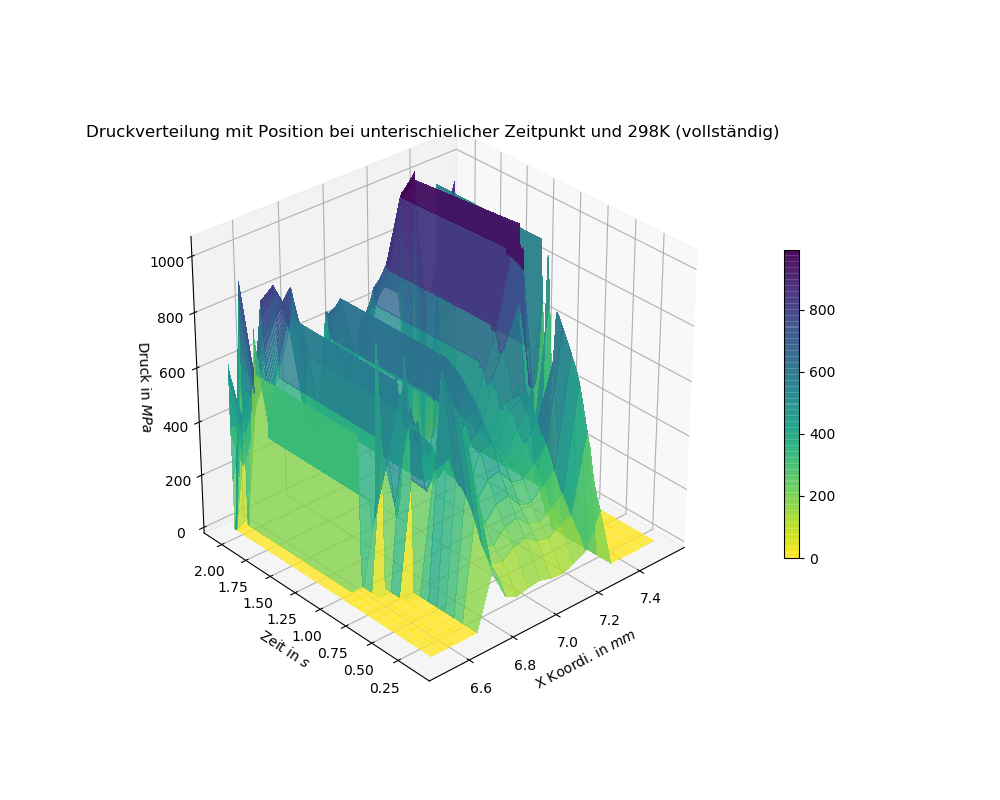

In [292]:
X, Y, Z = [], [], []
for a in range(len(x)):
    idx = a
    for b in range(n):
        idy = b
        X.append(x[idx] * 1000)
        Z.append(df6.iloc[idx, idy] / 1e6)
        Y.append(time_v[idy])
X = np.array(X).reshape(len(x), n)
Y = np.array(Y).reshape(len(x), n)
Z = np.array(Z).reshape(len(x), n)
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X,
                       Y,
                       Z,
                       cmap=plt.cm.viridis_r,
                       alpha=0.8,
                       antialiased=False)
if min(time_v) == 0.1:
    title = 'Druckverteilung mit Position bei unterischielicher Zeitpunkt und 298K (vollständig) '
else:
    title = 'Druckverteilung mit Position bei unterischielicher Zeitpunkt und 298K (unvollständig) '
plt.title(title)
ax.set_xlabel('X Koordi. in $mm$')
ax.set_ylabel('Zeit in $s$')
ax.set_zlabel('Druck in $MPa$')
fig.colorbar(surf, shrink=0.5)
plt.show()

In [293]:
SaveAndExit()

2020-02-28 16:09:01,517 [INFO] pyansys.mapdl: ALL CURRENT ANSYS DATA WRITTEN TO FILE NAME= Structure.db
  FOR POSSIBLE RESUME FROM THIS POINT
2020-02-28 16:09:01,542 [INFO] pyansys.mapdl: ANSYS exited
